<a href="https://colab.research.google.com/github/kluo9/Deep-Learning/blob/main/Basic_GAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [10]:
import torch, pdb
from torch.utils.data import DataLoader
from torch import nn
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from tqdm.auto import tqdm
import matplotlib.pyplot as plt

define visionlization function

In [11]:
def show(tensor, ch = 1, size = (28,28), num = 16):
  # tenor: 128 * 784
  data = tensor.detach().cpu().view(-1,ch,*size) # 128 * 1 * 28 * 28
  grid = make_grid(data[:num], nrow = 4).permute(1,2,0)
  plt.imshow(grid)
  plt.show()

Set up the main parameters and hyperparameters

In [12]:
epochs = 300
cur_step = 0
info_step = 300
mean_gen_loss = 0
mean_disc_loss = 0

z_dim = 64
lr = 0.00001
loss_func = nn.BCEWithLogitsLoss()
bs = 128
device = 'cuda'
dataloader = DataLoader(MNIST('.', download = True, transform = transforms.ToTensor()), shuffle = True, batch_size = bs)

# number os steps = 60000 / 128 = 468.75

# Models

Generator

In [13]:
from torch.nn.modules.batchnorm import BatchNorm1d
# generator
def genBlock(inp, out):
  return nn.Sequential(
      nn.Linear(inp, out),
      nn.BatchNorm1d(out),
      nn.ReLU(inplace = True)
  )

class Generator(nn.Module):
  def __init__(self, z_dim = 64, i_dim = 784, h_dim = 128):
    super().__init__()
    self.gen = nn.Sequential(
        genBlock(z_dim, h_dim), # 64, 128
        genBlock(h_dim, h_dim*2), # 128, 256
        genBlock(h_dim*2, h_dim*4), # 256, 512
        genBlock(h_dim*4, h_dim*8), # 512, 1024
        nn.Linear(h_dim*8, i_dim), # 1024, 784 (28*28)
        nn.Sigmoid(),
    )
  def forward(self, noise):
    return self.gen(noise)

def gen_noise(number, z_dim):
  return torch.randn(number, z_dim).to(device)

Descriminator

In [14]:
def discBlock(inp, out):
  return nn.Sequential(
      nn.Linear(inp, out),
      nn.LeakyReLU(0.2)
  )

class Discriminator(nn.Module):
  def __init__(self, i_dim = 784, h_dim = 256):
    super().__init__()
    self.disc = nn.Sequential(
        discBlock(i_dim, h_dim*4), # 784, 1024
        discBlock(h_dim*4, h_dim*2), # 1024, 512
        discBlock(h_dim*2, h_dim), # 512, 256
        nn.Linear(h_dim, 1) # 256, 1
    )
  def forward(self, image):
    return self.disc(image)


In [15]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator().to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr = lr)

torch.Size([128, 1, 28, 28]) torch.Size([128])
tensor([4, 4, 4, 0, 9, 2, 3, 3, 3, 7])


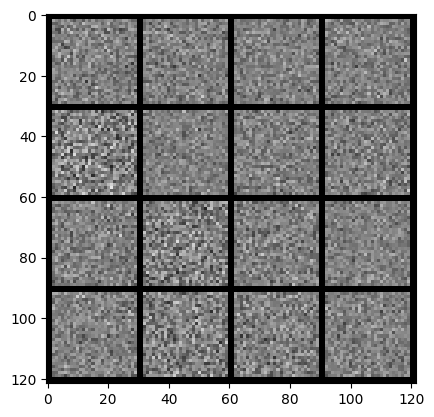

In [16]:
x,y = next(iter(dataloader))
print(x.shape, y.shape)
print(y[:10])

noise = gen_noise(bs, z_dim)
fake = gen(noise)
show(fake)

Loss function

In [17]:
# generator loss
def cal_gen_loss(loss_func, gen, disc, number, z_dim):
  noise = gen_noise(number, z_dim)
  fake = gen(noise)
  predict = disc(fake)
  target = torch.ones_like(predict)
  gen_loss = loss_func(predict, target)
  return gen_loss

def cal_disc_loss(loss_func, gen, disc, number, real, z_dim):
  noise = gen_noise(number, z_dim)
  fake = gen(noise)
  disc_fake = disc(fake.detach())
  disc_fake_target = torch.zeros_like(disc_fake)
  disc_fake_loss = loss_func(disc_fake, disc_fake_target)

  disc_real = disc(real)
  disc_real_target = torch.ones_like(disc_real)
  disc_real_loss = loss_func(disc_real, disc_real_target)

  disc_loss = (disc_fake_loss + disc_real_loss) / 2
  return disc_loss


# Main loop

  0%|          | 0/469 [00:00<?, ?it/s]

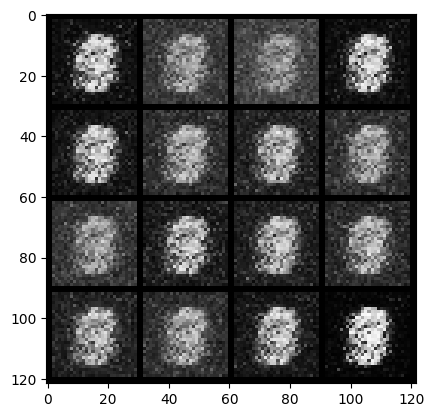

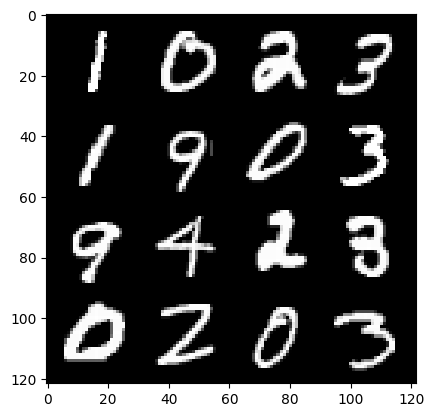

0: step 300 / Gen loss 1.9825180198748897 / Disc loss 0.3379724755883215


  0%|          | 0/469 [00:00<?, ?it/s]

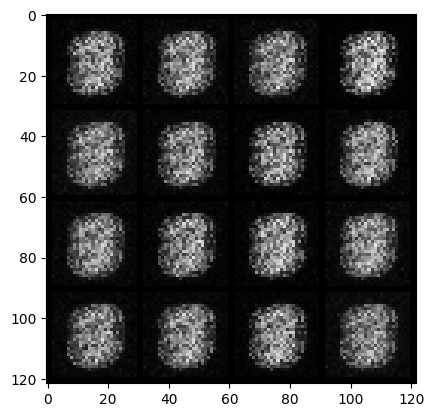

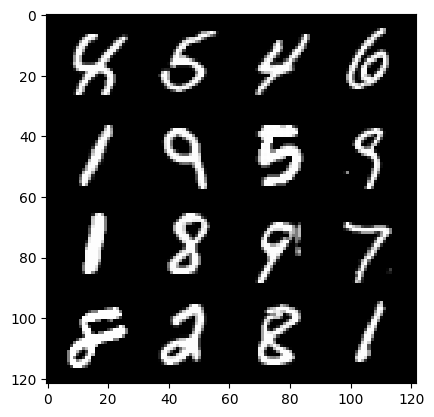

1: step 600 / Gen loss 3.5331573049227374 / Disc loss 0.12556327489515148


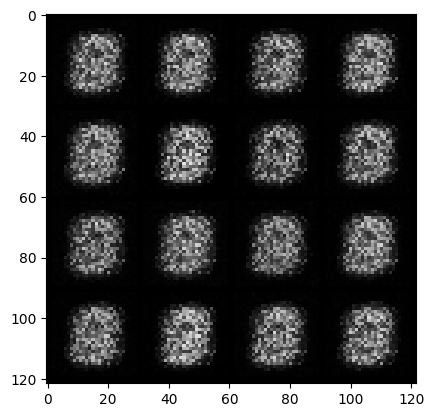

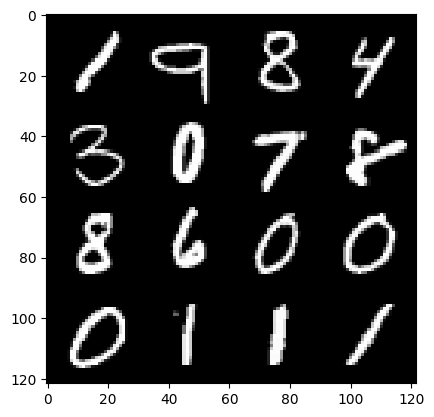

1: step 900 / Gen loss 3.3832366911570255 / Disc loss 0.060539205397168824


  0%|          | 0/469 [00:00<?, ?it/s]

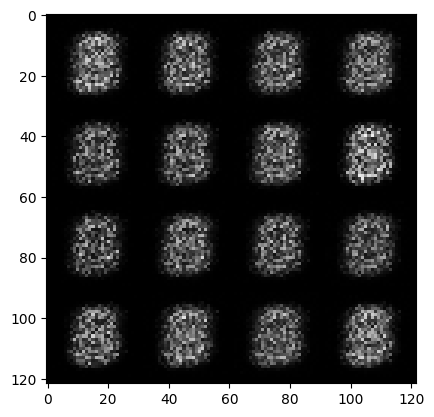

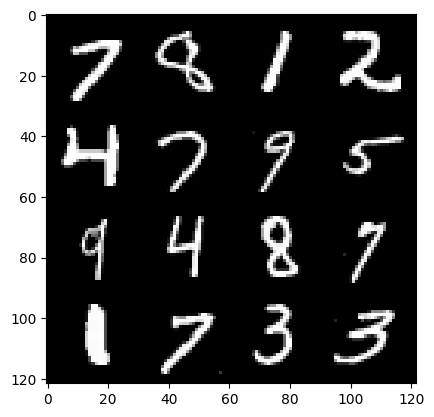

2: step 1200 / Gen loss 3.4589967385927856 / Disc loss 0.04018173915023611


  0%|          | 0/469 [00:00<?, ?it/s]

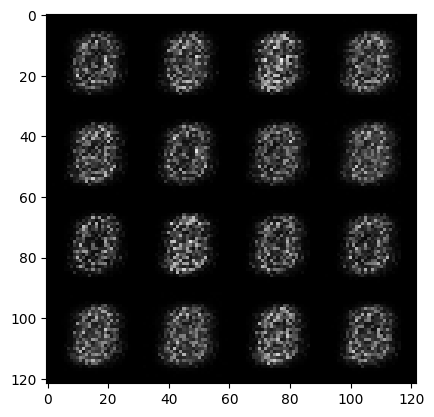

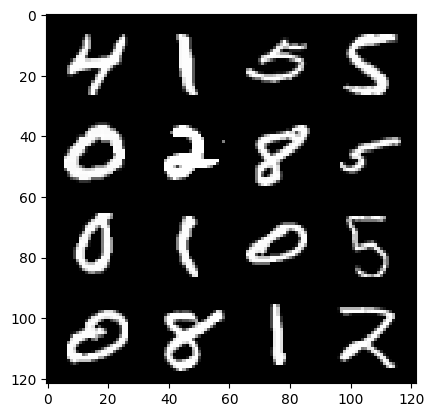

3: step 1500 / Gen loss 3.4181443397204068 / Disc loss 0.040863179378211524


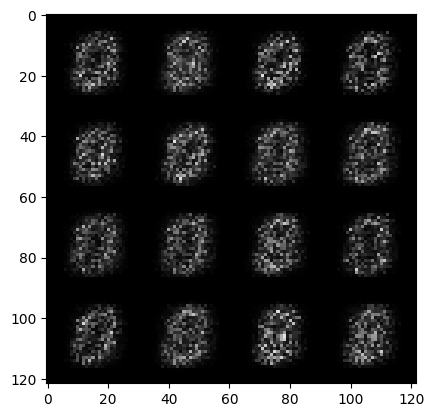

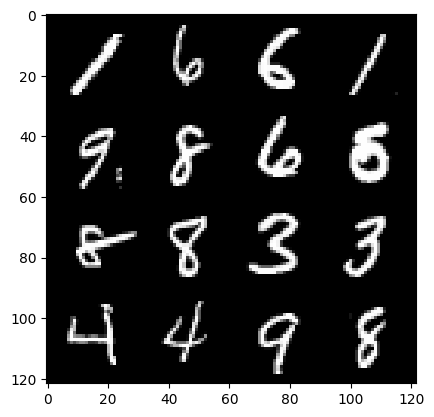

3: step 1800 / Gen loss 3.4447545560201025 / Disc loss 0.04405907712255915


  0%|          | 0/469 [00:00<?, ?it/s]

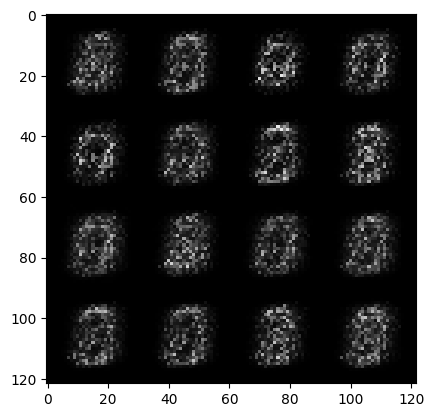

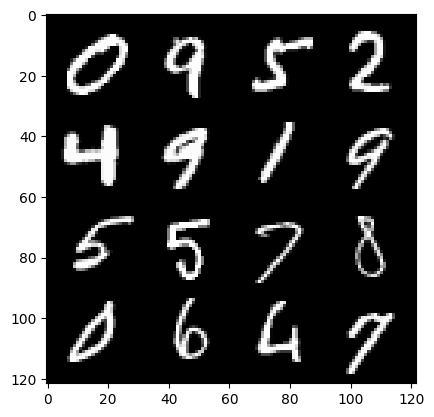

4: step 2100 / Gen loss 3.6021454739570617 / Disc loss 0.04064943612863623


  0%|          | 0/469 [00:00<?, ?it/s]

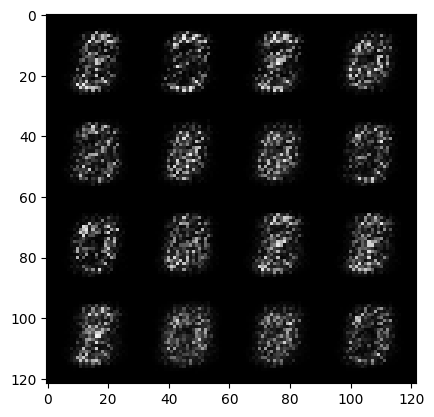

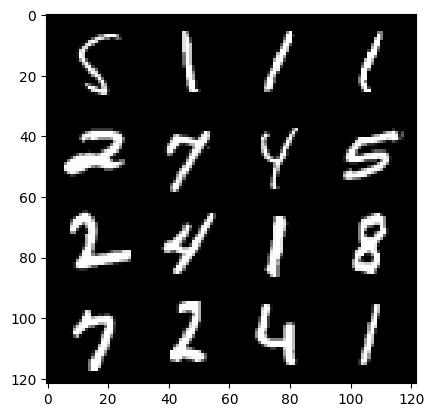

5: step 2400 / Gen loss 3.9008763742446915 / Disc loss 0.03748106965795157


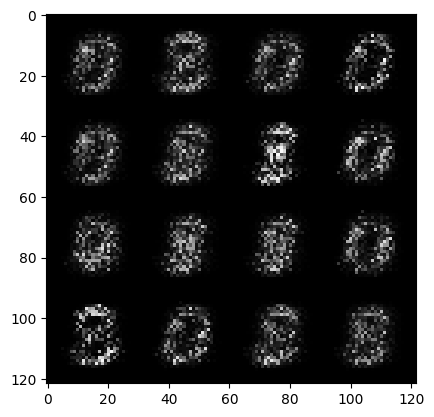

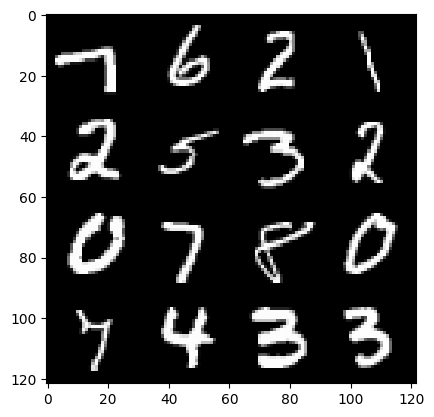

5: step 2700 / Gen loss 4.273343629042303 / Disc loss 0.029313094224780786


  0%|          | 0/469 [00:00<?, ?it/s]

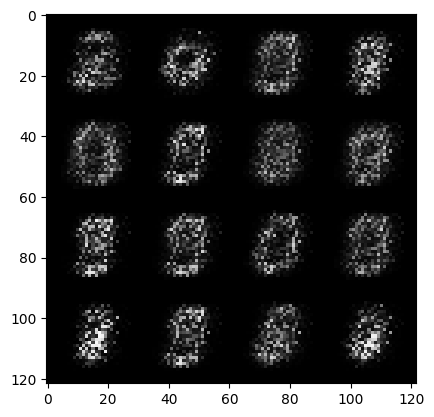

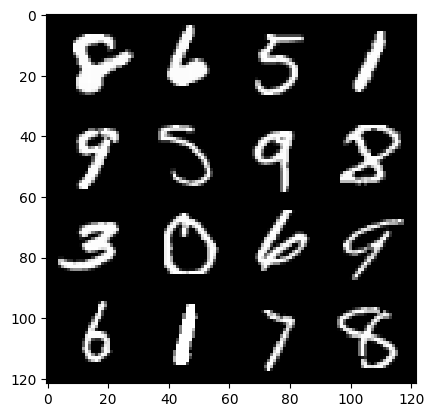

6: step 3000 / Gen loss 4.745985862414039 / Disc loss 0.025712174999838078


  0%|          | 0/469 [00:00<?, ?it/s]

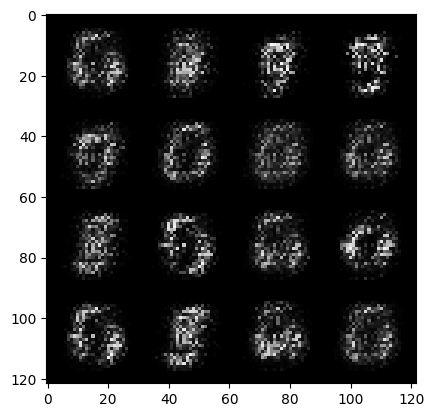

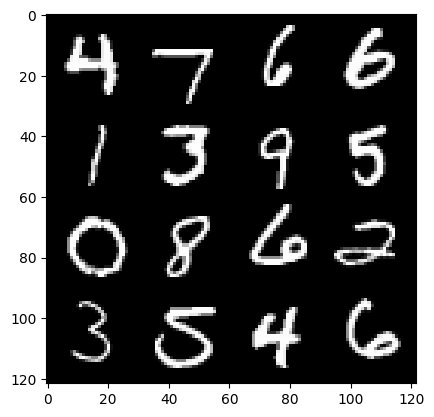

7: step 3300 / Gen loss 5.012950811386106 / Disc loss 0.024767362894490344


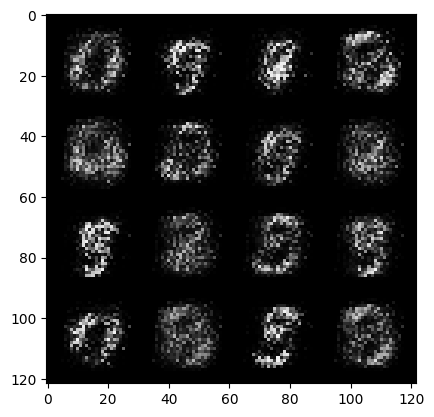

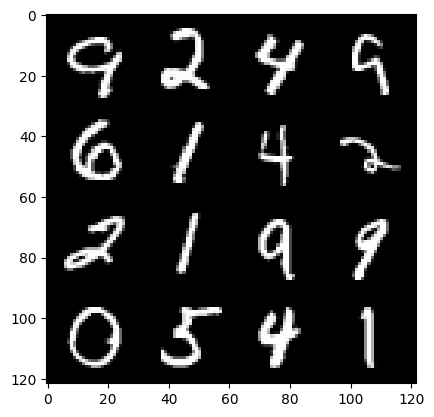

7: step 3600 / Gen loss 5.231085661252343 / Disc loss 0.027704843965669485


  0%|          | 0/469 [00:00<?, ?it/s]

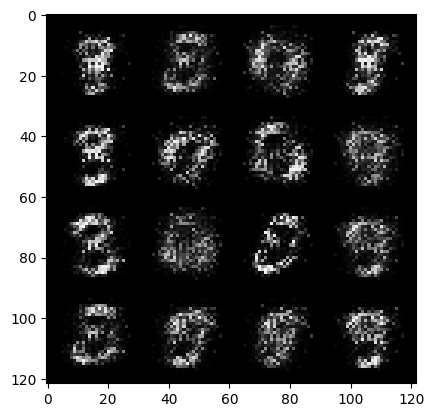

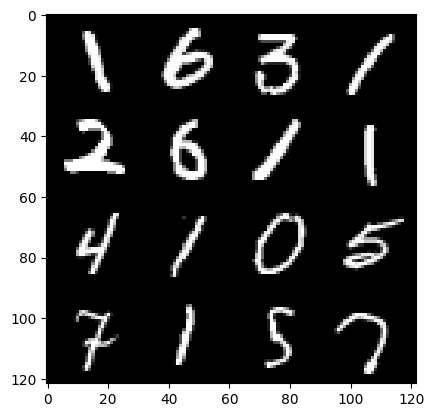

8: step 3900 / Gen loss 5.333344656626386 / Disc loss 0.028655280486370102


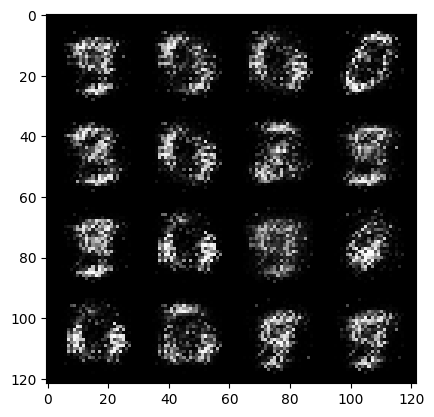

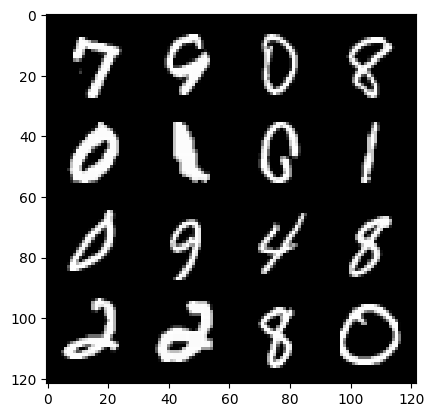

8: step 4200 / Gen loss 5.476386850674947 / Disc loss 0.02562187643721699


  0%|          | 0/469 [00:00<?, ?it/s]

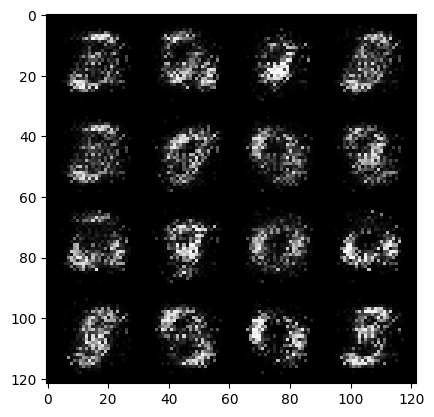

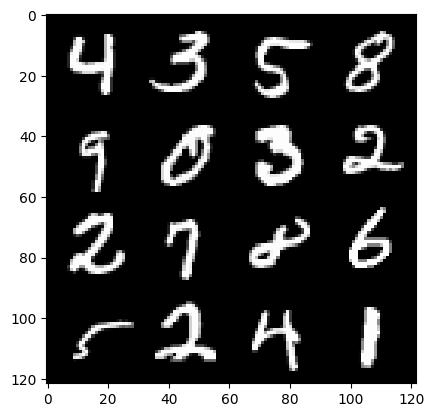

9: step 4500 / Gen loss 5.945583744049074 / Disc loss 0.021231359532102936


  0%|          | 0/469 [00:00<?, ?it/s]

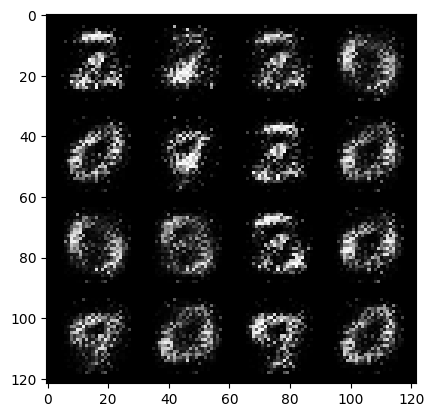

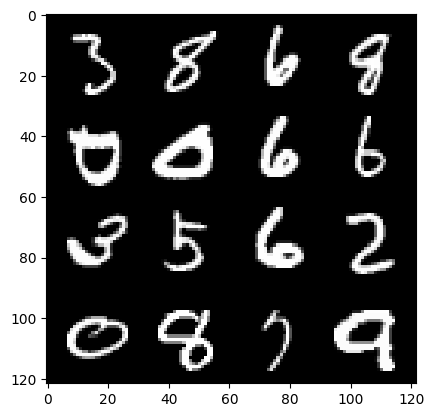

10: step 4800 / Gen loss 6.018673079808554 / Disc loss 0.016421357748719542


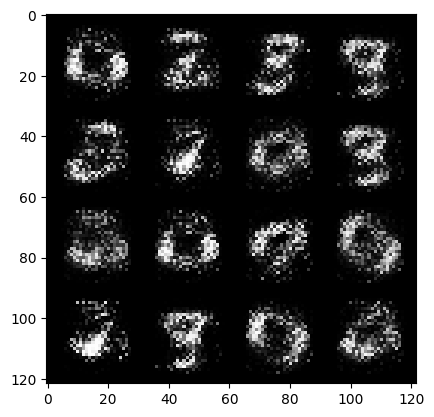

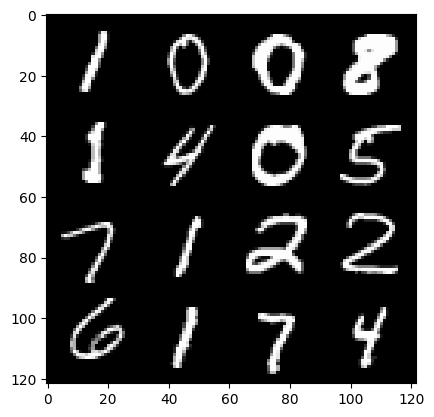

10: step 5100 / Gen loss 6.142588817278547 / Disc loss 0.01298422758622716


  0%|          | 0/469 [00:00<?, ?it/s]

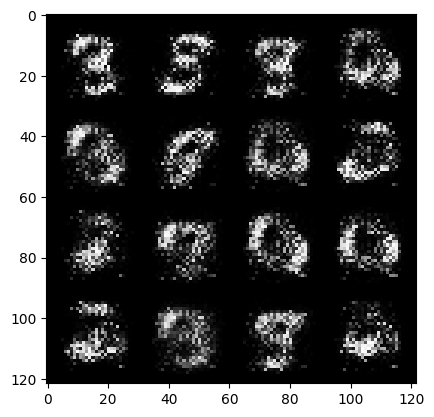

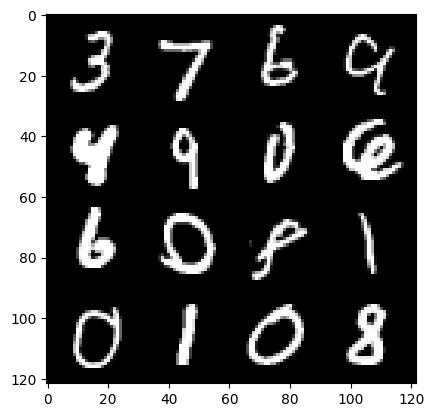

11: step 5400 / Gen loss 6.182020686467495 / Disc loss 0.012059559724293635


  0%|          | 0/469 [00:00<?, ?it/s]

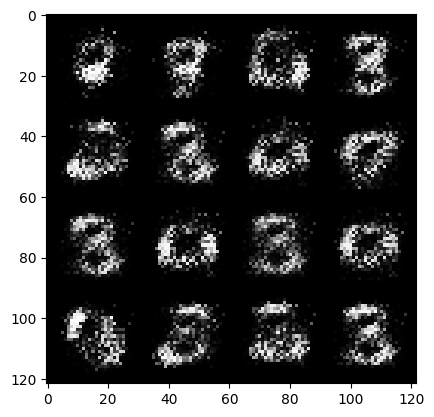

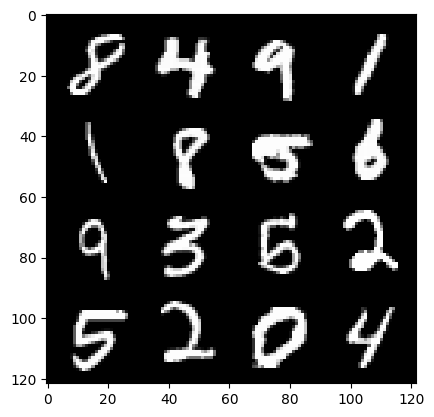

12: step 5700 / Gen loss 6.435299146970107 / Disc loss 0.00944578051179026


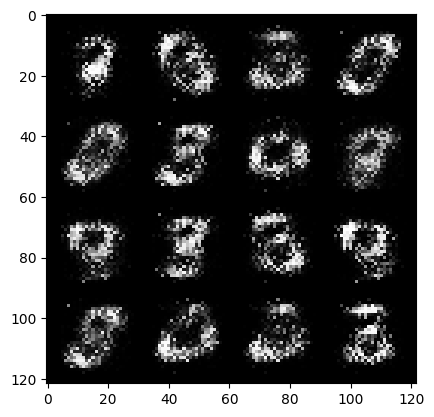

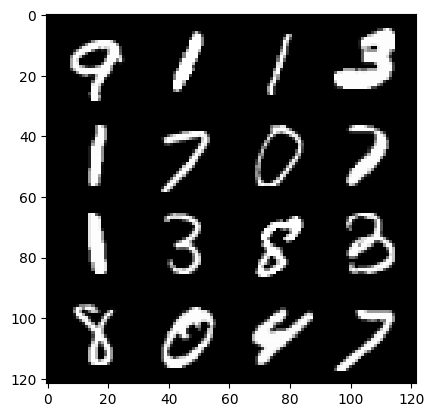

12: step 6000 / Gen loss 6.739333721796668 / Disc loss 0.009902911592895788


  0%|          | 0/469 [00:00<?, ?it/s]

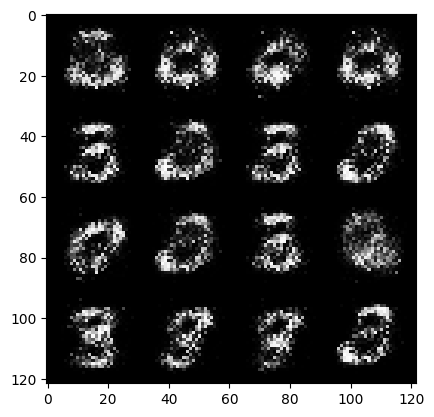

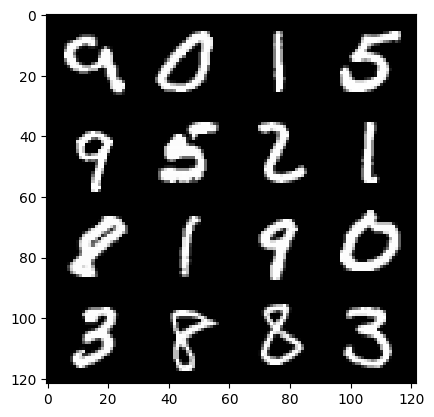

13: step 6300 / Gen loss 6.41020535469055 / Disc loss 0.010344668859615925


  0%|          | 0/469 [00:00<?, ?it/s]

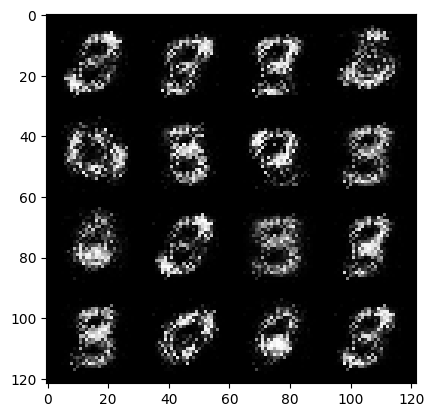

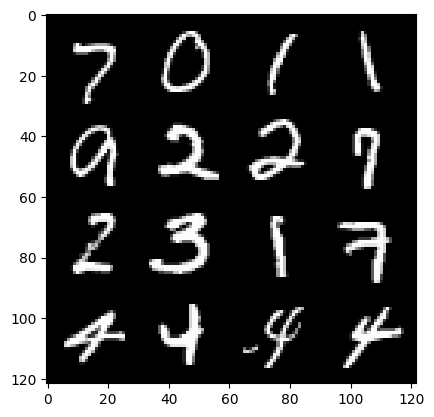

14: step 6600 / Gen loss 6.572963887850443 / Disc loss 0.010432292518671607


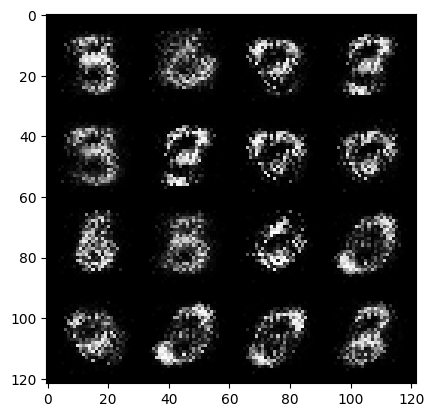

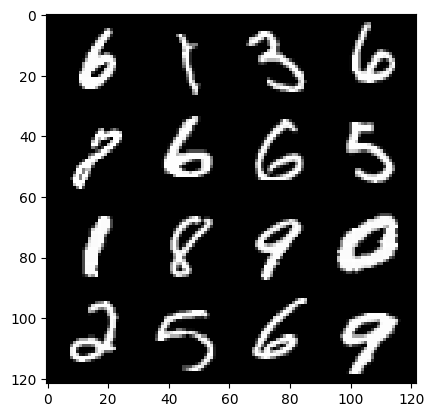

14: step 6900 / Gen loss 7.362228363355003 / Disc loss 0.01112294159131125


  0%|          | 0/469 [00:00<?, ?it/s]

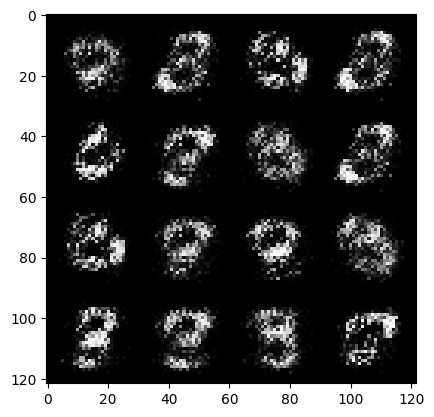

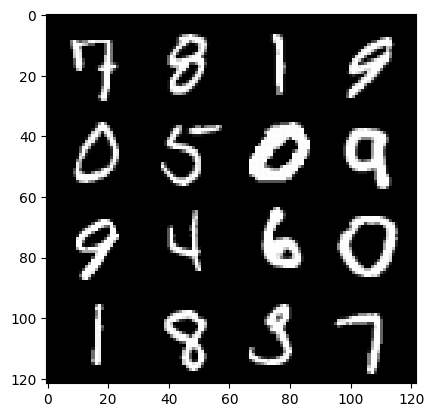

15: step 7200 / Gen loss 7.159860331217448 / Disc loss 0.012195059806108483


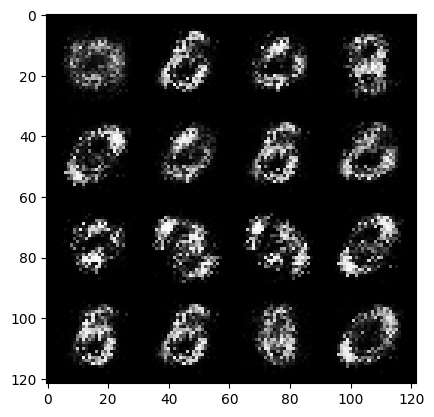

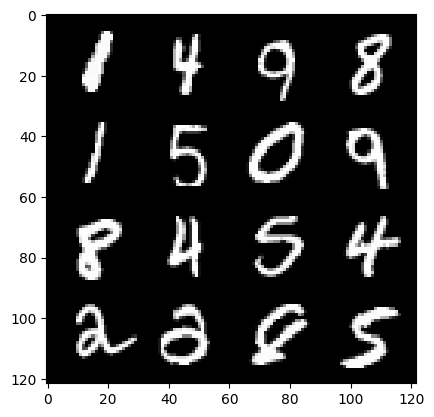

15: step 7500 / Gen loss 6.965536432266235 / Disc loss 0.013436368658052132


  0%|          | 0/469 [00:00<?, ?it/s]

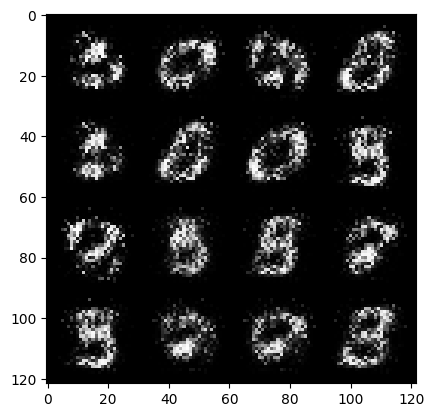

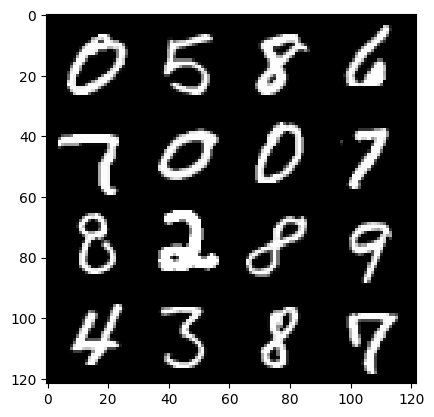

16: step 7800 / Gen loss 6.9412747589747115 / Disc loss 0.012335451475034157


  0%|          | 0/469 [00:00<?, ?it/s]

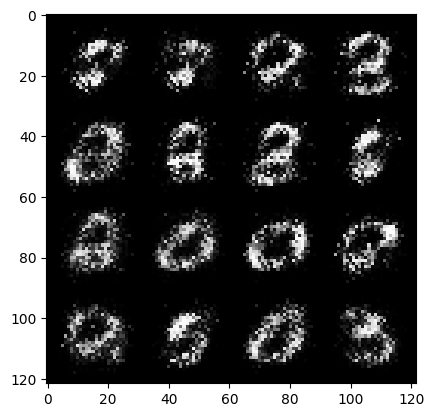

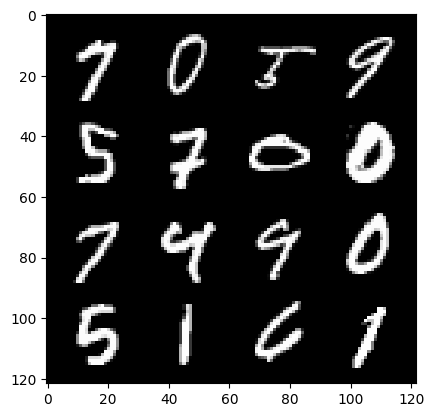

17: step 8100 / Gen loss 7.200675824483233 / Disc loss 0.012388559498358516


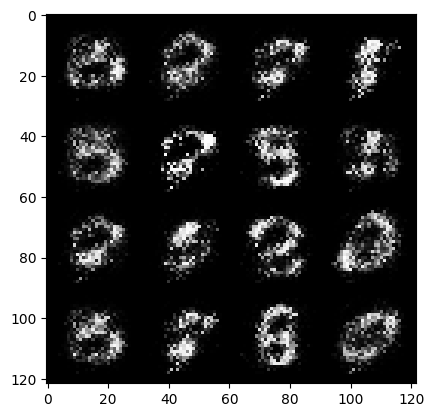

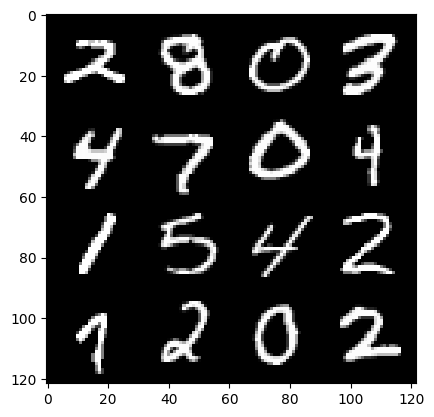

17: step 8400 / Gen loss 7.459672042528787 / Disc loss 0.010570251121728998


  0%|          | 0/469 [00:00<?, ?it/s]

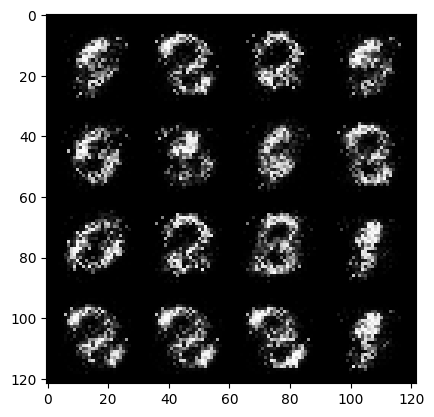

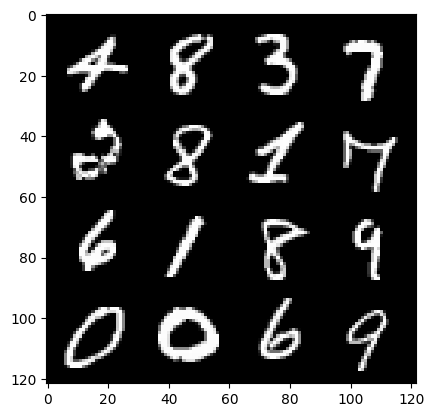

18: step 8700 / Gen loss 7.202961950302122 / Disc loss 0.010338789833864818


  0%|          | 0/469 [00:00<?, ?it/s]

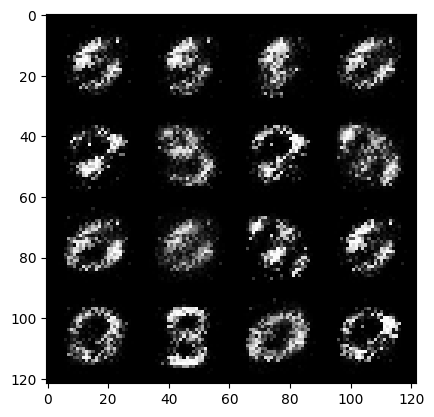

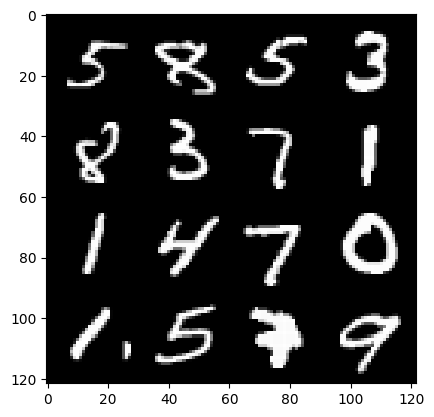

19: step 9000 / Gen loss 7.128709707260131 / Disc loss 0.012641520583226033


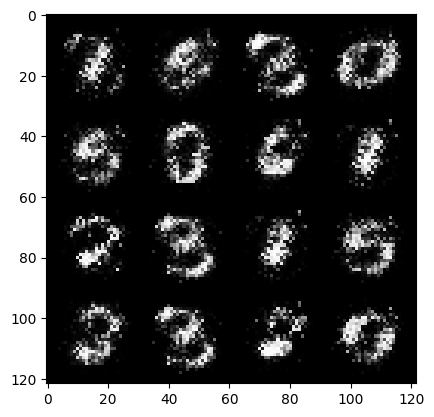

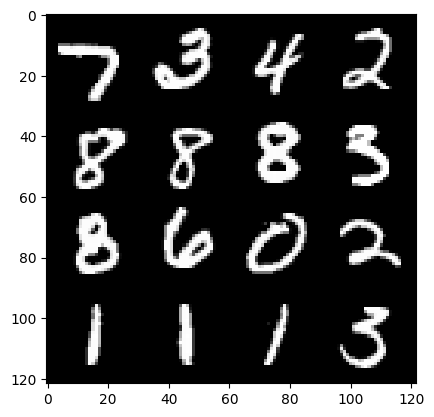

19: step 9300 / Gen loss 6.779500107765199 / Disc loss 0.011060960044851532


  0%|          | 0/469 [00:00<?, ?it/s]

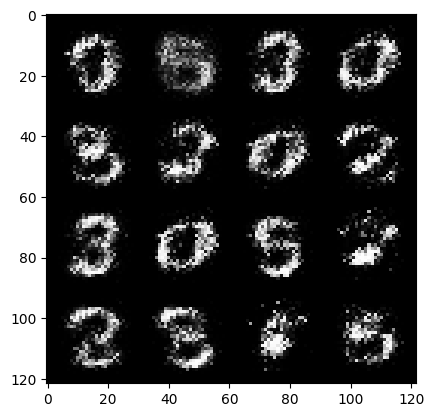

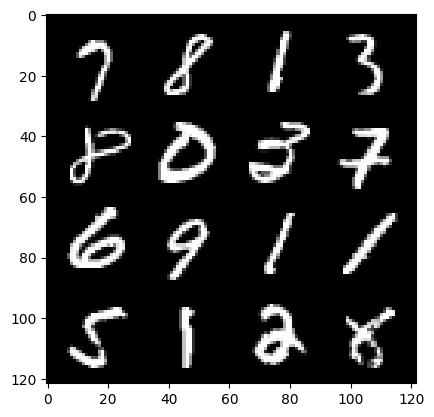

20: step 9600 / Gen loss 7.121816150347395 / Disc loss 0.010486956205374248


  0%|          | 0/469 [00:00<?, ?it/s]

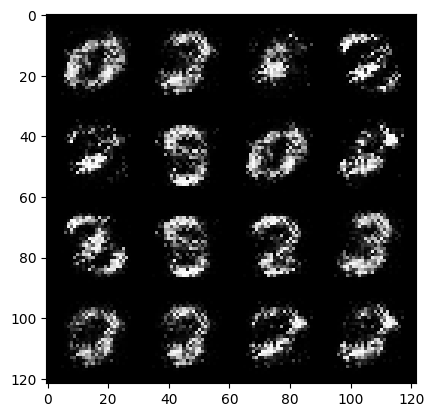

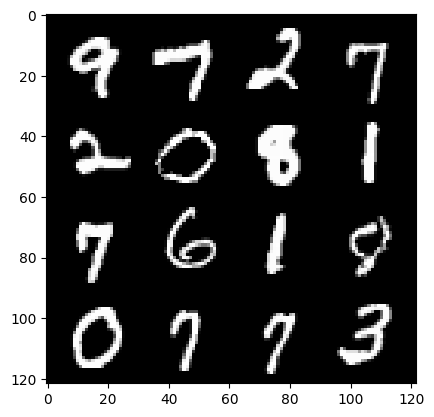

21: step 9900 / Gen loss 7.054570218722024 / Disc loss 0.011337521593086422


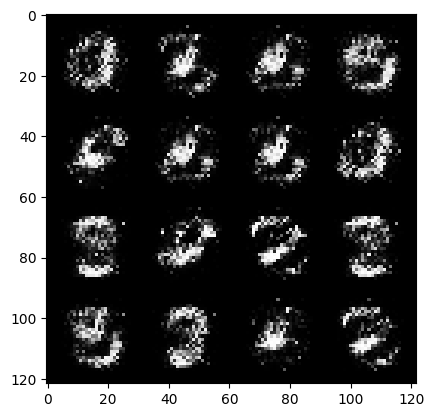

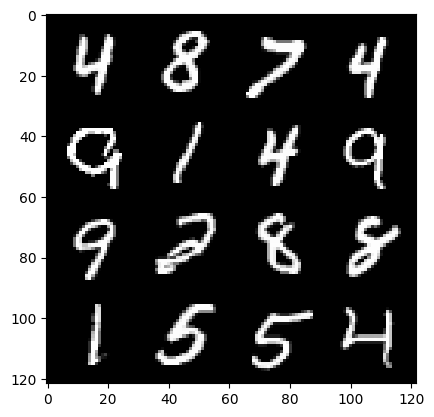

21: step 10200 / Gen loss 7.131871156692507 / Disc loss 0.011091258594145384


  0%|          | 0/469 [00:00<?, ?it/s]

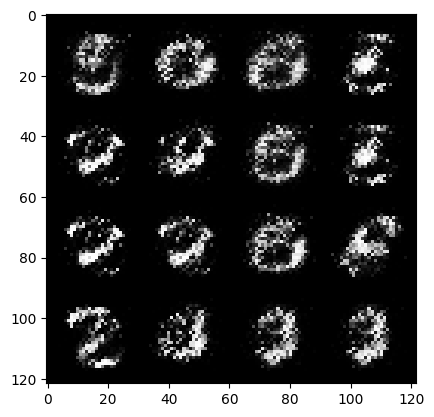

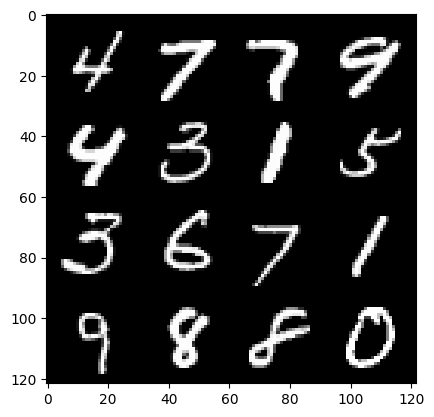

22: step 10500 / Gen loss 7.1446422290802 / Disc loss 0.011848399485461411


  0%|          | 0/469 [00:00<?, ?it/s]

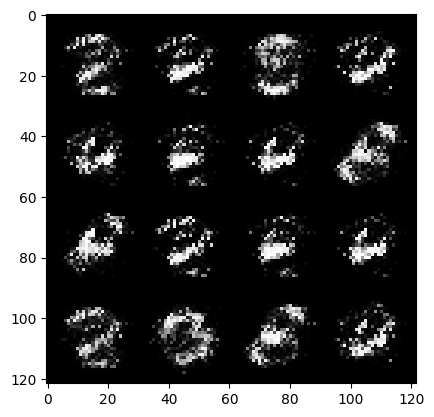

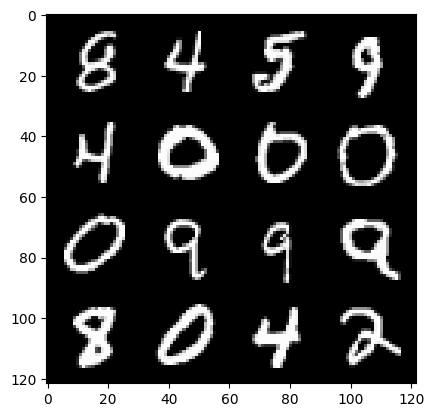

23: step 10800 / Gen loss 7.023155827522277 / Disc loss 0.011536328194973376


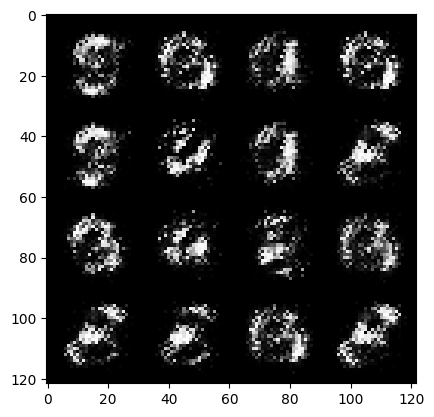

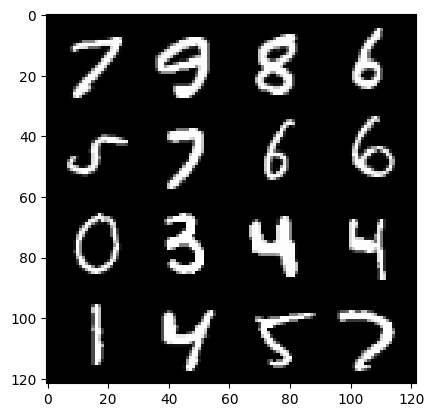

23: step 11100 / Gen loss 7.292551485697424 / Disc loss 0.010280857377996038


  0%|          | 0/469 [00:00<?, ?it/s]

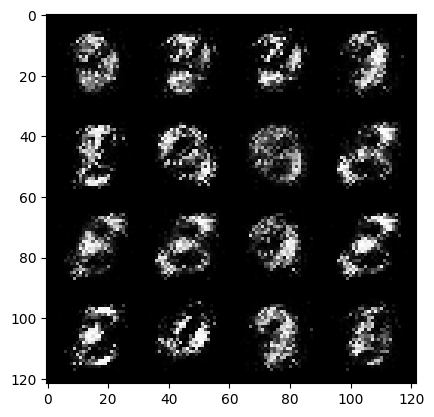

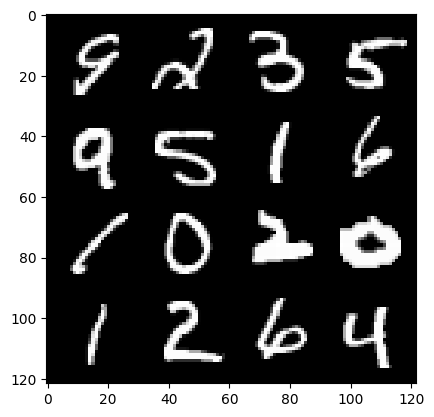

24: step 11400 / Gen loss 7.602954742113748 / Disc loss 0.00960759655223228


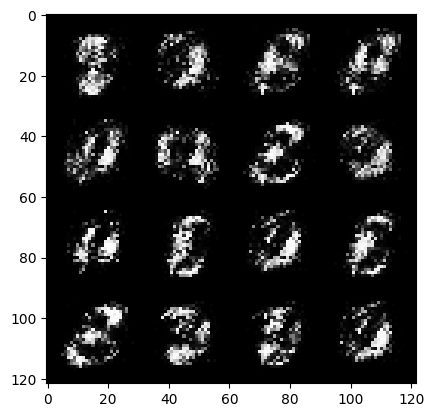

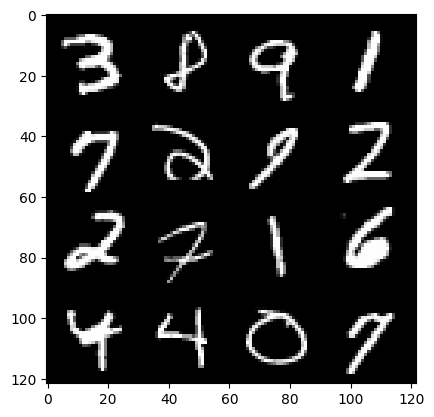

24: step 11700 / Gen loss 7.2002192179361995 / Disc loss 0.011309465358887487


  0%|          | 0/469 [00:00<?, ?it/s]

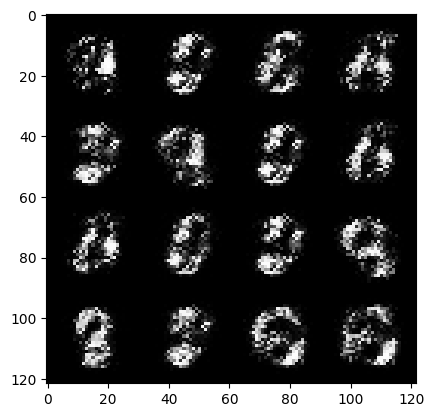

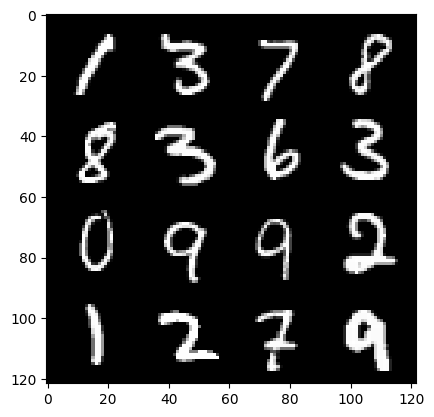

25: step 12000 / Gen loss 7.075709698994954 / Disc loss 0.01211326331210633


  0%|          | 0/469 [00:00<?, ?it/s]

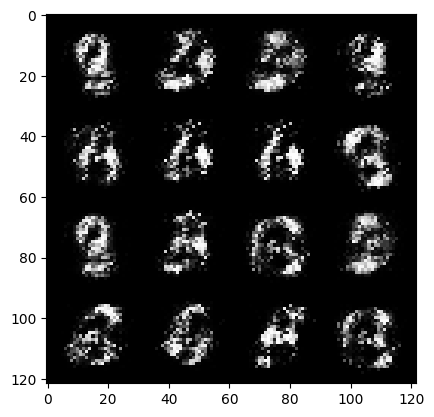

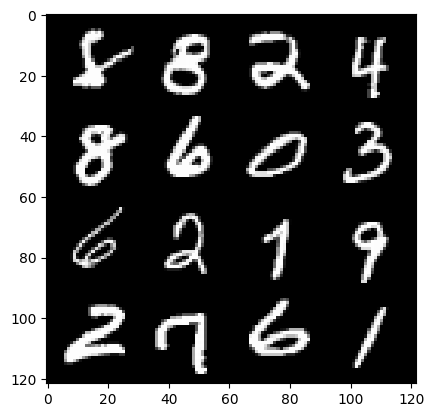

26: step 12300 / Gen loss 6.806739555994676 / Disc loss 0.012734956891896824


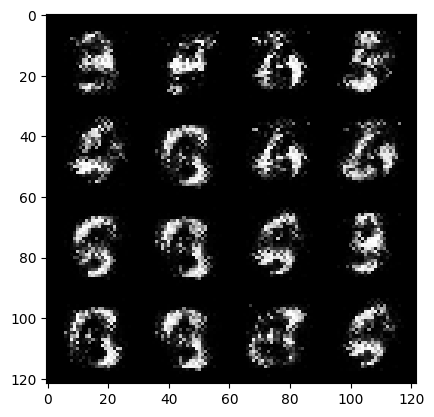

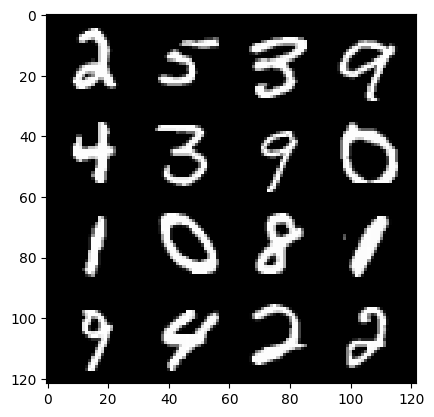

26: step 12600 / Gen loss 6.983085473378501 / Disc loss 0.013351413758161174


  0%|          | 0/469 [00:00<?, ?it/s]

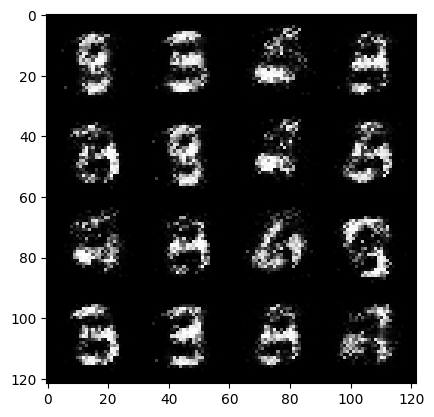

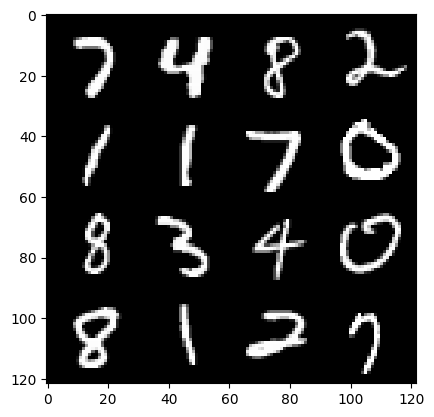

27: step 12900 / Gen loss 6.9647530603408825 / Disc loss 0.0131540947748969


  0%|          | 0/469 [00:00<?, ?it/s]

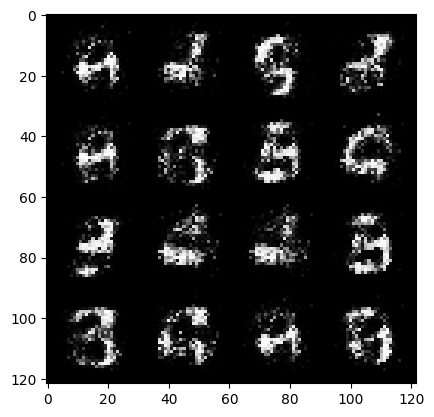

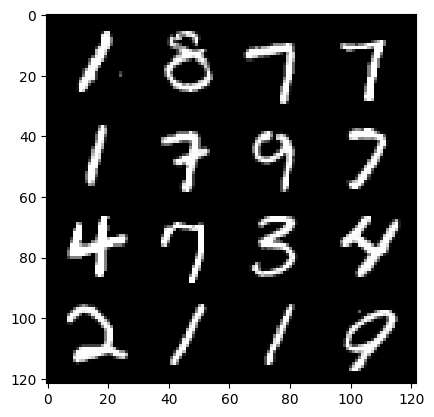

28: step 13200 / Gen loss 6.873336129188535 / Disc loss 0.012930700764991337


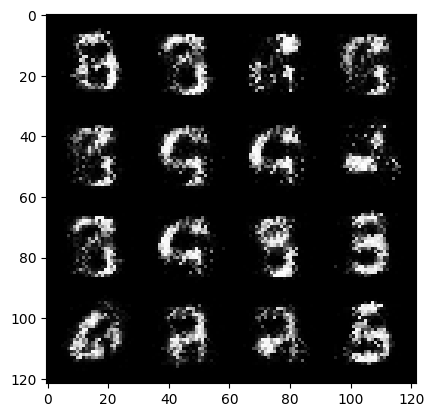

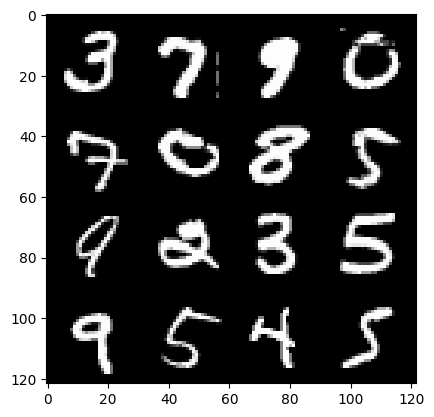

28: step 13500 / Gen loss 6.564345474243164 / Disc loss 0.016023976660799244


  0%|          | 0/469 [00:00<?, ?it/s]

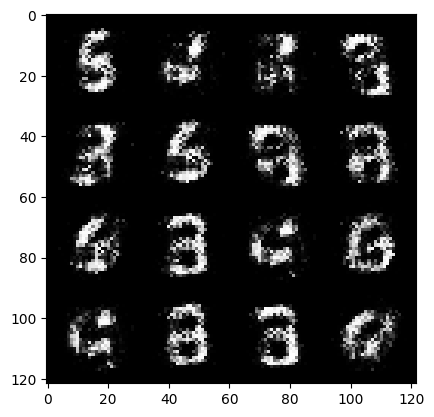

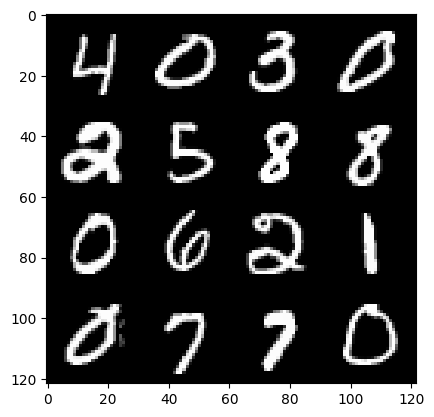

29: step 13800 / Gen loss 6.578971354166665 / Disc loss 0.01658804512427499


  0%|          | 0/469 [00:00<?, ?it/s]

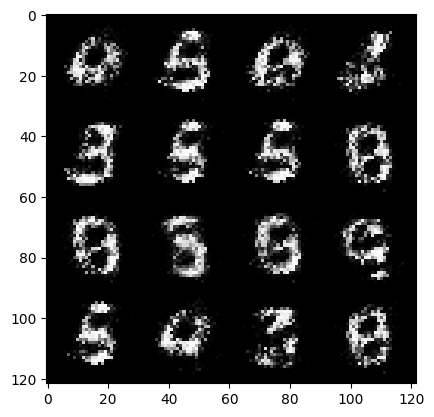

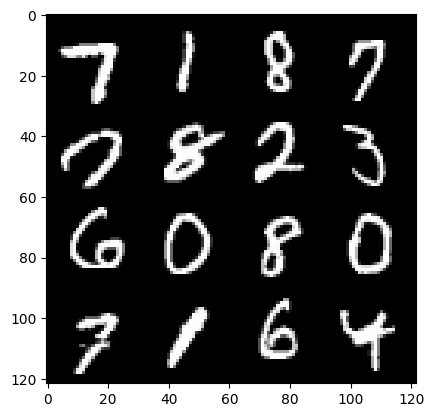

30: step 14100 / Gen loss 6.6799372863769575 / Disc loss 0.017658038682614785


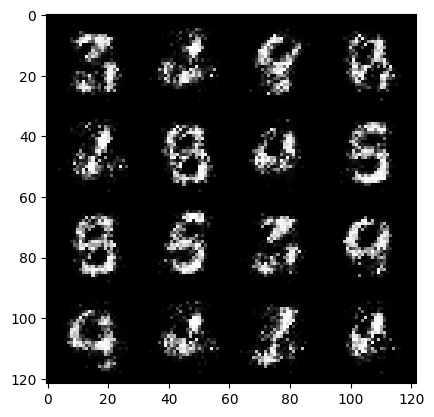

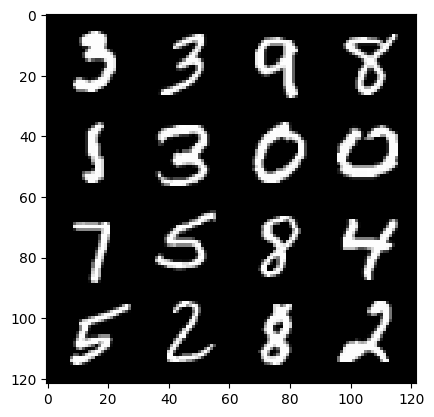

30: step 14400 / Gen loss 6.474830595652265 / Disc loss 0.019460139514412732


  0%|          | 0/469 [00:00<?, ?it/s]

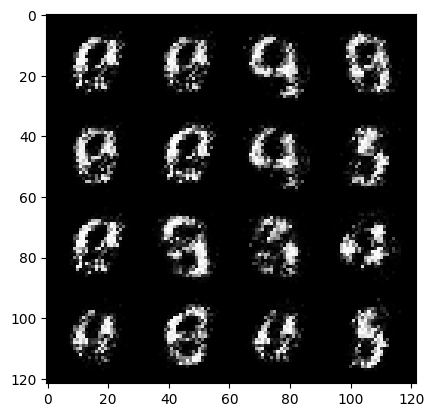

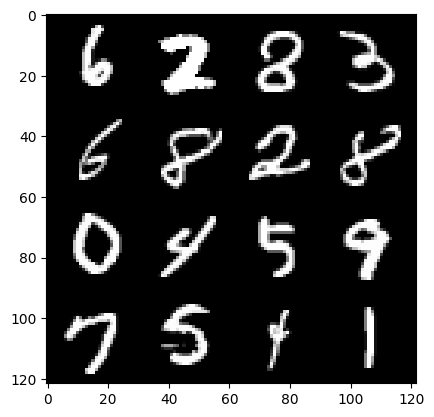

31: step 14700 / Gen loss 6.471470508575439 / Disc loss 0.018729770702775563


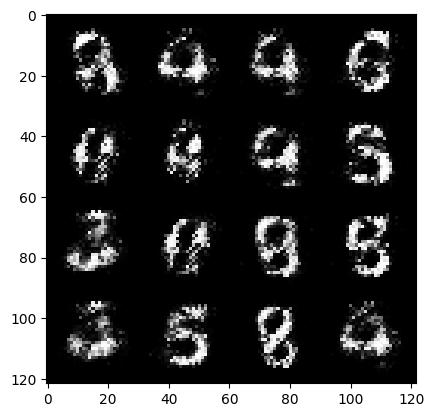

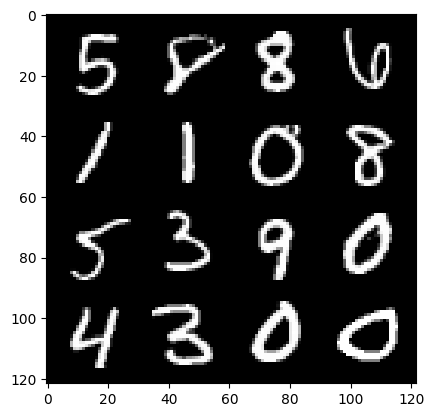

31: step 15000 / Gen loss 6.350000654856368 / Disc loss 0.021703185598986836


  0%|          | 0/469 [00:00<?, ?it/s]

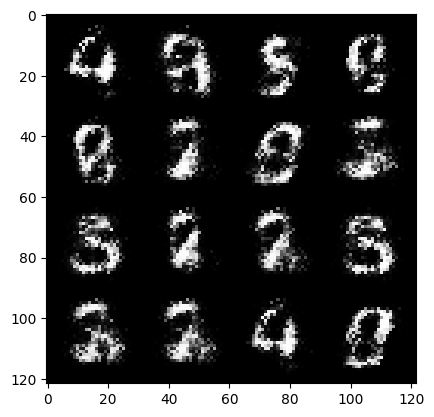

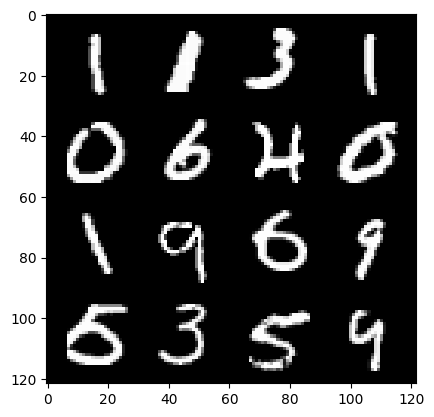

32: step 15300 / Gen loss 6.362660622596744 / Disc loss 0.02104056253563612


  0%|          | 0/469 [00:00<?, ?it/s]

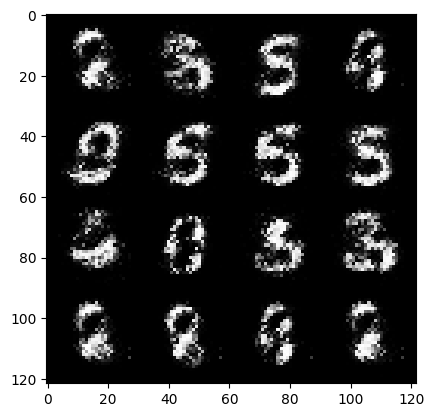

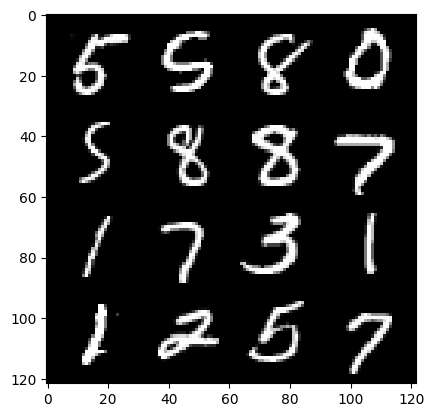

33: step 15600 / Gen loss 6.523112297058105 / Disc loss 0.022149925435272347


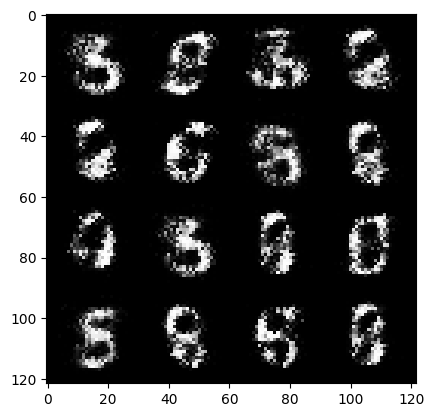

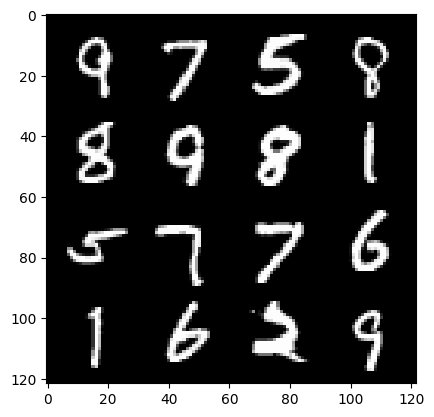

33: step 15900 / Gen loss 6.7552788607279535 / Disc loss 0.01998595877317712


  0%|          | 0/469 [00:00<?, ?it/s]

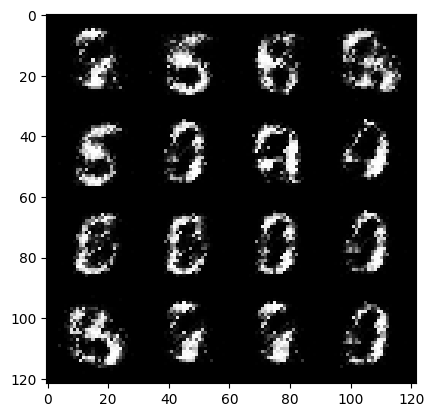

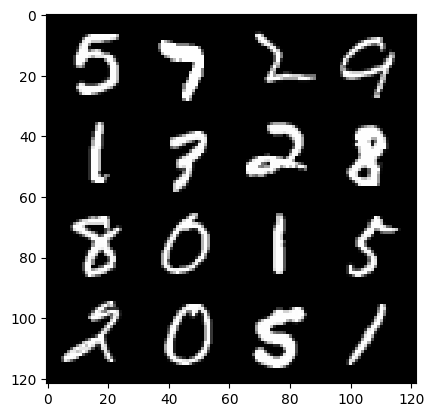

34: step 16200 / Gen loss 6.681765344937645 / Disc loss 0.023047569816311217


  0%|          | 0/469 [00:00<?, ?it/s]

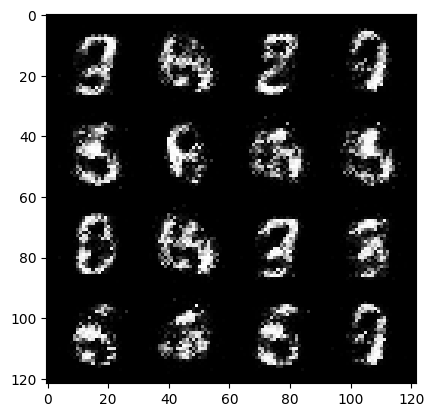

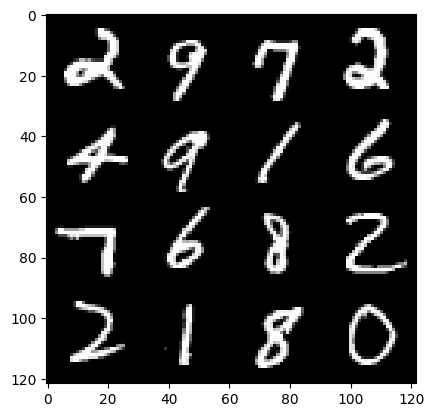

35: step 16500 / Gen loss 6.240972277323401 / Disc loss 0.024292594608850793


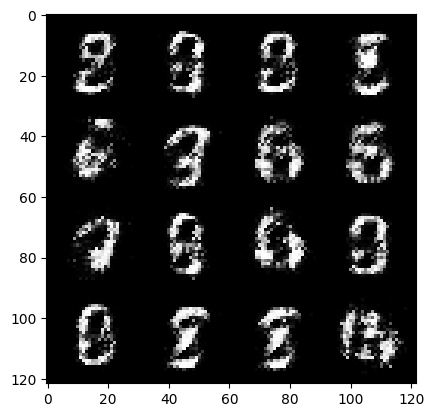

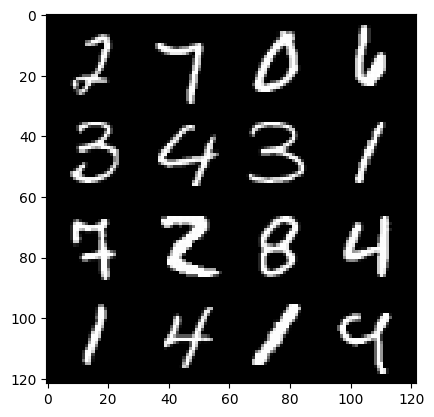

35: step 16800 / Gen loss 6.842015740076706 / Disc loss 0.02478394755472741


  0%|          | 0/469 [00:00<?, ?it/s]

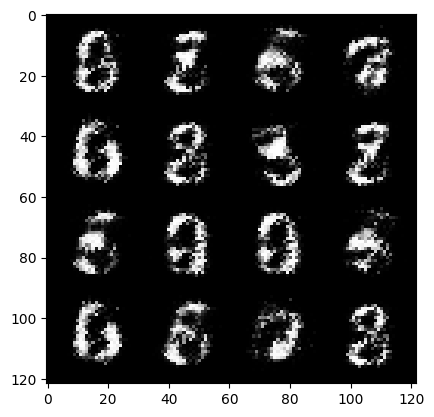

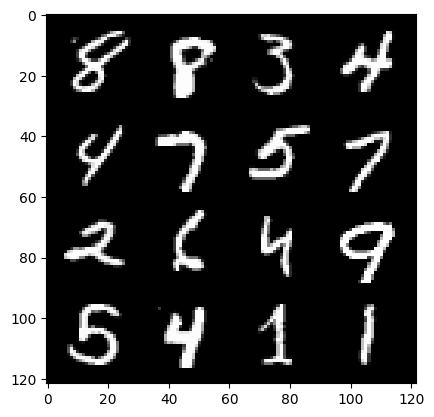

36: step 17100 / Gen loss 6.402279222806295 / Disc loss 0.02569311027570316


  0%|          | 0/469 [00:00<?, ?it/s]

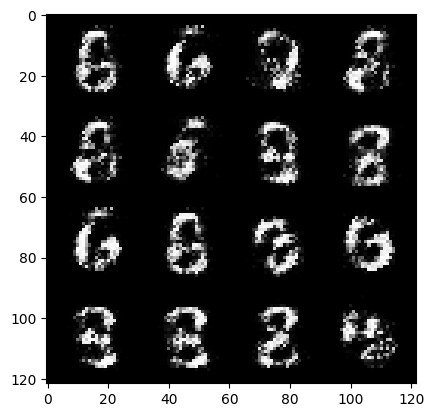

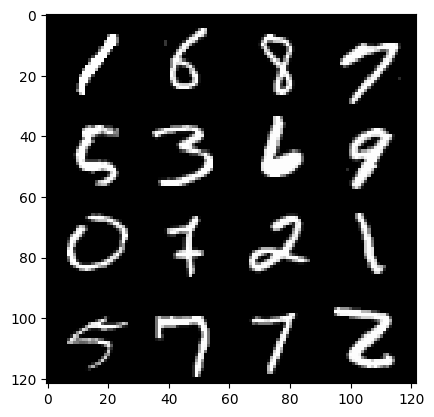

37: step 17400 / Gen loss 6.600770727793375 / Disc loss 0.028185553262010207


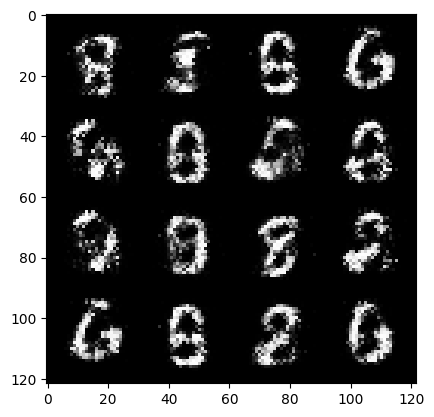

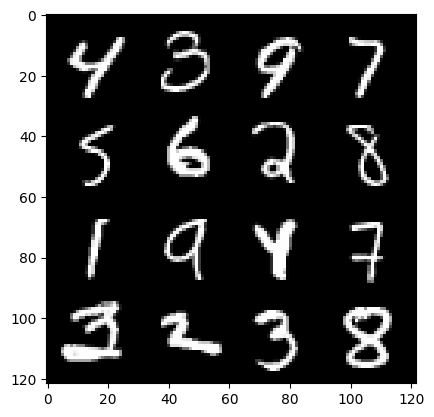

37: step 17700 / Gen loss 5.943312280972795 / Disc loss 0.03218031278966616


  0%|          | 0/469 [00:00<?, ?it/s]

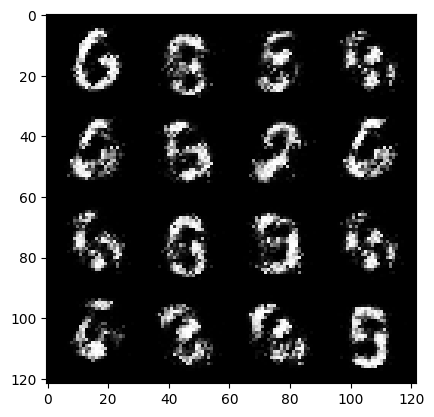

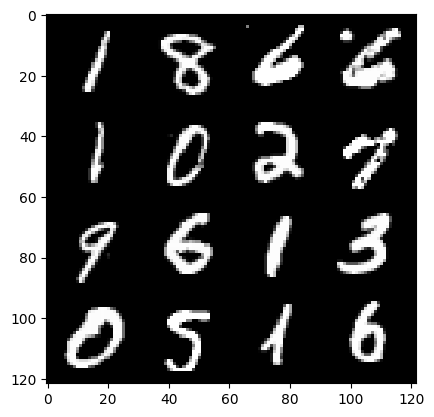

38: step 18000 / Gen loss 5.899713519414271 / Disc loss 0.03027020467134813


  0%|          | 0/469 [00:00<?, ?it/s]

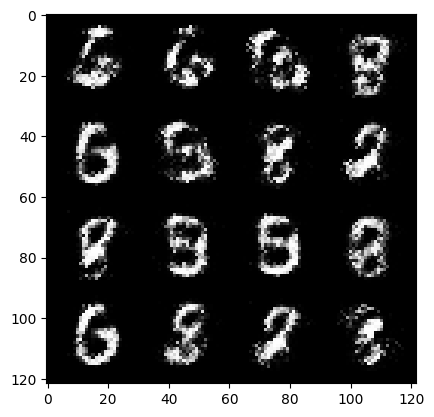

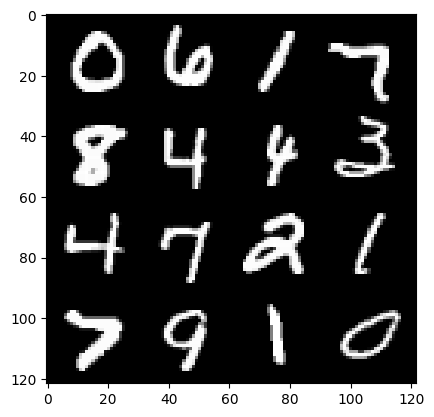

39: step 18300 / Gen loss 6.124822961489361 / Disc loss 0.030560703471613427


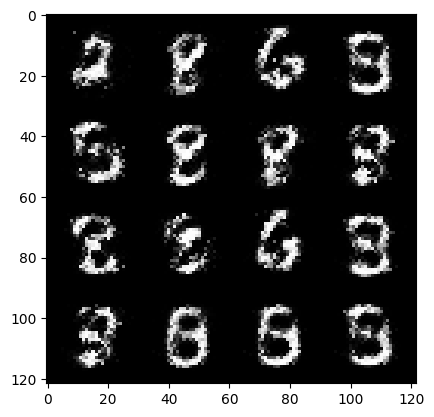

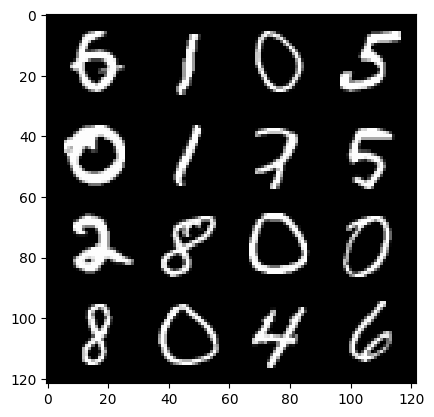

39: step 18600 / Gen loss 5.827958636283881 / Disc loss 0.033824988563234626


  0%|          | 0/469 [00:00<?, ?it/s]

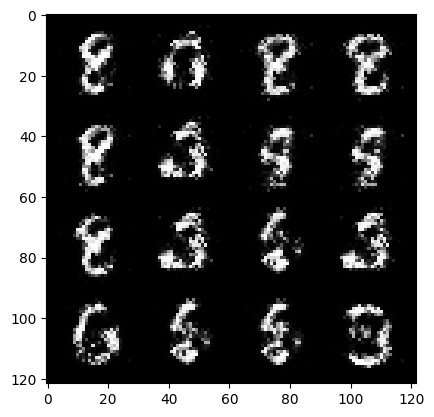

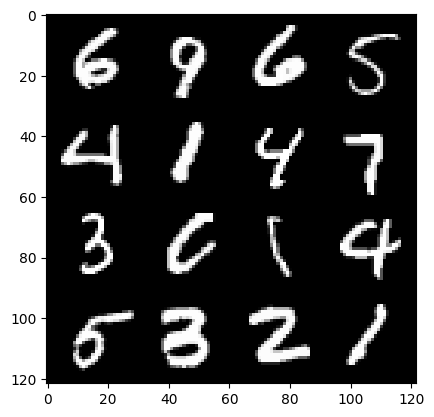

40: step 18900 / Gen loss 5.850527243614196 / Disc loss 0.0365741686243564


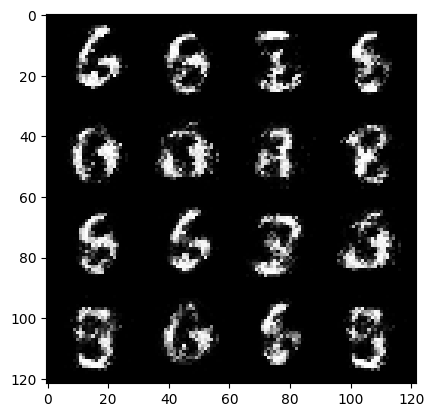

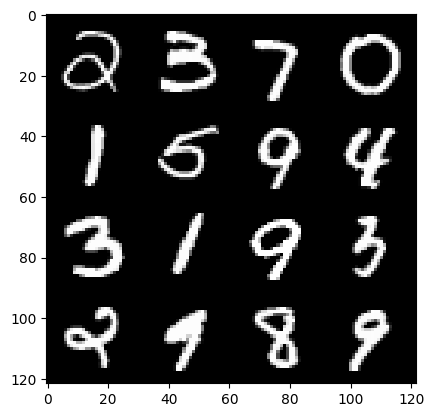

40: step 19200 / Gen loss 5.867969196637472 / Disc loss 0.042782203991276524


  0%|          | 0/469 [00:00<?, ?it/s]

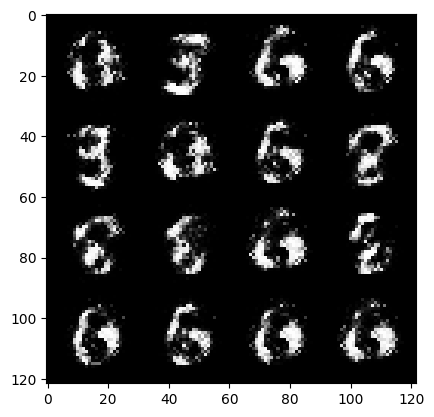

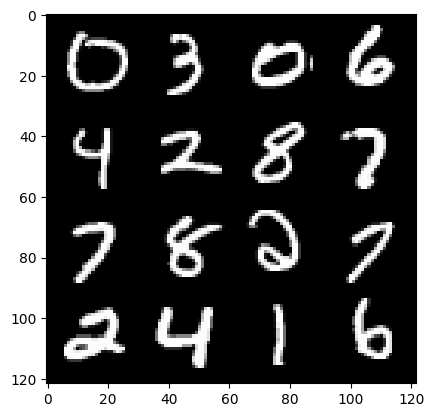

41: step 19500 / Gen loss 5.84567020893097 / Disc loss 0.04380999578783911


  0%|          | 0/469 [00:00<?, ?it/s]

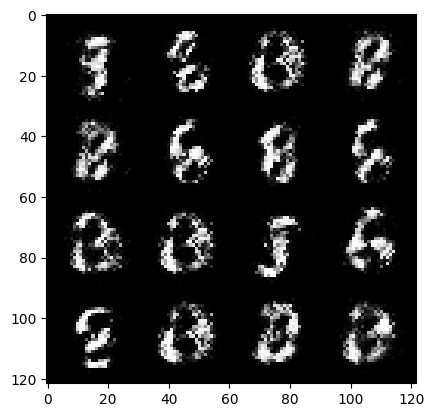

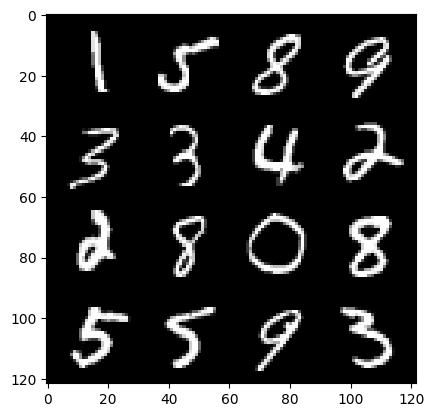

42: step 19800 / Gen loss 6.185692556699116 / Disc loss 0.04358711604028942


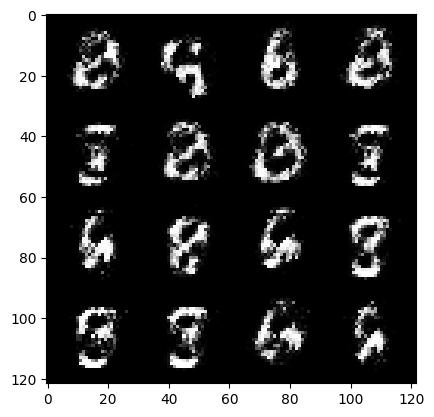

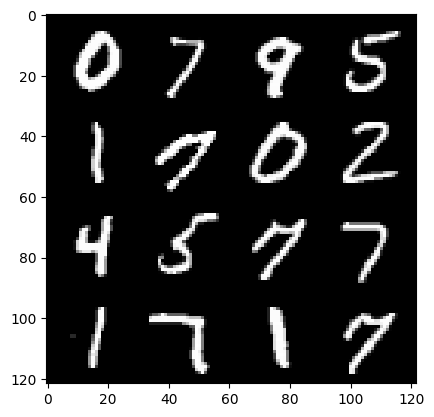

42: step 20100 / Gen loss 5.659951955477396 / Disc loss 0.04311645271256565


  0%|          | 0/469 [00:00<?, ?it/s]

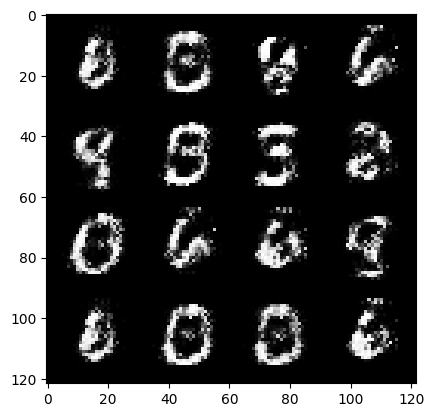

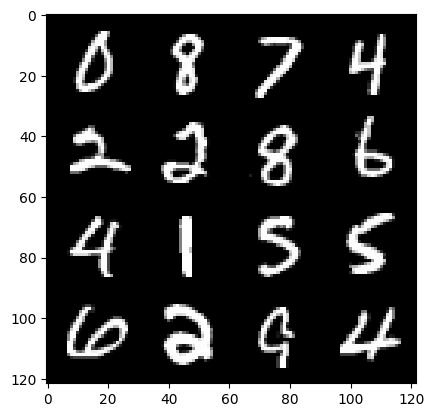

43: step 20400 / Gen loss 5.9957626676559475 / Disc loss 0.04304057153562708


  0%|          | 0/469 [00:00<?, ?it/s]

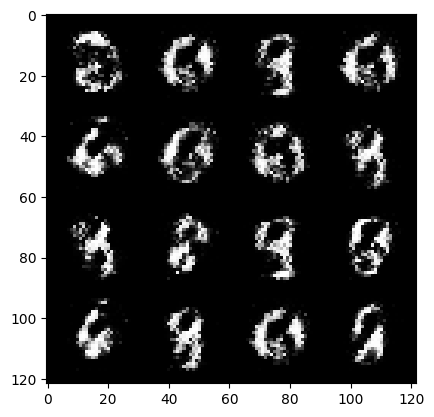

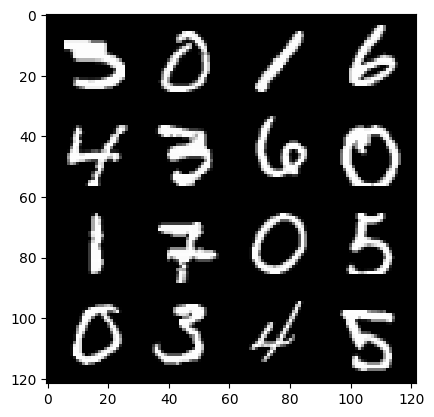

44: step 20700 / Gen loss 5.615913225809733 / Disc loss 0.04059199984185398


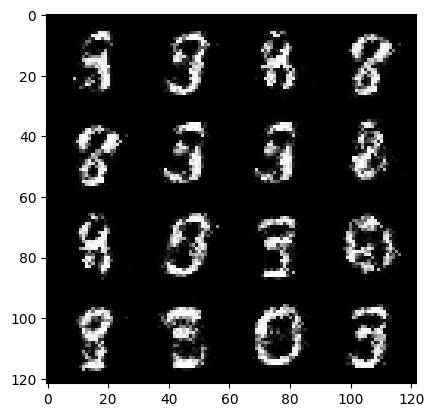

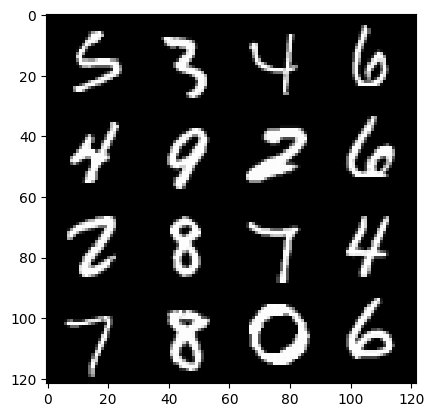

44: step 21000 / Gen loss 5.324604886372886 / Disc loss 0.046433500240867315


  0%|          | 0/469 [00:00<?, ?it/s]

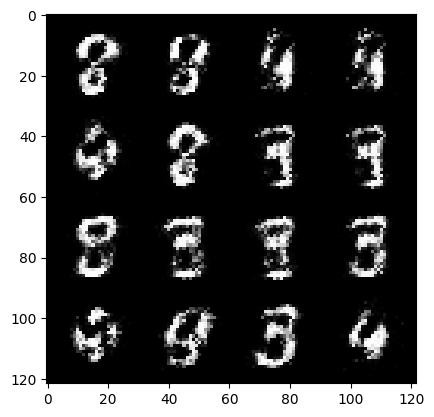

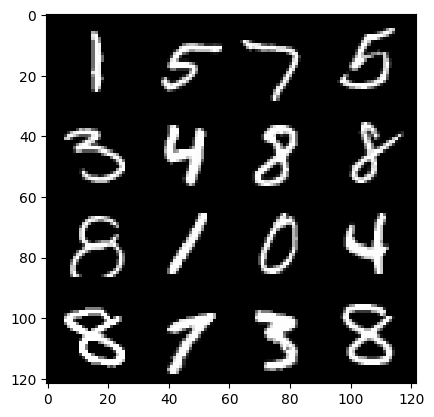

45: step 21300 / Gen loss 5.479068640073135 / Disc loss 0.045632137820745516


  0%|          | 0/469 [00:00<?, ?it/s]

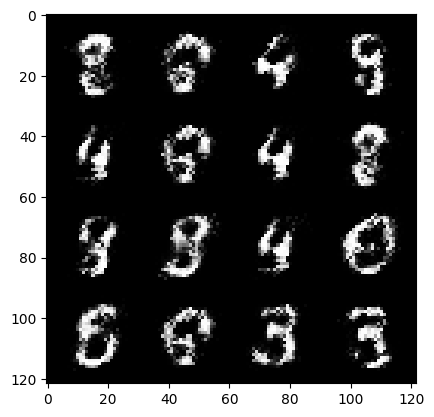

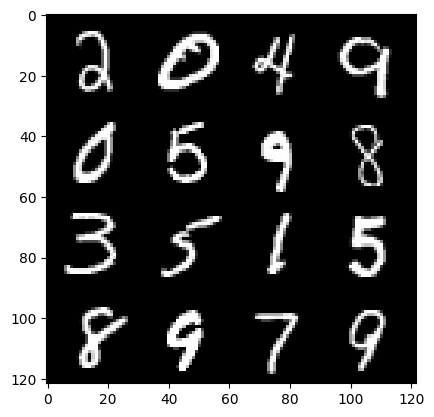

46: step 21600 / Gen loss 5.507630189259846 / Disc loss 0.04091217000968758


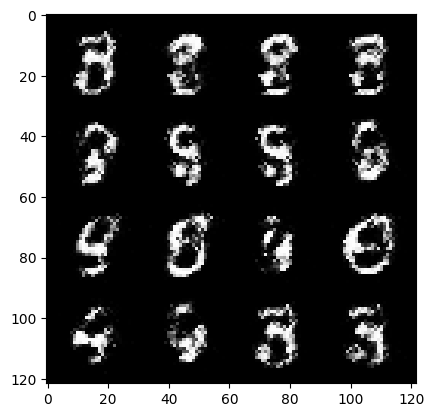

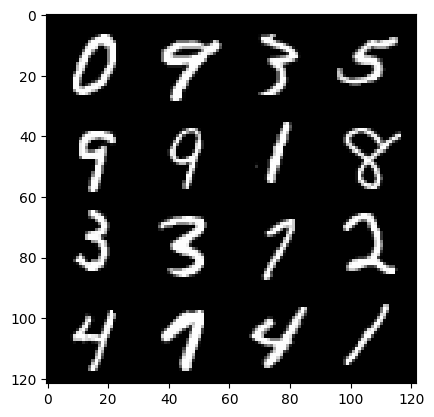

46: step 21900 / Gen loss 5.592369453112286 / Disc loss 0.0403434554456423


  0%|          | 0/469 [00:00<?, ?it/s]

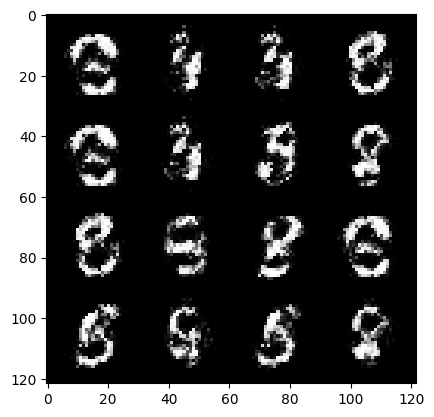

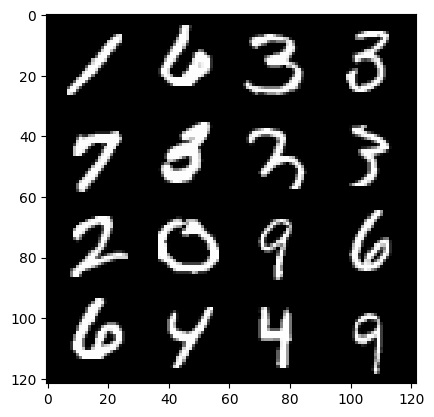

47: step 22200 / Gen loss 5.409432784716292 / Disc loss 0.04513266741919023


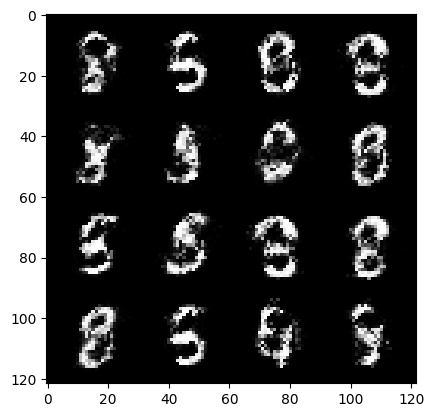

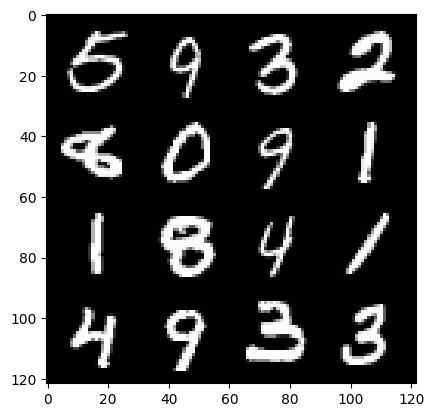

47: step 22500 / Gen loss 5.344899538358054 / Disc loss 0.047698303014039996


  0%|          | 0/469 [00:00<?, ?it/s]

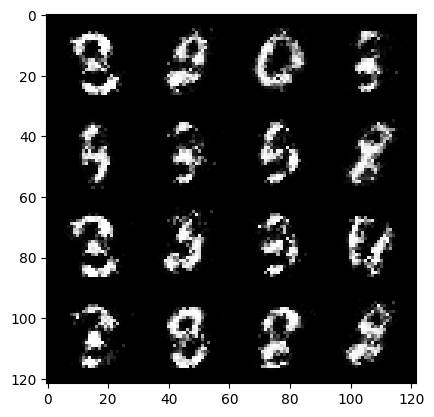

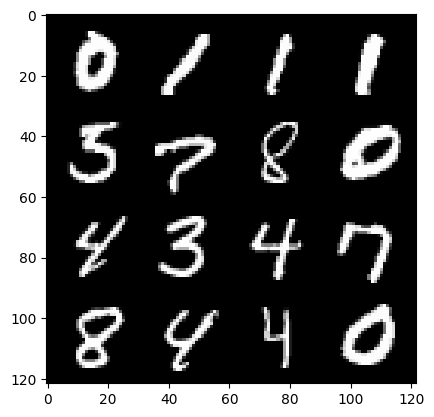

48: step 22800 / Gen loss 5.462203534444174 / Disc loss 0.049250045036897075


  0%|          | 0/469 [00:00<?, ?it/s]

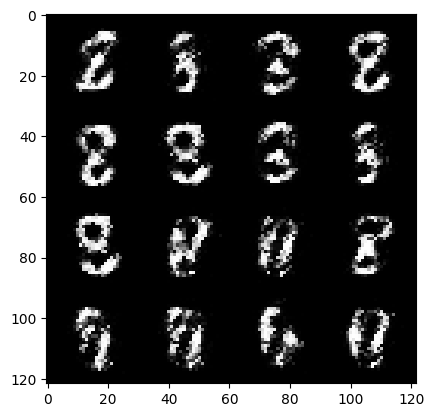

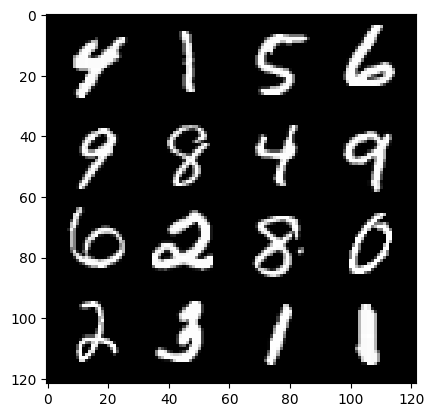

49: step 23100 / Gen loss 5.474015124638874 / Disc loss 0.04907416897205017


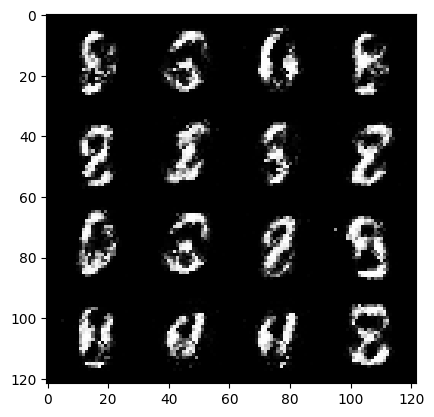

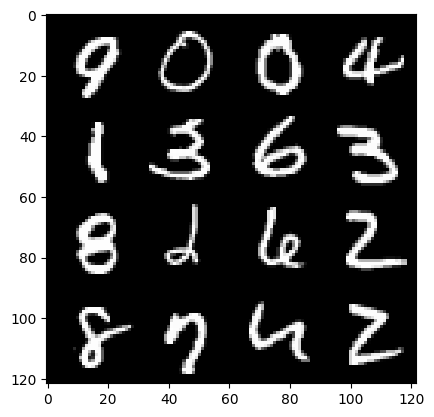

49: step 23400 / Gen loss 5.3285809421539305 / Disc loss 0.05092690242143967


  0%|          | 0/469 [00:00<?, ?it/s]

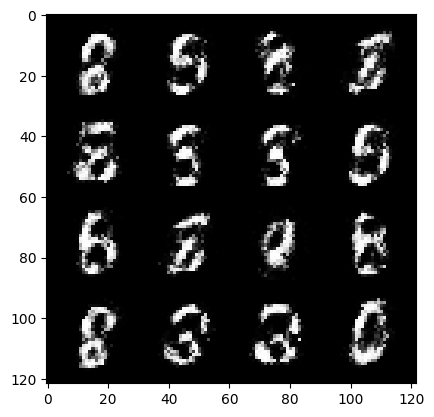

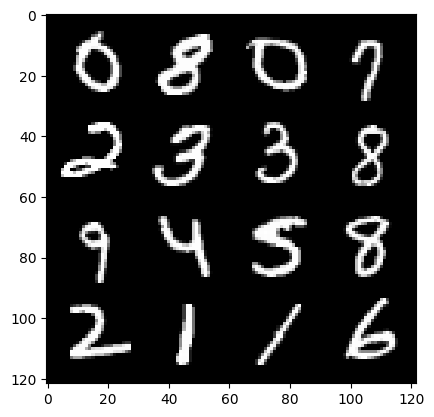

50: step 23700 / Gen loss 4.991664192676546 / Disc loss 0.06092910703892505


  0%|          | 0/469 [00:00<?, ?it/s]

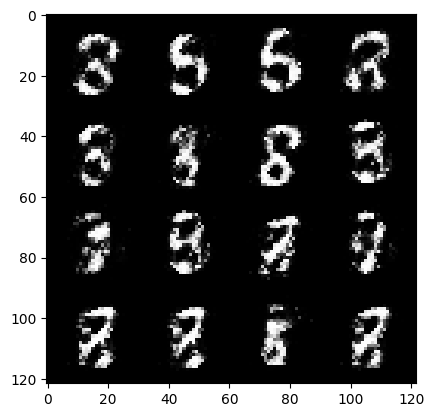

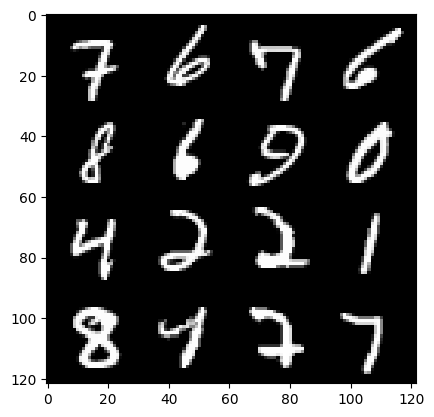

51: step 24000 / Gen loss 4.757154382069905 / Disc loss 0.05615790022537105


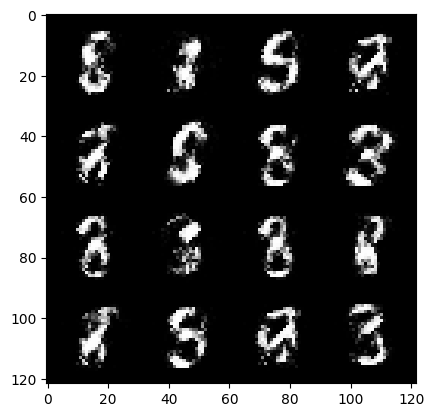

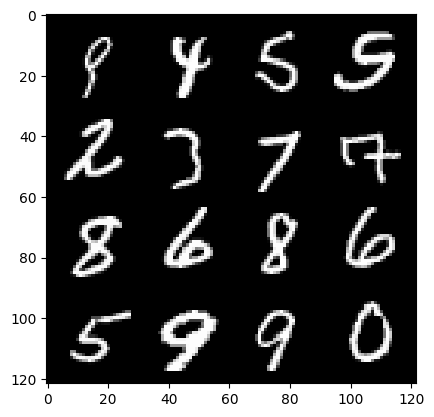

51: step 24300 / Gen loss 5.027390079498287 / Disc loss 0.05647123426509396


  0%|          | 0/469 [00:00<?, ?it/s]

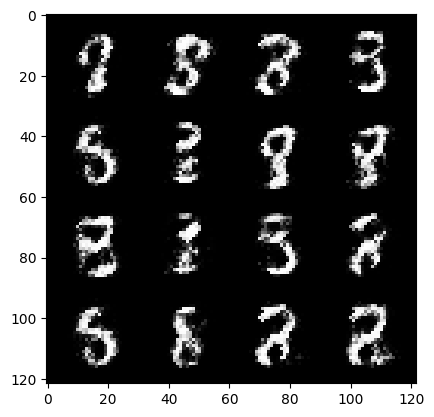

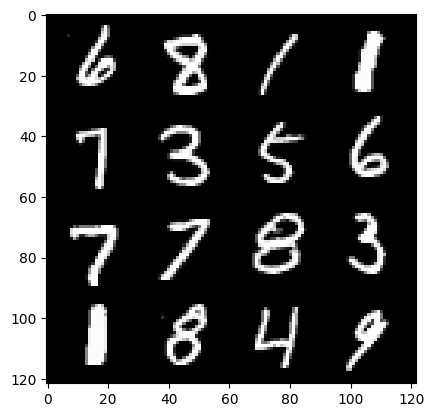

52: step 24600 / Gen loss 5.069536893367769 / Disc loss 0.05600020769362645


  0%|          | 0/469 [00:00<?, ?it/s]

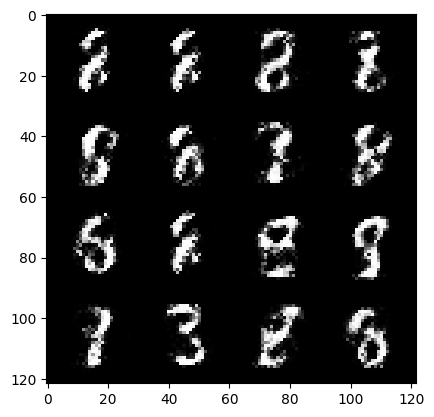

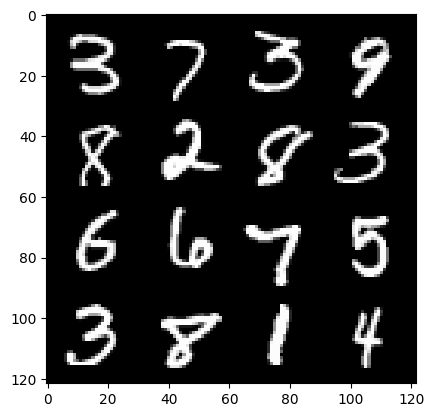

53: step 24900 / Gen loss 4.734566954771672 / Disc loss 0.06043960223595299


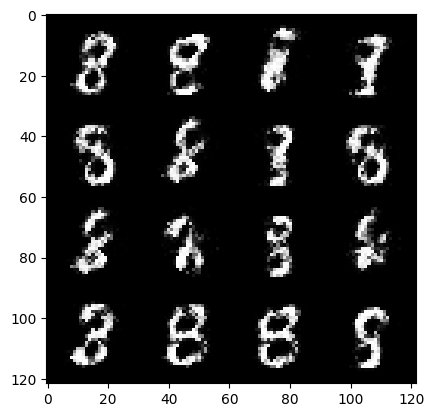

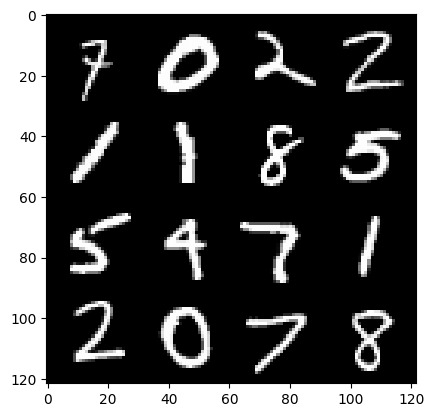

53: step 25200 / Gen loss 4.839358030954996 / Disc loss 0.06110733556561175


  0%|          | 0/469 [00:00<?, ?it/s]

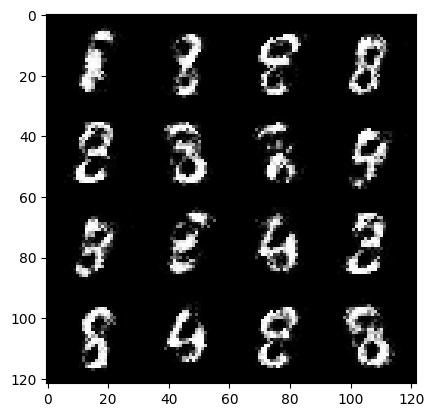

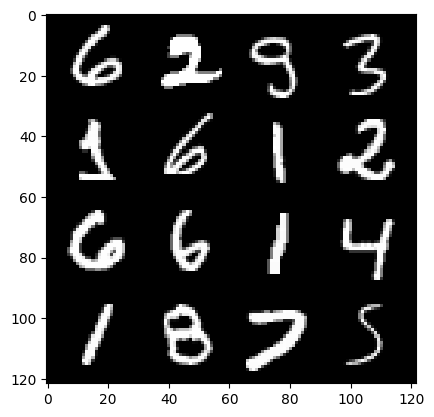

54: step 25500 / Gen loss 4.82552387237549 / Disc loss 0.06466329608112575


  0%|          | 0/469 [00:00<?, ?it/s]

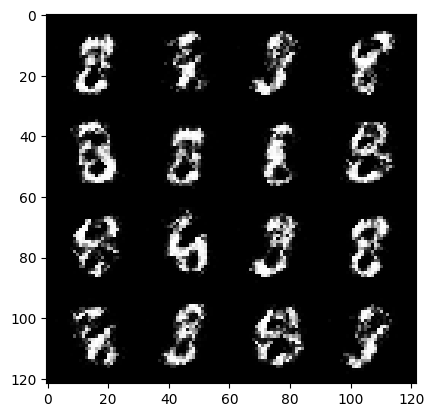

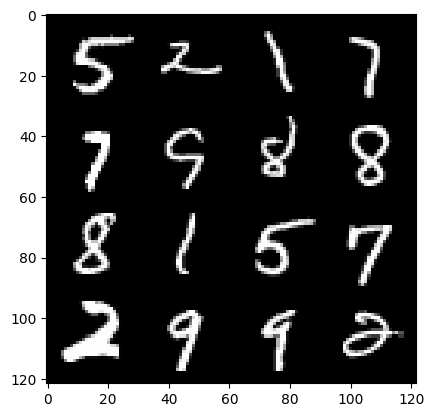

55: step 25800 / Gen loss 4.762121759255728 / Disc loss 0.06866033364708225


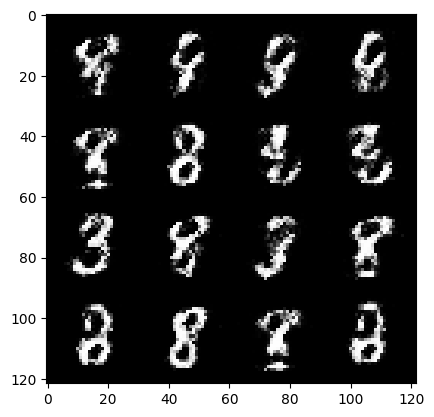

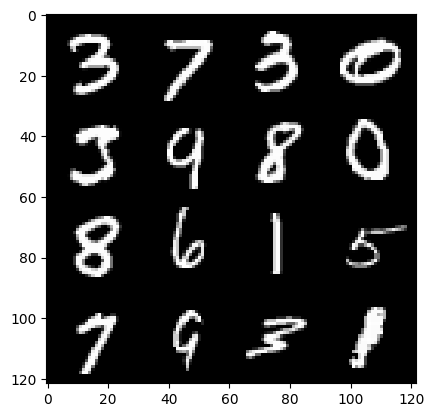

55: step 26100 / Gen loss 5.084505592187247 / Disc loss 0.07040278814733035


  0%|          | 0/469 [00:00<?, ?it/s]

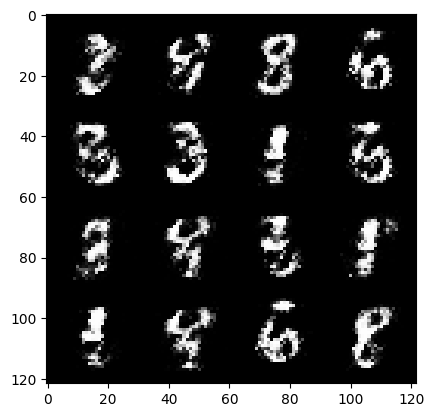

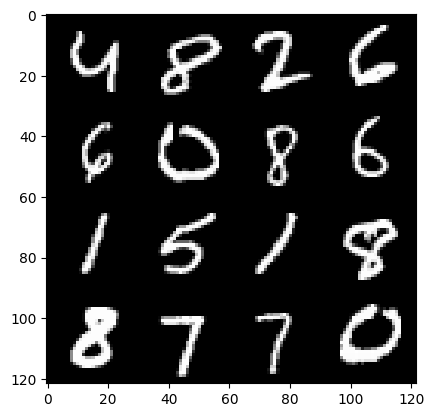

56: step 26400 / Gen loss 5.1296057136853515 / Disc loss 0.07276238209257524


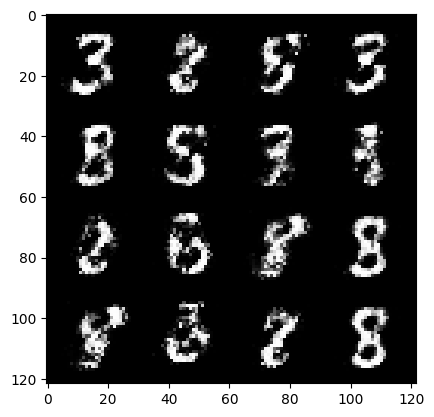

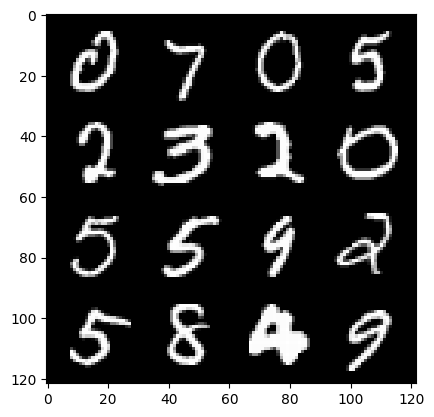

56: step 26700 / Gen loss 5.007236049969993 / Disc loss 0.08220761269330983


  0%|          | 0/469 [00:00<?, ?it/s]

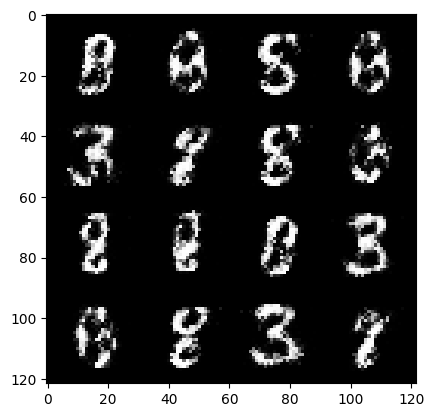

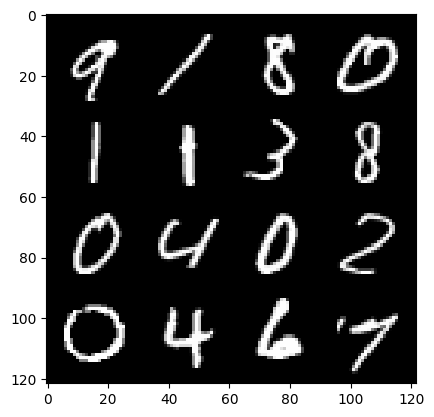

57: step 27000 / Gen loss 4.731735940774281 / Disc loss 0.08231462483604751


  0%|          | 0/469 [00:00<?, ?it/s]

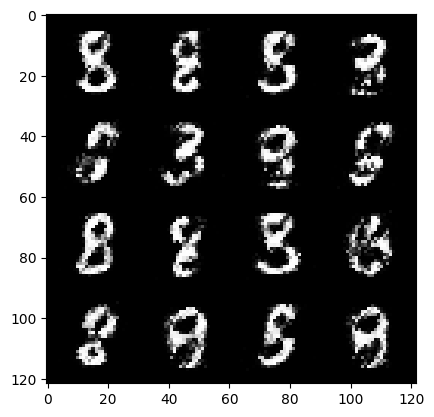

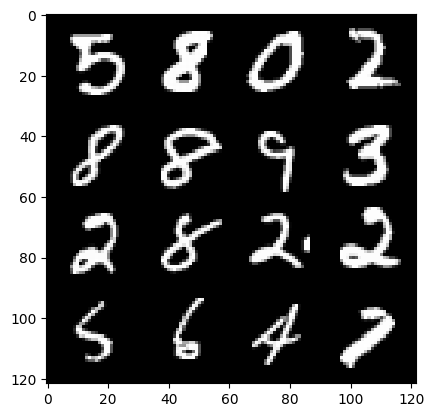

58: step 27300 / Gen loss 4.907016901969907 / Disc loss 0.0777345285813014


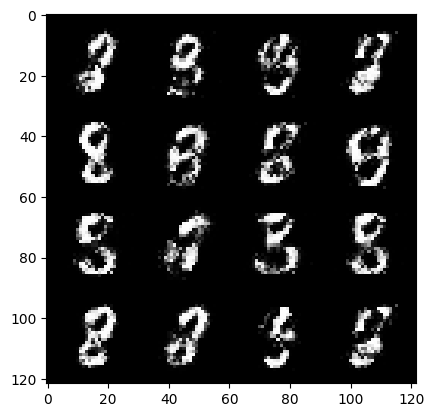

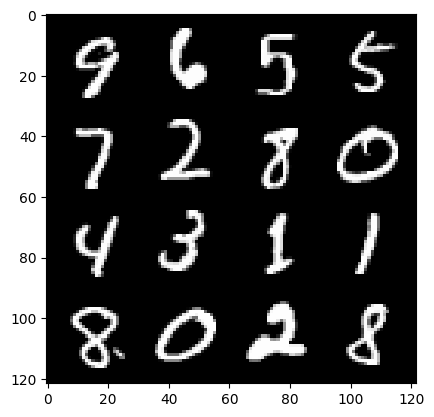

58: step 27600 / Gen loss 4.797580565611519 / Disc loss 0.0848634127589563


  0%|          | 0/469 [00:00<?, ?it/s]

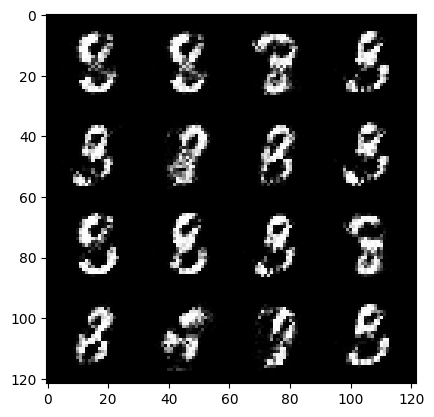

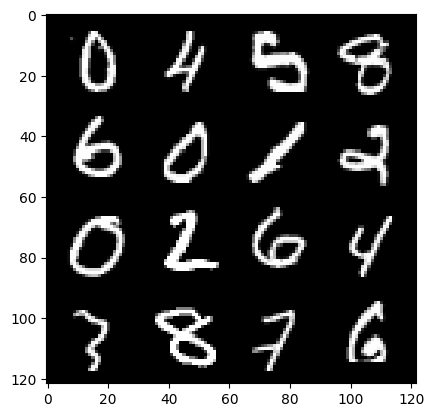

59: step 27900 / Gen loss 4.644665788809459 / Disc loss 0.08561513244484864


  0%|          | 0/469 [00:00<?, ?it/s]

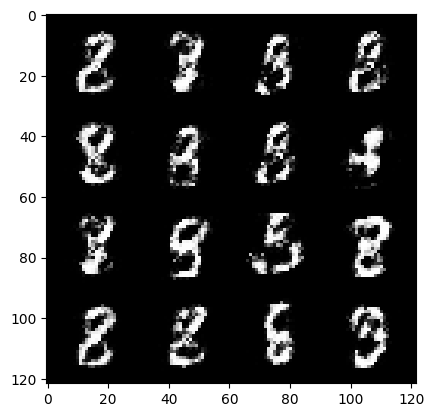

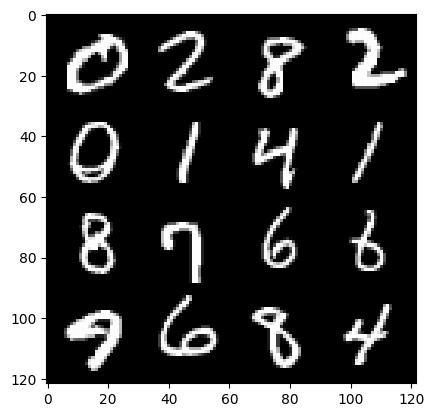

60: step 28200 / Gen loss 4.8061403473218265 / Disc loss 0.09251666354636354


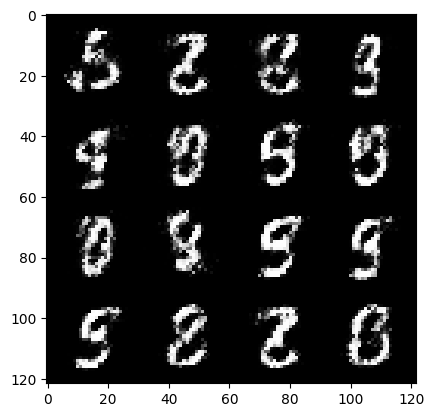

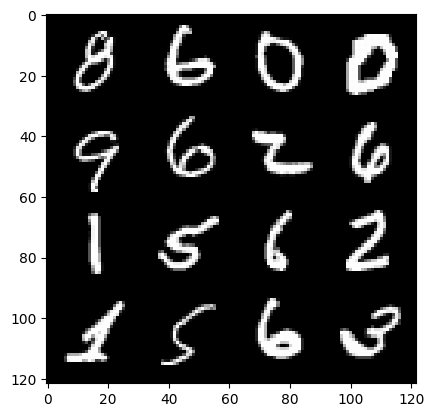

60: step 28500 / Gen loss 4.741843262513478 / Disc loss 0.08226214634254579


  0%|          | 0/469 [00:00<?, ?it/s]

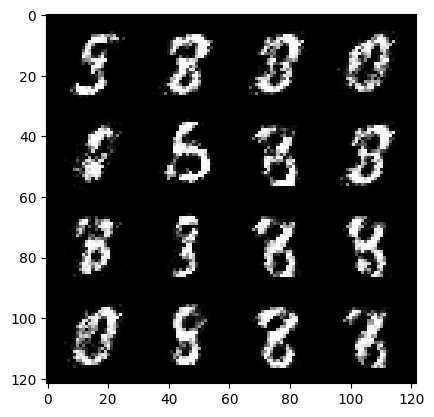

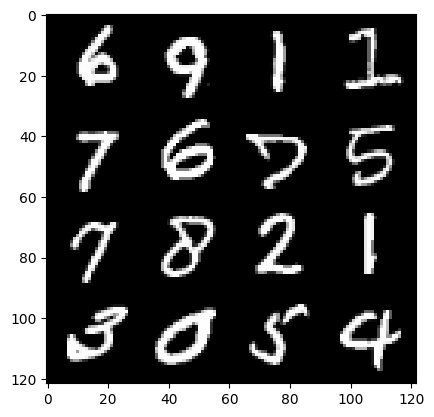

61: step 28800 / Gen loss 4.577961236635843 / Disc loss 0.08432689680407444


  0%|          | 0/469 [00:00<?, ?it/s]

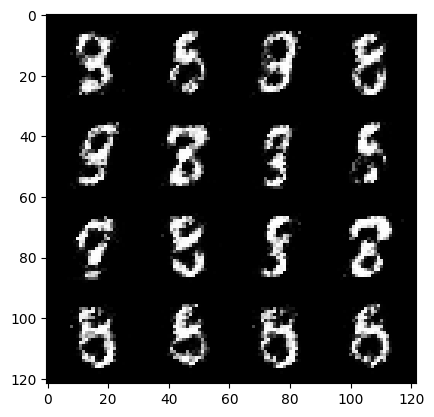

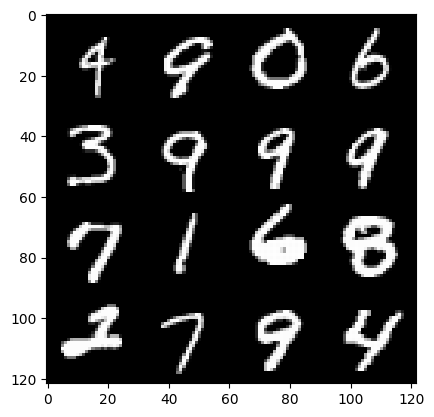

62: step 29100 / Gen loss 4.751674539248147 / Disc loss 0.0651565101866921


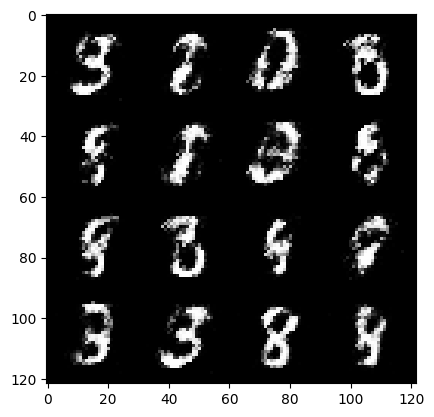

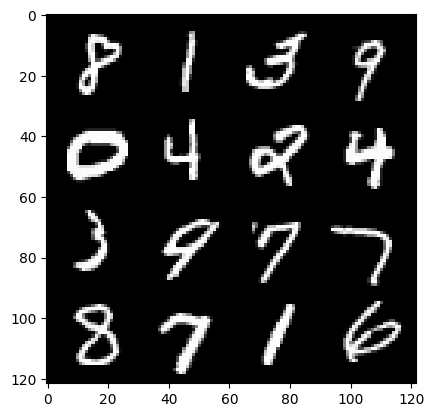

62: step 29400 / Gen loss 4.761211096445722 / Disc loss 0.07873698507125175


  0%|          | 0/469 [00:00<?, ?it/s]

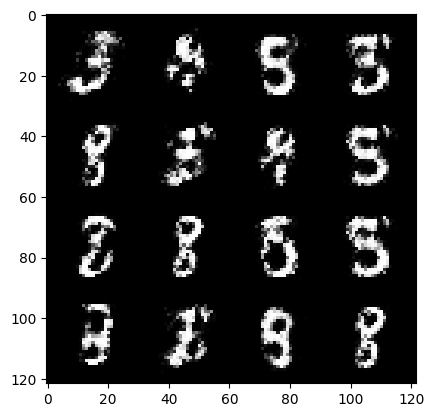

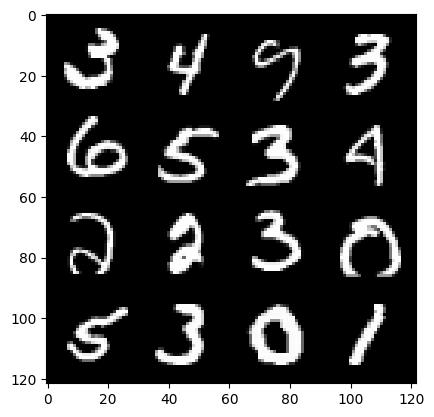

63: step 29700 / Gen loss 4.6182114712397215 / Disc loss 0.07929604060327011


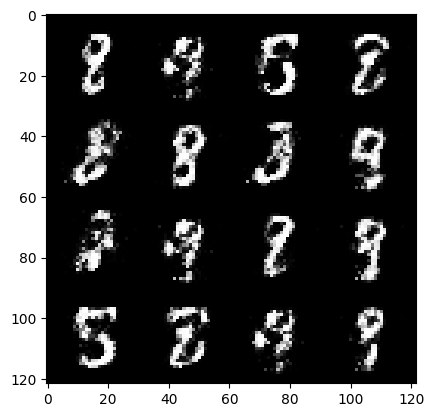

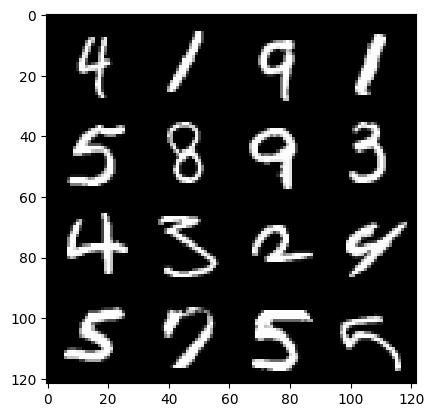

63: step 30000 / Gen loss 4.715015993118286 / Disc loss 0.08446567292014759


  0%|          | 0/469 [00:00<?, ?it/s]

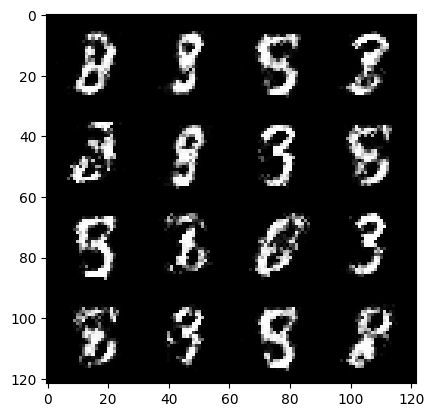

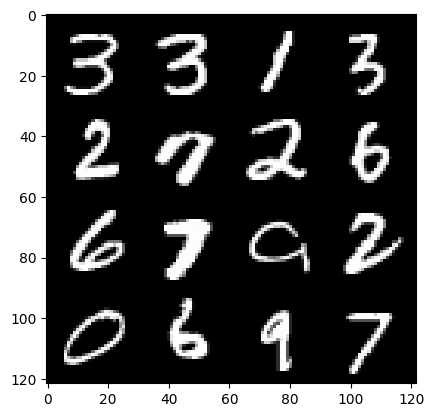

64: step 30300 / Gen loss 4.605251618226372 / Disc loss 0.08848937398443614


  0%|          | 0/469 [00:00<?, ?it/s]

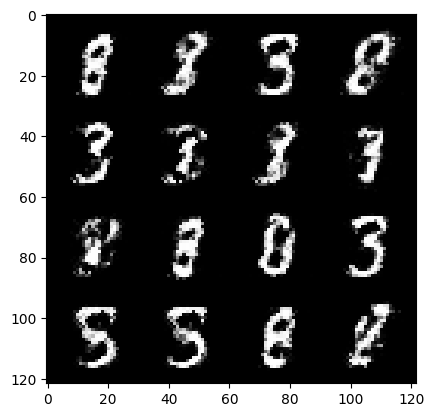

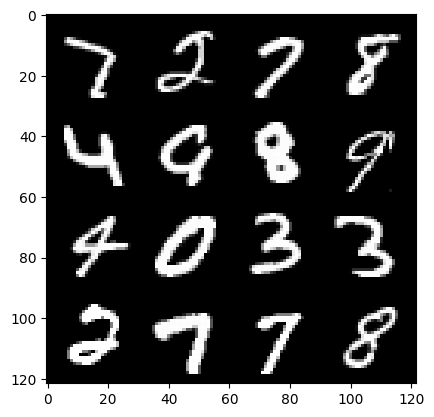

65: step 30600 / Gen loss 4.716217497189836 / Disc loss 0.08872279802958165


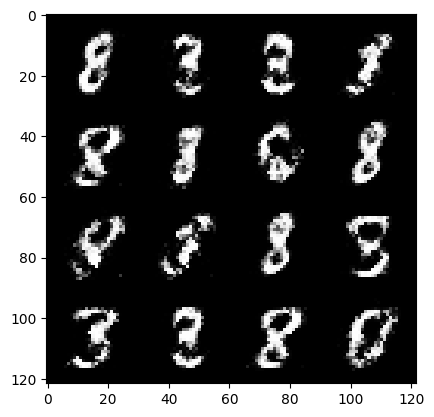

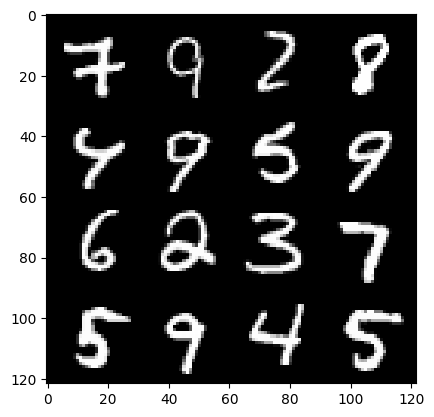

65: step 30900 / Gen loss 4.524028418064118 / Disc loss 0.08649435779700679


  0%|          | 0/469 [00:00<?, ?it/s]

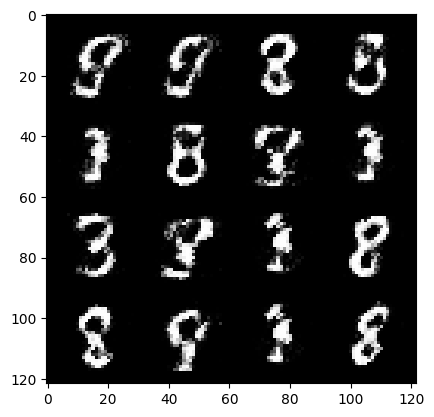

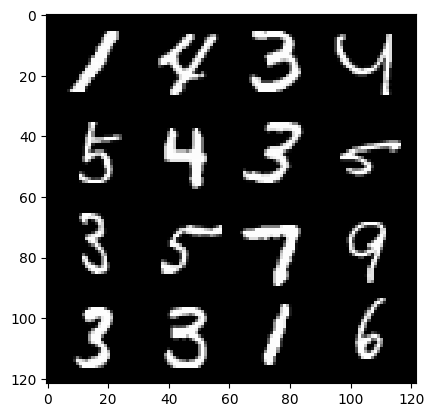

66: step 31200 / Gen loss 4.616407803694408 / Disc loss 0.09286867558956148


  0%|          | 0/469 [00:00<?, ?it/s]

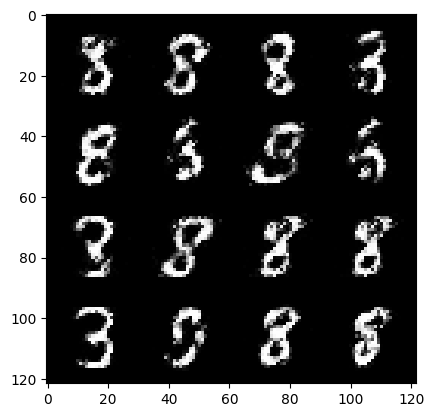

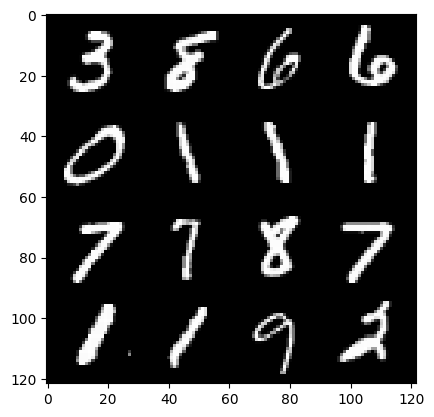

67: step 31500 / Gen loss 4.635417783260344 / Disc loss 0.08707335239897172


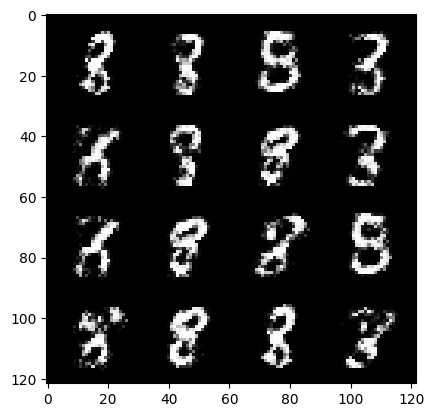

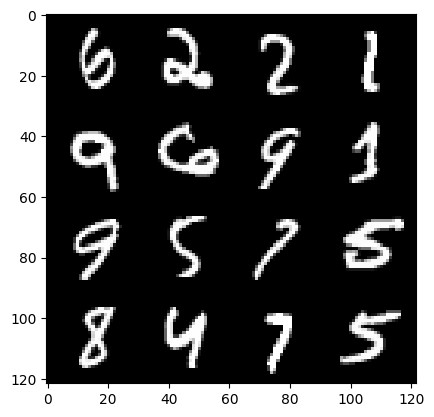

67: step 31800 / Gen loss 4.587146283785505 / Disc loss 0.08225169615199171


  0%|          | 0/469 [00:00<?, ?it/s]

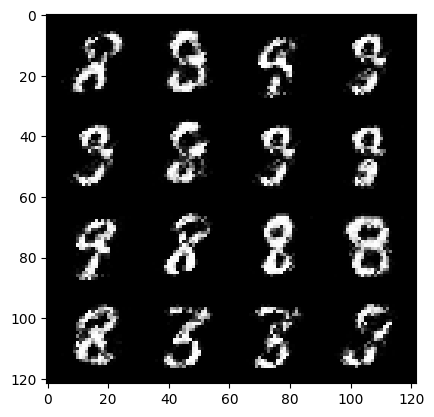

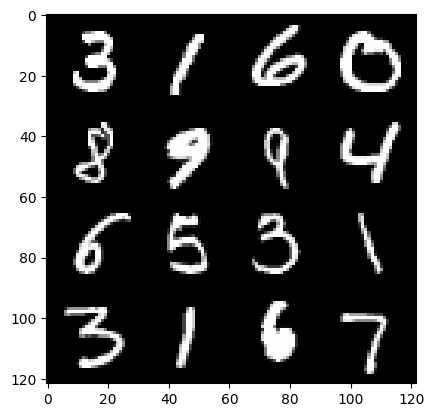

68: step 32100 / Gen loss 4.474330848852794 / Disc loss 0.10453328250596906


  0%|          | 0/469 [00:00<?, ?it/s]

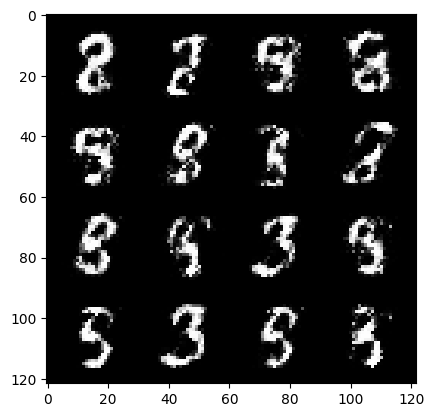

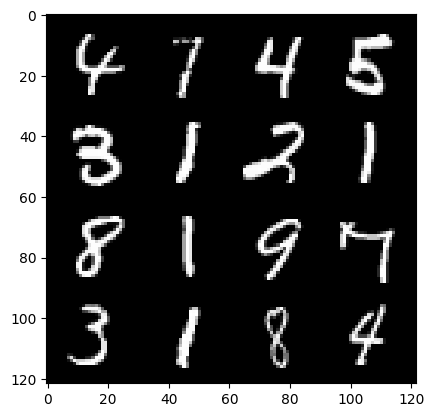

69: step 32400 / Gen loss 4.3706094058354665 / Disc loss 0.11933350476746761


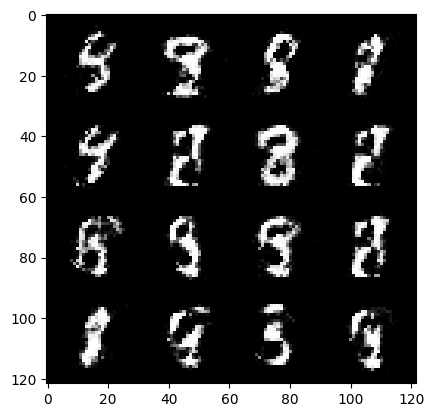

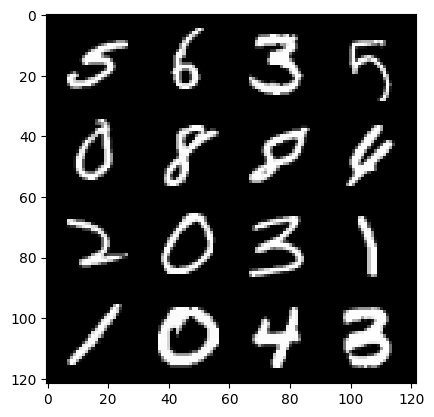

69: step 32700 / Gen loss 4.29248393853506 / Disc loss 0.11061566377058617


  0%|          | 0/469 [00:00<?, ?it/s]

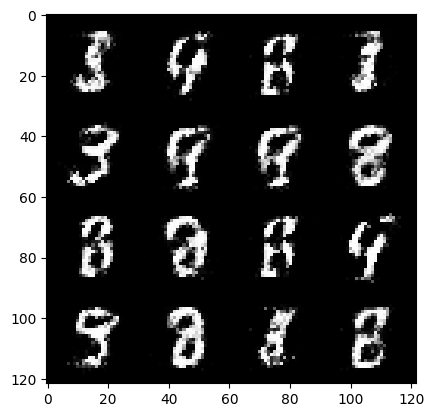

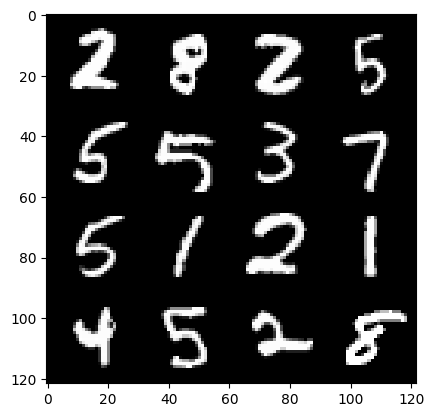

70: step 33000 / Gen loss 4.22387075185776 / Disc loss 0.10523424862573544


  0%|          | 0/469 [00:00<?, ?it/s]

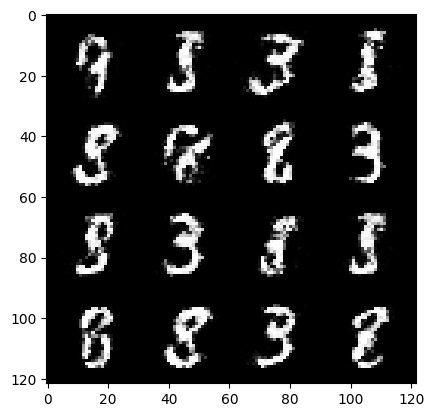

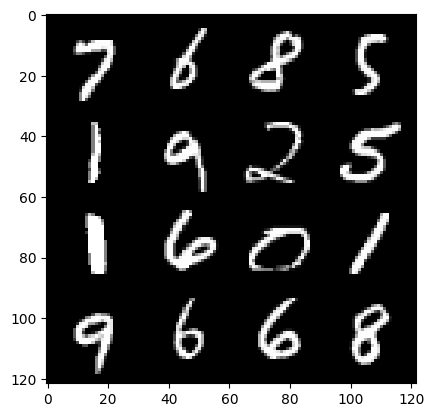

71: step 33300 / Gen loss 4.353439939816794 / Disc loss 0.09225567563126476


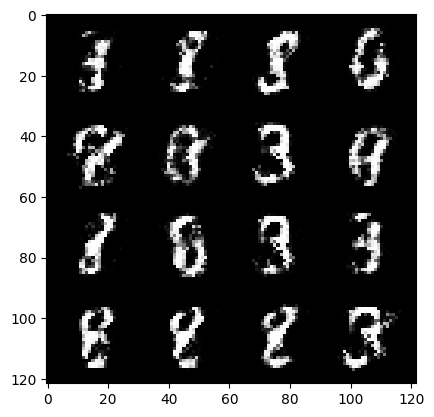

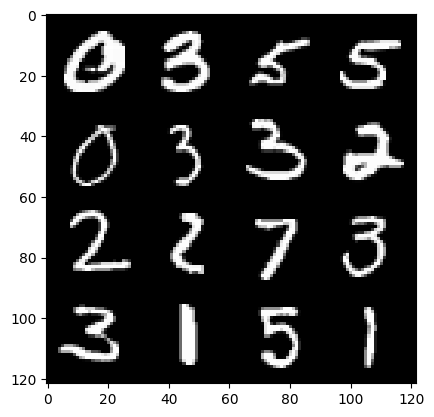

71: step 33600 / Gen loss 4.267224131425221 / Disc loss 0.10860764376198255


  0%|          | 0/469 [00:00<?, ?it/s]

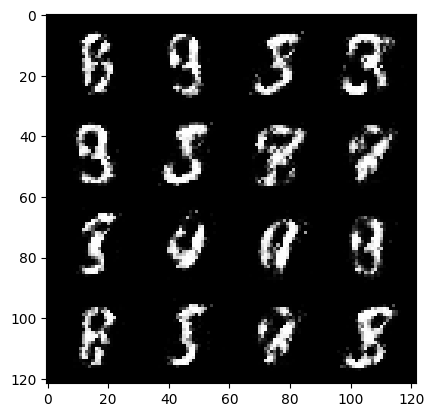

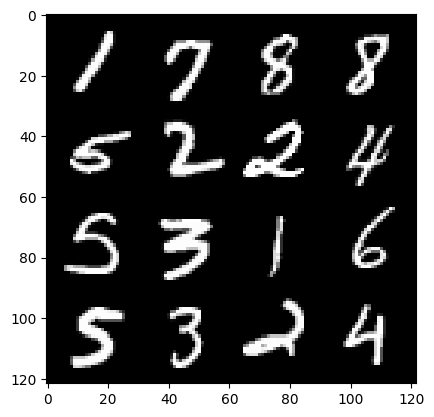

72: step 33900 / Gen loss 4.42754145224889 / Disc loss 0.102650285003086


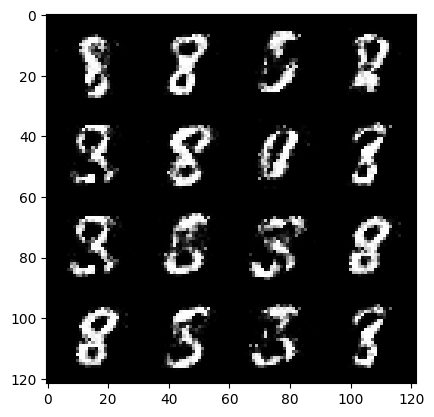

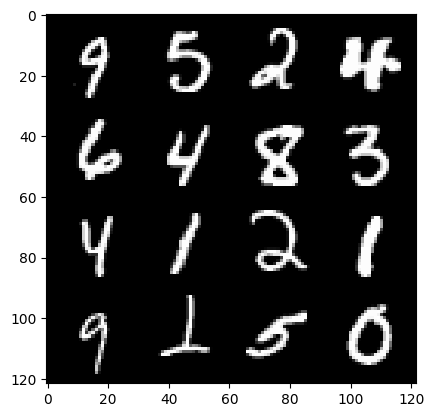

72: step 34200 / Gen loss 4.273298024336499 / Disc loss 0.0994697490955393


  0%|          | 0/469 [00:00<?, ?it/s]

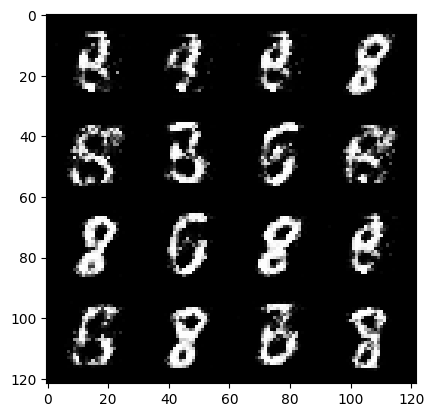

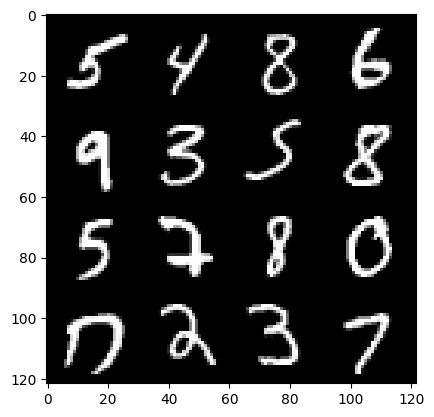

73: step 34500 / Gen loss 4.282909365495043 / Disc loss 0.1059529583404461


  0%|          | 0/469 [00:00<?, ?it/s]

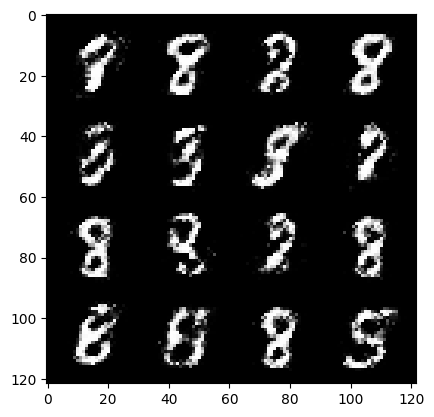

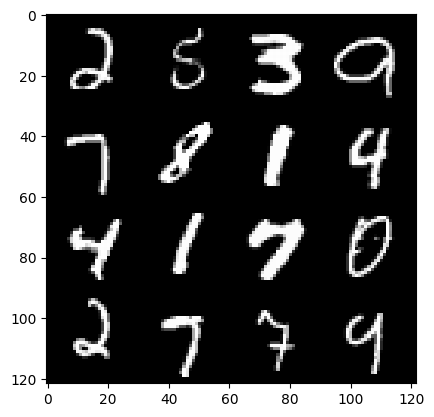

74: step 34800 / Gen loss 4.287310937245686 / Disc loss 0.1198047229771813


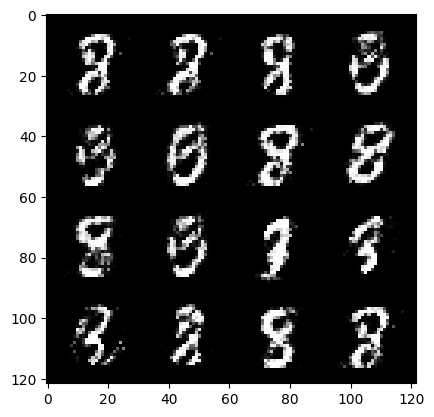

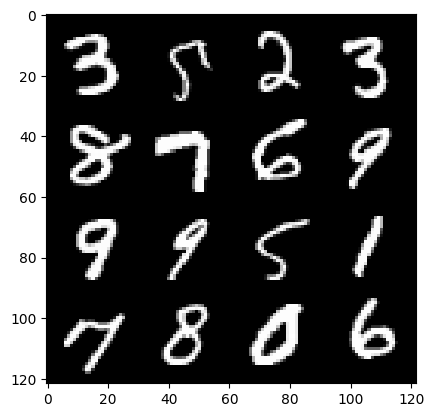

74: step 35100 / Gen loss 4.373580074310301 / Disc loss 0.1042366161694129


  0%|          | 0/469 [00:00<?, ?it/s]

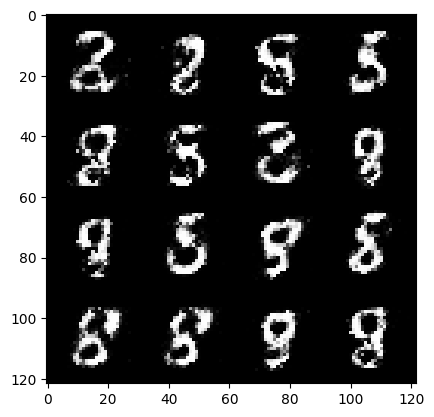

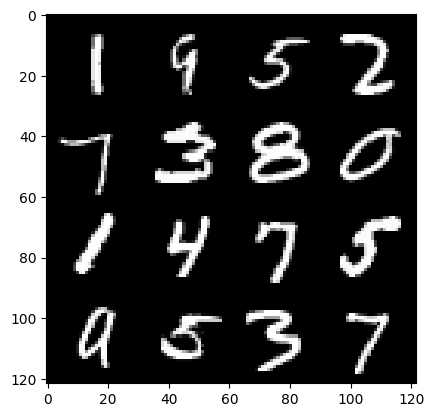

75: step 35400 / Gen loss 4.128897335529327 / Disc loss 0.12108214814215901


  0%|          | 0/469 [00:00<?, ?it/s]

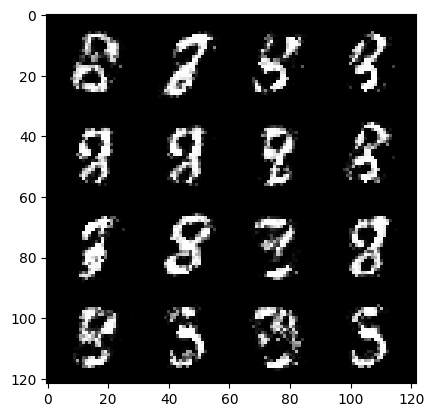

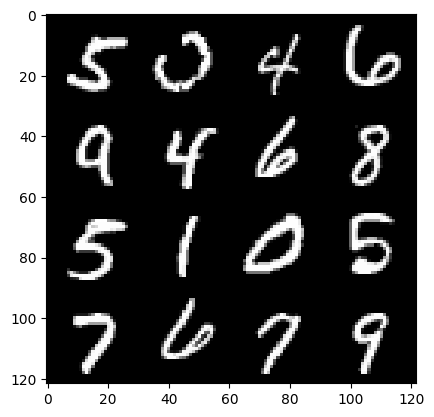

76: step 35700 / Gen loss 4.0565579700469945 / Disc loss 0.11621607560664417


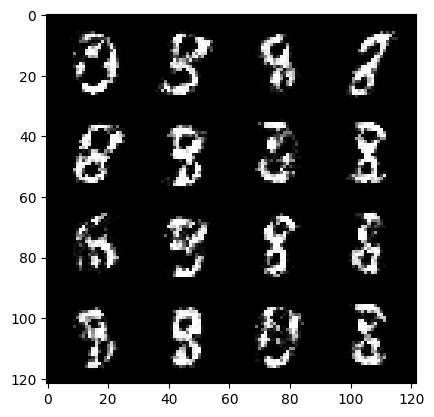

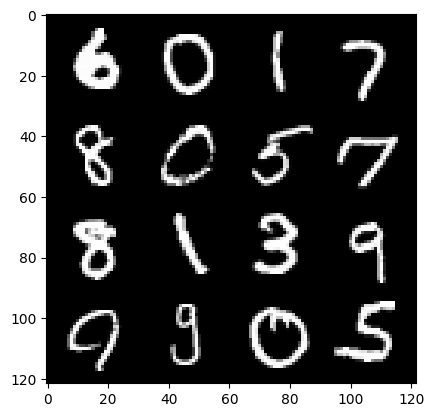

76: step 36000 / Gen loss 4.2999269255002295 / Disc loss 0.09760679097225265


  0%|          | 0/469 [00:00<?, ?it/s]

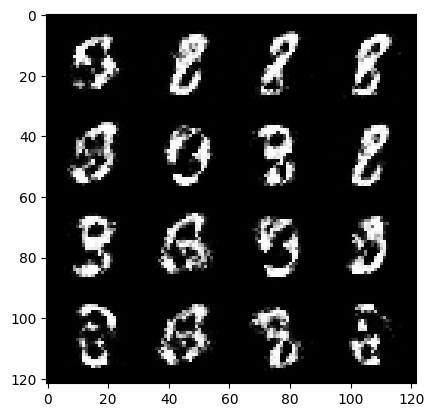

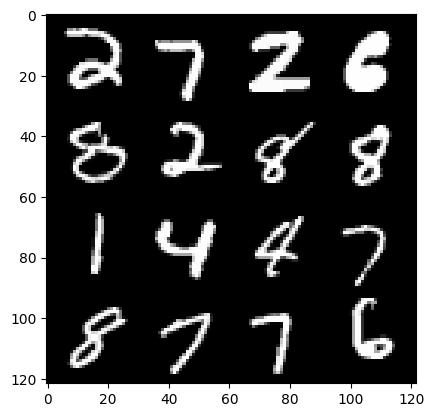

77: step 36300 / Gen loss 4.272465431690217 / Disc loss 0.11641480453312399


  0%|          | 0/469 [00:00<?, ?it/s]

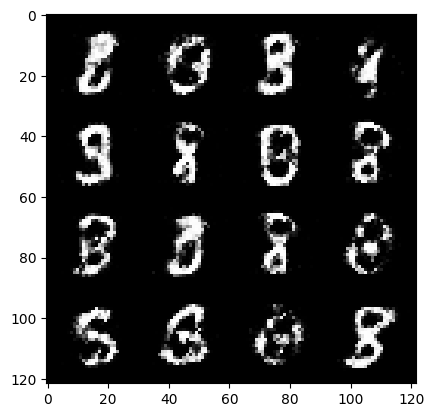

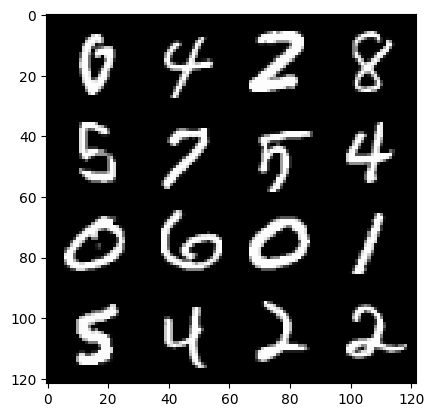

78: step 36600 / Gen loss 4.099423590501152 / Disc loss 0.11690033854295812


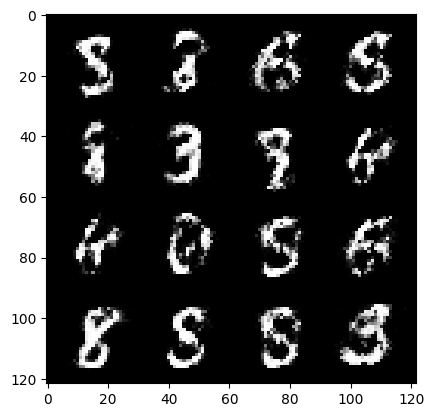

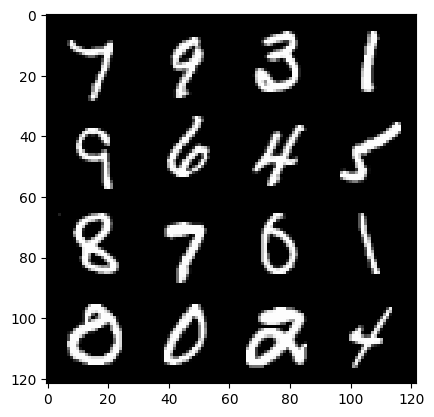

78: step 36900 / Gen loss 4.335777633984882 / Disc loss 0.11635211743414405


  0%|          | 0/469 [00:00<?, ?it/s]

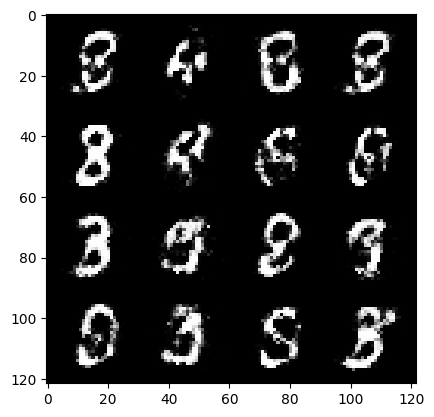

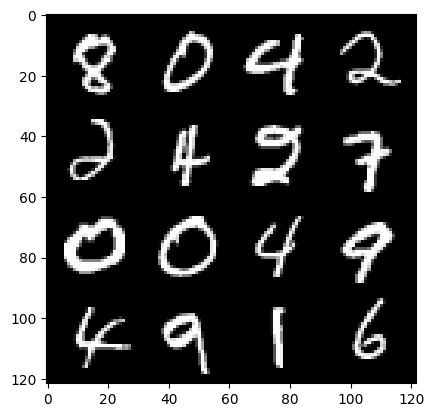

79: step 37200 / Gen loss 4.0479979395866375 / Disc loss 0.1274742940689127


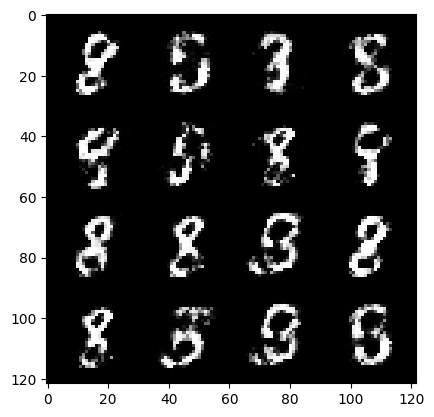

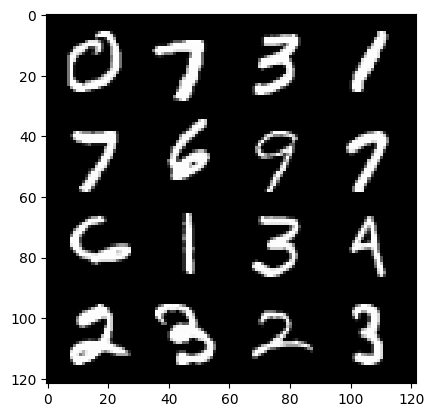

79: step 37500 / Gen loss 4.00569838205973 / Disc loss 0.12704412826647368


  0%|          | 0/469 [00:00<?, ?it/s]

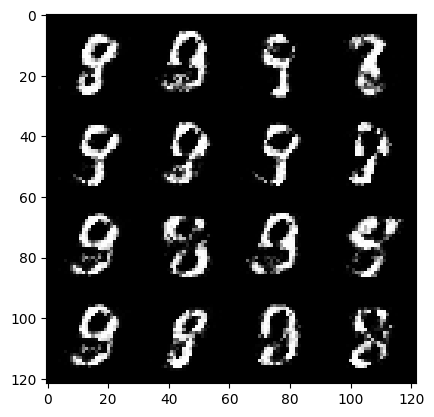

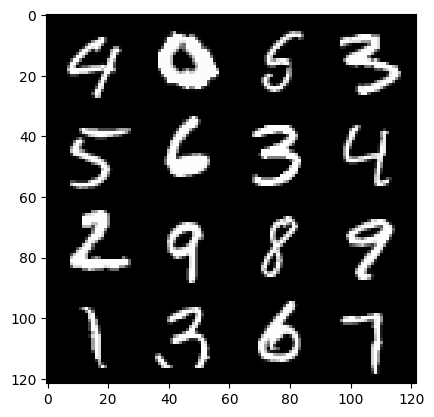

80: step 37800 / Gen loss 3.92709924062093 / Disc loss 0.12942644186317928


  0%|          | 0/469 [00:00<?, ?it/s]

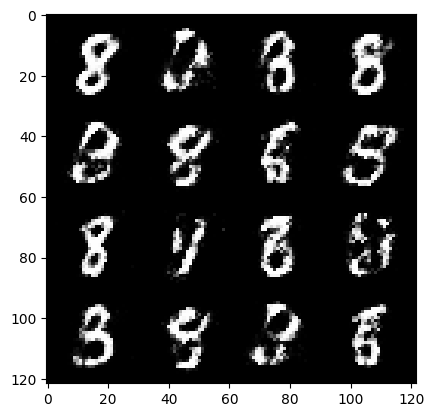

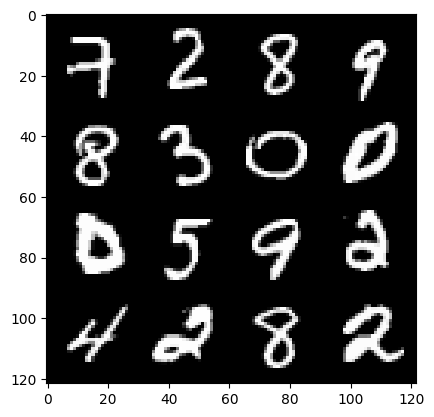

81: step 38100 / Gen loss 4.025340160528817 / Disc loss 0.1327804729466636


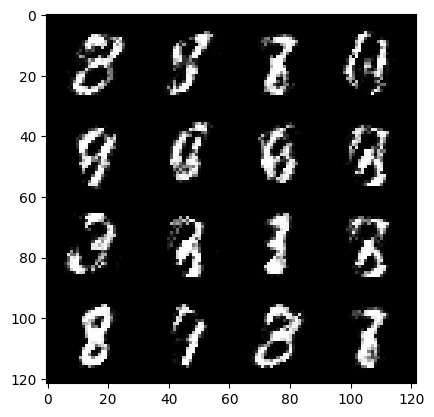

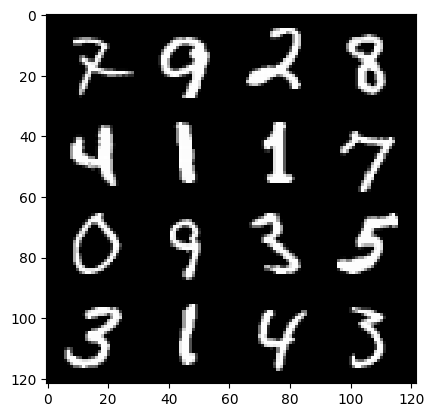

81: step 38400 / Gen loss 3.977627947330474 / Disc loss 0.1343335518365105


  0%|          | 0/469 [00:00<?, ?it/s]

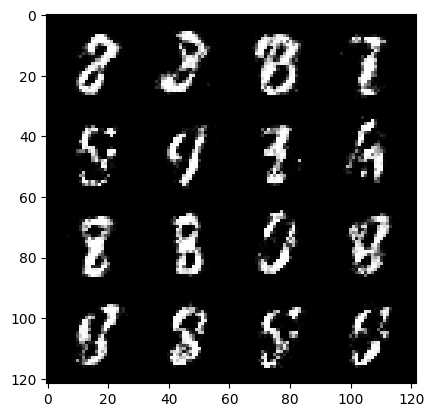

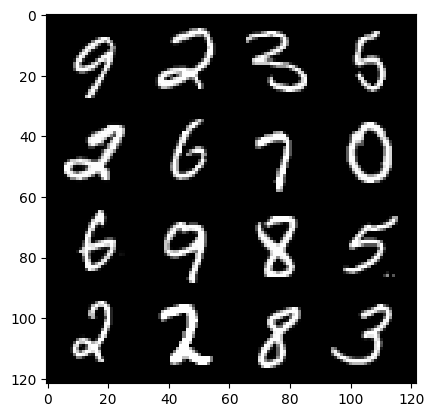

82: step 38700 / Gen loss 3.8840317233403536 / Disc loss 0.14568665360410993


  0%|          | 0/469 [00:00<?, ?it/s]

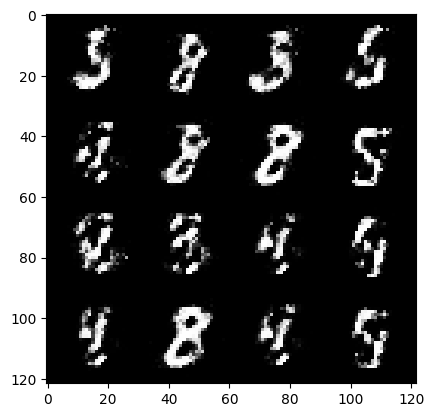

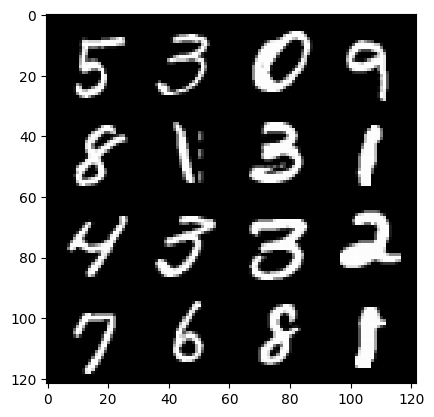

83: step 39000 / Gen loss 3.795804427464804 / Disc loss 0.1548599701498946


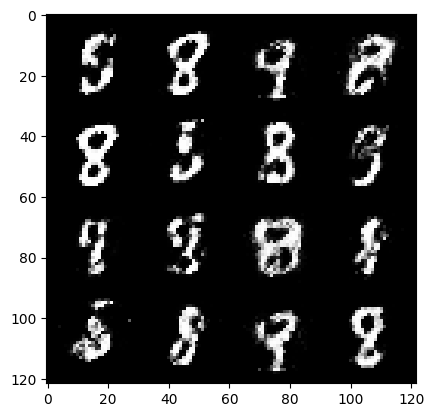

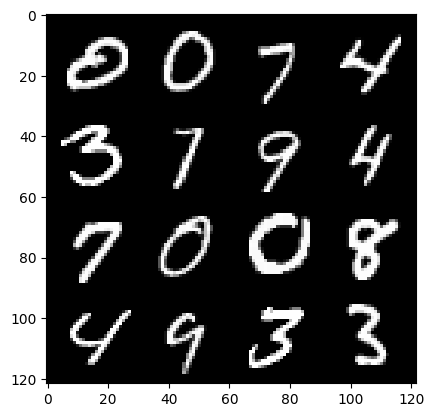

83: step 39300 / Gen loss 3.801647899945574 / Disc loss 0.14048179261386395


  0%|          | 0/469 [00:00<?, ?it/s]

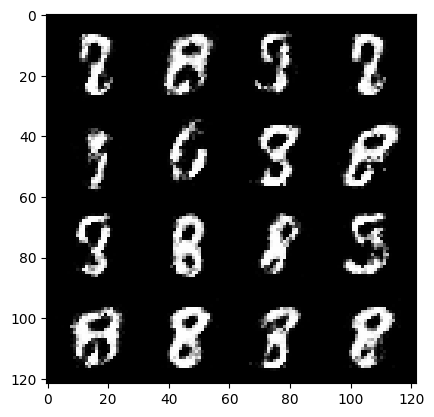

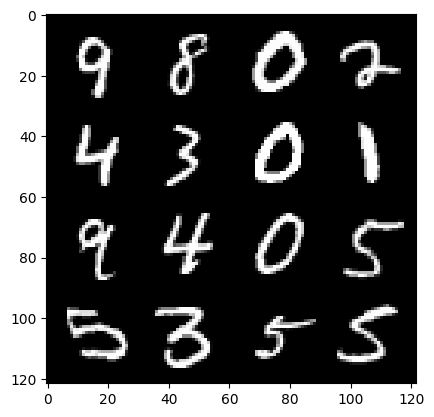

84: step 39600 / Gen loss 3.6293881726264954 / Disc loss 0.1615309219062328


  0%|          | 0/469 [00:00<?, ?it/s]

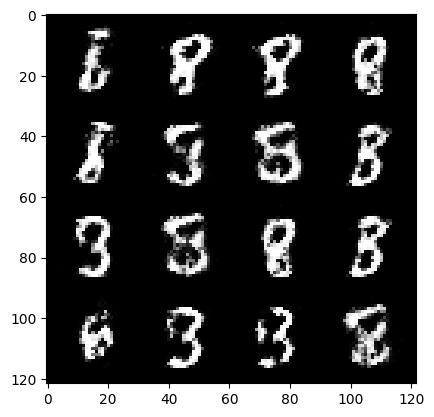

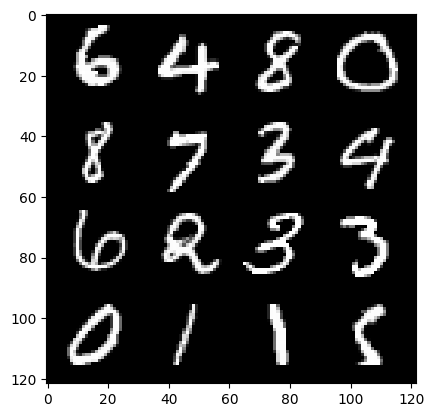

85: step 39900 / Gen loss 3.6833710789680456 / Disc loss 0.14964818488806478


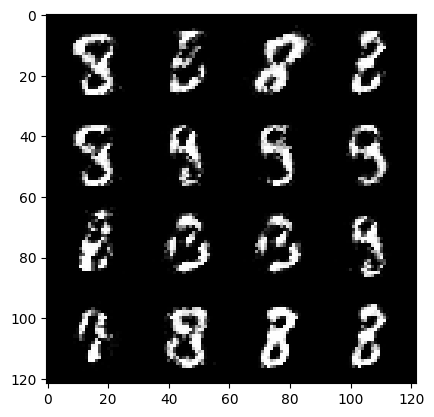

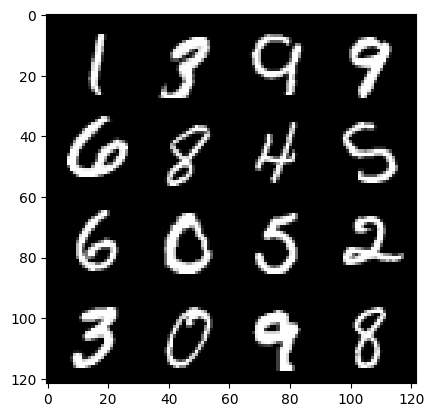

85: step 40200 / Gen loss 3.630602098306021 / Disc loss 0.16171069761117288


  0%|          | 0/469 [00:00<?, ?it/s]

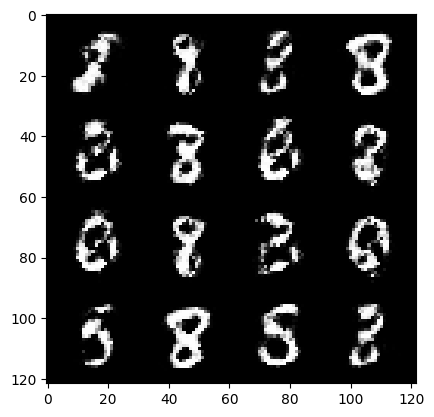

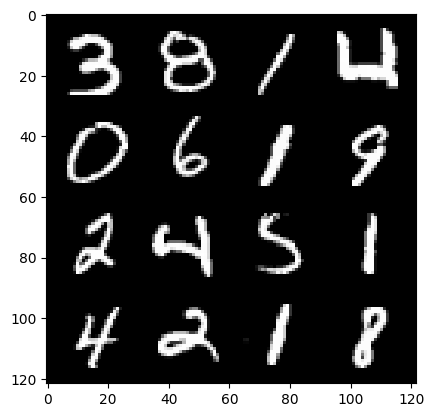

86: step 40500 / Gen loss 3.5654371102650932 / Disc loss 0.16691740113000067


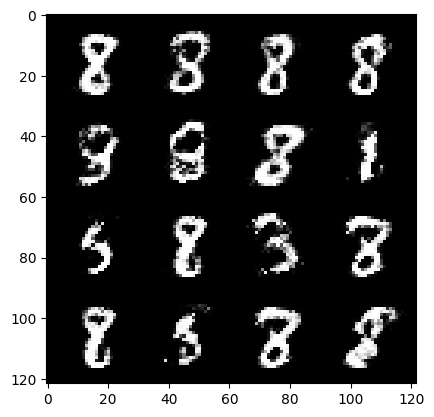

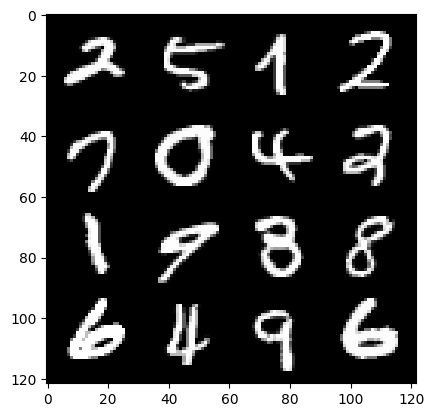

86: step 40800 / Gen loss 3.437875599861146 / Disc loss 0.18479147332410006


  0%|          | 0/469 [00:00<?, ?it/s]

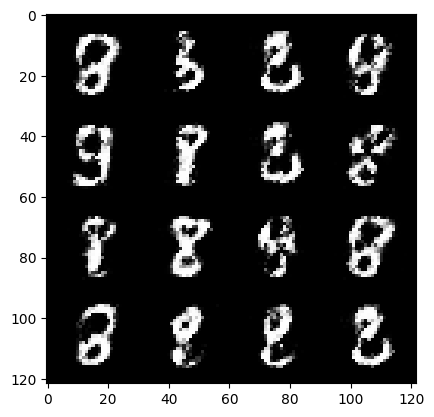

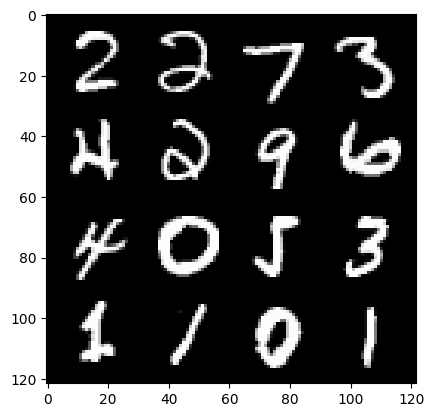

87: step 41100 / Gen loss 3.534966608683267 / Disc loss 0.16523549144466712


  0%|          | 0/469 [00:00<?, ?it/s]

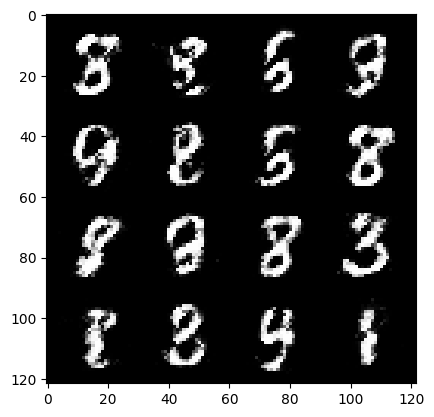

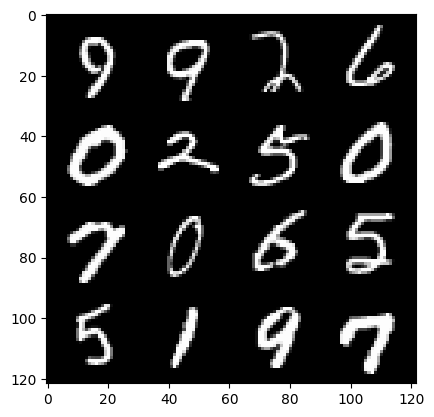

88: step 41400 / Gen loss 3.7891201972961426 / Disc loss 0.14369979863365487


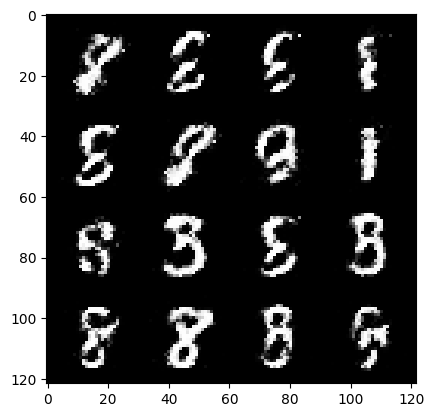

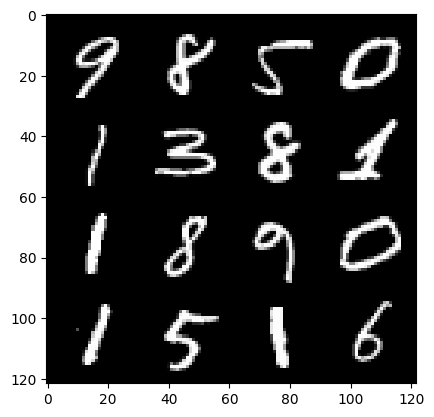

88: step 41700 / Gen loss 3.8237578900655125 / Disc loss 0.1365193174034356


  0%|          | 0/469 [00:00<?, ?it/s]

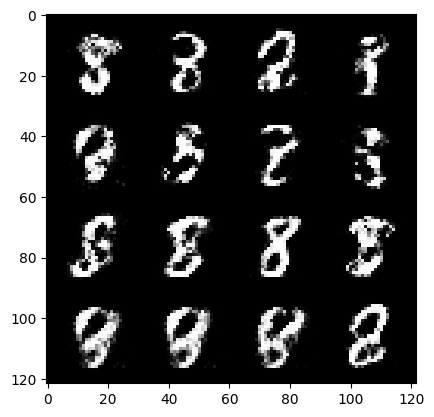

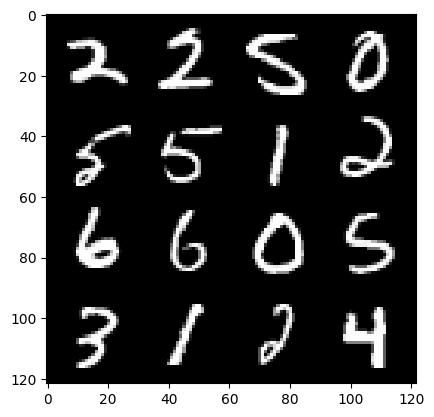

89: step 42000 / Gen loss 3.7169143883387266 / Disc loss 0.15096199115117387


  0%|          | 0/469 [00:00<?, ?it/s]

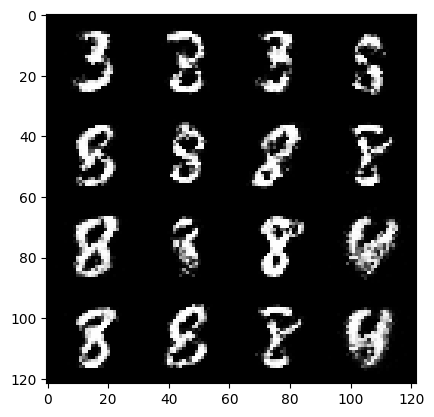

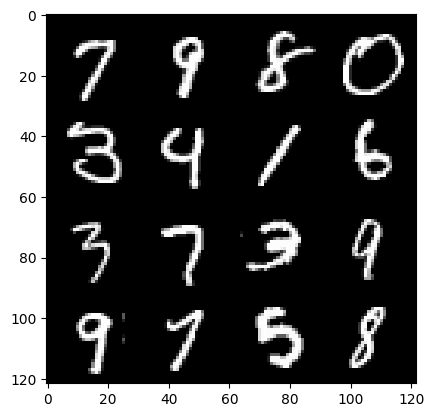

90: step 42300 / Gen loss 3.6212122790018713 / Disc loss 0.1464389840265115


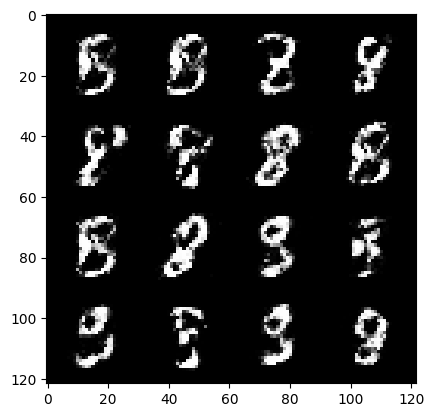

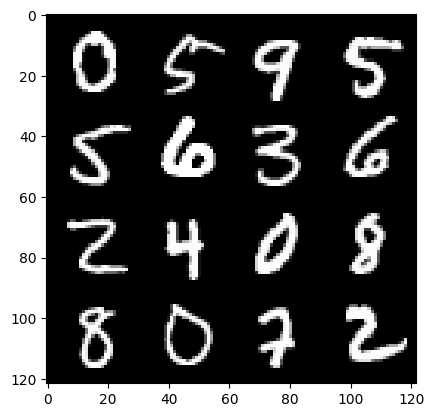

90: step 42600 / Gen loss 3.5958300089836124 / Disc loss 0.15605679815014206


  0%|          | 0/469 [00:00<?, ?it/s]

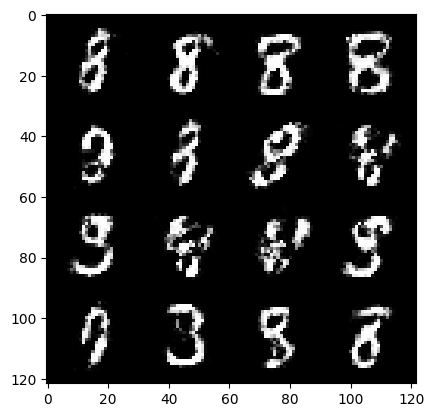

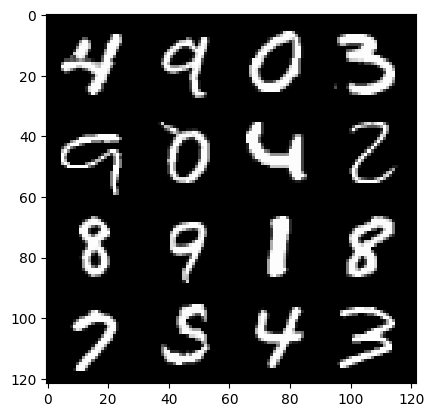

91: step 42900 / Gen loss 3.4875915773709596 / Disc loss 0.1554005523522695


  0%|          | 0/469 [00:00<?, ?it/s]

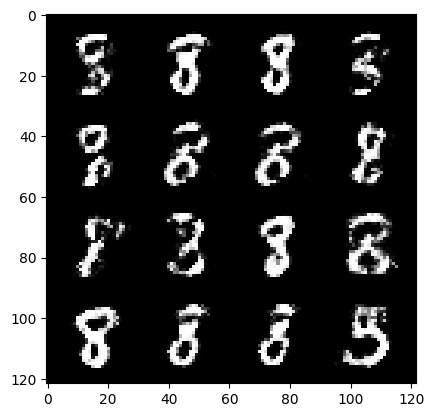

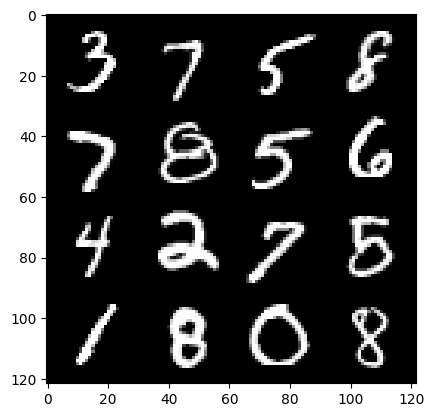

92: step 43200 / Gen loss 3.5510079113642368 / Disc loss 0.15419186274210608


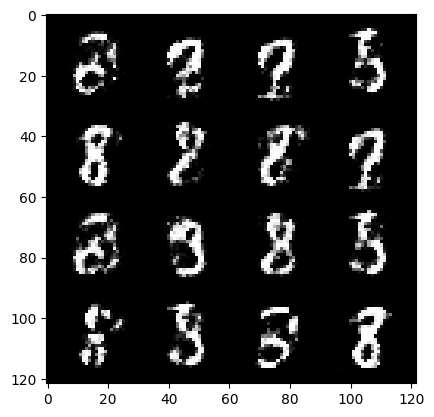

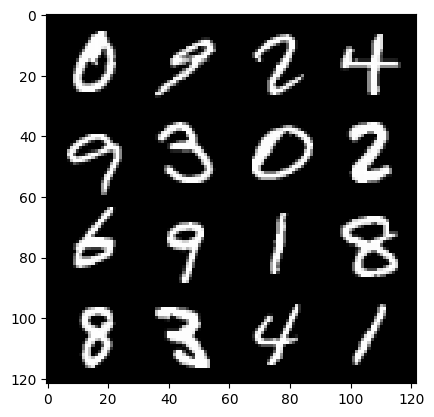

92: step 43500 / Gen loss 3.5060253016153973 / Disc loss 0.1743583721170823


  0%|          | 0/469 [00:00<?, ?it/s]

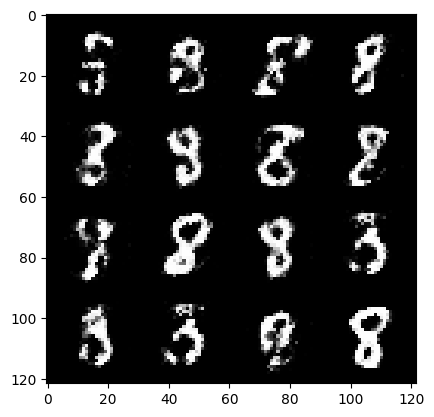

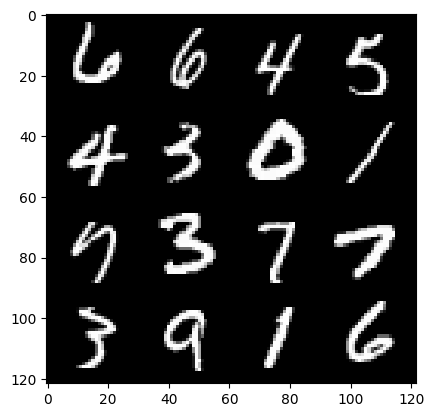

93: step 43800 / Gen loss 3.4600139848391227 / Disc loss 0.15325088828802097


  0%|          | 0/469 [00:00<?, ?it/s]

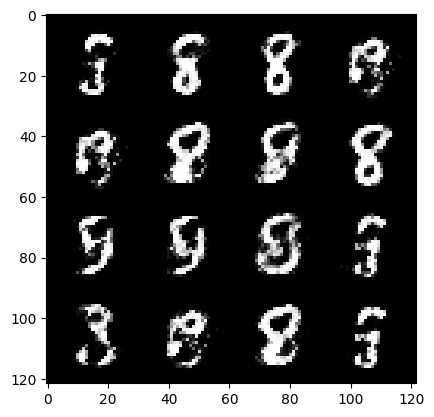

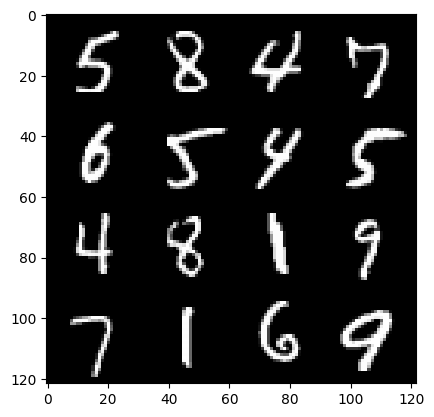

94: step 44100 / Gen loss 3.414773885409037 / Disc loss 0.17087880914409959


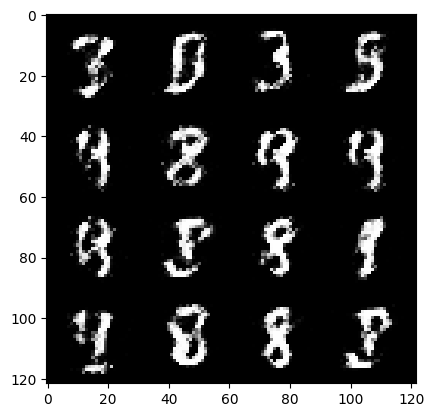

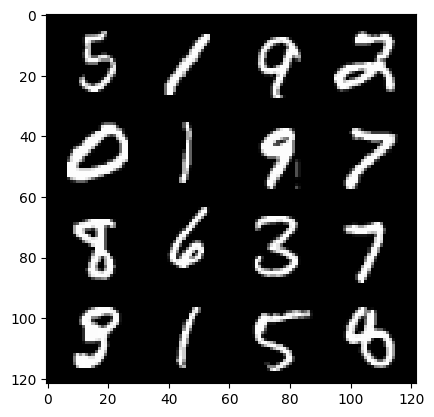

94: step 44400 / Gen loss 3.3530977614720654 / Disc loss 0.15903837074836097


  0%|          | 0/469 [00:00<?, ?it/s]

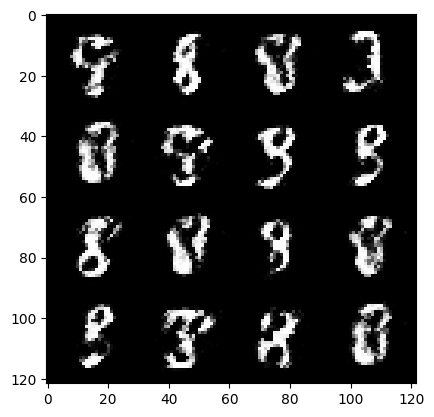

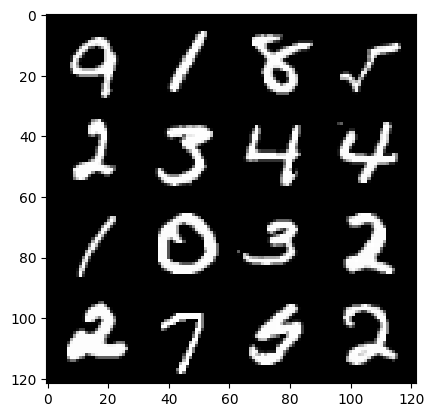

95: step 44700 / Gen loss 3.416256101926168 / Disc loss 0.16418510253230734


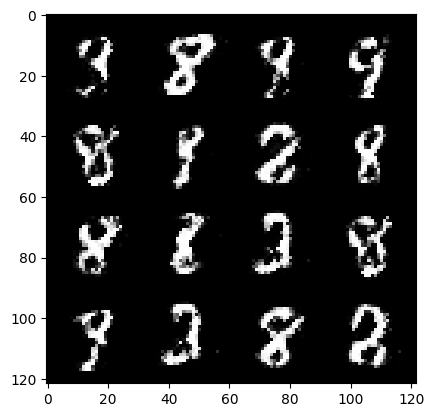

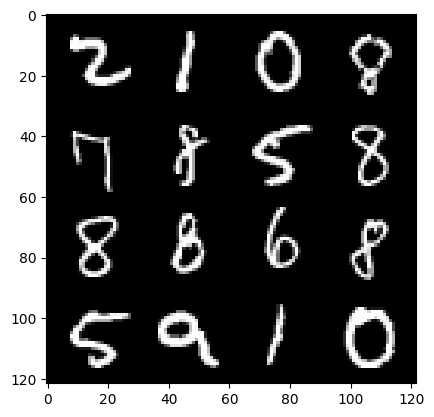

95: step 45000 / Gen loss 3.3375921678543095 / Disc loss 0.1735926450540622


  0%|          | 0/469 [00:00<?, ?it/s]

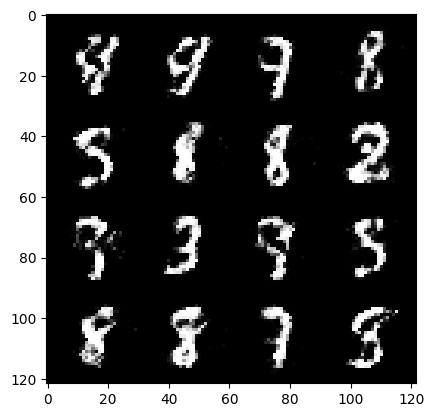

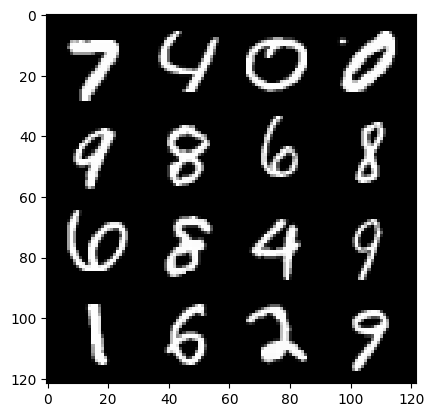

96: step 45300 / Gen loss 3.4277784244219482 / Disc loss 0.18005402758717545


  0%|          | 0/469 [00:00<?, ?it/s]

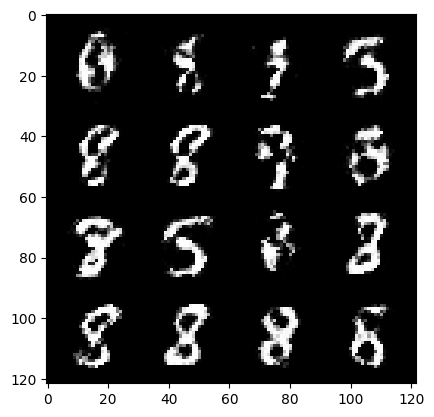

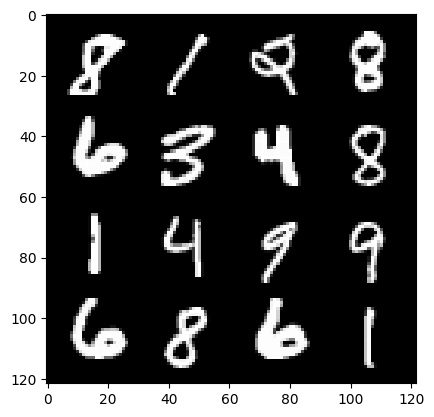

97: step 45600 / Gen loss 3.3357365918159476 / Disc loss 0.19301246712605175


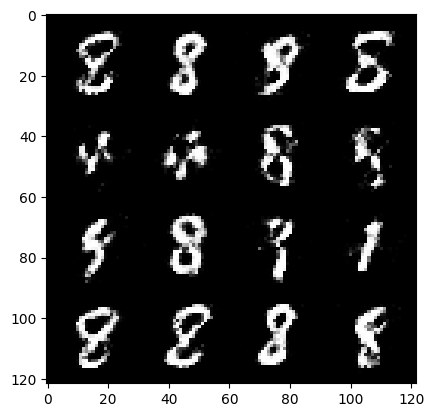

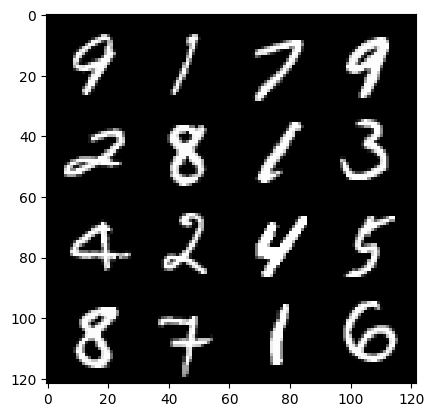

97: step 45900 / Gen loss 3.2039233191808063 / Disc loss 0.1854838510851065


  0%|          | 0/469 [00:00<?, ?it/s]

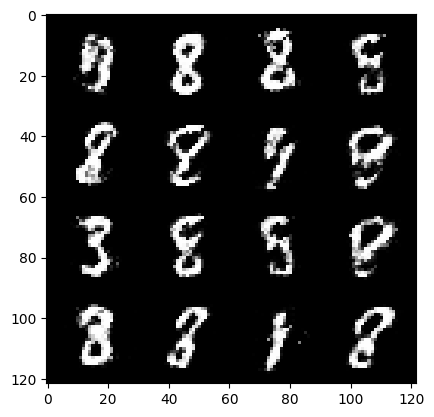

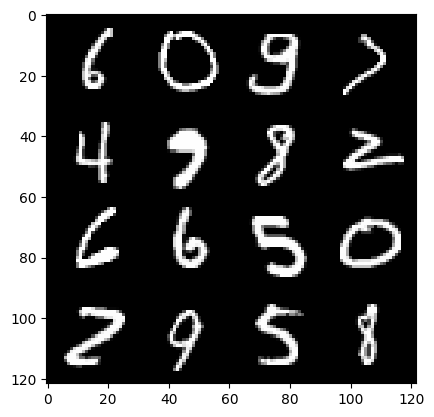

98: step 46200 / Gen loss 3.1907258415222146 / Disc loss 0.18701828541855026


  0%|          | 0/469 [00:00<?, ?it/s]

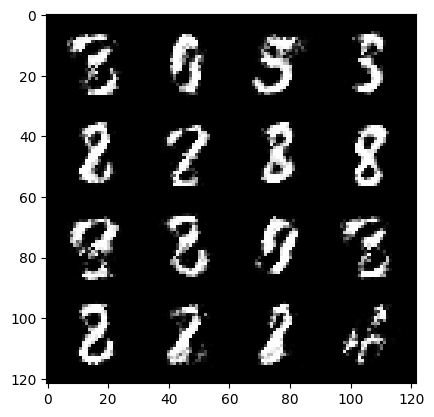

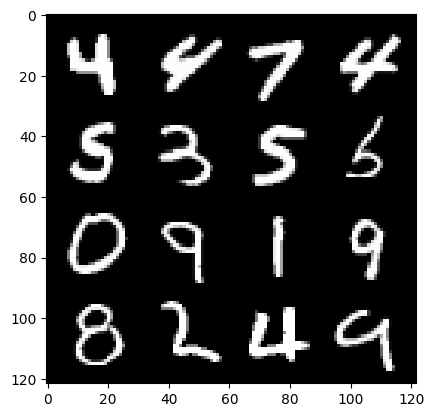

99: step 46500 / Gen loss 3.1526714126269035 / Disc loss 0.18859466783702394


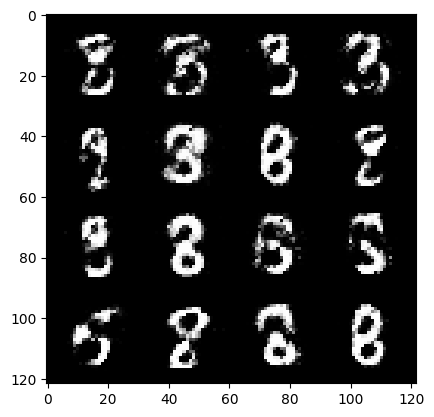

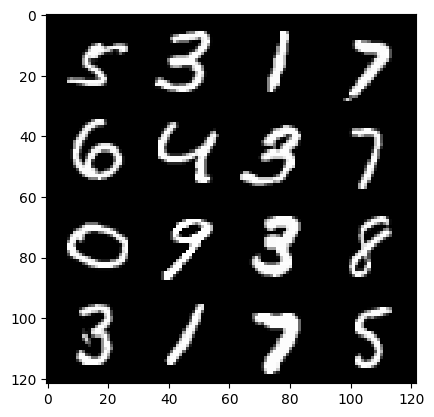

99: step 46800 / Gen loss 3.115976605415346 / Disc loss 0.196120970994234


  0%|          | 0/469 [00:00<?, ?it/s]

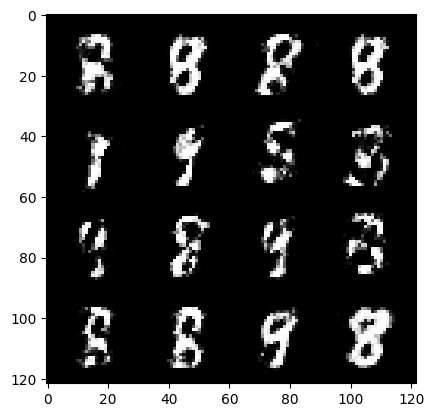

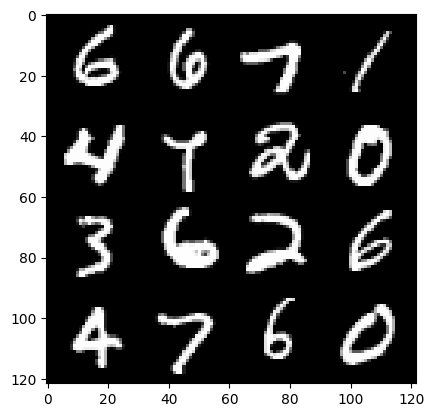

100: step 47100 / Gen loss 3.16009213844935 / Disc loss 0.1992072499543428


  0%|          | 0/469 [00:00<?, ?it/s]

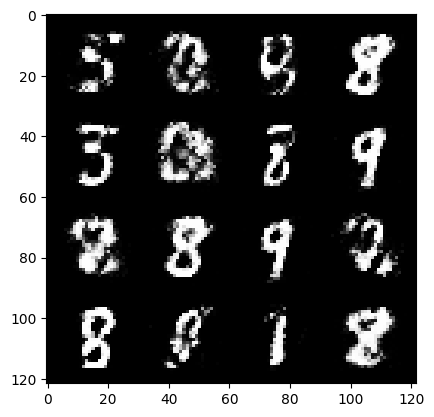

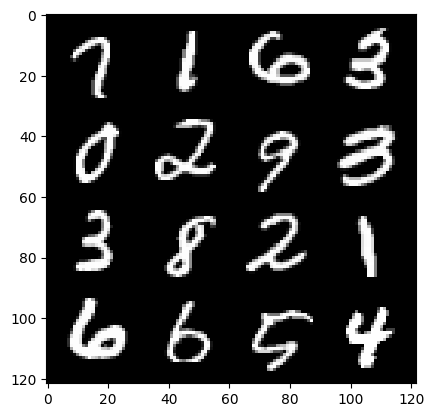

101: step 47400 / Gen loss 3.1975904107093807 / Disc loss 0.19715406909585


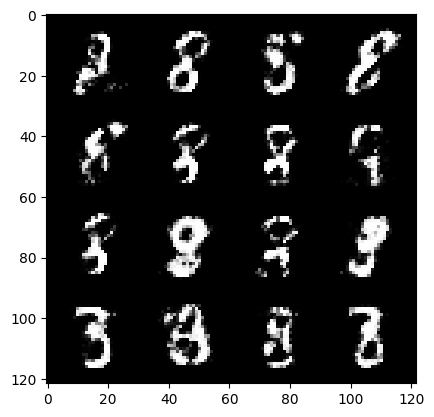

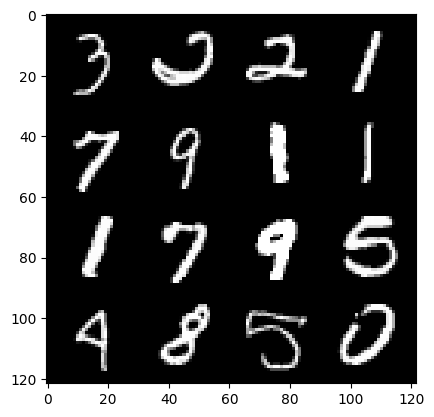

101: step 47700 / Gen loss 3.041528299649556 / Disc loss 0.20723923988640322


  0%|          | 0/469 [00:00<?, ?it/s]

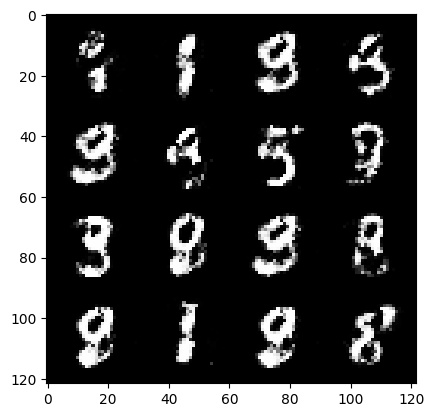

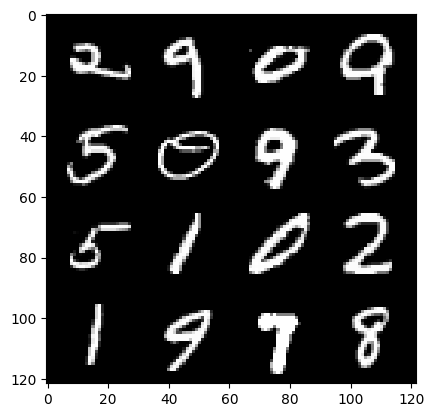

102: step 48000 / Gen loss 3.211801323890685 / Disc loss 0.1810863712678353


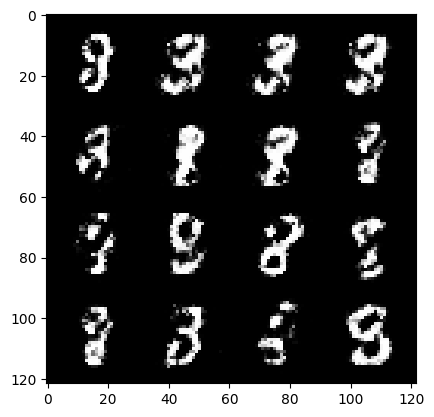

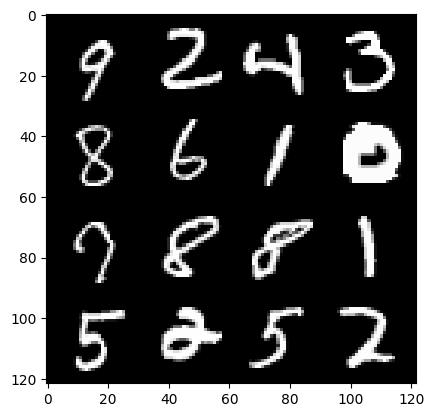

102: step 48300 / Gen loss 3.2858688584963467 / Disc loss 0.17818352902928986


  0%|          | 0/469 [00:00<?, ?it/s]

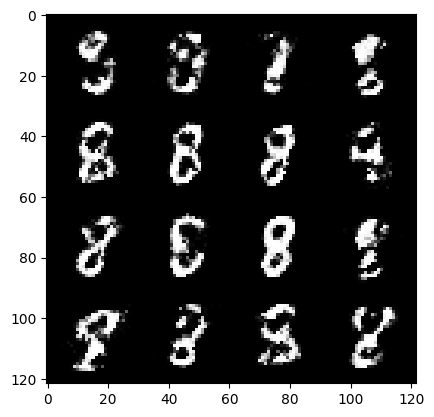

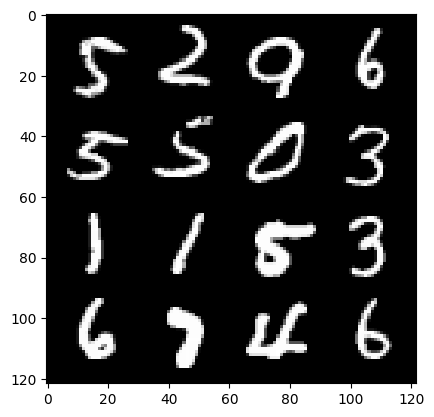

103: step 48600 / Gen loss 3.2554676953951547 / Disc loss 0.17694785527884976


  0%|          | 0/469 [00:00<?, ?it/s]

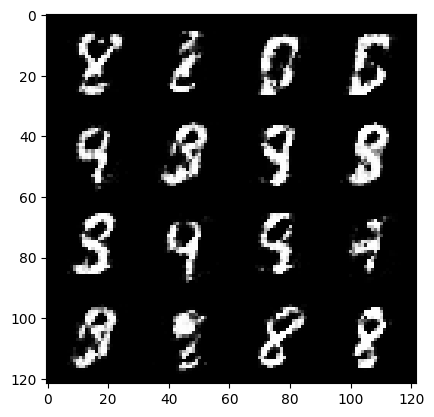

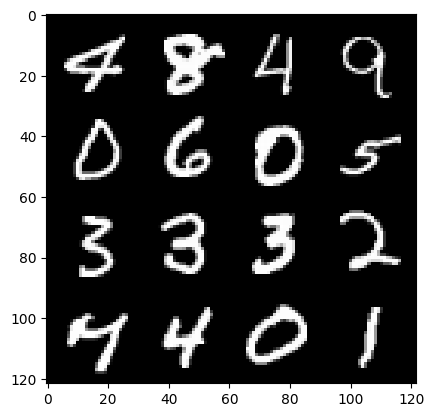

104: step 48900 / Gen loss 3.151721930503846 / Disc loss 0.18363205904761928


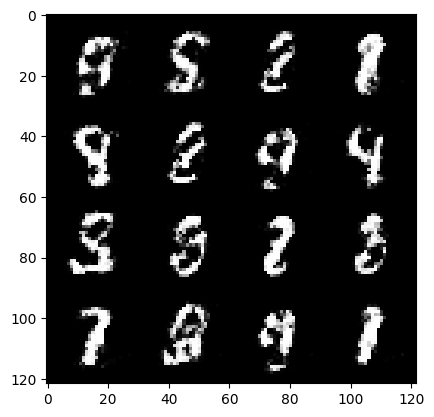

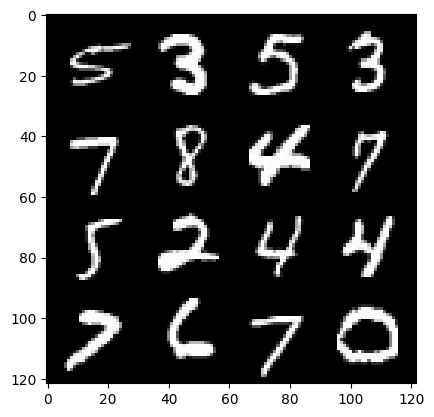

104: step 49200 / Gen loss 3.1598888802528395 / Disc loss 0.188862046773235


  0%|          | 0/469 [00:00<?, ?it/s]

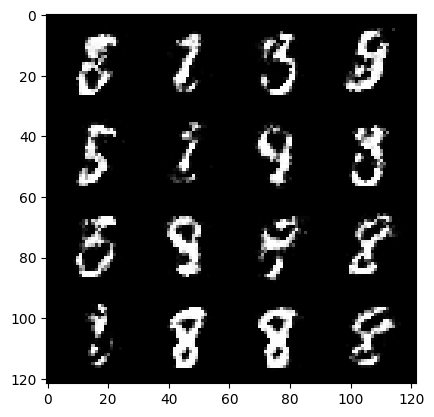

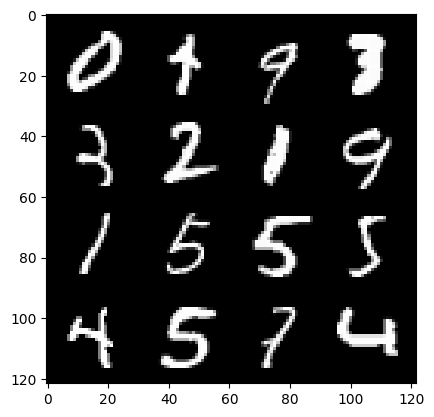

105: step 49500 / Gen loss 3.2312964598337808 / Disc loss 0.17191781409084803


  0%|          | 0/469 [00:00<?, ?it/s]

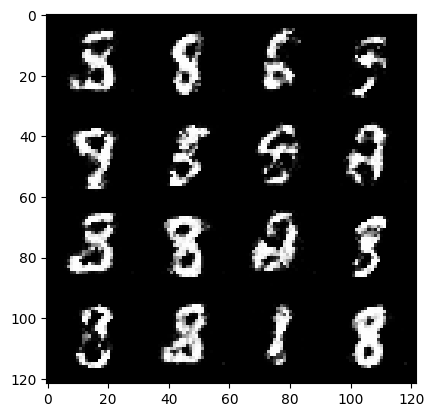

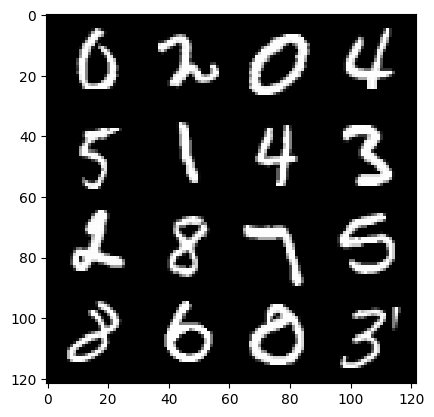

106: step 49800 / Gen loss 3.296568311850231 / Disc loss 0.17727276893953473


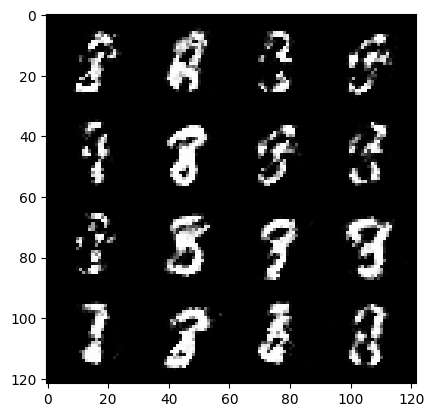

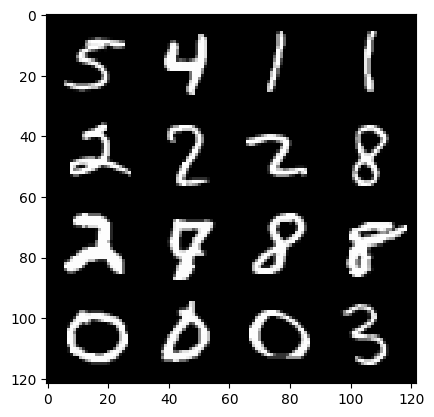

106: step 50100 / Gen loss 3.1945993733406044 / Disc loss 0.19243232642610858


  0%|          | 0/469 [00:00<?, ?it/s]

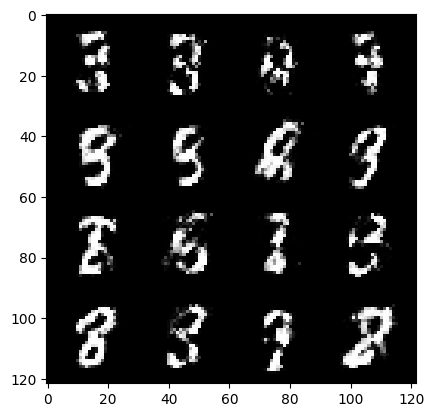

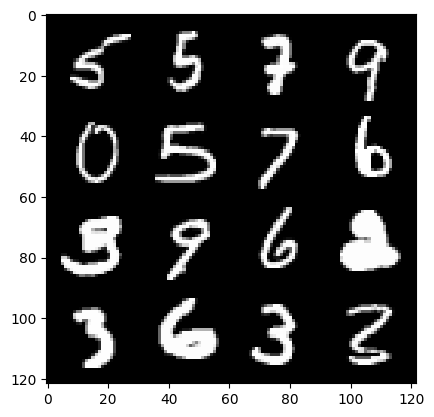

107: step 50400 / Gen loss 3.1310835075378423 / Disc loss 0.19950698393086574


  0%|          | 0/469 [00:00<?, ?it/s]

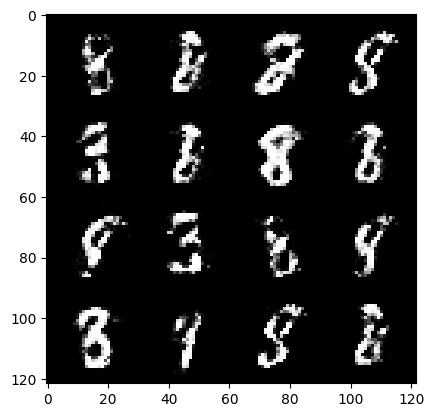

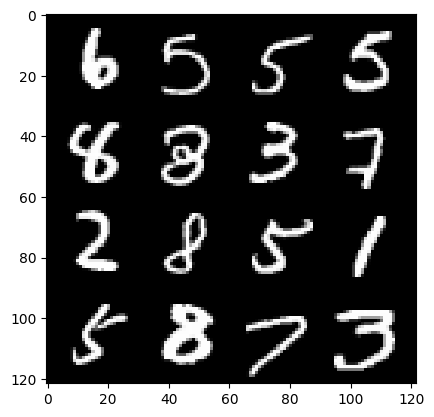

108: step 50700 / Gen loss 3.068121593793234 / Disc loss 0.21156759952505408


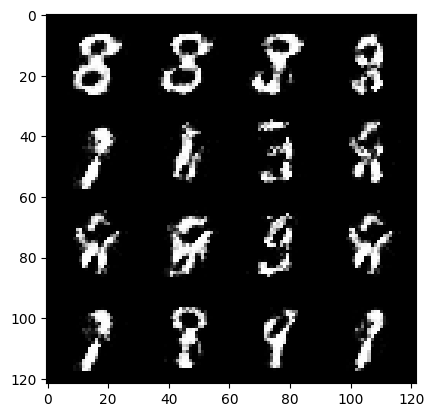

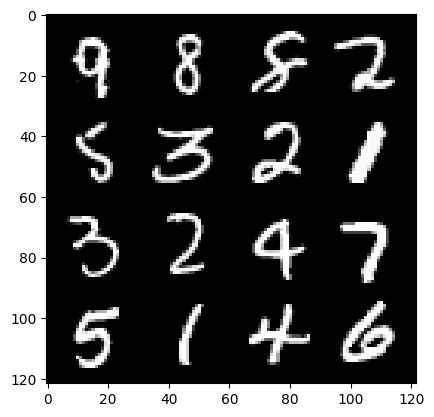

108: step 51000 / Gen loss 3.058452314535777 / Disc loss 0.22187705586353945


  0%|          | 0/469 [00:00<?, ?it/s]

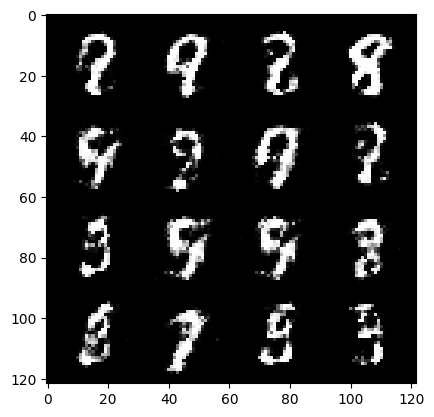

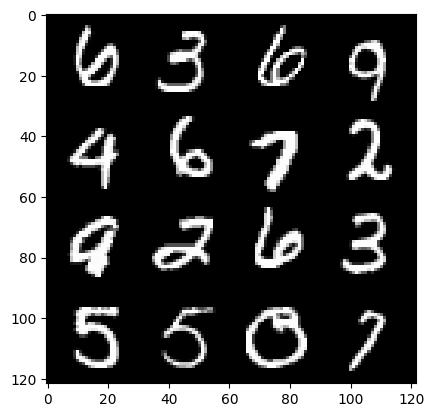

109: step 51300 / Gen loss 3.071429107983908 / Disc loss 0.23799174939592685


  0%|          | 0/469 [00:00<?, ?it/s]

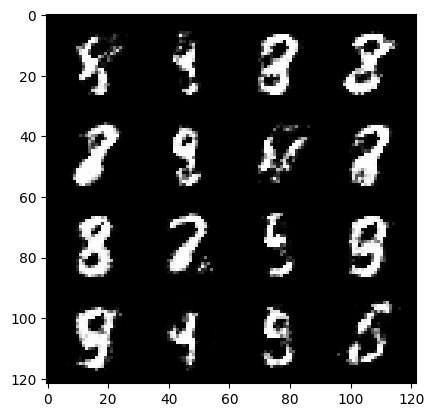

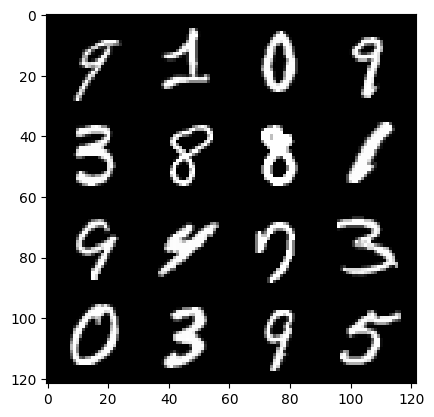

110: step 51600 / Gen loss 3.1921234671274825 / Disc loss 0.20057614624500278


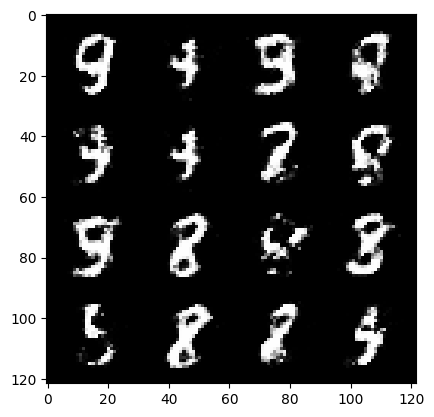

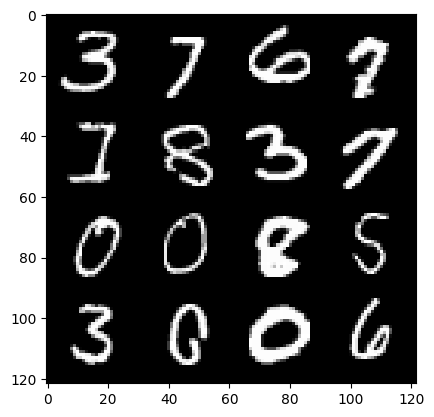

110: step 51900 / Gen loss 3.211229184468583 / Disc loss 0.18746483224133656


  0%|          | 0/469 [00:00<?, ?it/s]

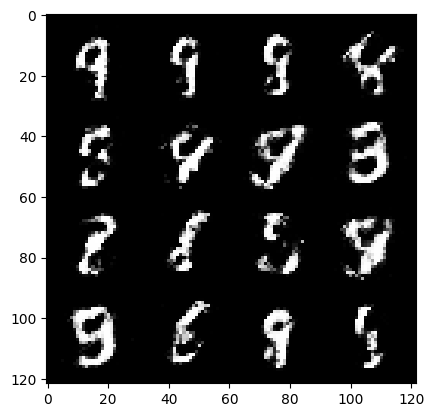

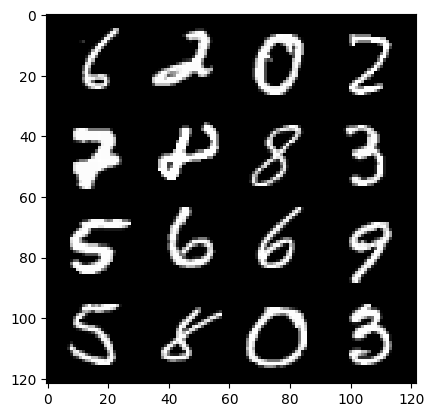

111: step 52200 / Gen loss 3.153405216534932 / Disc loss 0.1997241977602243


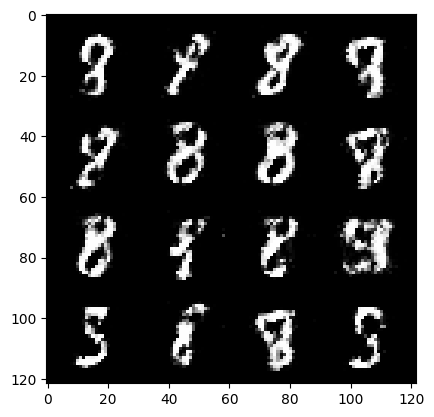

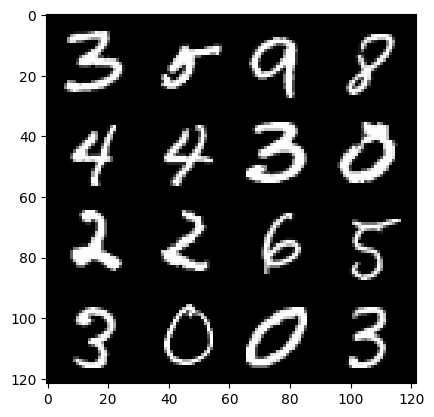

111: step 52500 / Gen loss 3.0085565590858474 / Disc loss 0.21242239805559313


  0%|          | 0/469 [00:00<?, ?it/s]

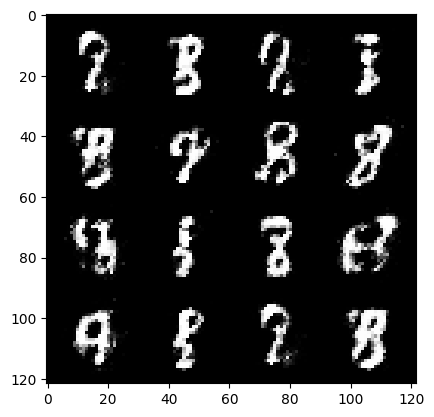

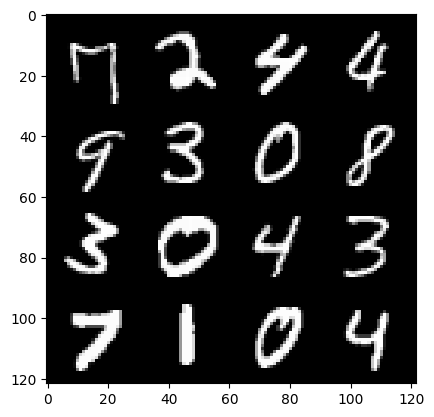

112: step 52800 / Gen loss 3.025970124006271 / Disc loss 0.20513580076396465


  0%|          | 0/469 [00:00<?, ?it/s]

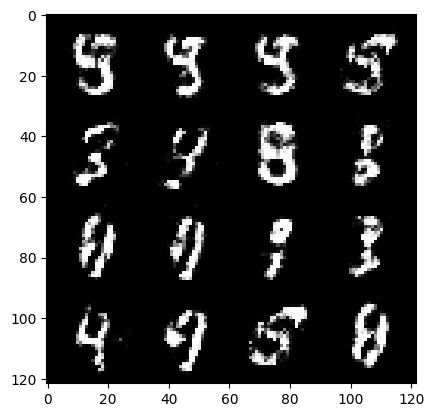

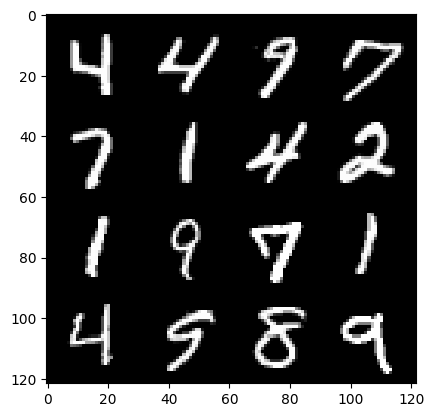

113: step 53100 / Gen loss 3.1680380813280733 / Disc loss 0.20205254696309588


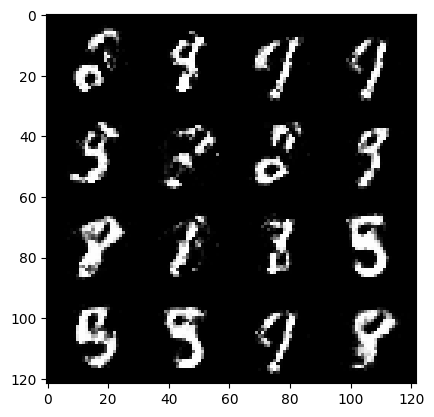

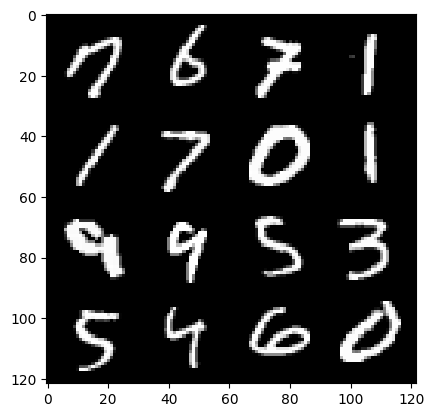

113: step 53400 / Gen loss 3.0465304366747543 / Disc loss 0.23327667896946264


  0%|          | 0/469 [00:00<?, ?it/s]

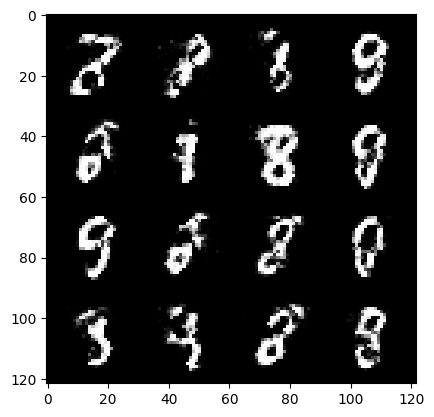

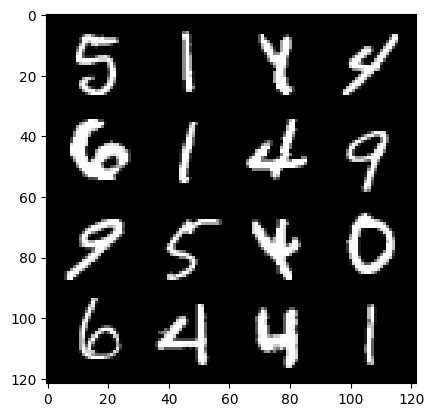

114: step 53700 / Gen loss 3.115624930063884 / Disc loss 0.22217662831147494


  0%|          | 0/469 [00:00<?, ?it/s]

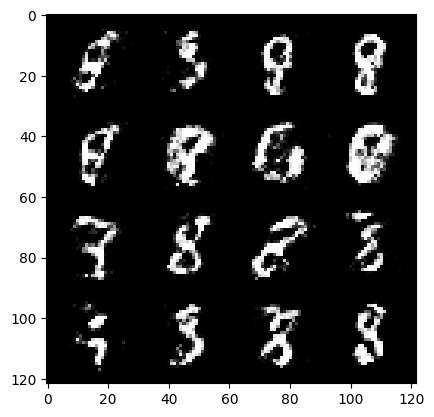

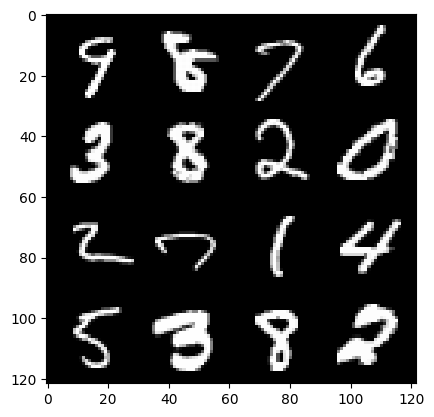

115: step 54000 / Gen loss 2.995670156478883 / Disc loss 0.22809051362176733


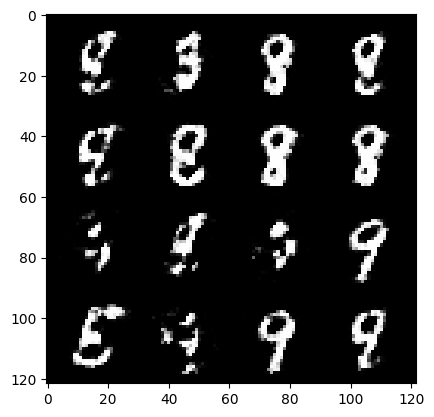

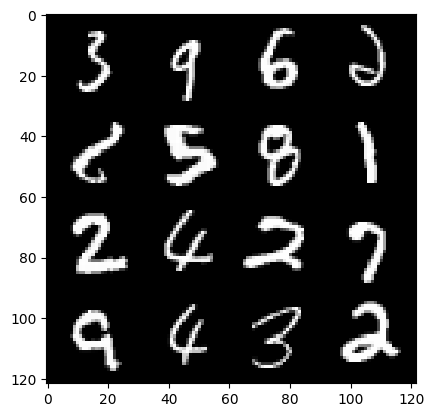

115: step 54300 / Gen loss 2.983225210507711 / Disc loss 0.22520963077743839


  0%|          | 0/469 [00:00<?, ?it/s]

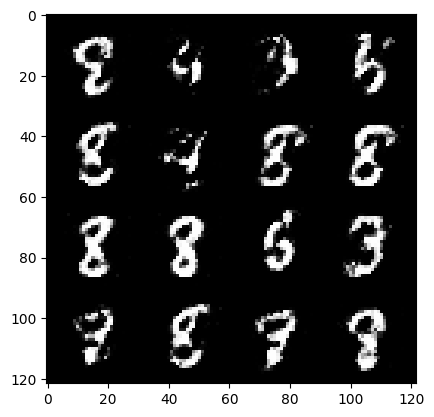

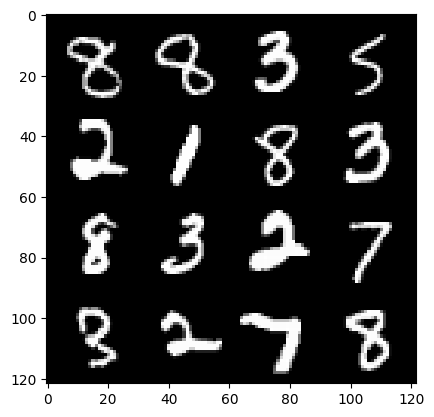

116: step 54600 / Gen loss 3.1136705247561136 / Disc loss 0.2056619651118914


  0%|          | 0/469 [00:00<?, ?it/s]

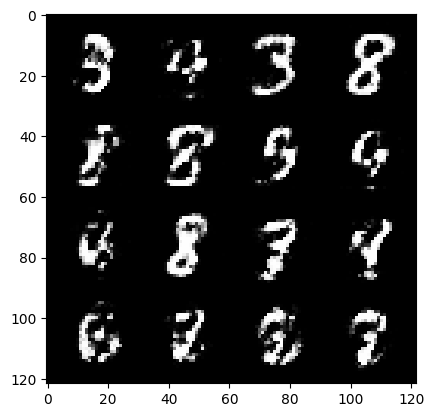

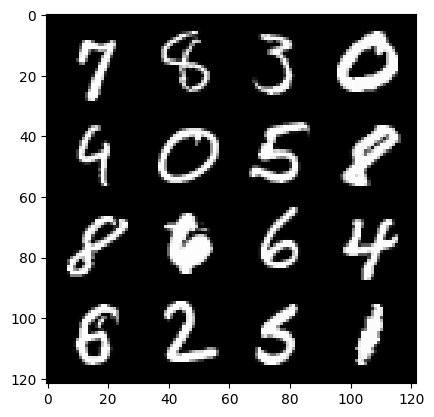

117: step 54900 / Gen loss 3.054477801322939 / Disc loss 0.22614141861597706


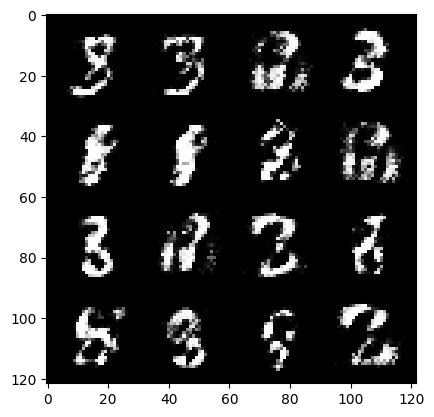

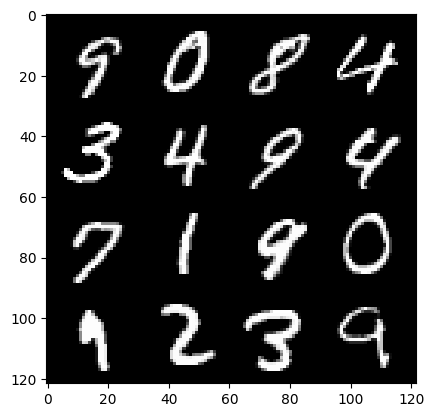

117: step 55200 / Gen loss 2.870397090911867 / Disc loss 0.24027944882710767


  0%|          | 0/469 [00:00<?, ?it/s]

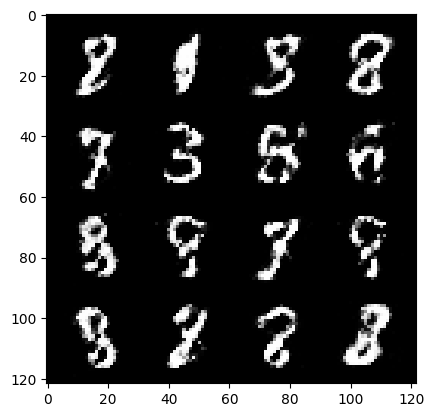

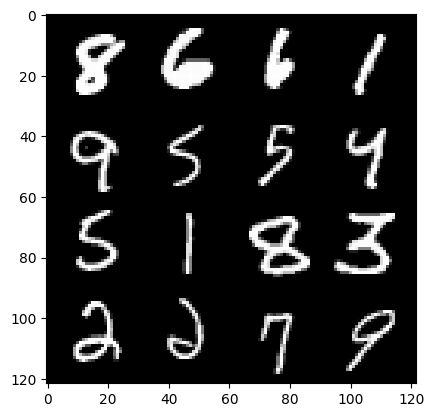

118: step 55500 / Gen loss 2.8392209450403834 / Disc loss 0.23160505016644803


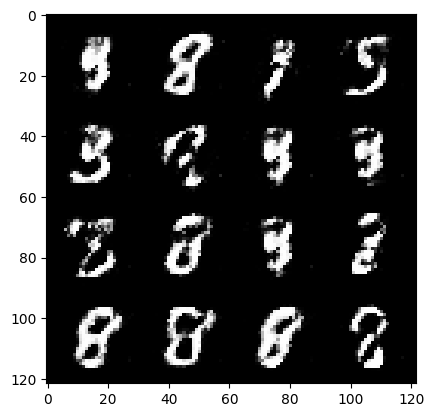

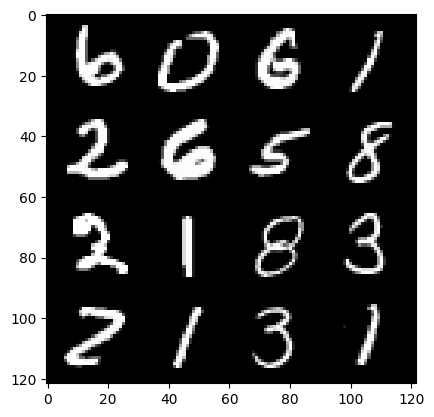

118: step 55800 / Gen loss 2.8389099943637865 / Disc loss 0.2222102255622547


  0%|          | 0/469 [00:00<?, ?it/s]

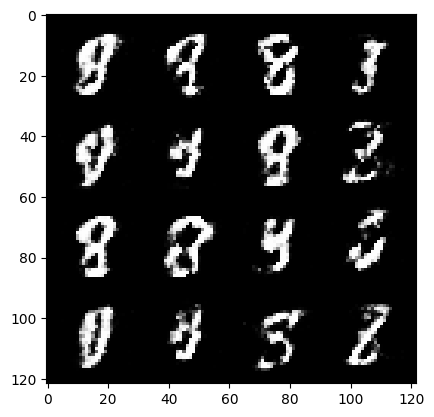

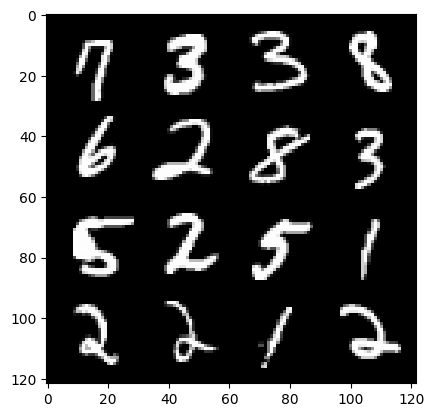

119: step 56100 / Gen loss 2.8748888540267936 / Disc loss 0.2237732108930745


  0%|          | 0/469 [00:00<?, ?it/s]

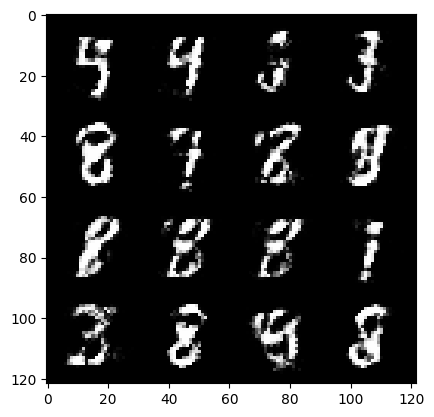

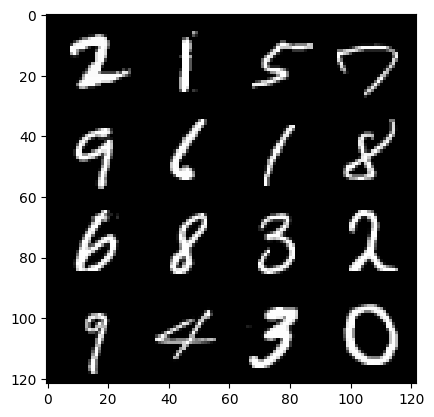

120: step 56400 / Gen loss 2.887454963525135 / Disc loss 0.22615039676427842


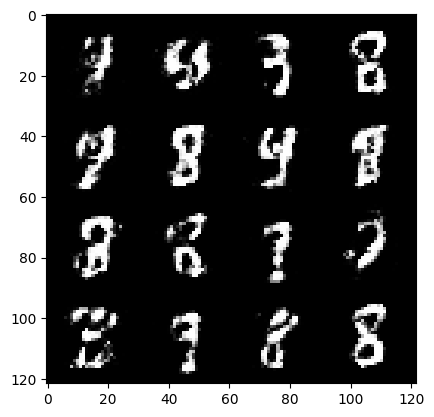

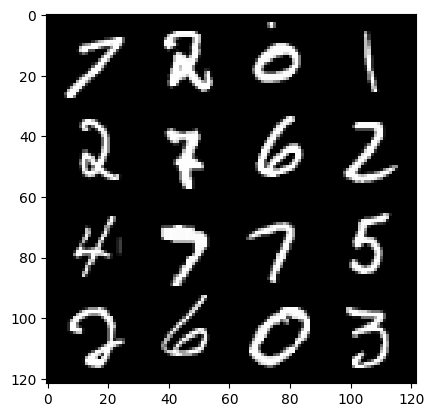

120: step 56700 / Gen loss 2.8242628304163633 / Disc loss 0.24162061631679535


  0%|          | 0/469 [00:00<?, ?it/s]

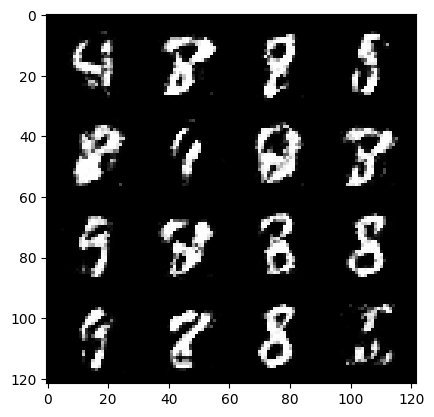

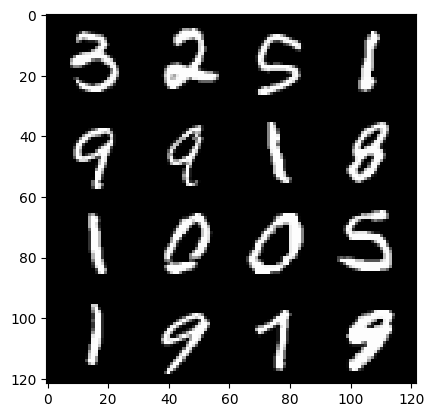

121: step 57000 / Gen loss 2.7675132854779547 / Disc loss 0.2674990759789944


  0%|          | 0/469 [00:00<?, ?it/s]

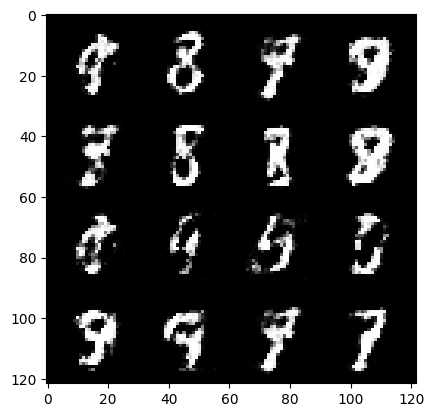

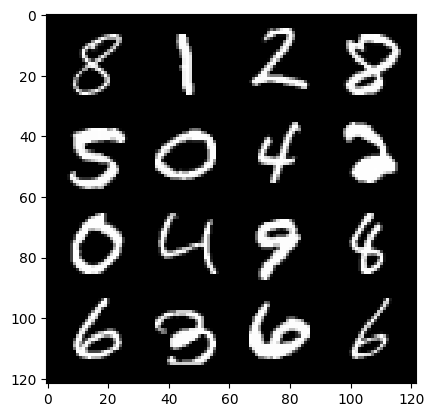

122: step 57300 / Gen loss 2.8387540102005016 / Disc loss 0.268533947765827


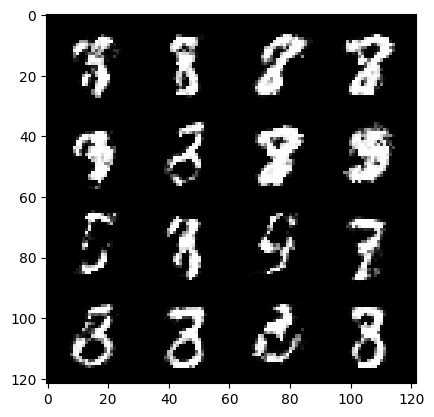

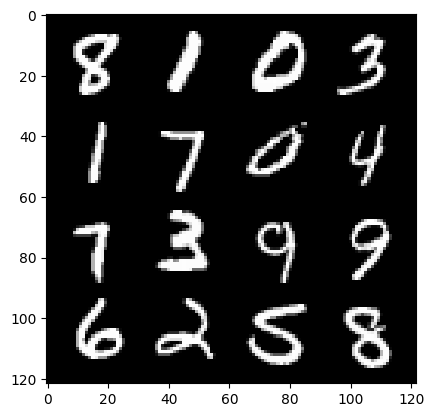

122: step 57600 / Gen loss 2.6835223118464144 / Disc loss 0.26072084208329527


  0%|          | 0/469 [00:00<?, ?it/s]

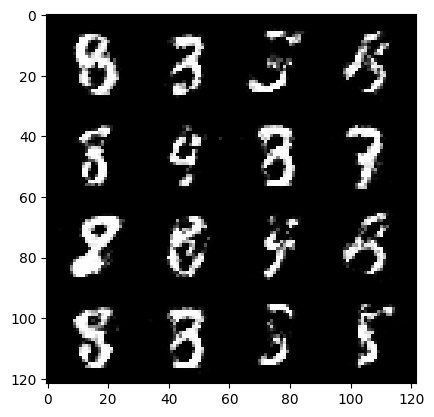

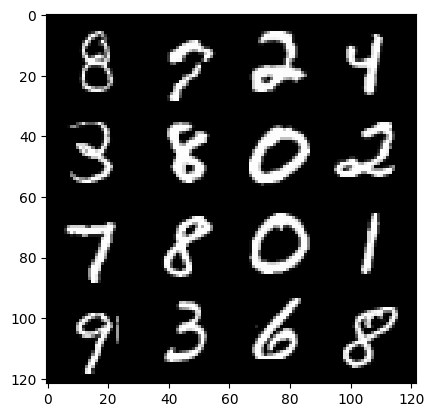

123: step 57900 / Gen loss 2.741595128377275 / Disc loss 0.23131192008654253


  0%|          | 0/469 [00:00<?, ?it/s]

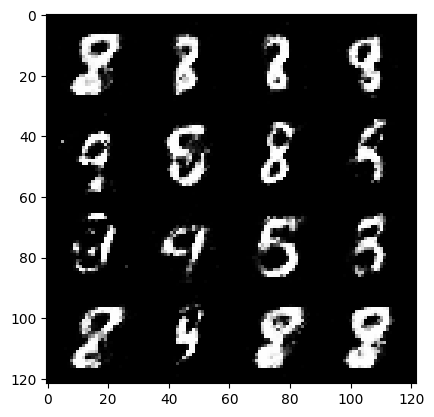

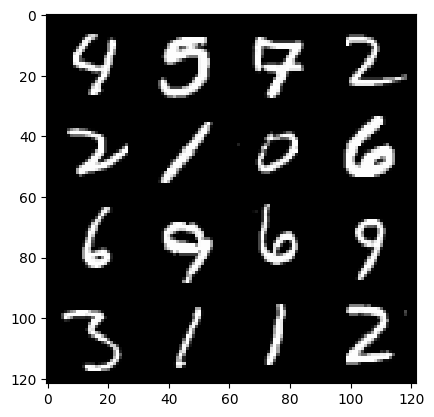

124: step 58200 / Gen loss 2.684874767065051 / Disc loss 0.24386015216509518


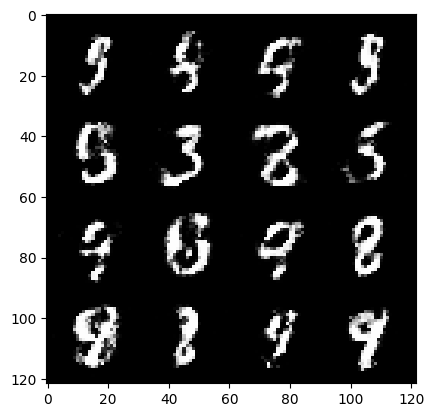

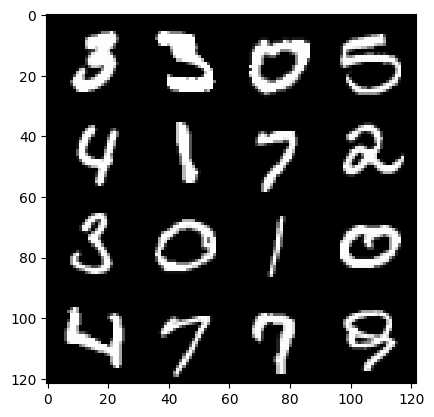

124: step 58500 / Gen loss 2.6297736605008453 / Disc loss 0.2463641950488091


  0%|          | 0/469 [00:00<?, ?it/s]

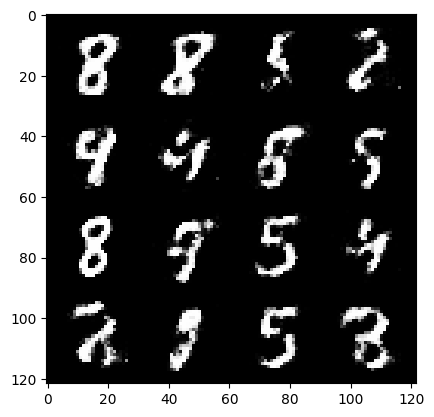

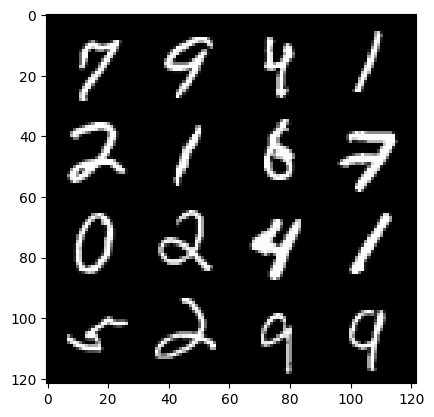

125: step 58800 / Gen loss 2.665931423505146 / Disc loss 0.22284516960382464


  0%|          | 0/469 [00:00<?, ?it/s]

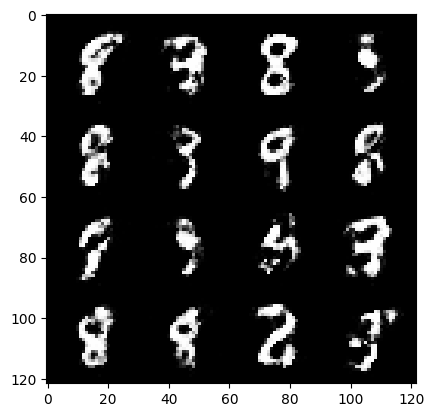

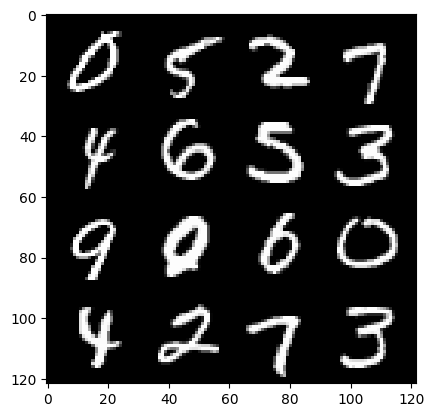

126: step 59100 / Gen loss 2.6701024373372406 / Disc loss 0.2469453570743404


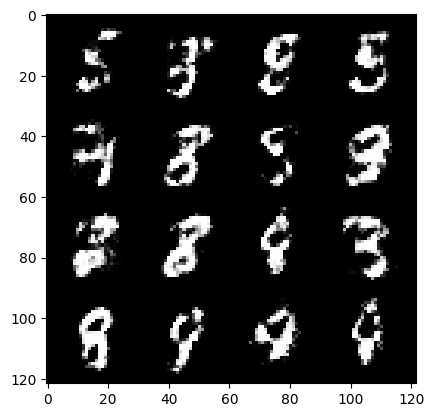

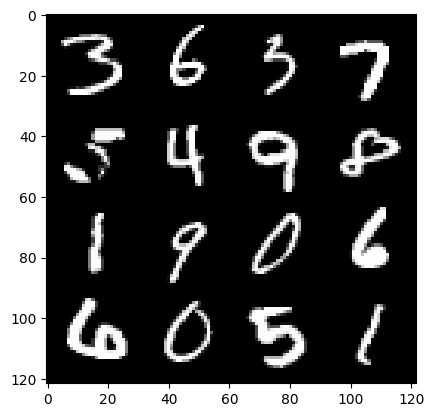

126: step 59400 / Gen loss 2.575394406716031 / Disc loss 0.2493028650681177


  0%|          | 0/469 [00:00<?, ?it/s]

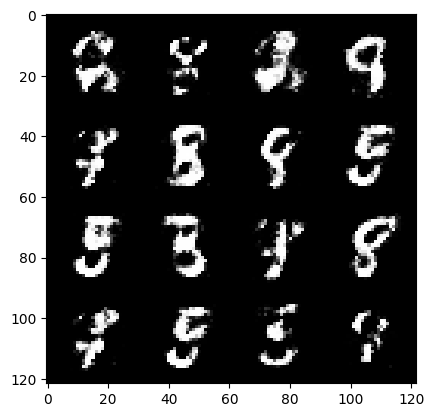

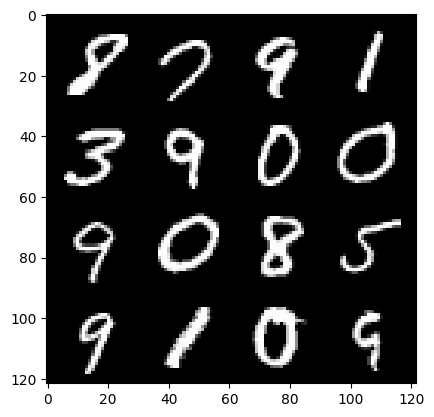

127: step 59700 / Gen loss 2.724013601938882 / Disc loss 0.2314330764114856


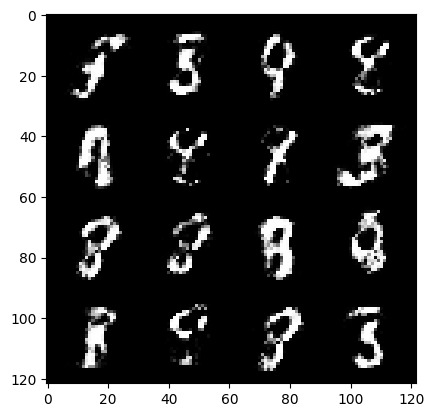

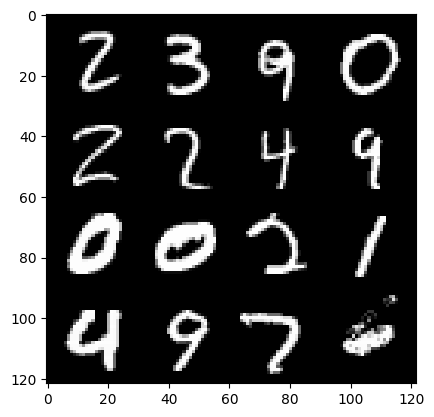

127: step 60000 / Gen loss 2.7636753817399358 / Disc loss 0.23156642807026703


  0%|          | 0/469 [00:00<?, ?it/s]

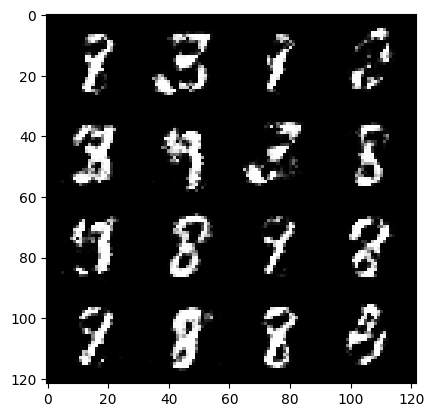

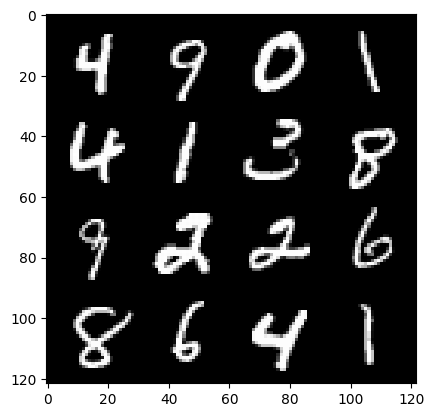

128: step 60300 / Gen loss 2.690333151817319 / Disc loss 0.23889788925647726


  0%|          | 0/469 [00:00<?, ?it/s]

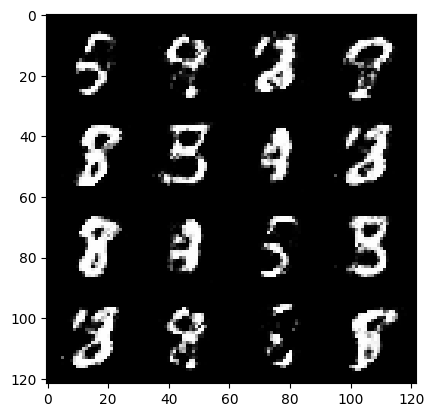

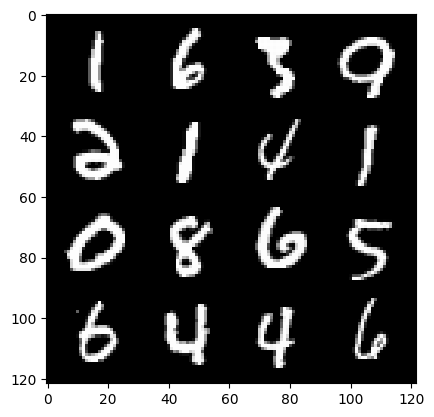

129: step 60600 / Gen loss 2.6988607684771218 / Disc loss 0.24502791275580732


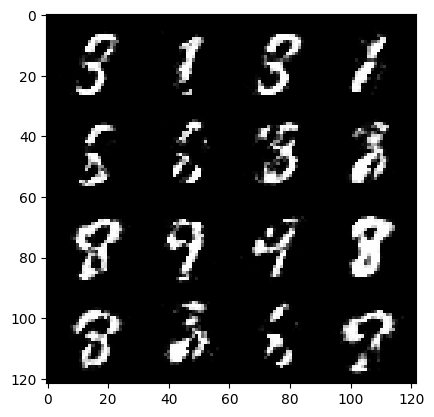

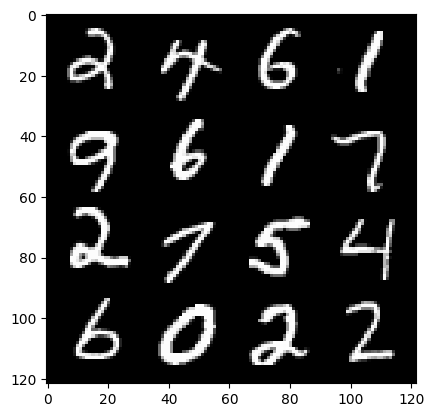

129: step 60900 / Gen loss 2.593074185848234 / Disc loss 0.24693708399931574


  0%|          | 0/469 [00:00<?, ?it/s]

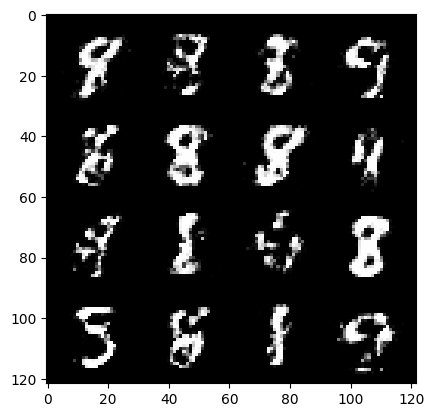

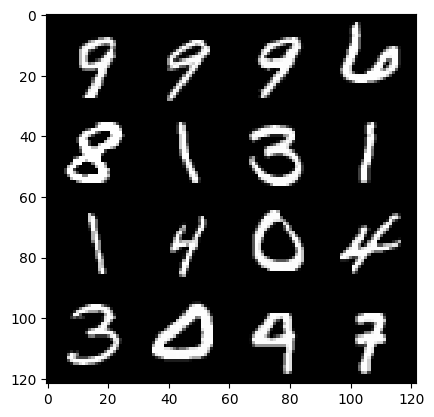

130: step 61200 / Gen loss 2.627046076854069 / Disc loss 0.2744401687880359


  0%|          | 0/469 [00:00<?, ?it/s]

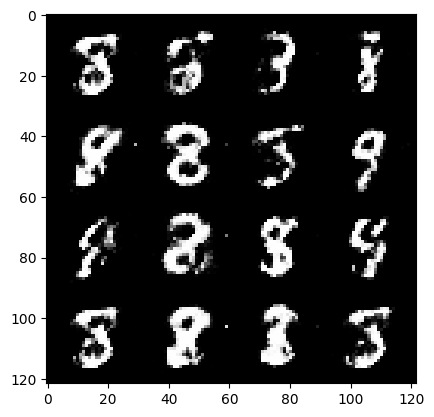

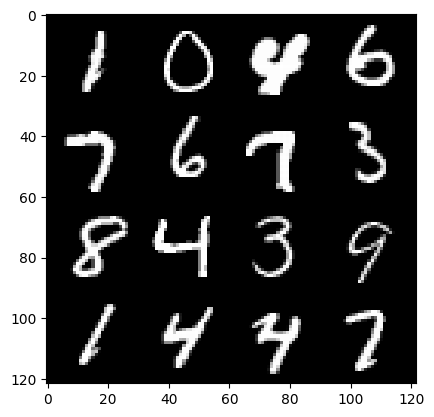

131: step 61500 / Gen loss 2.5626630584398913 / Disc loss 0.2841263817747436


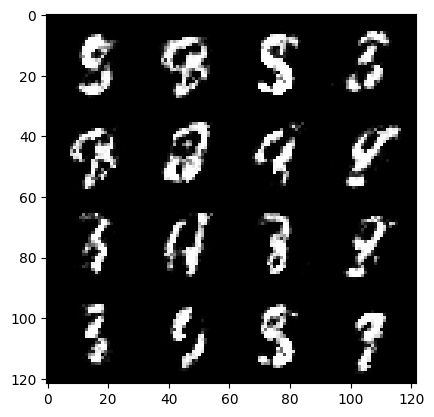

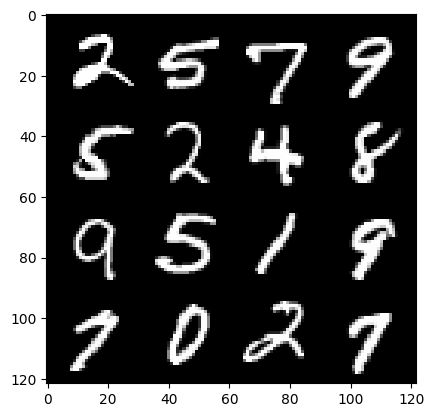

131: step 61800 / Gen loss 2.515281559626263 / Disc loss 0.2723179511229196


  0%|          | 0/469 [00:00<?, ?it/s]

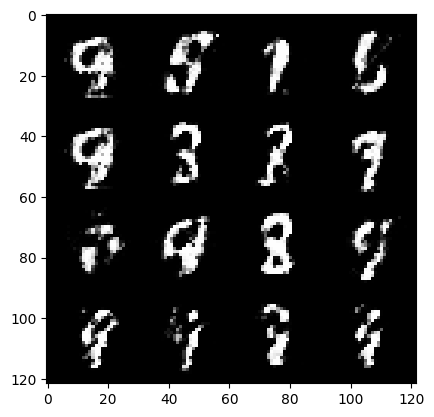

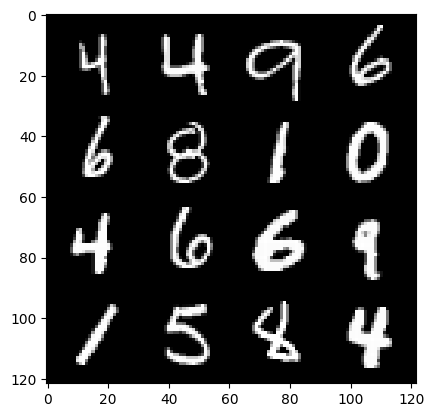

132: step 62100 / Gen loss 2.602849877675373 / Disc loss 0.24009970719615623


  0%|          | 0/469 [00:00<?, ?it/s]

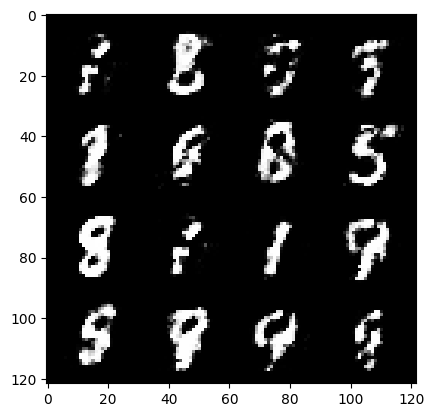

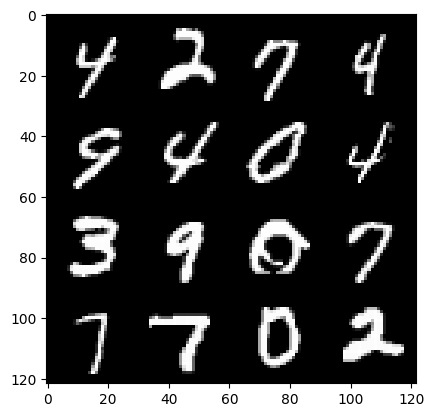

133: step 62400 / Gen loss 2.5643797385692593 / Disc loss 0.24895048469305026


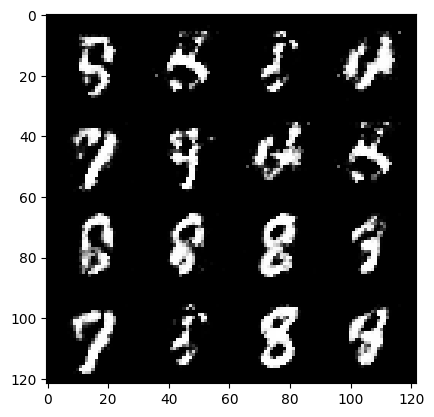

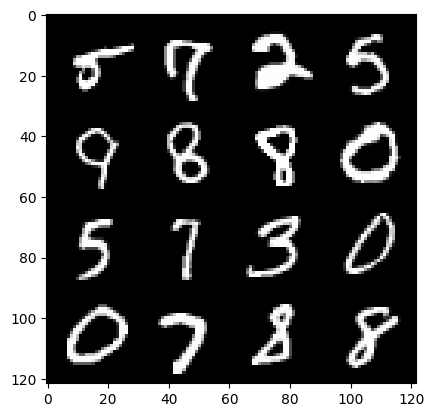

133: step 62700 / Gen loss 2.619268082777659 / Disc loss 0.2395762990415097


  0%|          | 0/469 [00:00<?, ?it/s]

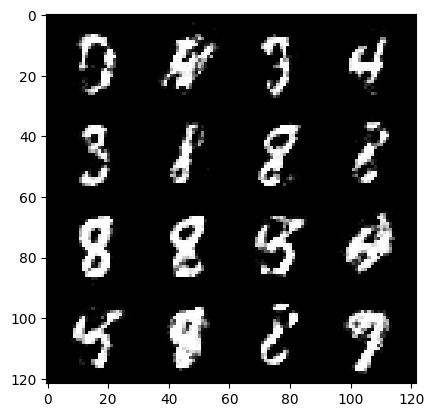

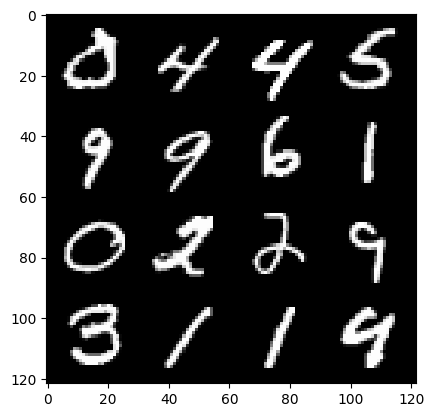

134: step 63000 / Gen loss 2.6570759995778426 / Disc loss 0.2506587201853593


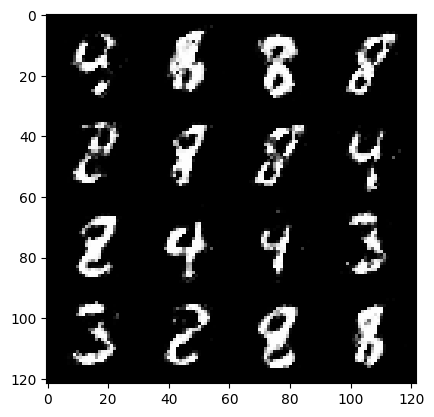

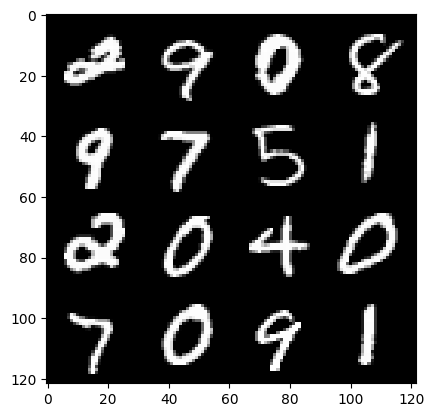

134: step 63300 / Gen loss 2.595519233544668 / Disc loss 0.2575801620880761


  0%|          | 0/469 [00:00<?, ?it/s]

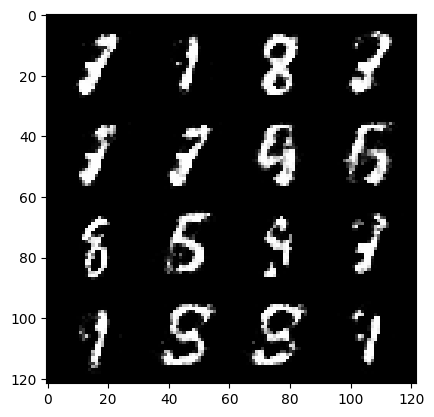

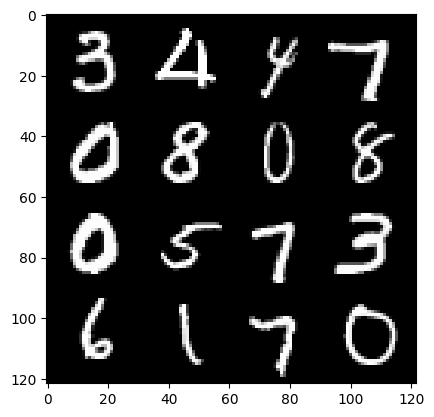

135: step 63600 / Gen loss 2.6529806256294246 / Disc loss 0.25261281276742625


  0%|          | 0/469 [00:00<?, ?it/s]

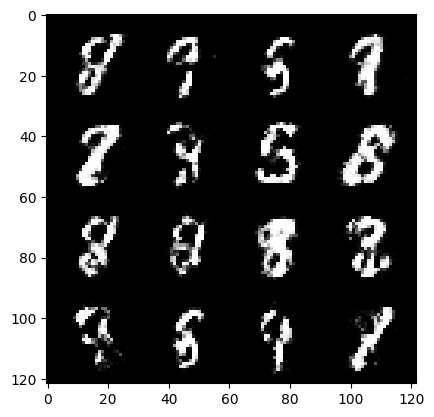

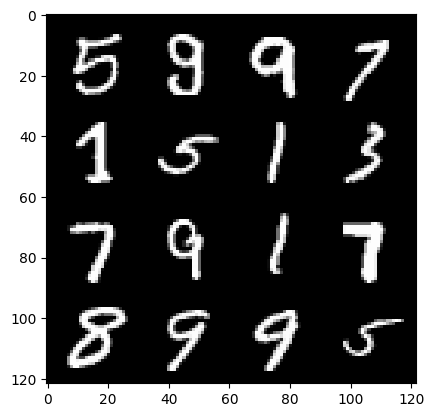

136: step 63900 / Gen loss 2.4920298751195284 / Disc loss 0.2824205319583416


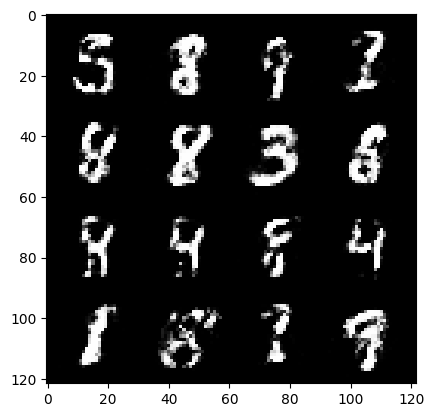

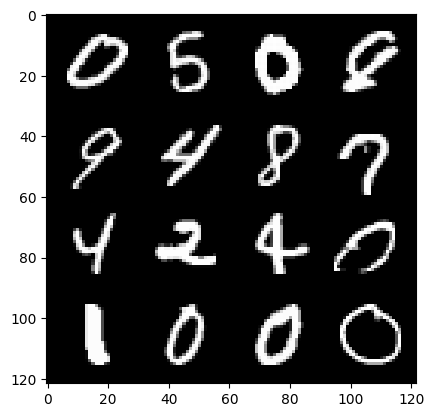

136: step 64200 / Gen loss 2.48180049578349 / Disc loss 0.2652448304990926


  0%|          | 0/469 [00:00<?, ?it/s]

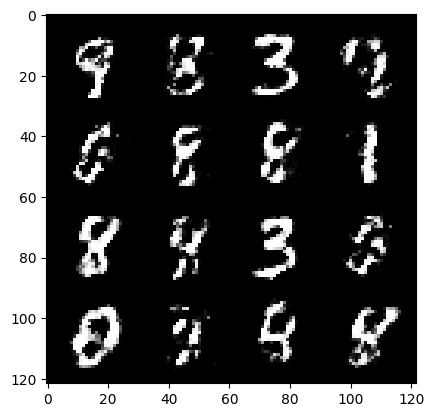

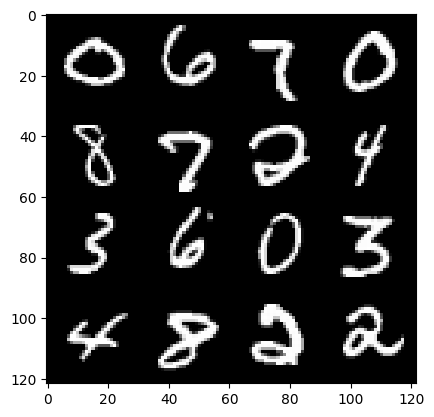

137: step 64500 / Gen loss 2.5599048630396504 / Disc loss 0.2626387285689513


  0%|          | 0/469 [00:00<?, ?it/s]

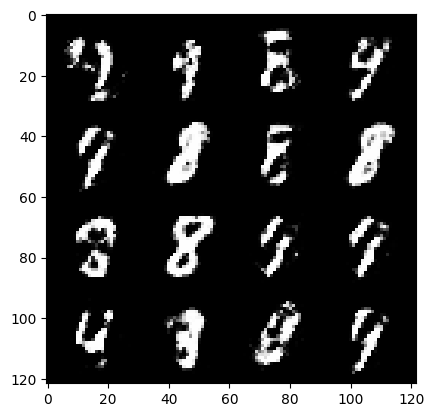

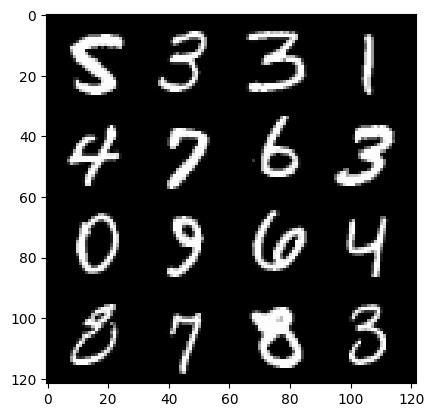

138: step 64800 / Gen loss 2.4887410302956883 / Disc loss 0.2636824379861354


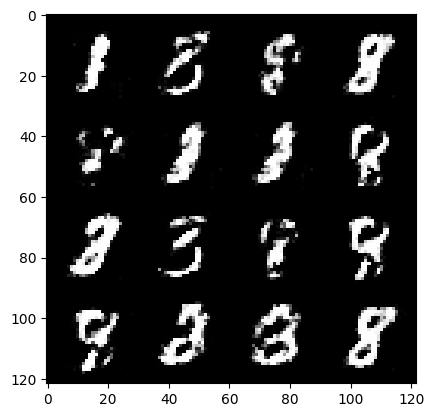

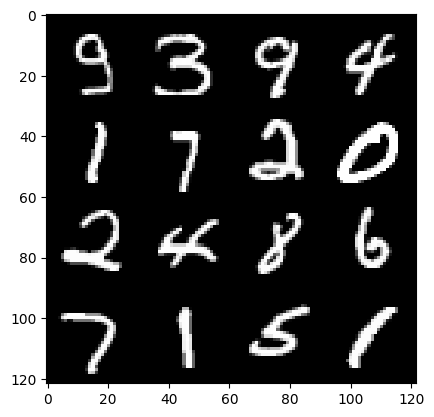

138: step 65100 / Gen loss 2.437009582916896 / Disc loss 0.268410313675801


  0%|          | 0/469 [00:00<?, ?it/s]

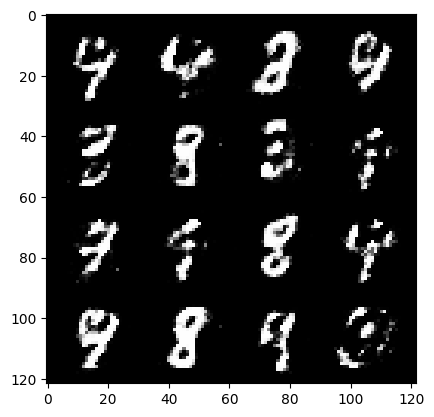

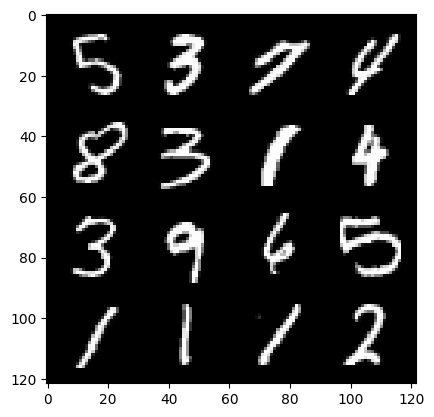

139: step 65400 / Gen loss 2.4750699838002514 / Disc loss 0.2809391224384309


  0%|          | 0/469 [00:00<?, ?it/s]

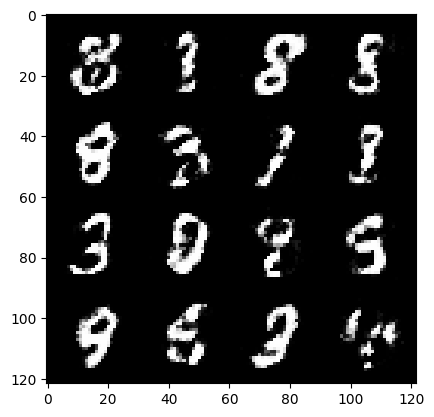

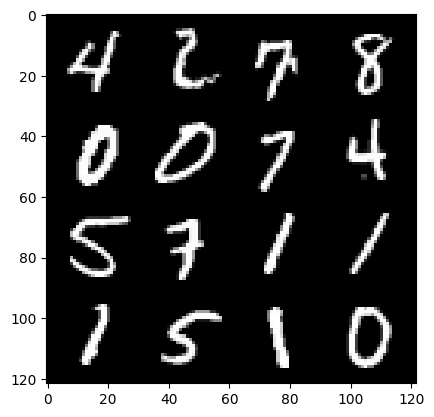

140: step 65700 / Gen loss 2.555732470750809 / Disc loss 0.2703023020923139


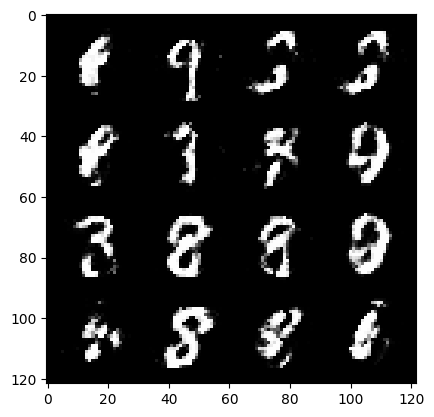

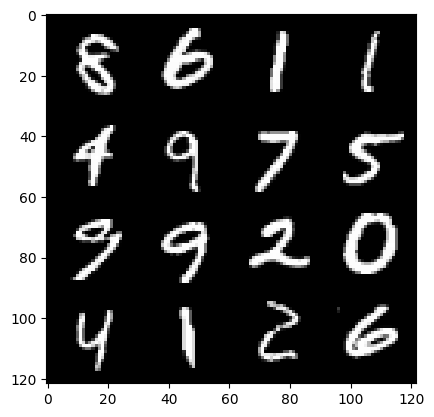

140: step 66000 / Gen loss 2.4512890934944154 / Disc loss 0.2663583357135454


  0%|          | 0/469 [00:00<?, ?it/s]

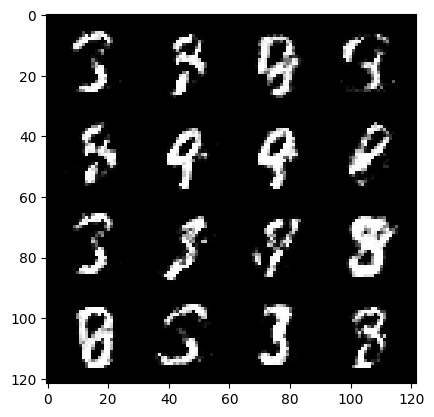

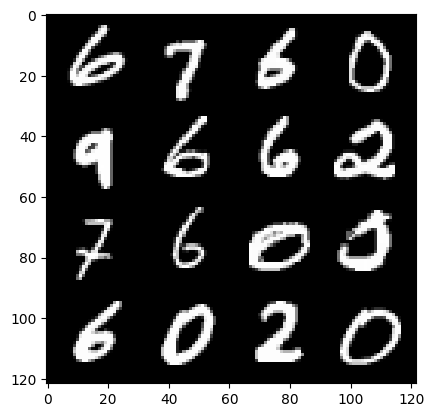

141: step 66300 / Gen loss 2.485248674949009 / Disc loss 0.2738260326286159


  0%|          | 0/469 [00:00<?, ?it/s]

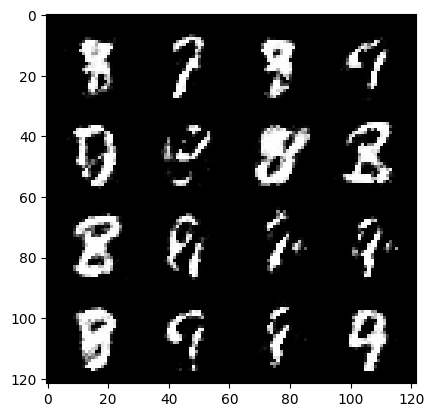

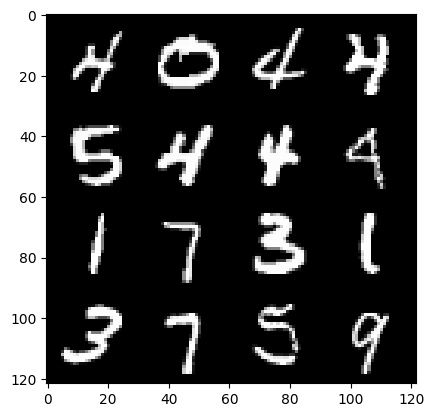

142: step 66600 / Gen loss 2.3722909653186792 / Disc loss 0.2825139368077118


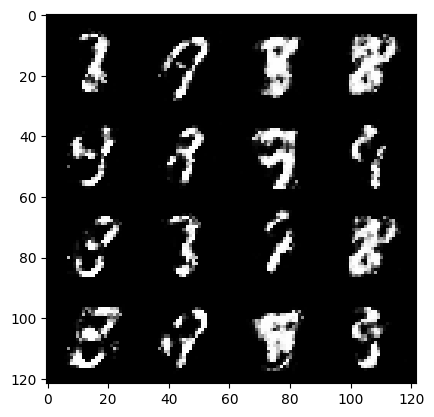

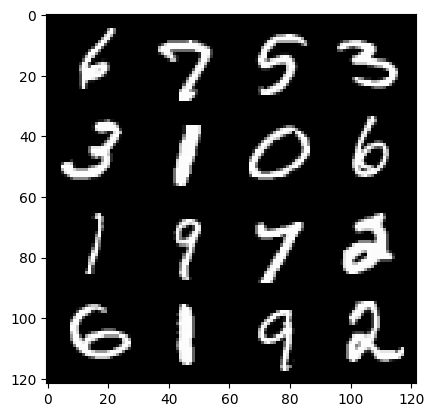

142: step 66900 / Gen loss 2.4187406448523197 / Disc loss 0.2689263045291107


  0%|          | 0/469 [00:00<?, ?it/s]

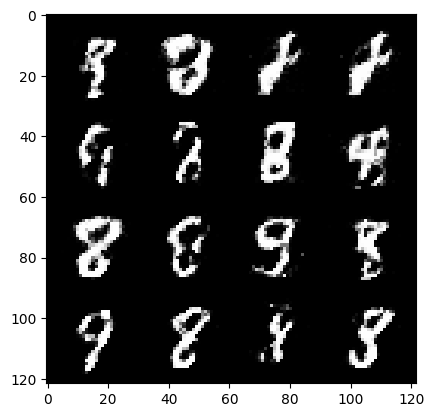

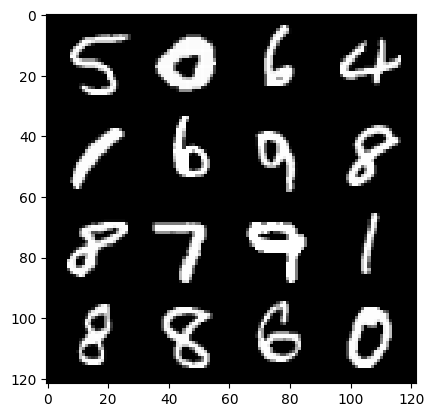

143: step 67200 / Gen loss 2.518523900906246 / Disc loss 0.2641189105808734


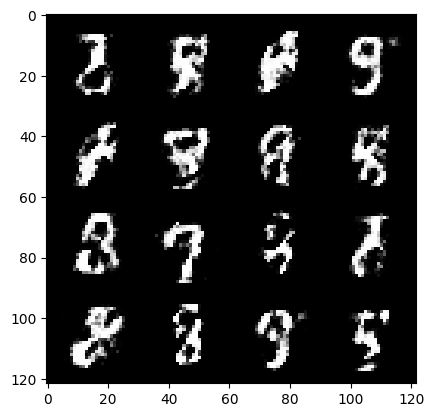

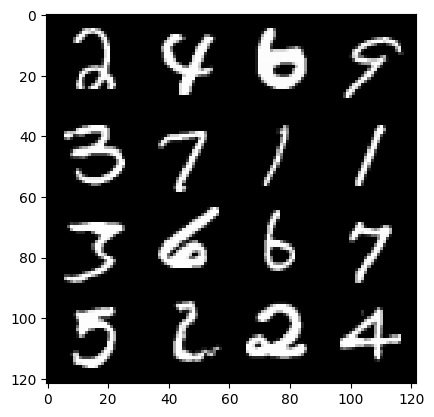

143: step 67500 / Gen loss 2.4046875162919363 / Disc loss 0.3037178100645542


  0%|          | 0/469 [00:00<?, ?it/s]

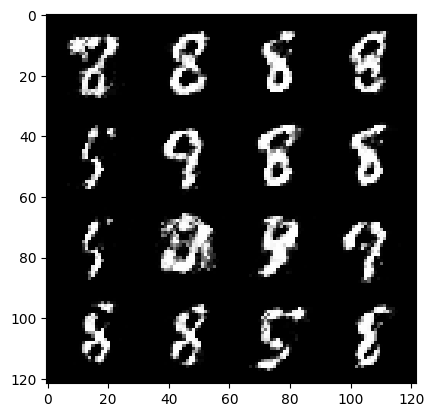

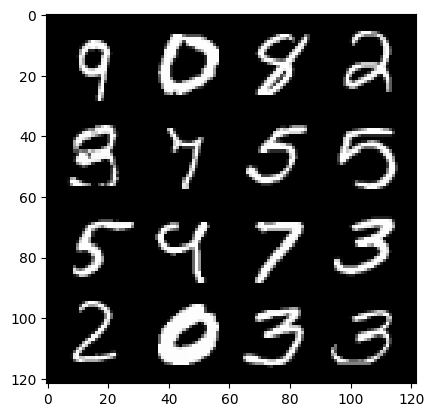

144: step 67800 / Gen loss 2.3355170114835118 / Disc loss 0.2967211053768796


  0%|          | 0/469 [00:00<?, ?it/s]

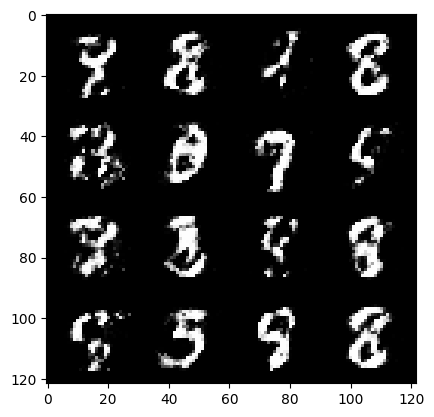

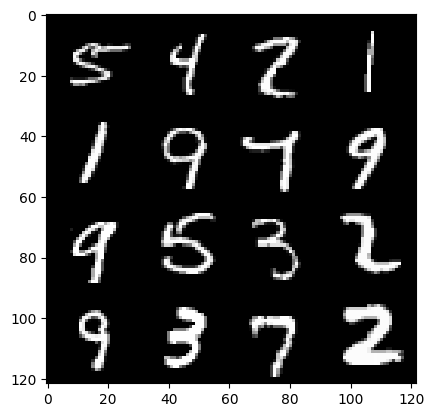

145: step 68100 / Gen loss 2.3206198430061358 / Disc loss 0.30509538864096025


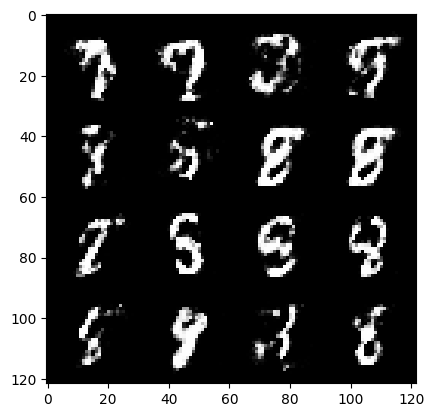

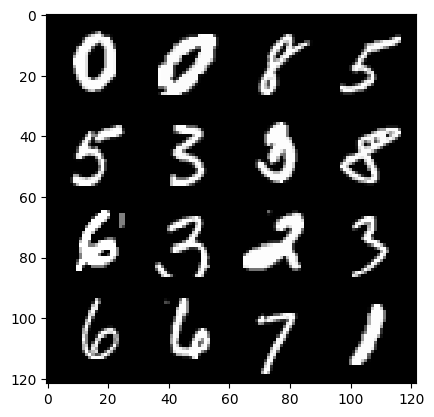

145: step 68400 / Gen loss 2.4362284819285085 / Disc loss 0.26534485643108696


  0%|          | 0/469 [00:00<?, ?it/s]

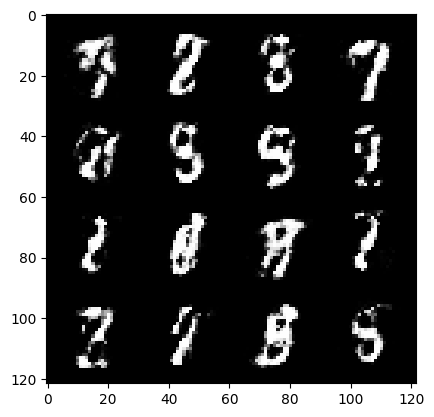

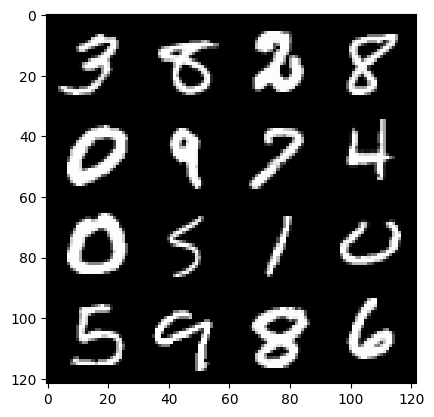

146: step 68700 / Gen loss 2.43409591237704 / Disc loss 0.2765658582746981


  0%|          | 0/469 [00:00<?, ?it/s]

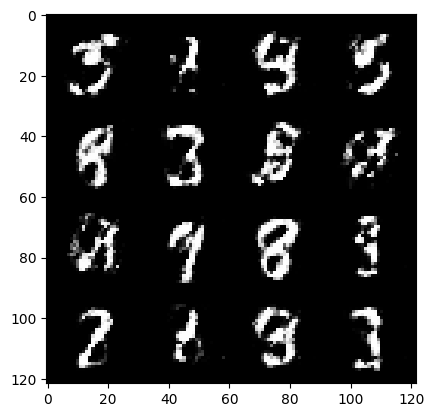

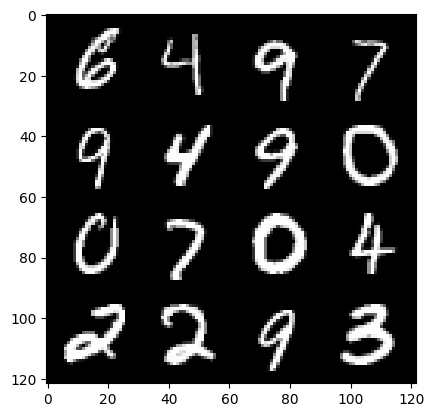

147: step 69000 / Gen loss 2.3968346619606016 / Disc loss 0.27315126637617754


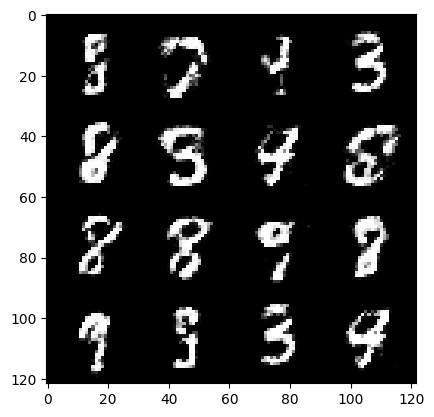

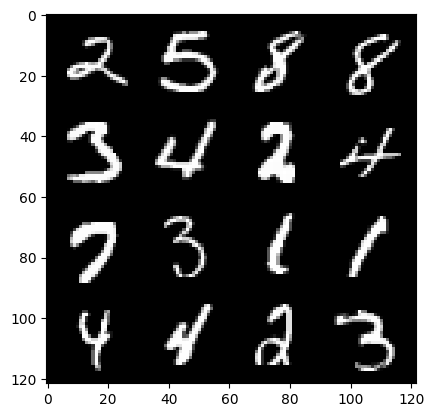

147: step 69300 / Gen loss 2.4887049659093208 / Disc loss 0.2642157280941802


  0%|          | 0/469 [00:00<?, ?it/s]

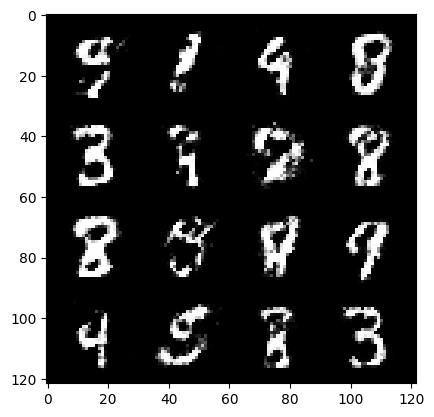

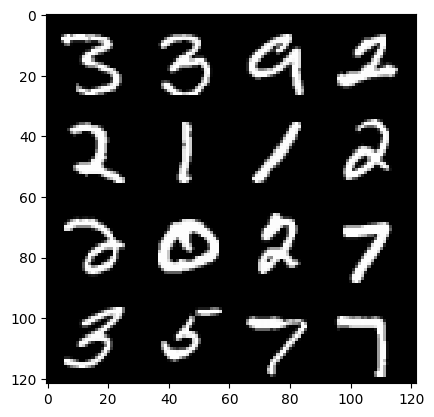

148: step 69600 / Gen loss 2.412070646683374 / Disc loss 0.29492105076710384


  0%|          | 0/469 [00:00<?, ?it/s]

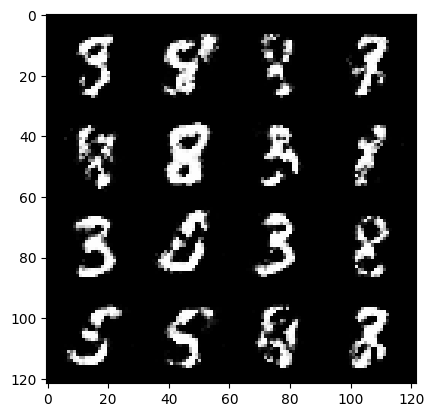

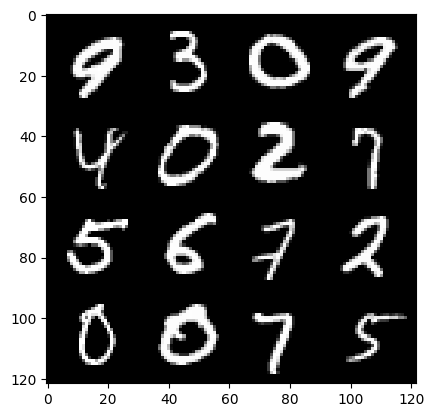

149: step 69900 / Gen loss 2.402798377275467 / Disc loss 0.27179253871242215


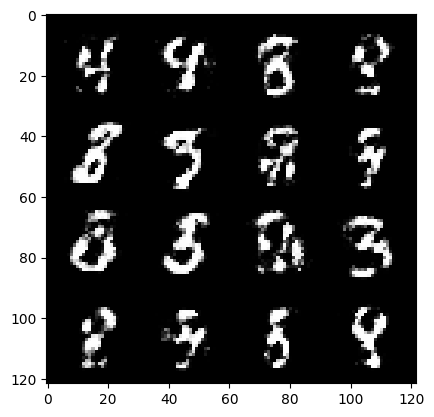

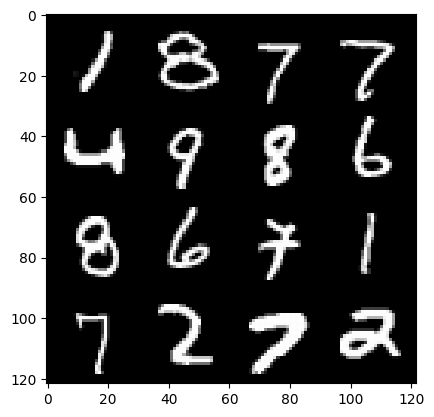

149: step 70200 / Gen loss 2.496851997375488 / Disc loss 0.25232604861259433


  0%|          | 0/469 [00:00<?, ?it/s]

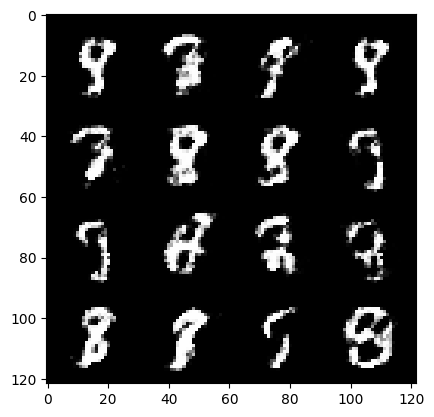

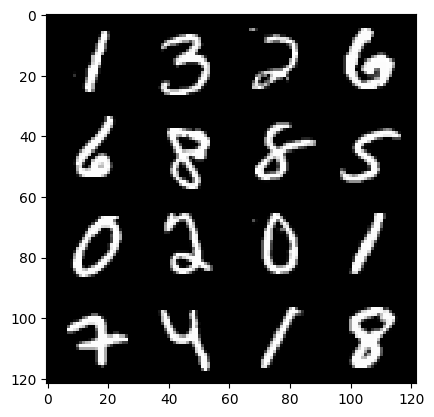

150: step 70500 / Gen loss 2.4101572712262467 / Disc loss 0.27556770662466684


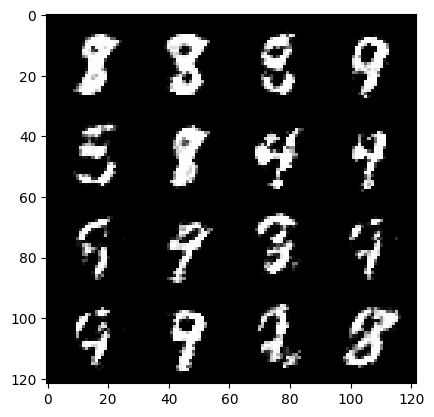

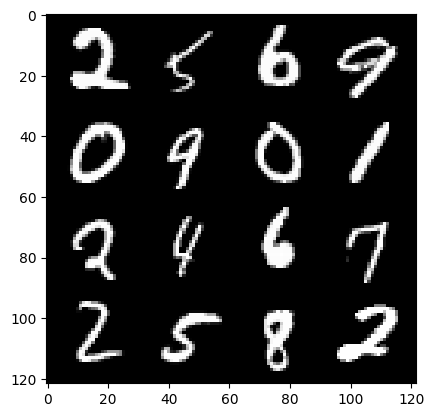

150: step 70800 / Gen loss 2.282717245022456 / Disc loss 0.30496006170908607


  0%|          | 0/469 [00:00<?, ?it/s]

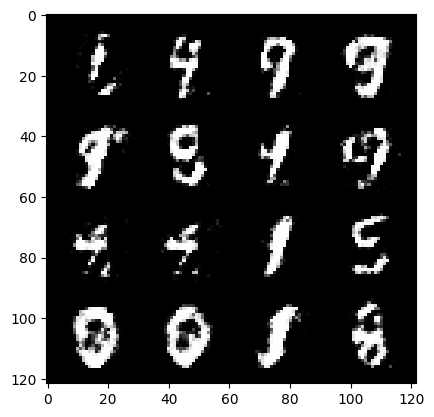

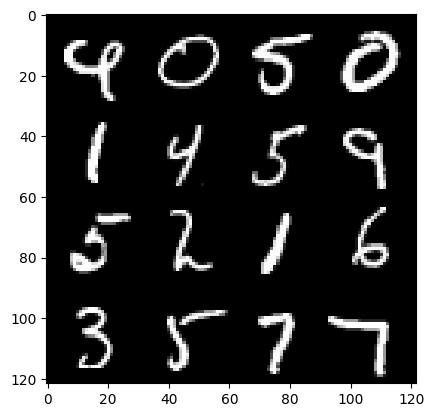

151: step 71100 / Gen loss 2.297774675289788 / Disc loss 0.2818944145242371


  0%|          | 0/469 [00:00<?, ?it/s]

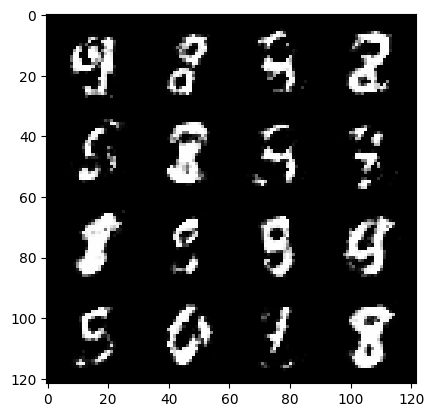

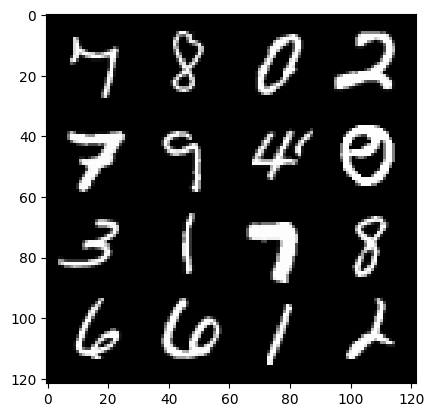

152: step 71400 / Gen loss 2.341215018828711 / Disc loss 0.27181642433007563


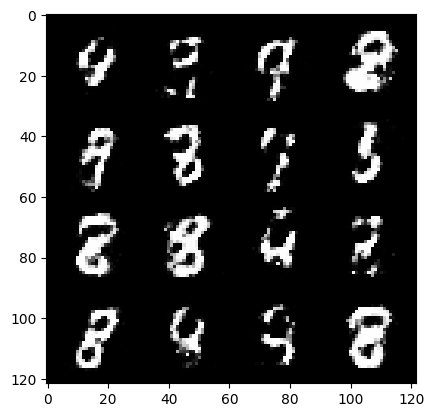

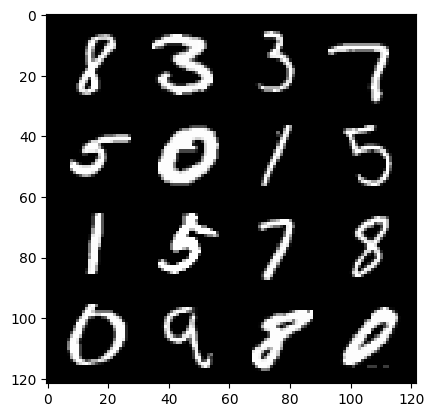

152: step 71700 / Gen loss 2.384459171692532 / Disc loss 0.27018484334150944


  0%|          | 0/469 [00:00<?, ?it/s]

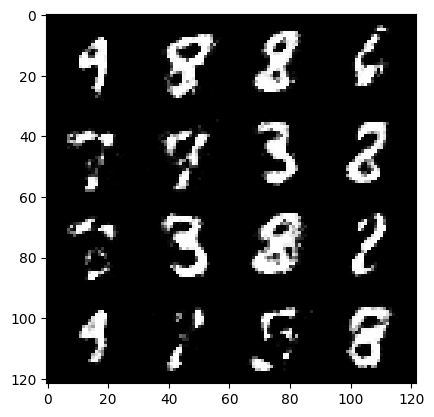

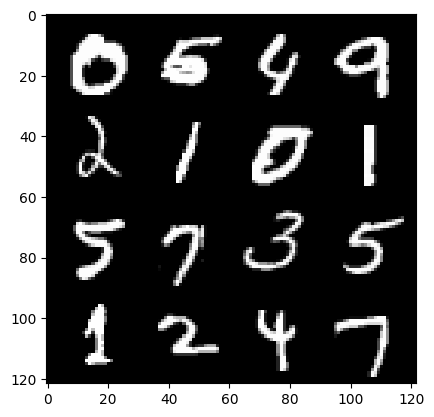

153: step 72000 / Gen loss 2.3814217936992654 / Disc loss 0.27842909599343924


  0%|          | 0/469 [00:00<?, ?it/s]

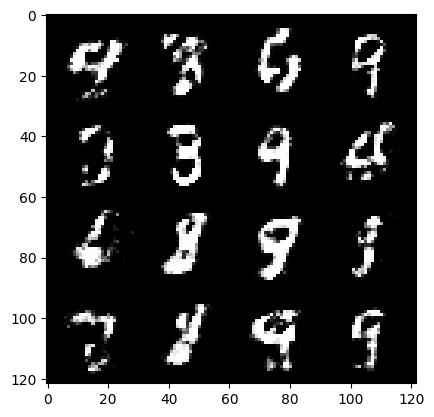

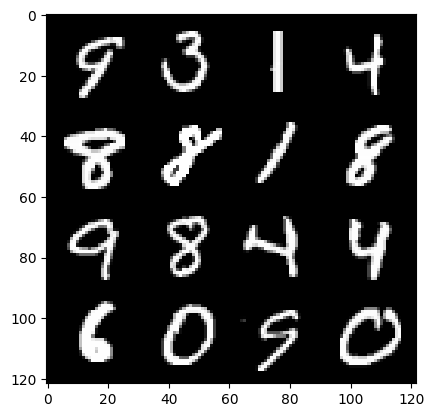

154: step 72300 / Gen loss 2.278610196908314 / Disc loss 0.2782187917331855


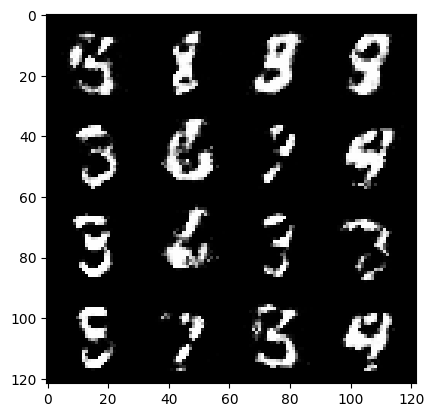

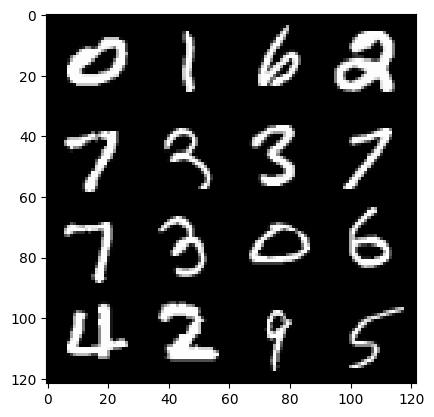

154: step 72600 / Gen loss 2.355084891319275 / Disc loss 0.280194785694281


  0%|          | 0/469 [00:00<?, ?it/s]

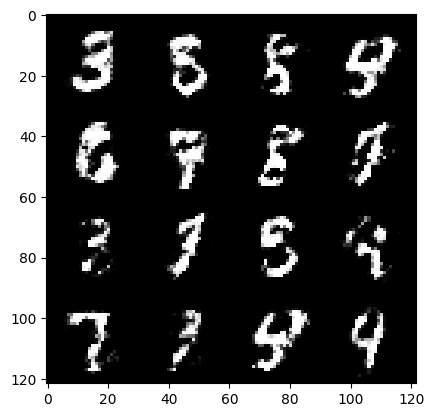

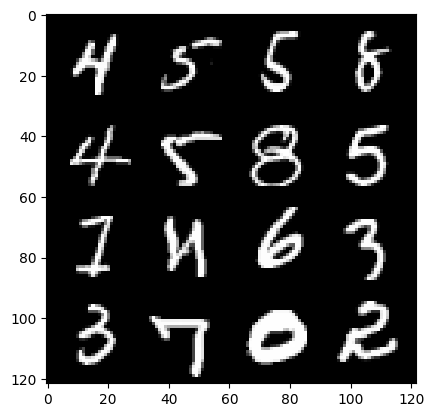

155: step 72900 / Gen loss 2.3123017962773633 / Disc loss 0.2927248784403005


  0%|          | 0/469 [00:00<?, ?it/s]

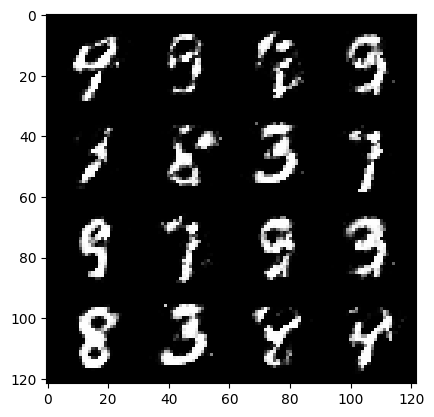

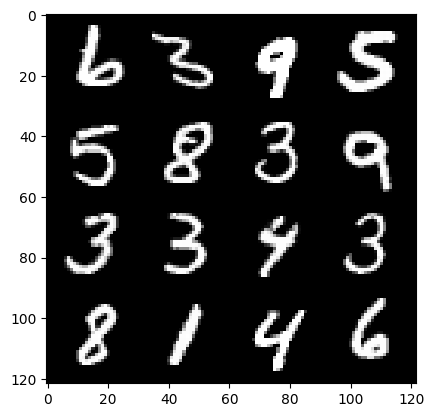

156: step 73200 / Gen loss 2.3193653225898716 / Disc loss 0.2774471798539161


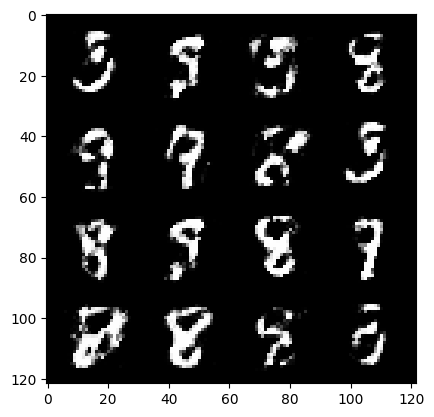

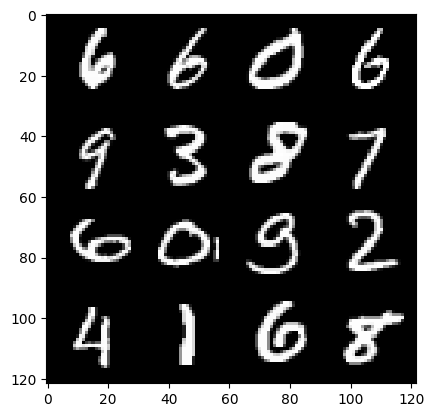

156: step 73500 / Gen loss 2.356077709197997 / Disc loss 0.27176498820384315


  0%|          | 0/469 [00:00<?, ?it/s]

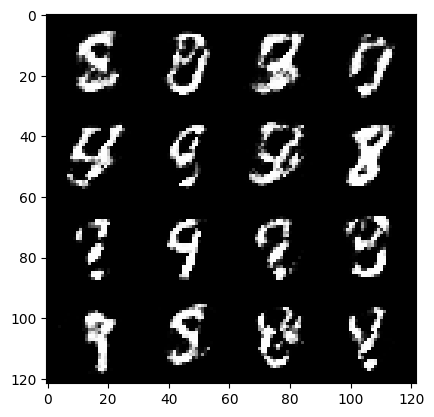

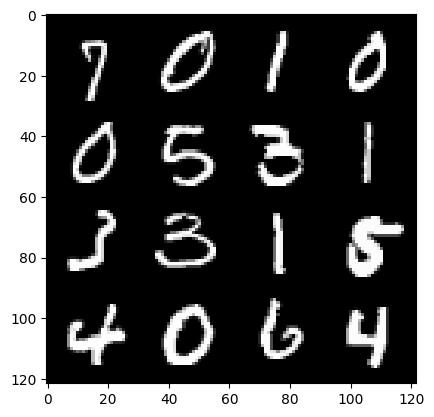

157: step 73800 / Gen loss 2.312986963589986 / Disc loss 0.2962960036098957


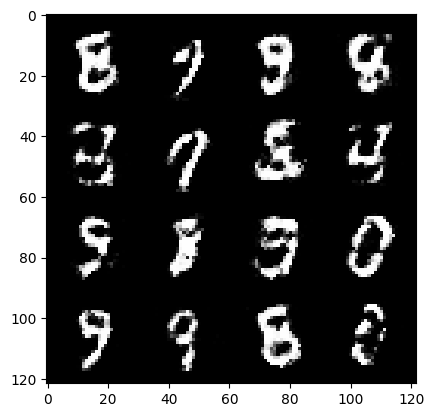

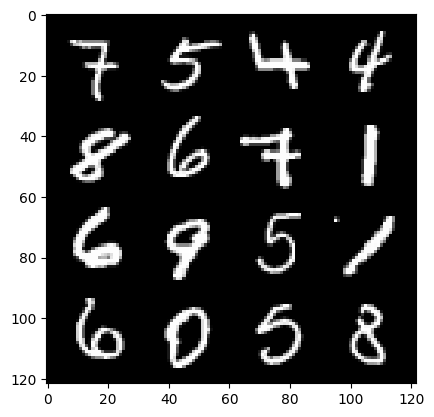

157: step 74100 / Gen loss 2.257180873155594 / Disc loss 0.30104716231425616


  0%|          | 0/469 [00:00<?, ?it/s]

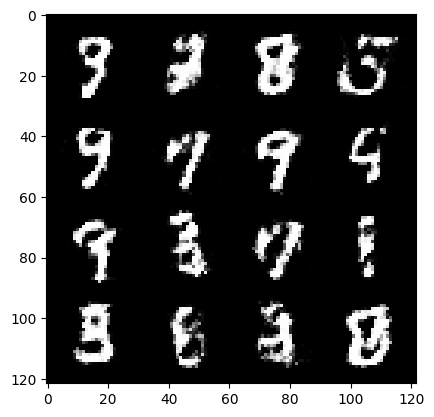

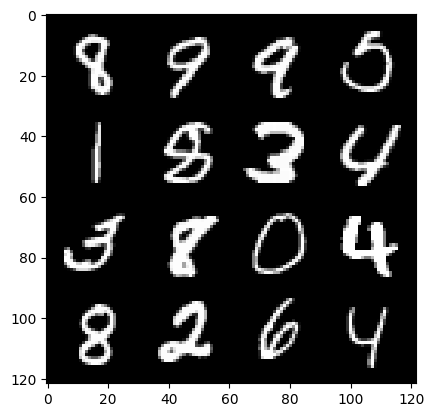

158: step 74400 / Gen loss 2.3273702784379324 / Disc loss 0.295020689268907


  0%|          | 0/469 [00:00<?, ?it/s]

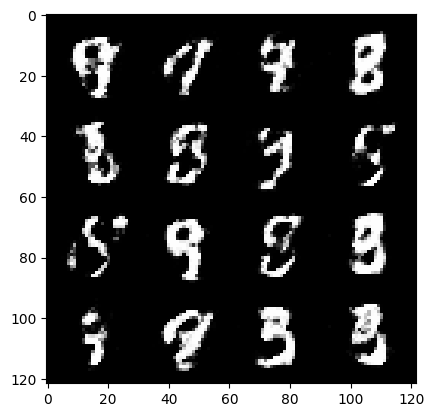

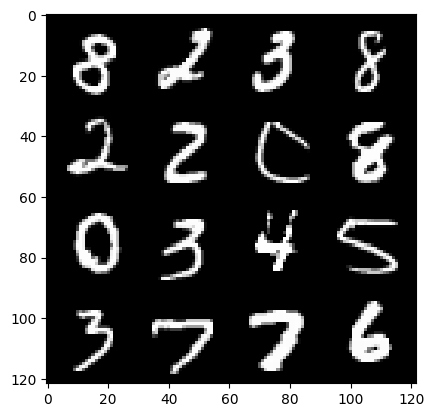

159: step 74700 / Gen loss 2.2940045233567554 / Disc loss 0.29155338426431027


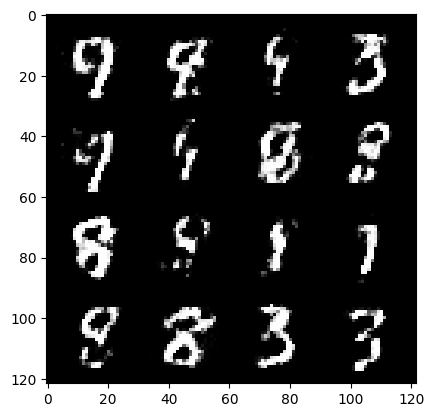

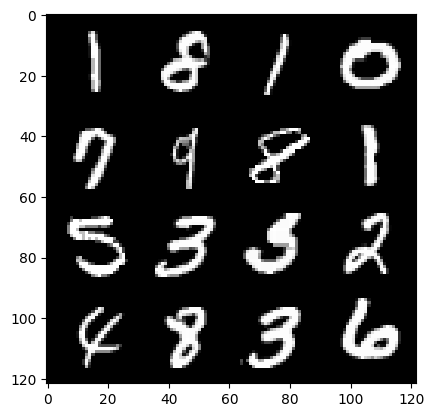

159: step 75000 / Gen loss 2.2696668807665503 / Disc loss 0.2939032552639644


  0%|          | 0/469 [00:00<?, ?it/s]

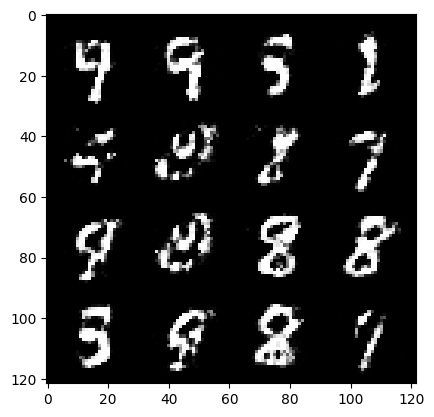

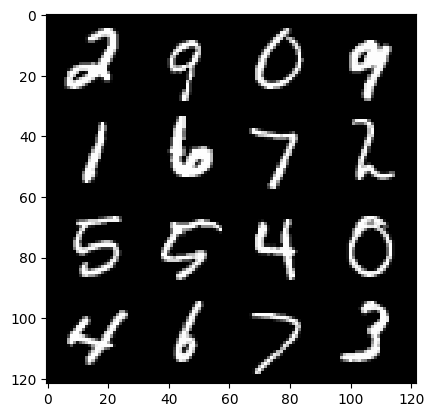

160: step 75300 / Gen loss 2.174002773761749 / Disc loss 0.30934469456473984


  0%|          | 0/469 [00:00<?, ?it/s]

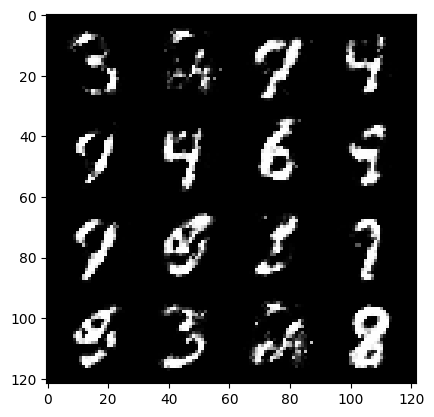

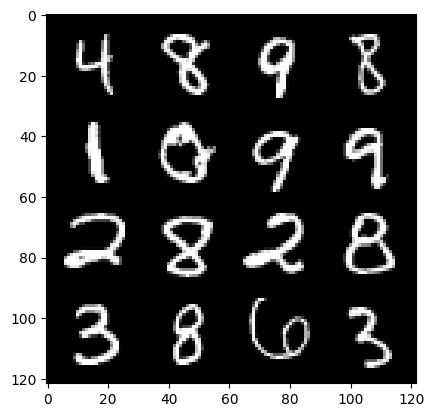

161: step 75600 / Gen loss 2.179037603537242 / Disc loss 0.30840952237447117


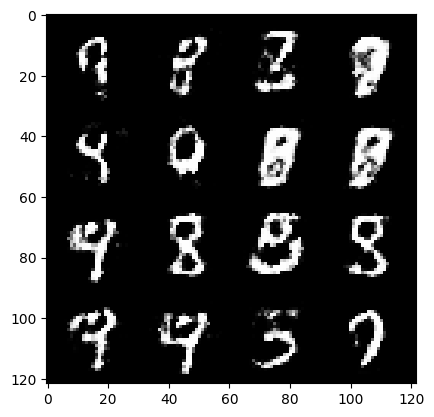

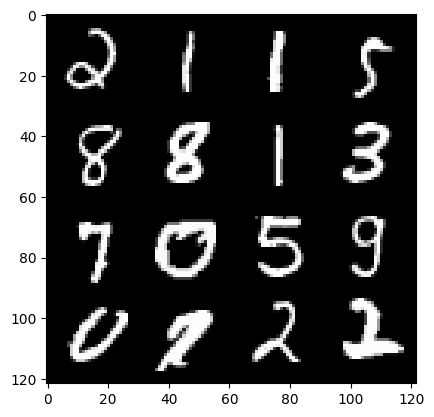

161: step 75900 / Gen loss 2.156155670086543 / Disc loss 0.32693867226441686


  0%|          | 0/469 [00:00<?, ?it/s]

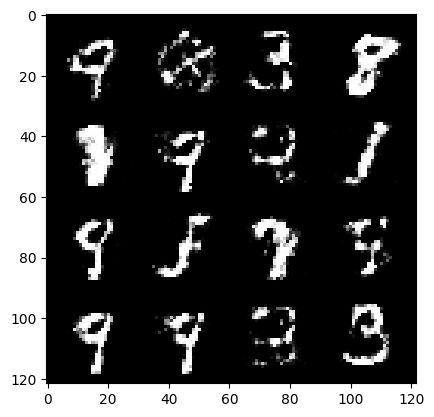

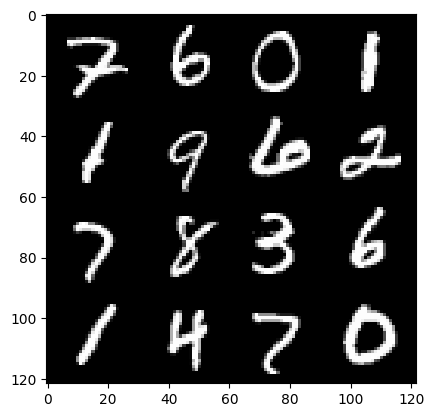

162: step 76200 / Gen loss 2.1966245317459108 / Disc loss 0.3007109057406586


  0%|          | 0/469 [00:00<?, ?it/s]

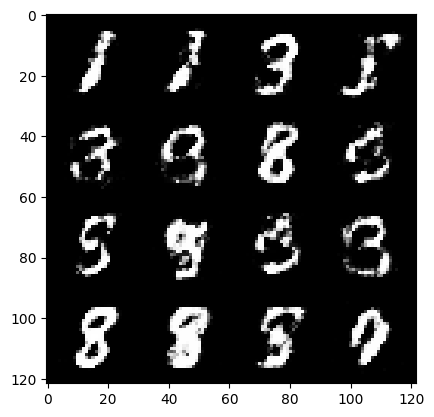

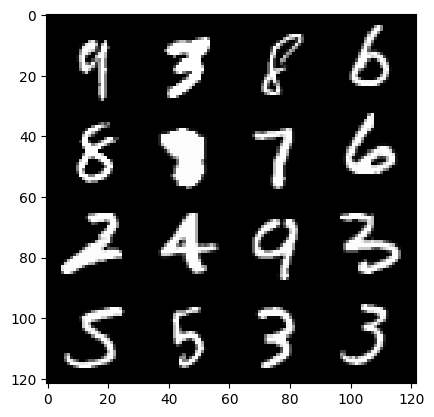

163: step 76500 / Gen loss 2.2345018418629956 / Disc loss 0.2892781336108846


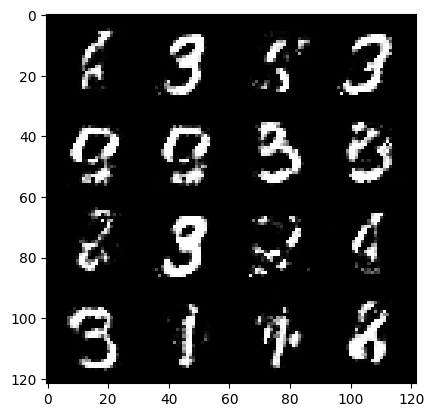

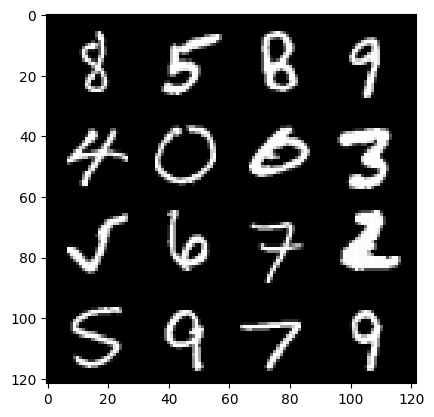

163: step 76800 / Gen loss 2.3437909344832093 / Disc loss 0.28021591519316025


  0%|          | 0/469 [00:00<?, ?it/s]

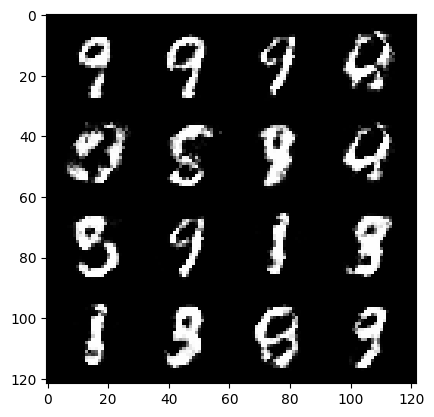

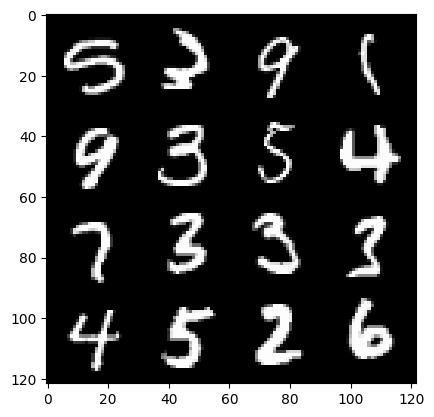

164: step 77100 / Gen loss 2.1884997443358105 / Disc loss 0.331596276213725


  0%|          | 0/469 [00:00<?, ?it/s]

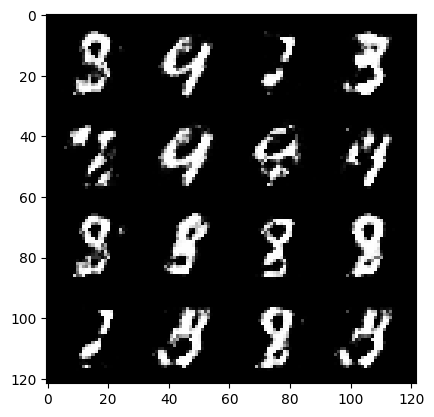

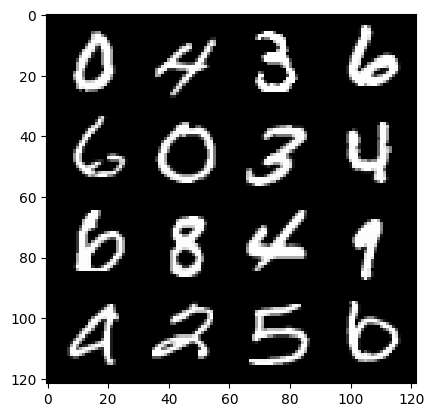

165: step 77400 / Gen loss 2.1997114022572846 / Disc loss 0.3144579056898753


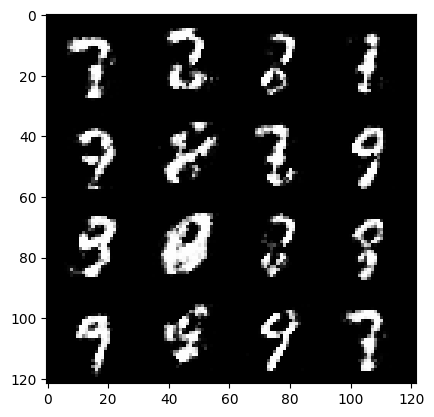

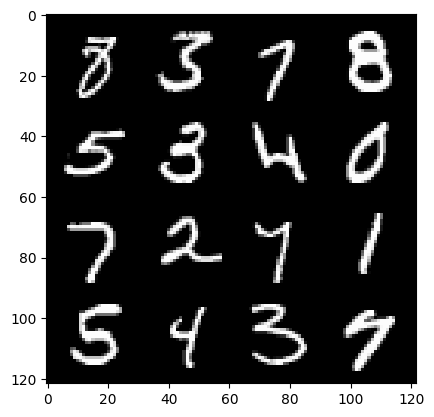

165: step 77700 / Gen loss 2.24795944929123 / Disc loss 0.29848029235998763


  0%|          | 0/469 [00:00<?, ?it/s]

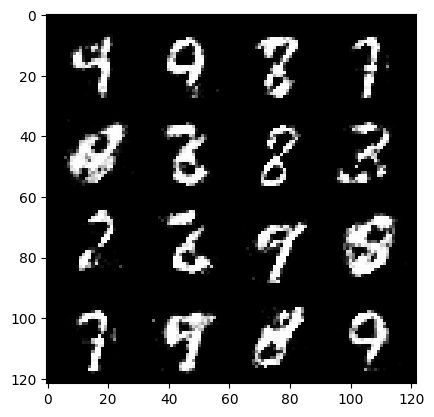

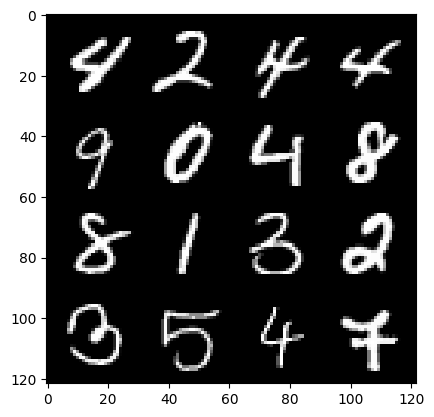

166: step 78000 / Gen loss 2.206560735702516 / Disc loss 0.32317480231324813


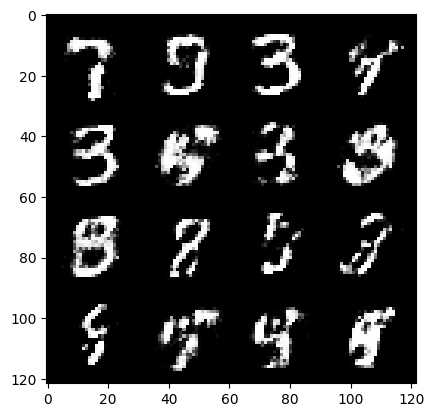

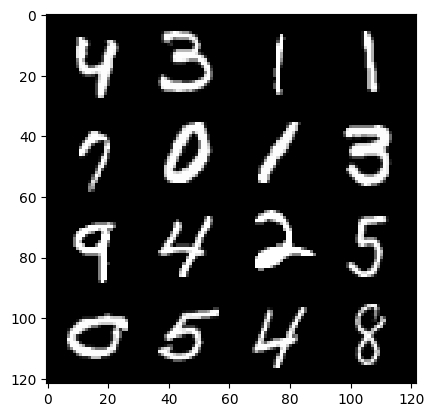

166: step 78300 / Gen loss 2.073972547849019 / Disc loss 0.3223080276449522


  0%|          | 0/469 [00:00<?, ?it/s]

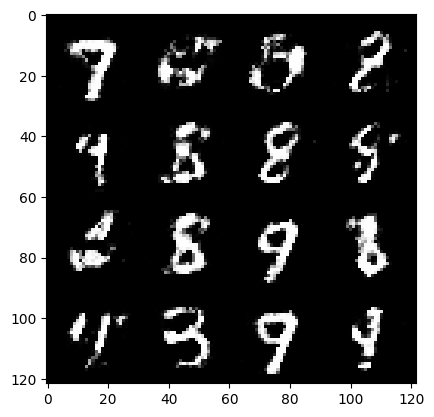

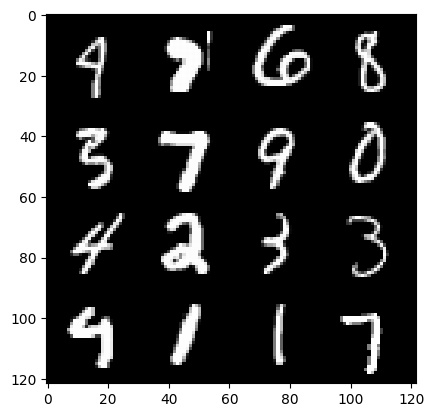

167: step 78600 / Gen loss 2.0237500099341084 / Disc loss 0.3465553788344065


  0%|          | 0/469 [00:00<?, ?it/s]

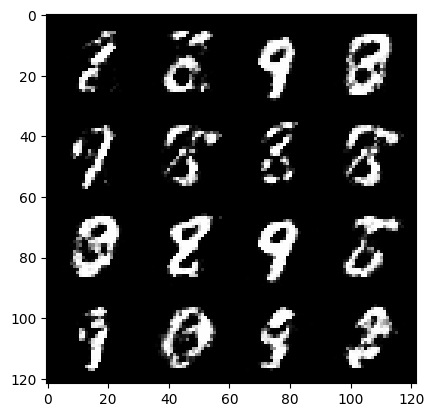

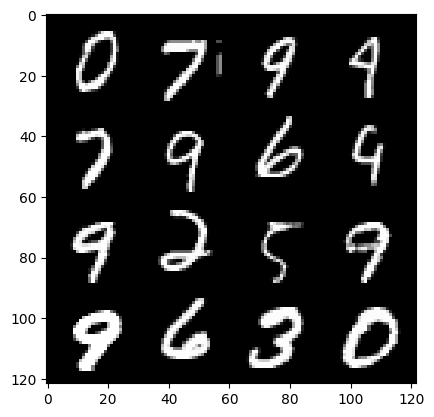

168: step 78900 / Gen loss 2.0899210401376083 / Disc loss 0.32772187386949836


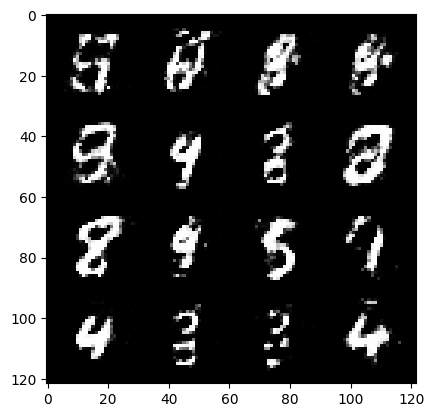

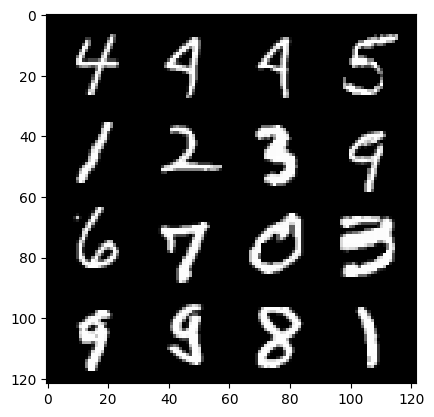

168: step 79200 / Gen loss 2.0844388524691264 / Disc loss 0.31063980405529357


  0%|          | 0/469 [00:00<?, ?it/s]

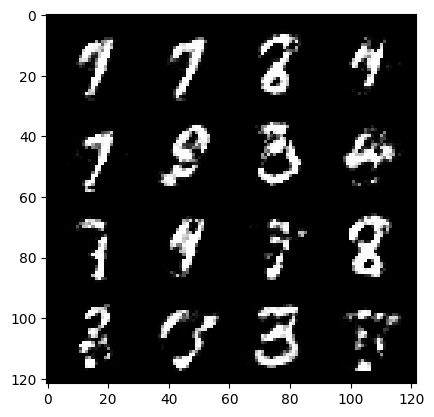

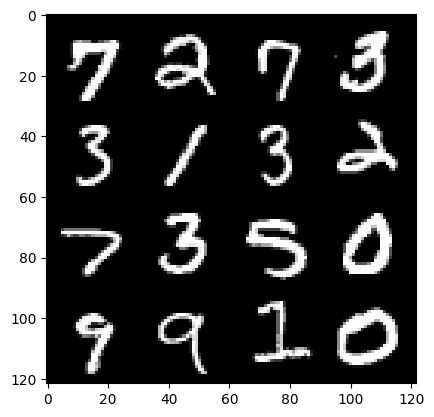

169: step 79500 / Gen loss 2.2372394851843533 / Disc loss 0.2745780232052009


  0%|          | 0/469 [00:00<?, ?it/s]

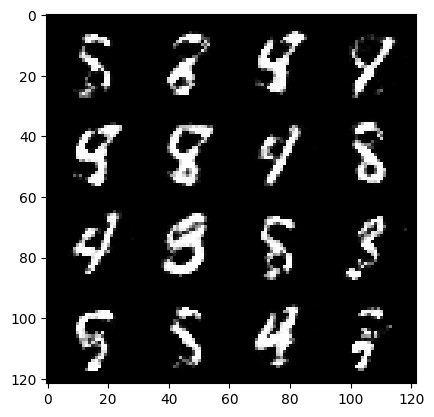

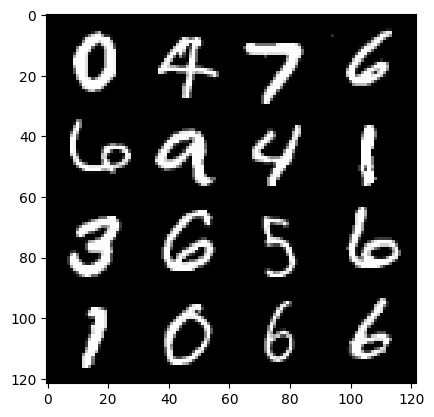

170: step 79800 / Gen loss 2.186021762688953 / Disc loss 0.3116806949178377


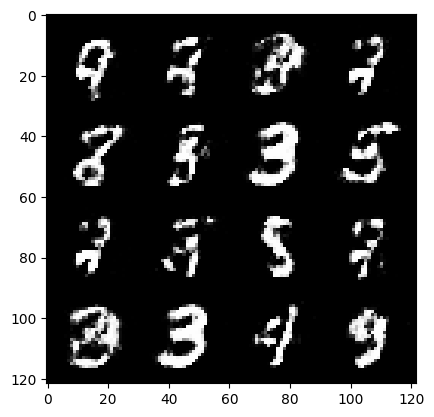

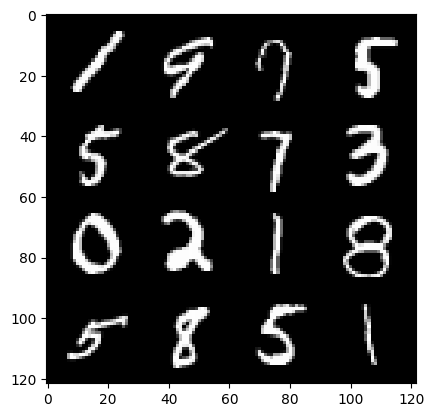

170: step 80100 / Gen loss 2.143842808405559 / Disc loss 0.313948195030292


  0%|          | 0/469 [00:00<?, ?it/s]

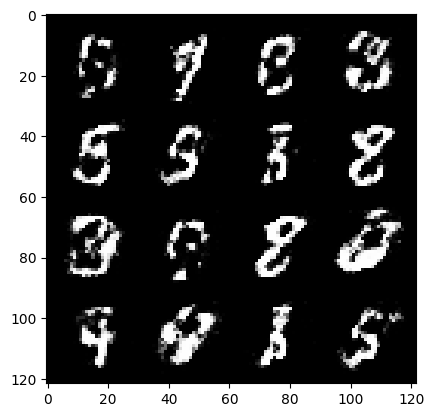

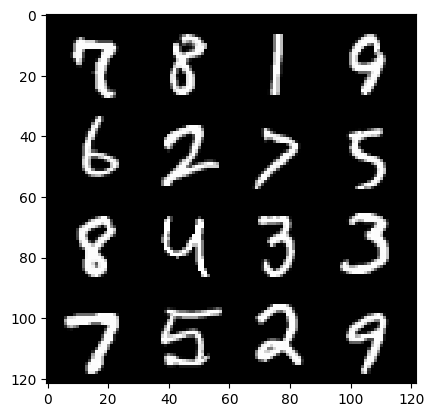

171: step 80400 / Gen loss 2.0354473574956256 / Disc loss 0.344497717320919


  0%|          | 0/469 [00:00<?, ?it/s]

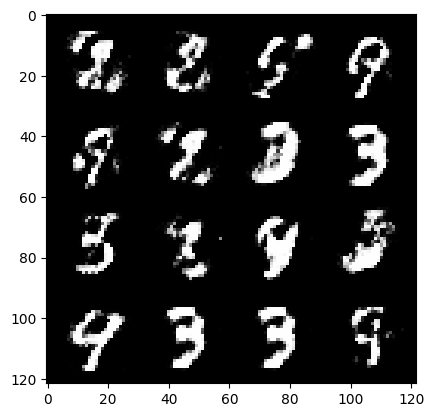

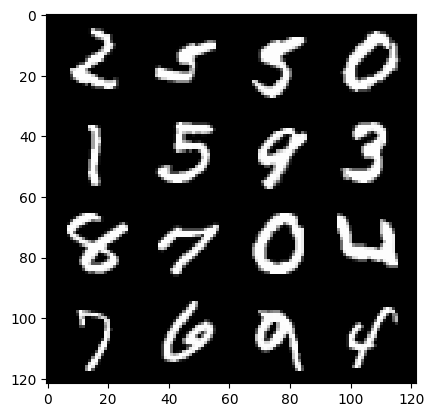

172: step 80700 / Gen loss 2.111279278198877 / Disc loss 0.3122100580732025


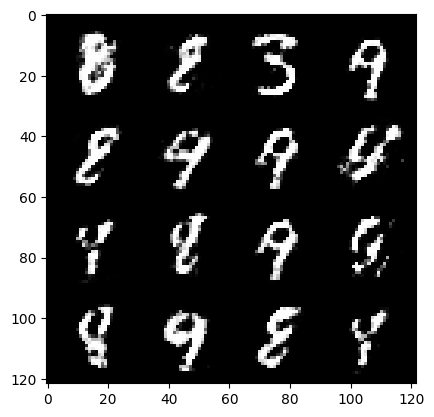

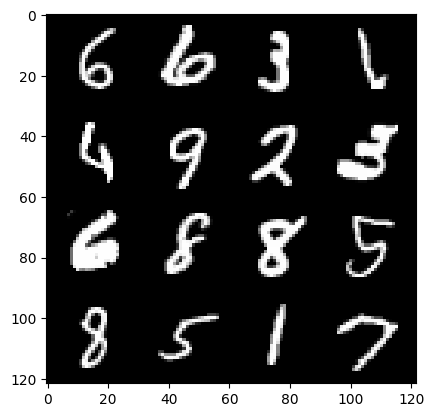

172: step 81000 / Gen loss 2.137637004057567 / Disc loss 0.2950972169637677


  0%|          | 0/469 [00:00<?, ?it/s]

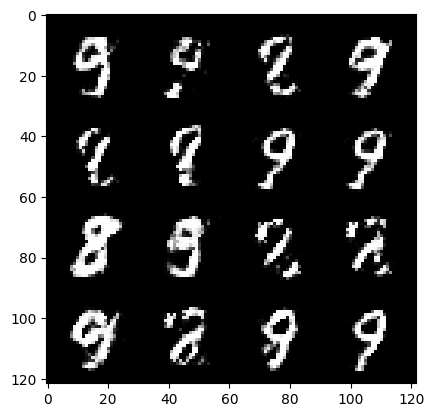

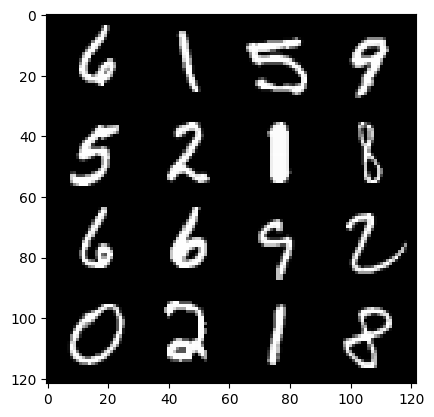

173: step 81300 / Gen loss 2.173894580602645 / Disc loss 0.29486765677730276


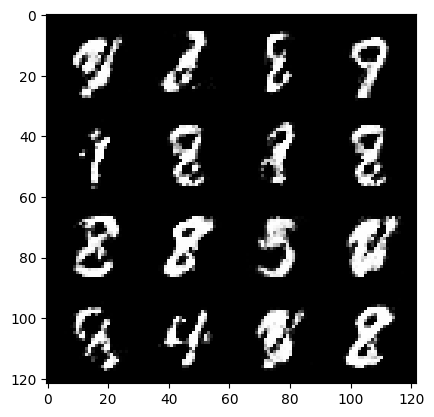

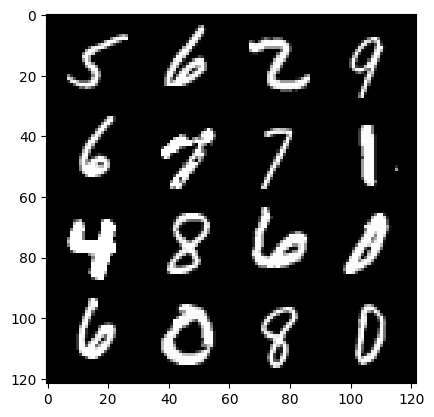

173: step 81600 / Gen loss 2.140247261524201 / Disc loss 0.30392560407519353


  0%|          | 0/469 [00:00<?, ?it/s]

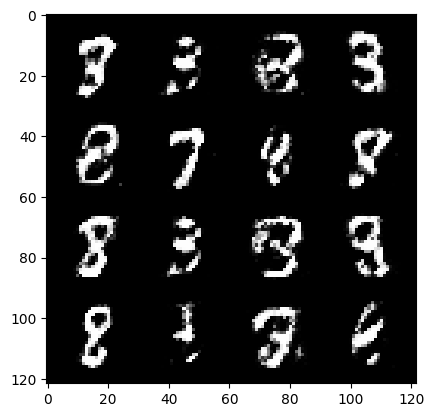

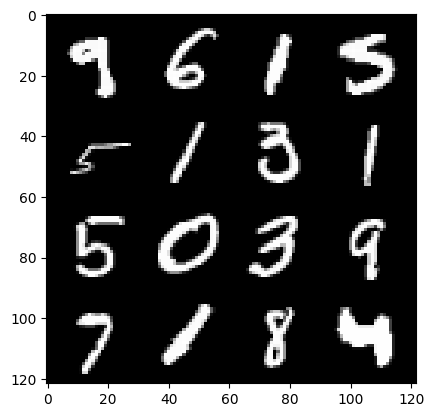

174: step 81900 / Gen loss 2.148082161347069 / Disc loss 0.3173500709235667


  0%|          | 0/469 [00:00<?, ?it/s]

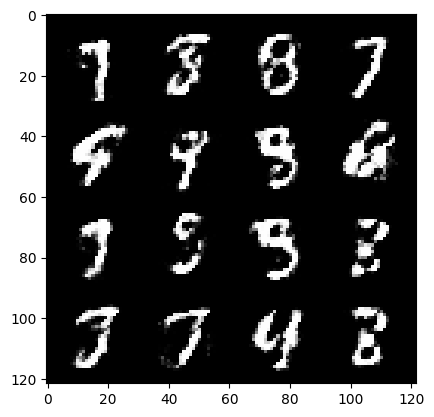

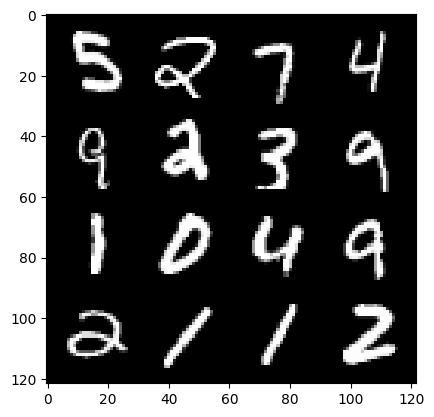

175: step 82200 / Gen loss 2.049704172611238 / Disc loss 0.3451455725729465


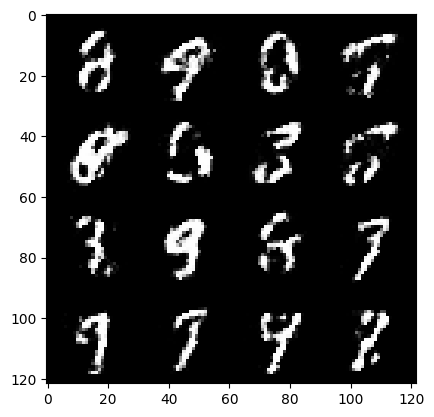

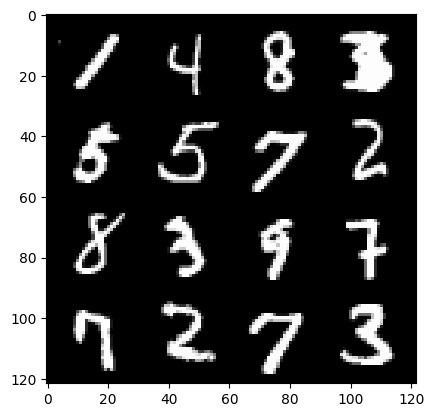

175: step 82500 / Gen loss 2.026206002632778 / Disc loss 0.33774295027057316


  0%|          | 0/469 [00:00<?, ?it/s]

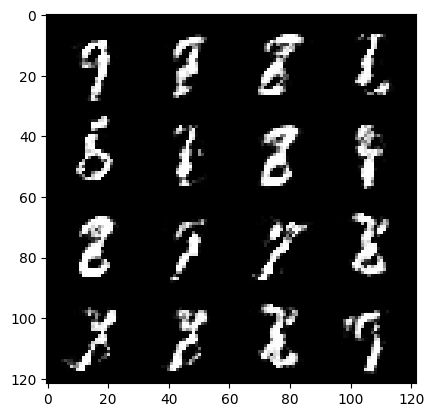

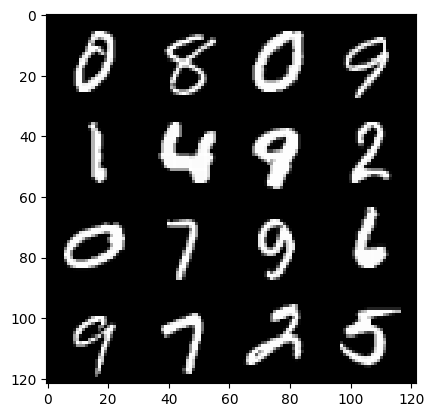

176: step 82800 / Gen loss 2.003724864721298 / Disc loss 0.33359917402267447


  0%|          | 0/469 [00:00<?, ?it/s]

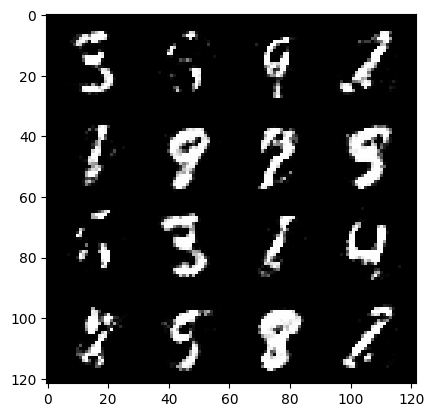

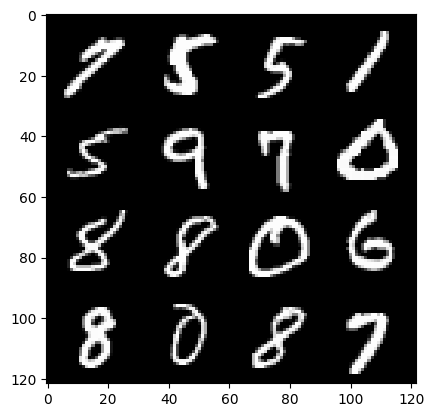

177: step 83100 / Gen loss 2.061409908533096 / Disc loss 0.3261460107564925


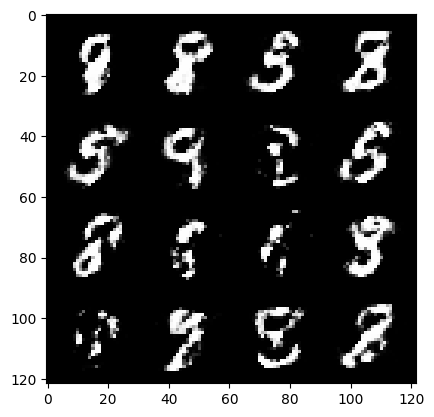

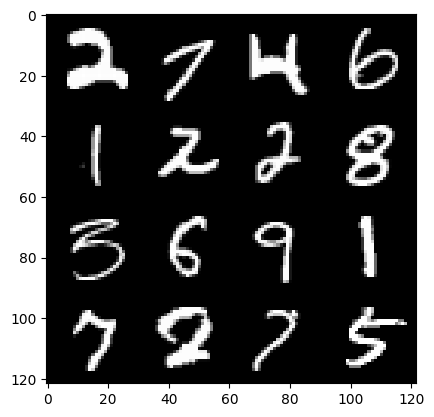

177: step 83400 / Gen loss 2.1455233645439136 / Disc loss 0.31532572105526924


  0%|          | 0/469 [00:00<?, ?it/s]

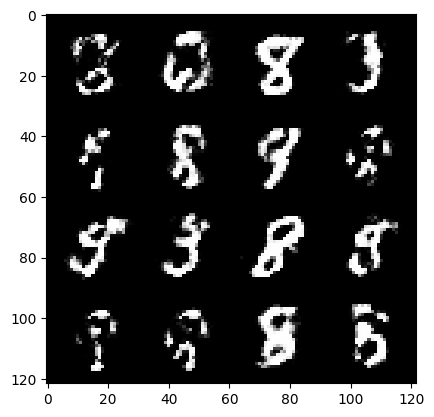

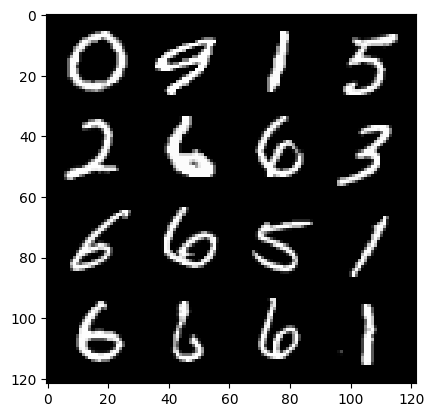

178: step 83700 / Gen loss 2.036704357067744 / Disc loss 0.3381805820763111


  0%|          | 0/469 [00:00<?, ?it/s]

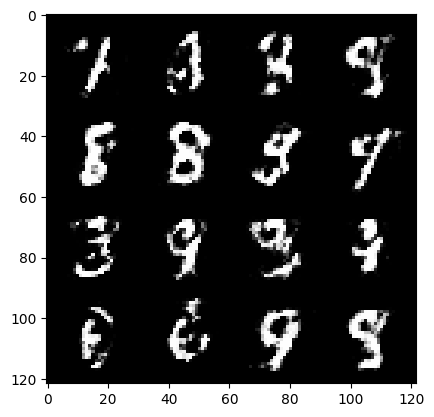

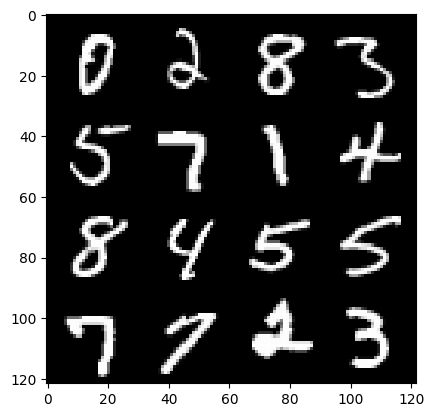

179: step 84000 / Gen loss 2.0989312620957694 / Disc loss 0.31867296377817794


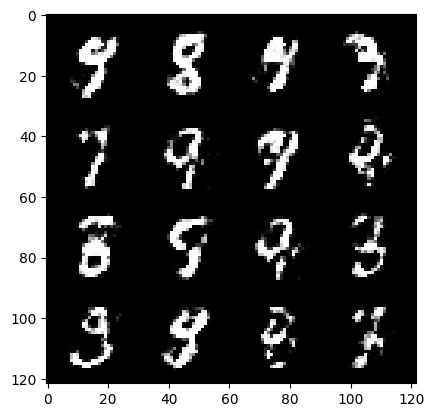

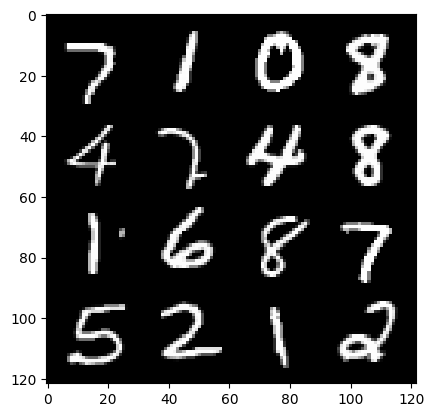

179: step 84300 / Gen loss 2.0277557460467026 / Disc loss 0.3204981894791128


  0%|          | 0/469 [00:00<?, ?it/s]

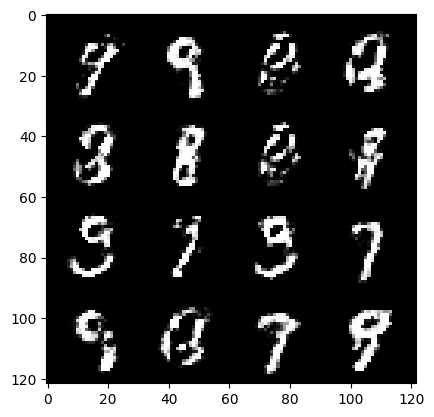

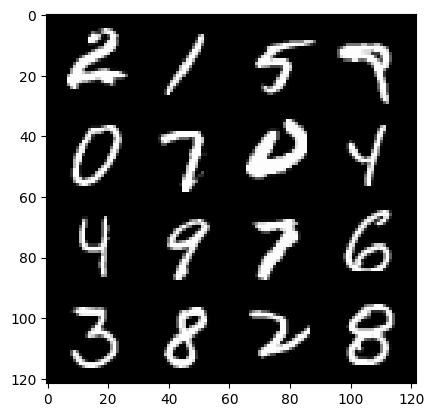

180: step 84600 / Gen loss 2.1982982508341466 / Disc loss 0.28695983350276955


  0%|          | 0/469 [00:00<?, ?it/s]

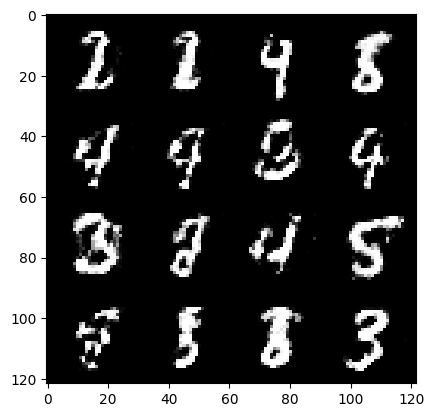

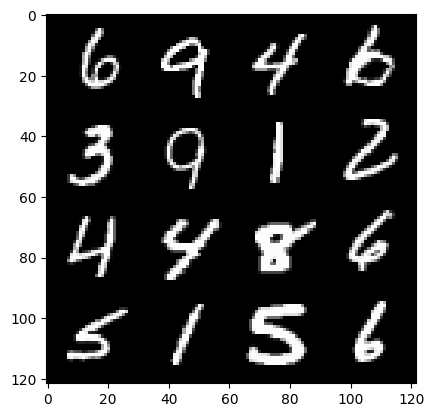

181: step 84900 / Gen loss 2.109599233865737 / Disc loss 0.327290170143048


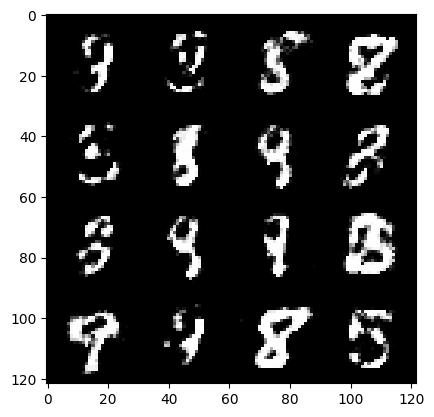

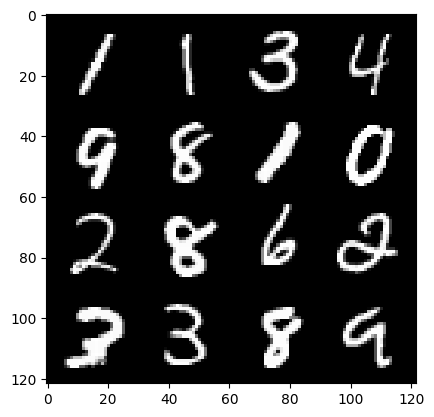

181: step 85200 / Gen loss 2.046440653800965 / Disc loss 0.33018138254682233


  0%|          | 0/469 [00:00<?, ?it/s]

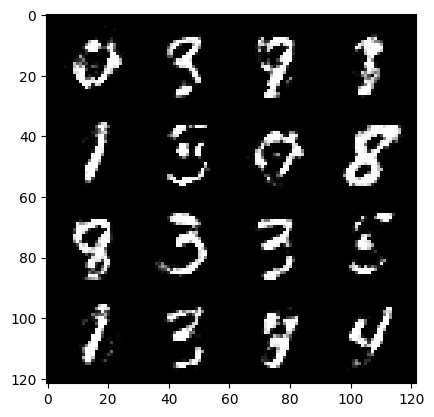

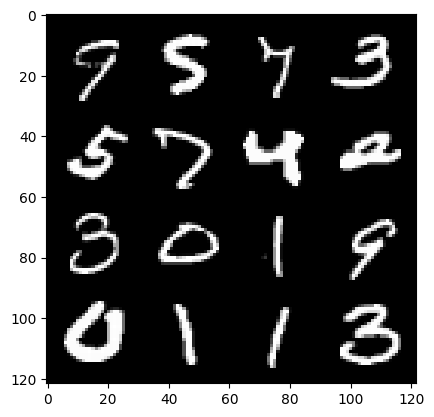

182: step 85500 / Gen loss 2.1019569313526167 / Disc loss 0.3139243309199813


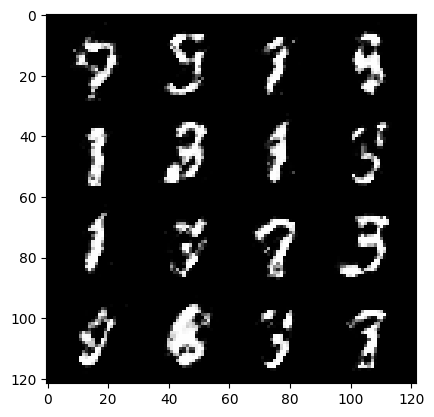

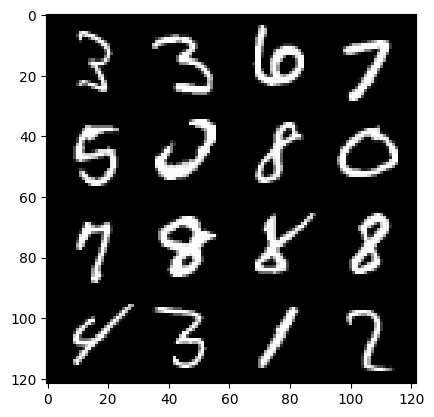

182: step 85800 / Gen loss 2.0617910655339546 / Disc loss 0.3321672553817429


  0%|          | 0/469 [00:00<?, ?it/s]

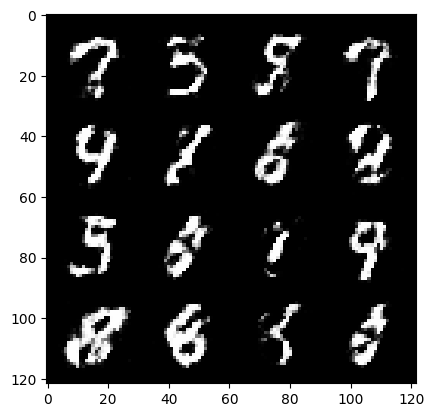

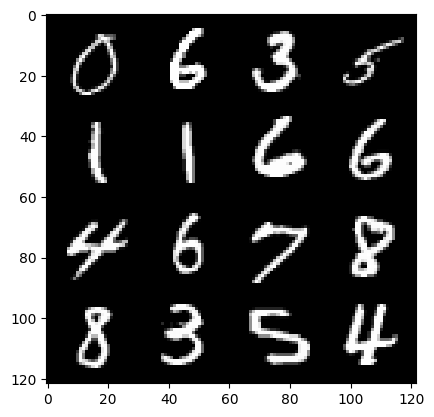

183: step 86100 / Gen loss 2.0578764581680273 / Disc loss 0.32384710078438156


  0%|          | 0/469 [00:00<?, ?it/s]

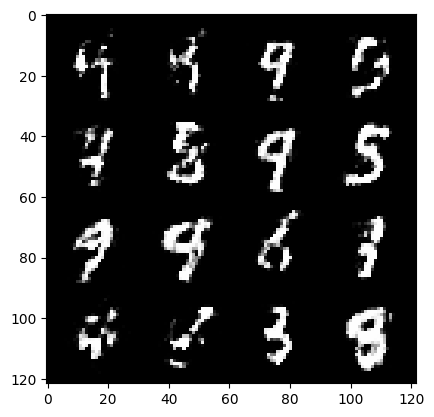

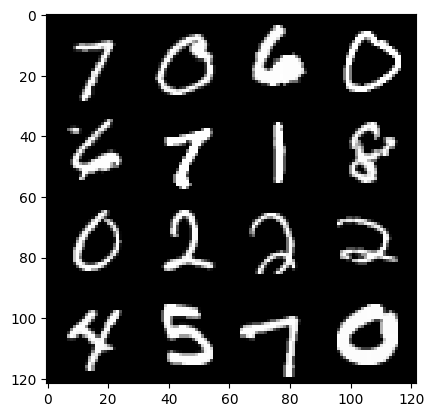

184: step 86400 / Gen loss 2.079264795780181 / Disc loss 0.33369125574827196


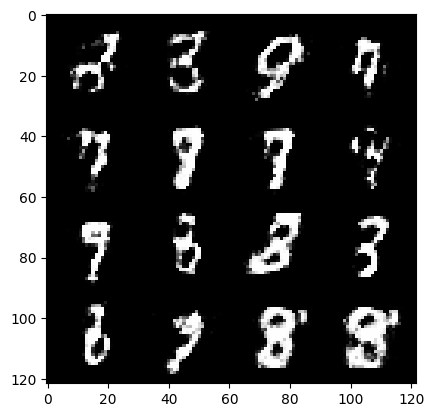

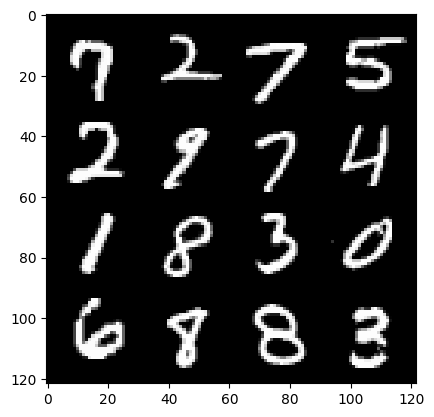

184: step 86700 / Gen loss 2.0394909369945537 / Disc loss 0.34313093577822046


  0%|          | 0/469 [00:00<?, ?it/s]

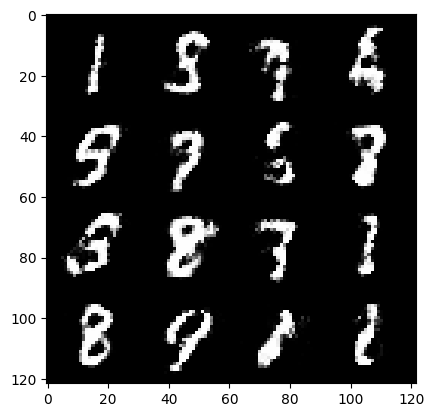

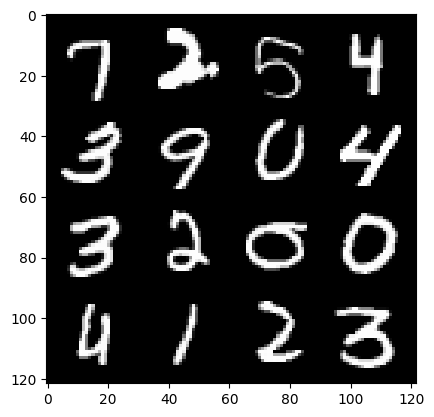

185: step 87000 / Gen loss 2.016110034386316 / Disc loss 0.3244534673790136


  0%|          | 0/469 [00:00<?, ?it/s]

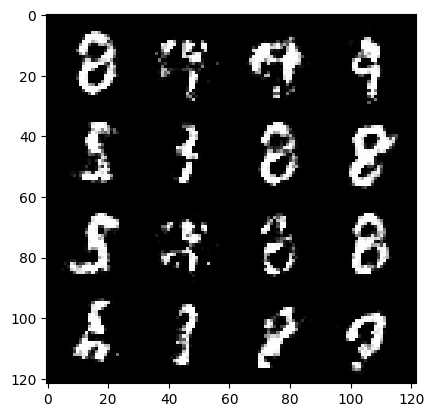

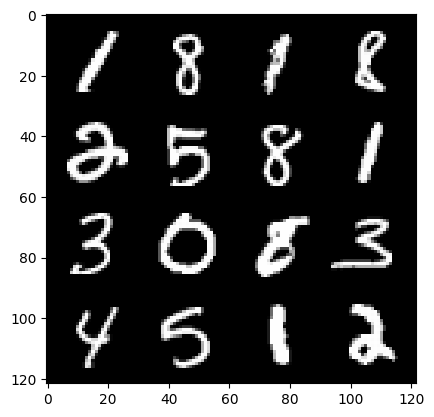

186: step 87300 / Gen loss 2.0643096907933547 / Disc loss 0.320431509912014


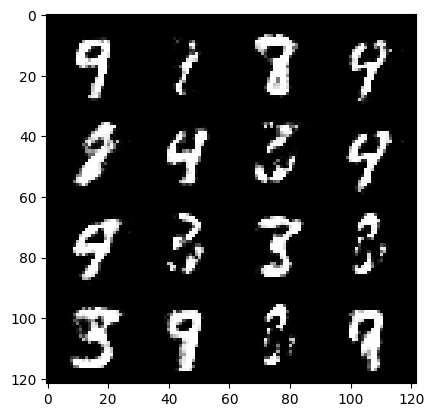

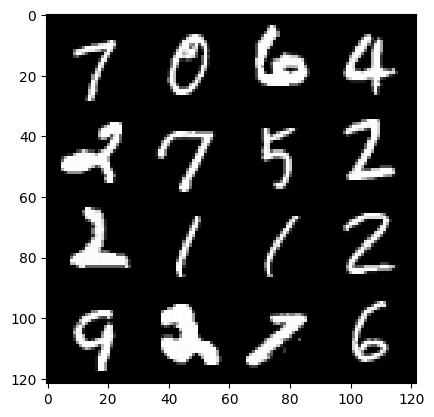

186: step 87600 / Gen loss 2.0266483219464613 / Disc loss 0.33010743473966897


  0%|          | 0/469 [00:00<?, ?it/s]

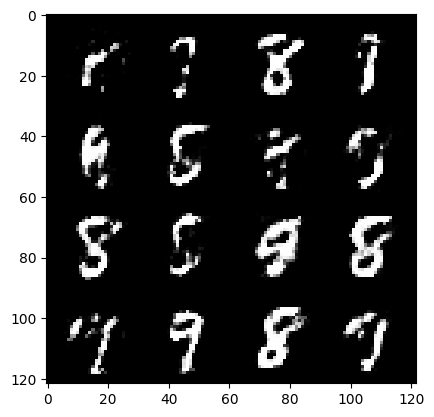

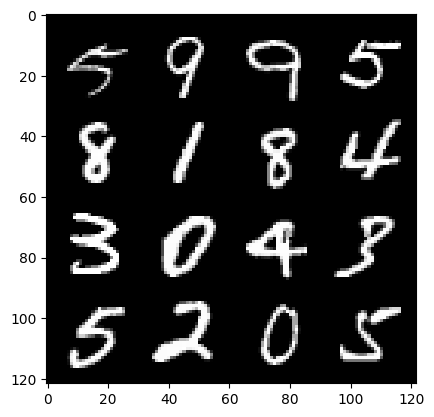

187: step 87900 / Gen loss 2.0556819693247474 / Disc loss 0.3076469086110595


  0%|          | 0/469 [00:00<?, ?it/s]

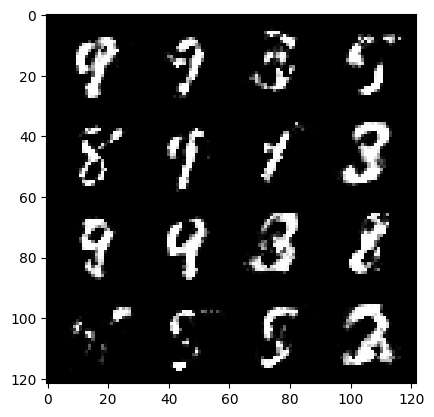

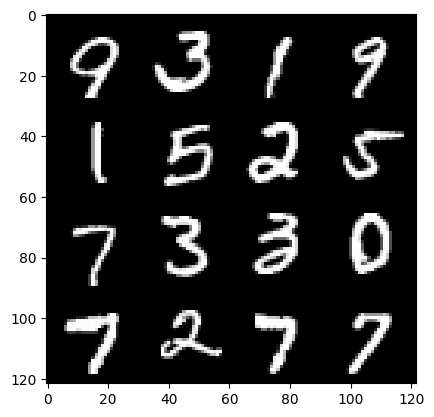

188: step 88200 / Gen loss 2.048134847482047 / Disc loss 0.3050168650348981


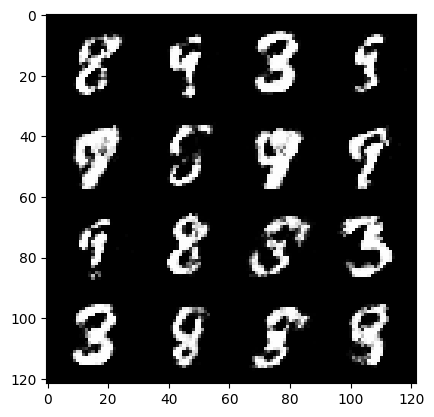

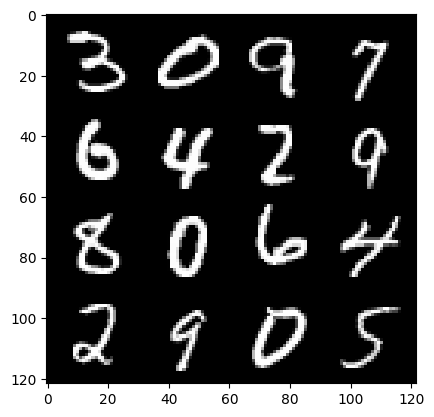

188: step 88500 / Gen loss 2.060627268552782 / Disc loss 0.30806316177050264


  0%|          | 0/469 [00:00<?, ?it/s]

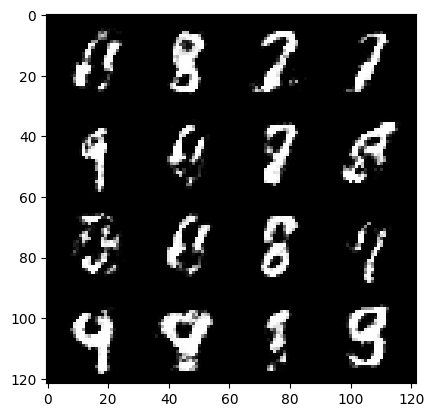

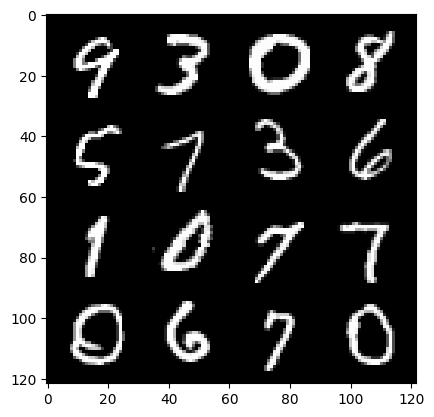

189: step 88800 / Gen loss 2.0550119260946906 / Disc loss 0.32232761199275634


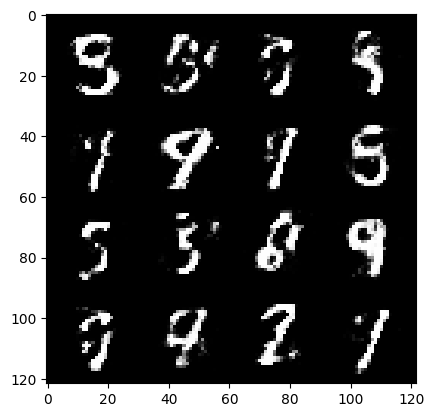

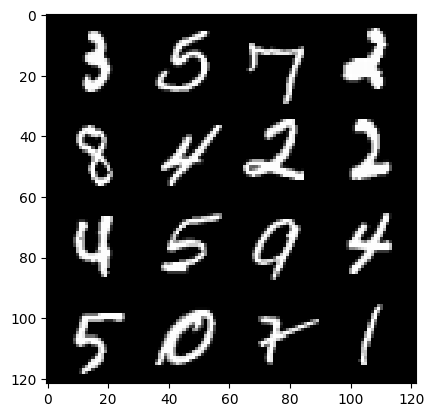

189: step 89100 / Gen loss 1.9491899406909932 / Disc loss 0.3584436412652336


  0%|          | 0/469 [00:00<?, ?it/s]

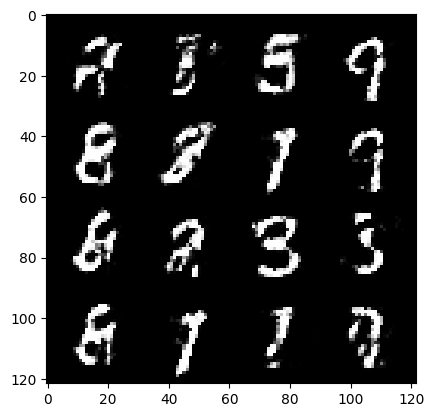

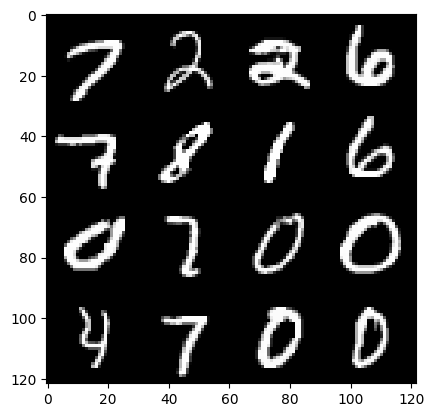

190: step 89400 / Gen loss 2.0251830482482913 / Disc loss 0.32441076224048954


  0%|          | 0/469 [00:00<?, ?it/s]

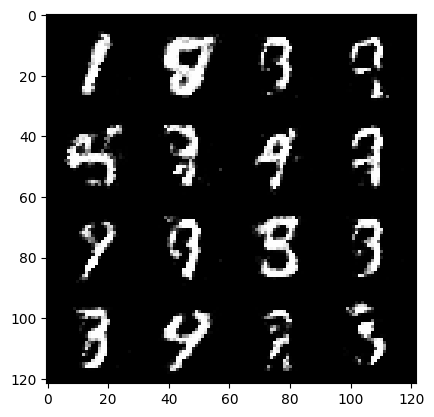

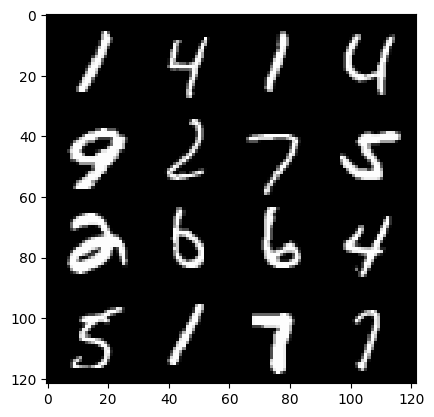

191: step 89700 / Gen loss 2.0499169548352563 / Disc loss 0.32098096296191214


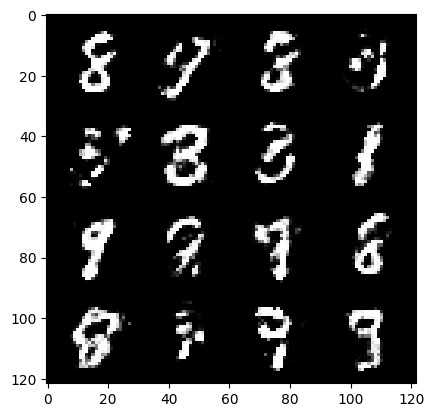

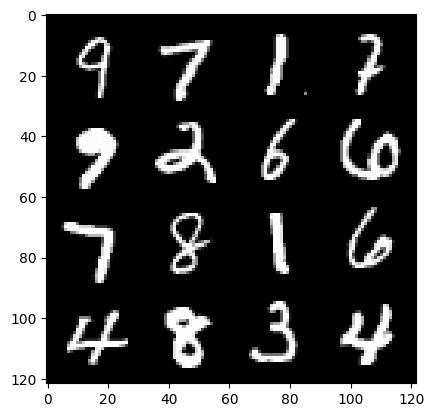

191: step 90000 / Gen loss 2.0007693318525948 / Disc loss 0.33747518092393874


  0%|          | 0/469 [00:00<?, ?it/s]

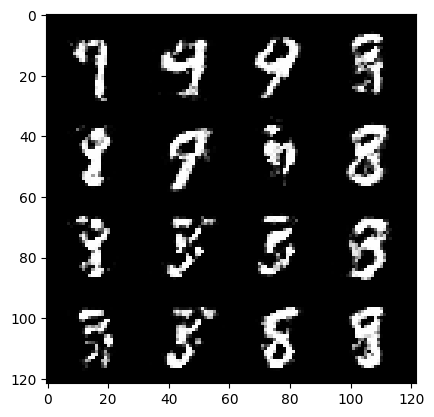

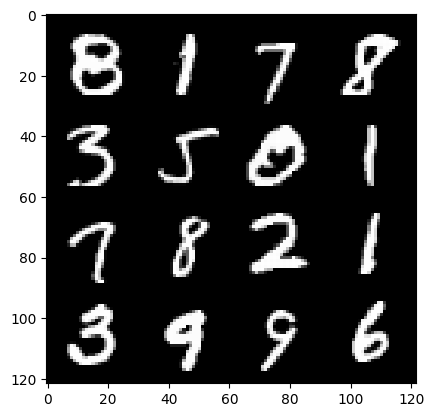

192: step 90300 / Gen loss 1.9985894759496041 / Disc loss 0.3220365352928639


  0%|          | 0/469 [00:00<?, ?it/s]

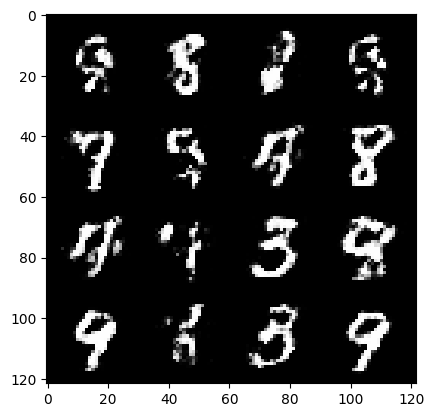

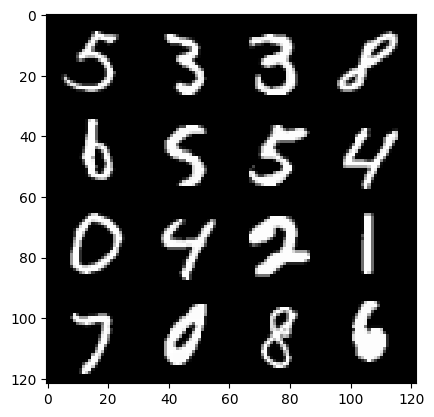

193: step 90600 / Gen loss 2.072890714804332 / Disc loss 0.31999424437681806


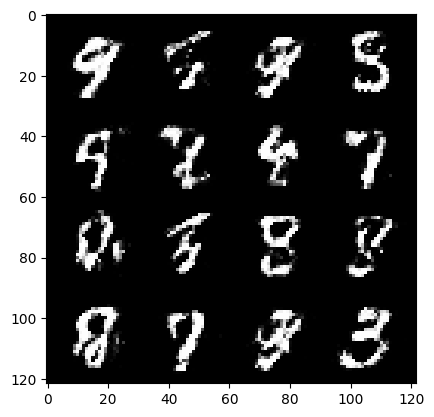

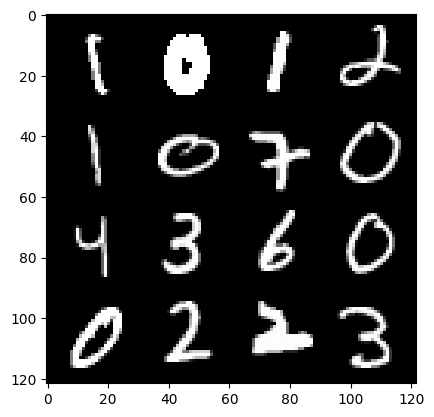

193: step 90900 / Gen loss 2.0066248691081996 / Disc loss 0.32603715956211077


  0%|          | 0/469 [00:00<?, ?it/s]

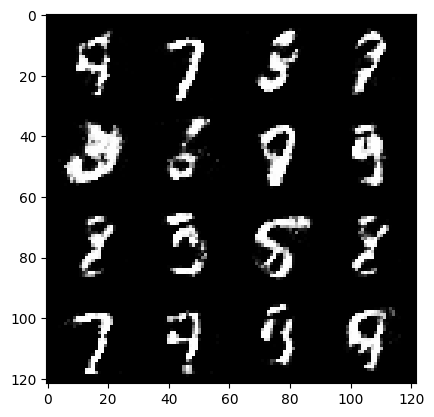

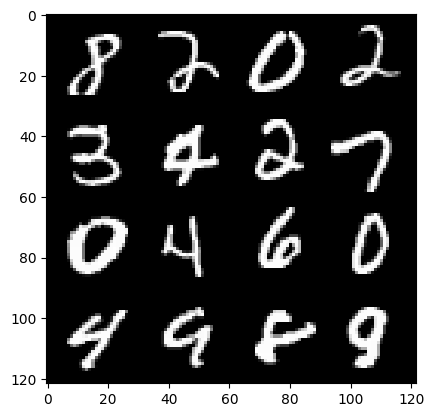

194: step 91200 / Gen loss 2.025310145616531 / Disc loss 0.3351991137862206


  0%|          | 0/469 [00:00<?, ?it/s]

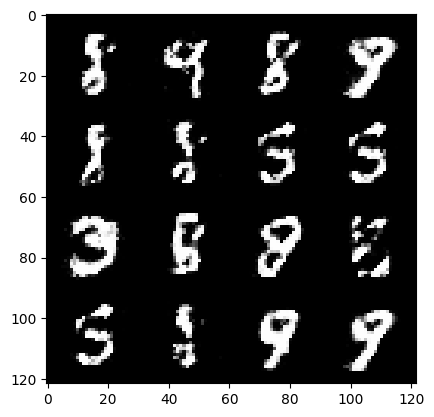

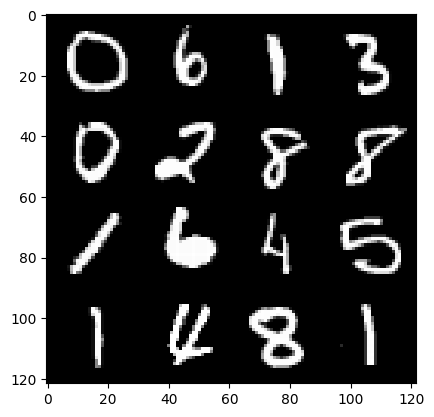

195: step 91500 / Gen loss 2.033056889375052 / Disc loss 0.3128408154348536


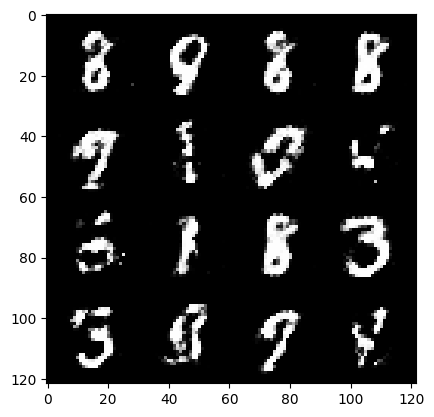

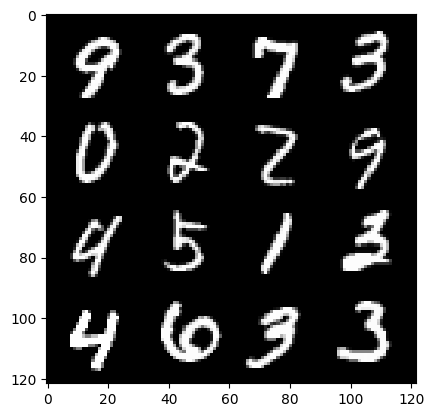

195: step 91800 / Gen loss 2.093716975053154 / Disc loss 0.32161995917558667


  0%|          | 0/469 [00:00<?, ?it/s]

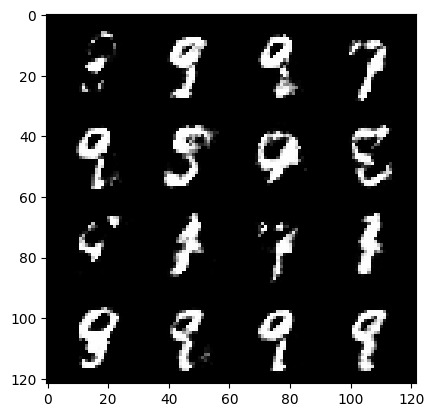

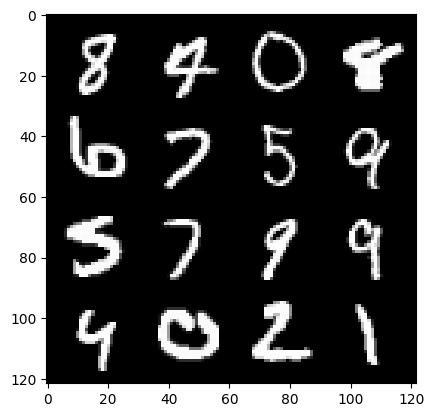

196: step 92100 / Gen loss 2.0898914563655846 / Disc loss 0.30992345884442335


  0%|          | 0/469 [00:00<?, ?it/s]

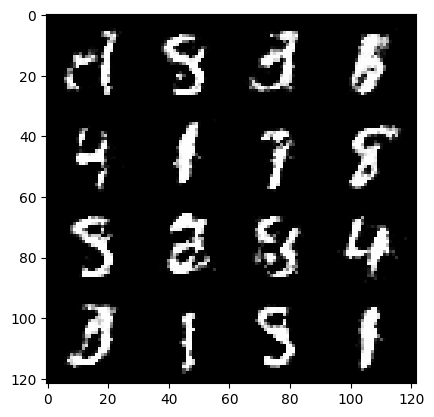

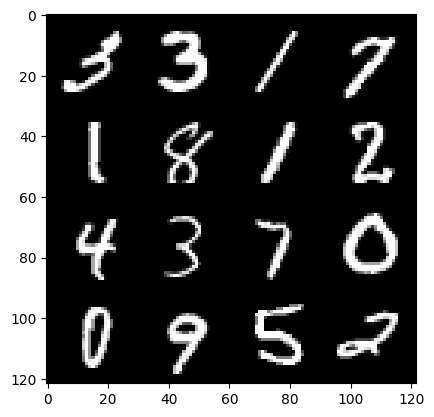

197: step 92400 / Gen loss 2.1549381581942226 / Disc loss 0.31179811879992486


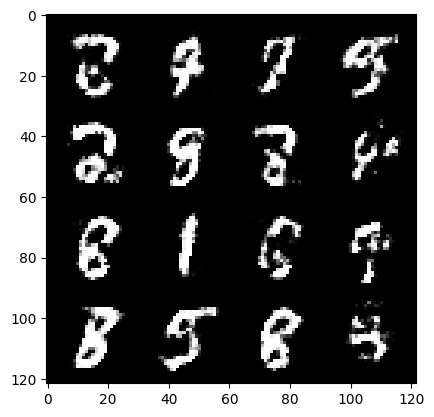

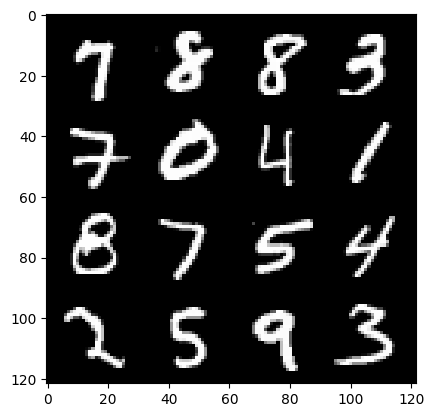

197: step 92700 / Gen loss 1.969579148689906 / Disc loss 0.3548503592113653


  0%|          | 0/469 [00:00<?, ?it/s]

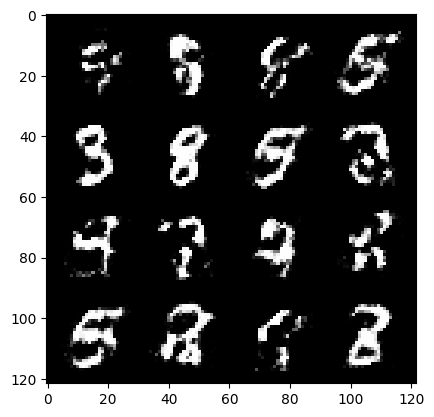

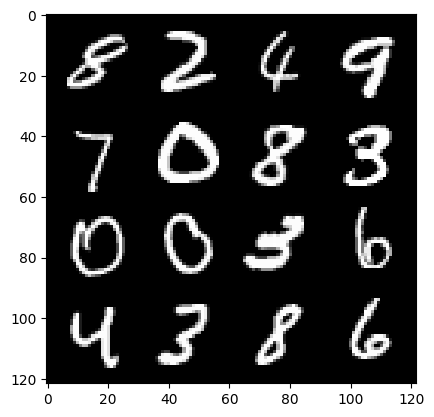

198: step 93000 / Gen loss 1.9676001199086517 / Disc loss 0.3377481151620548


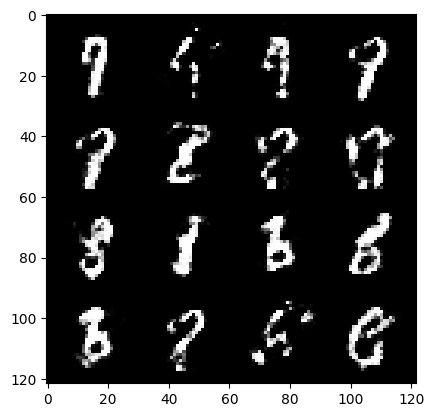

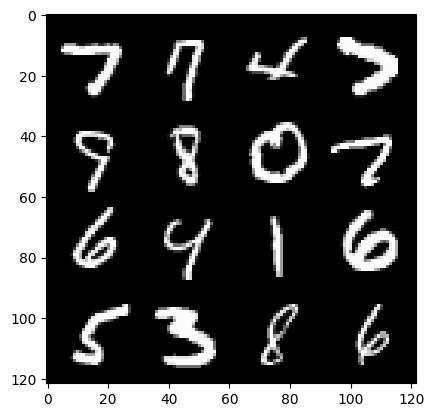

198: step 93300 / Gen loss 1.9407942374547325 / Disc loss 0.354132543305556


  0%|          | 0/469 [00:00<?, ?it/s]

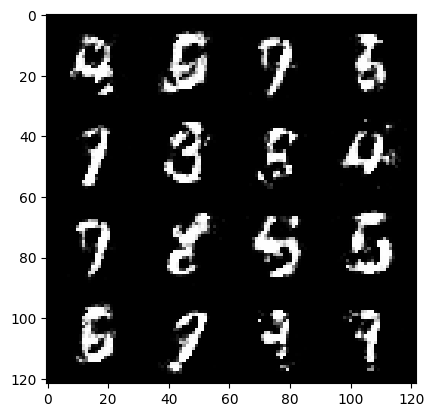

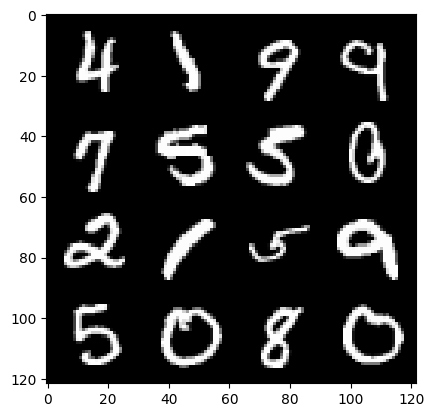

199: step 93600 / Gen loss 2.0078947889804826 / Disc loss 0.33158876225352285


  0%|          | 0/469 [00:00<?, ?it/s]

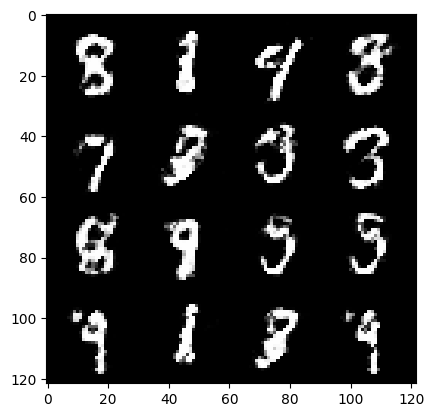

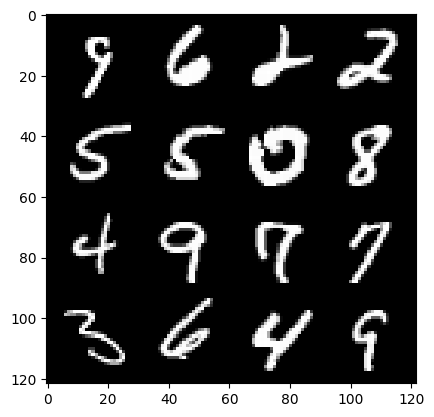

200: step 93900 / Gen loss 1.9874731437365212 / Disc loss 0.34005099862813976


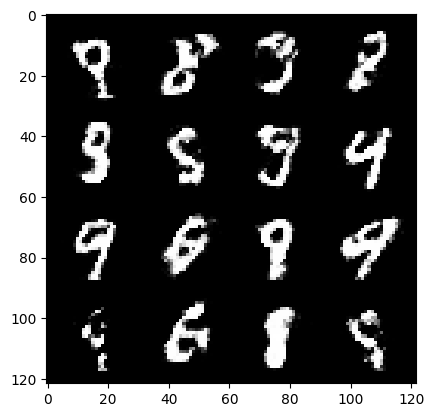

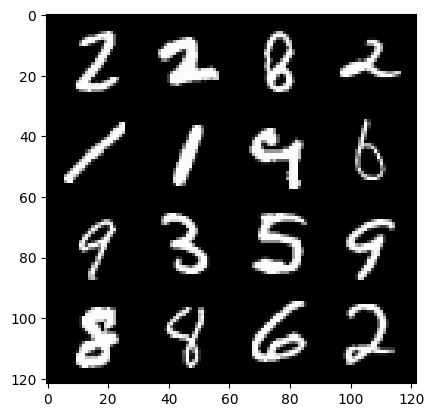

200: step 94200 / Gen loss 1.9886739667256679 / Disc loss 0.35466249242424985


  0%|          | 0/469 [00:00<?, ?it/s]

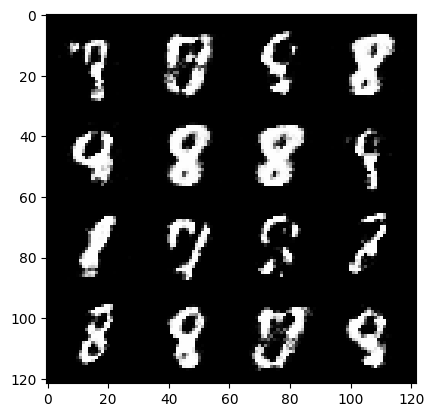

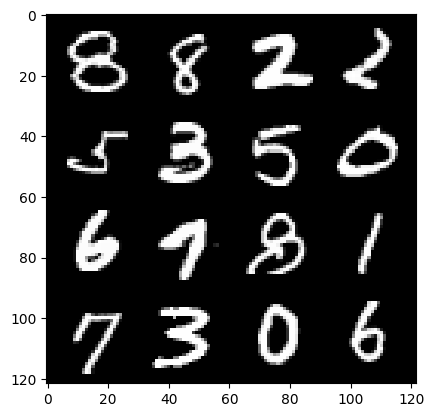

201: step 94500 / Gen loss 1.8926302369435626 / Disc loss 0.3721459600826106


  0%|          | 0/469 [00:00<?, ?it/s]

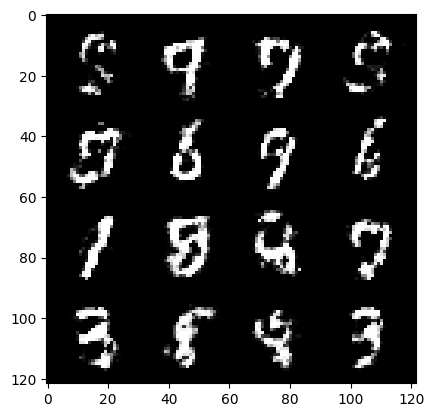

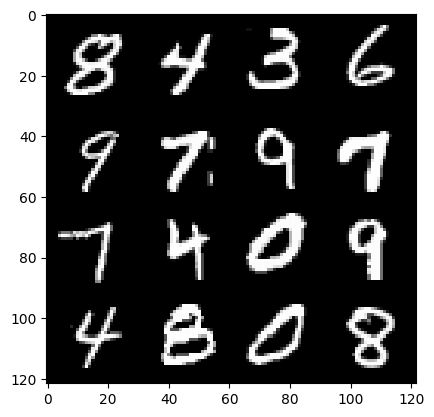

202: step 94800 / Gen loss 1.9136051424344378 / Disc loss 0.35033909320831264


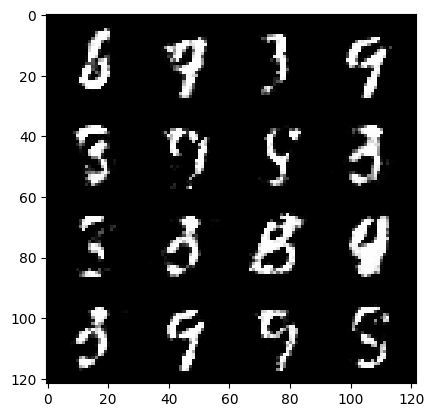

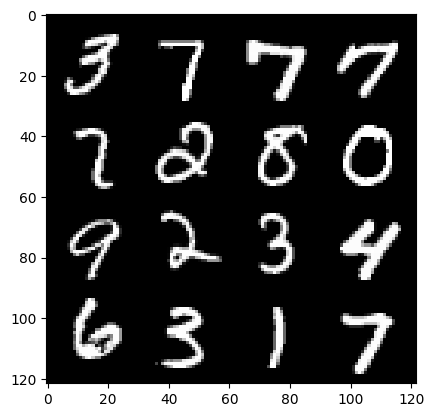

202: step 95100 / Gen loss 2.0034078756968174 / Disc loss 0.3111394240458808


  0%|          | 0/469 [00:00<?, ?it/s]

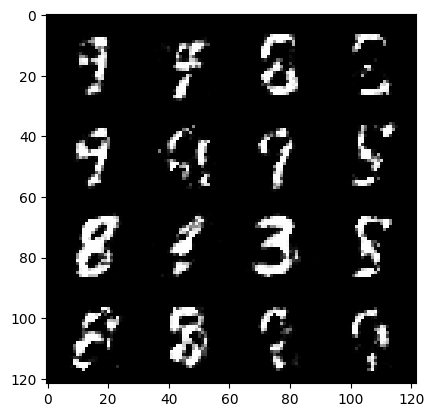

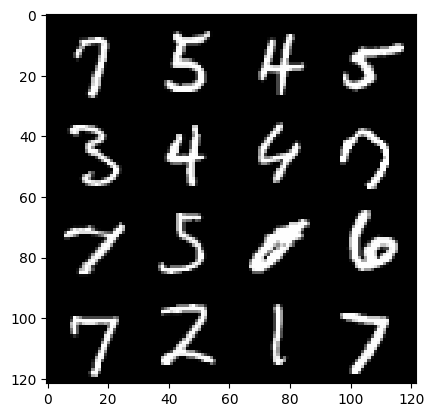

203: step 95400 / Gen loss 2.0160217356681804 / Disc loss 0.3338999575873217


  0%|          | 0/469 [00:00<?, ?it/s]

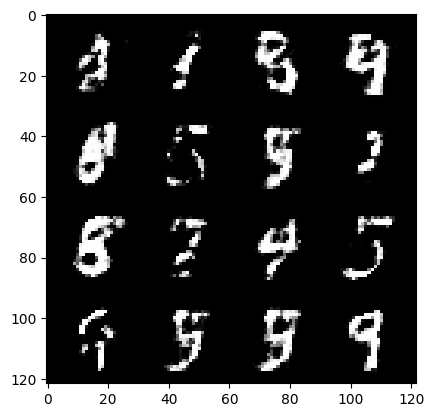

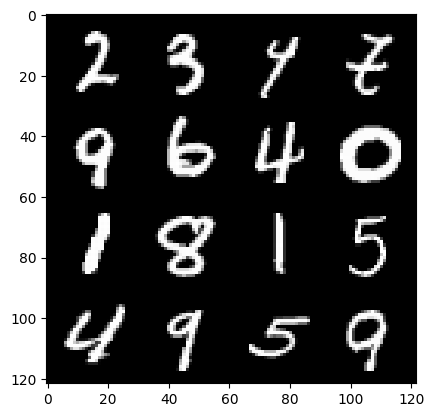

204: step 95700 / Gen loss 2.0049441512425736 / Disc loss 0.33614691431323707


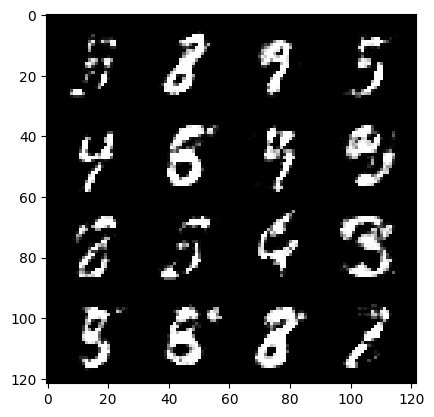

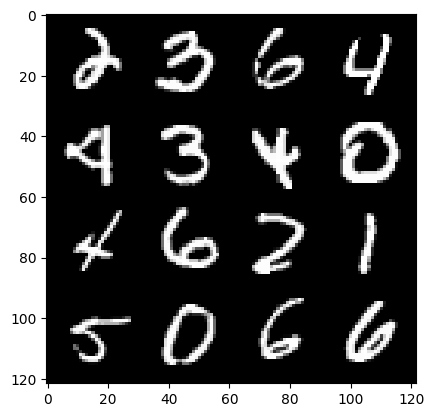

204: step 96000 / Gen loss 1.9216694378852845 / Disc loss 0.3530637371043367


  0%|          | 0/469 [00:00<?, ?it/s]

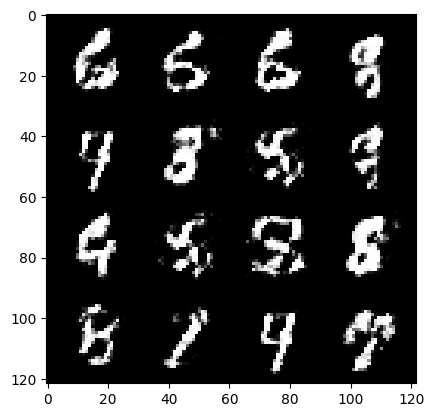

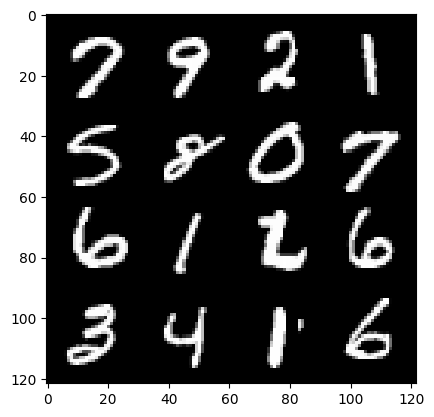

205: step 96300 / Gen loss 1.9746443251768726 / Disc loss 0.3382925982773305


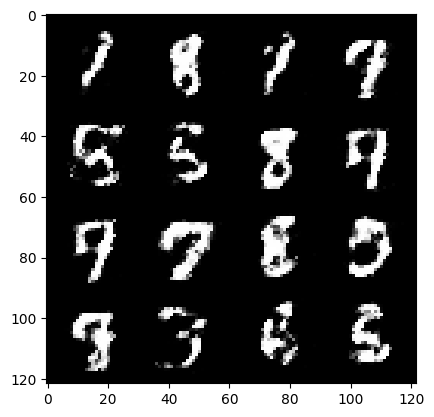

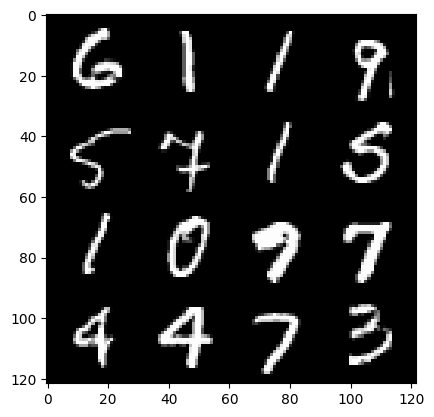

205: step 96600 / Gen loss 1.9083972454071036 / Disc loss 0.36508912036816304


  0%|          | 0/469 [00:00<?, ?it/s]

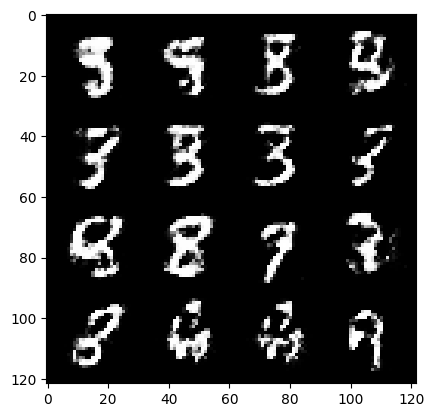

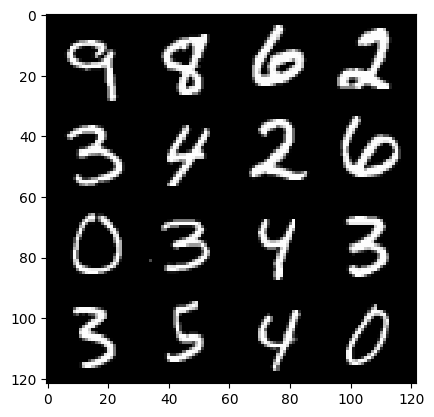

206: step 96900 / Gen loss 1.81825321952502 / Disc loss 0.38688474118709565


  0%|          | 0/469 [00:00<?, ?it/s]

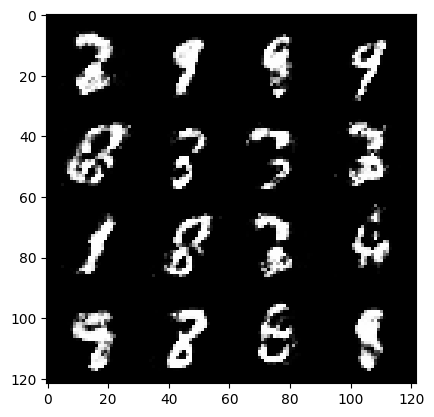

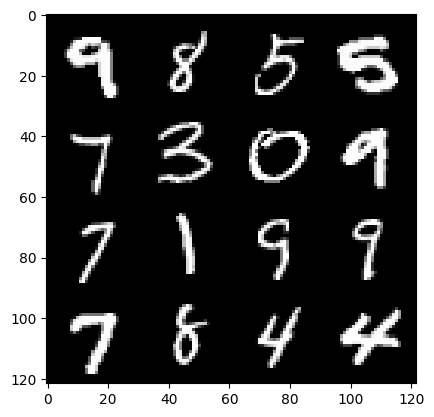

207: step 97200 / Gen loss 1.8603130344549819 / Disc loss 0.37048026353120816


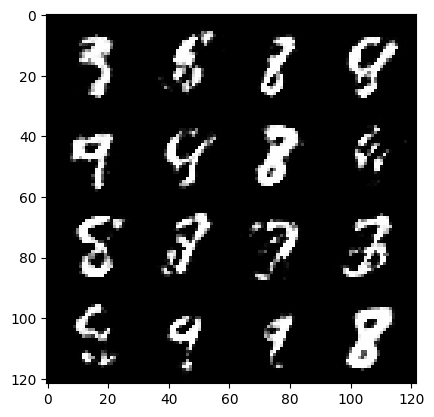

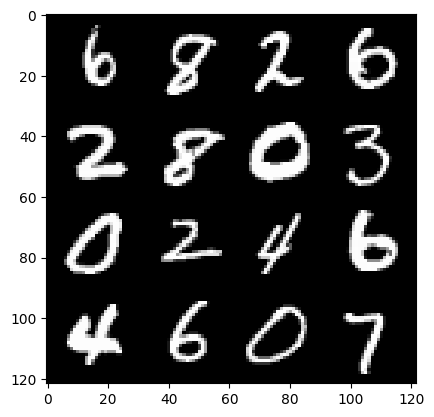

207: step 97500 / Gen loss 1.8924419637521115 / Disc loss 0.3457542981704073


  0%|          | 0/469 [00:00<?, ?it/s]

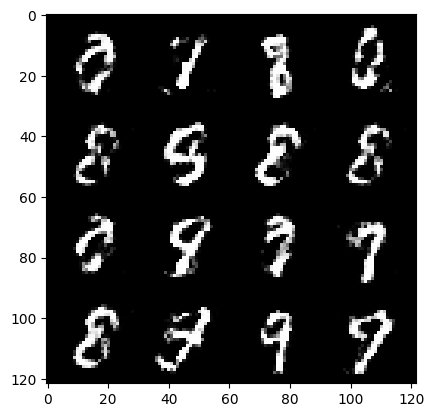

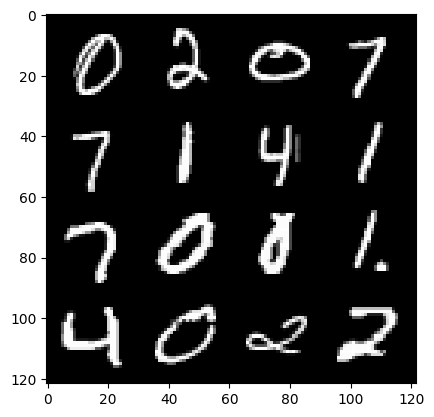

208: step 97800 / Gen loss 1.923943547010421 / Disc loss 0.3450762278338271


  0%|          | 0/469 [00:00<?, ?it/s]

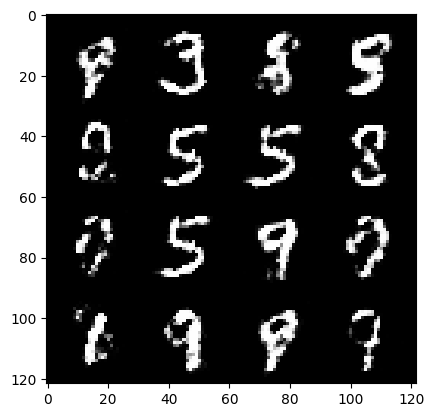

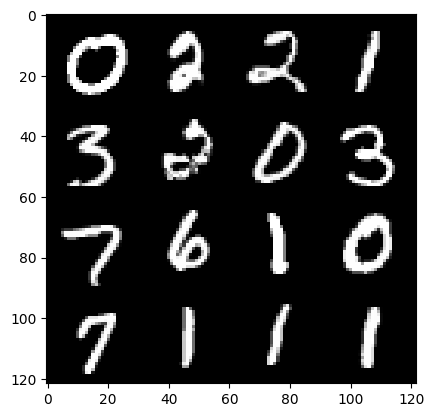

209: step 98100 / Gen loss 1.8560311893622075 / Disc loss 0.3792817702889444


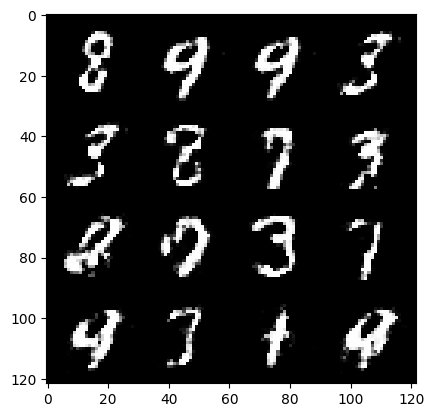

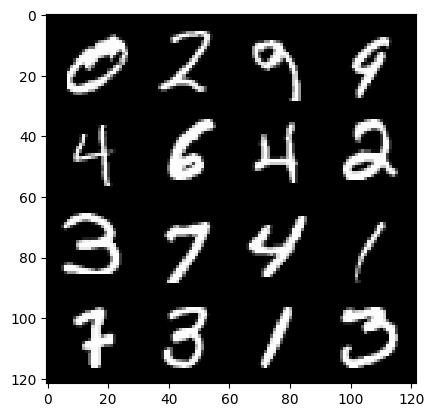

209: step 98400 / Gen loss 1.8754249056180323 / Disc loss 0.3609917280077932


  0%|          | 0/469 [00:00<?, ?it/s]

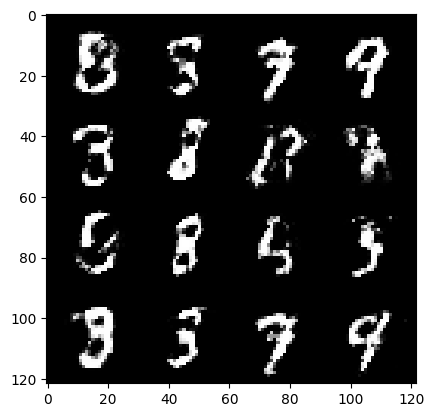

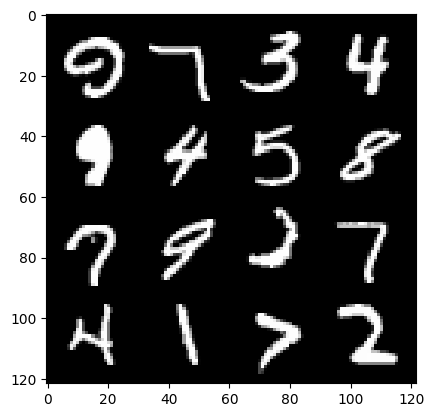

210: step 98700 / Gen loss 1.8597897573312114 / Disc loss 0.37068576102455464


  0%|          | 0/469 [00:00<?, ?it/s]

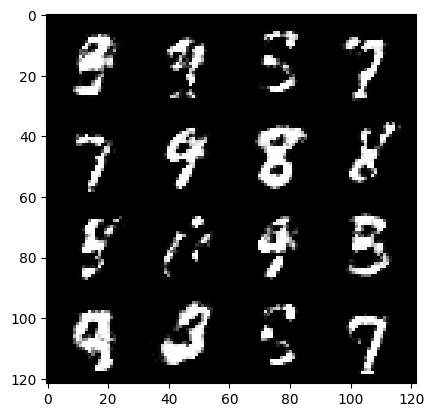

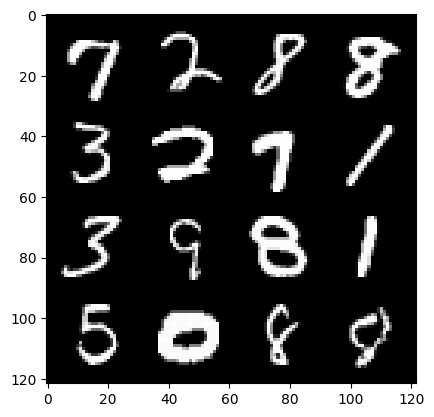

211: step 99000 / Gen loss 1.774424932400386 / Disc loss 0.3882588706413903


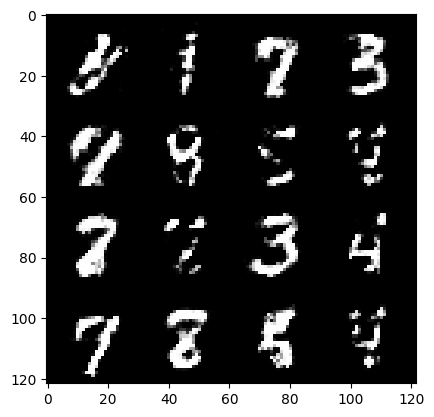

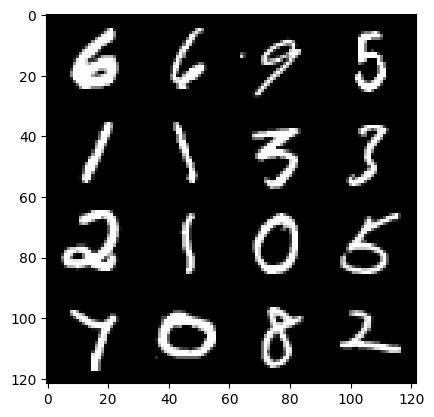

211: step 99300 / Gen loss 1.7709988307952877 / Disc loss 0.37675420324007675


  0%|          | 0/469 [00:00<?, ?it/s]

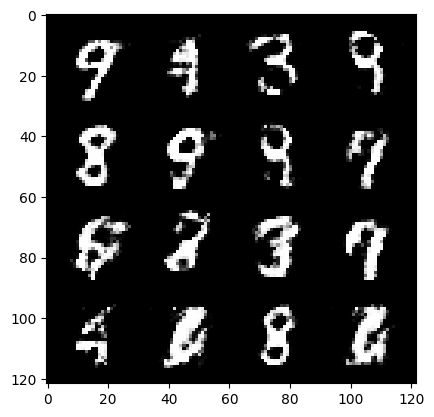

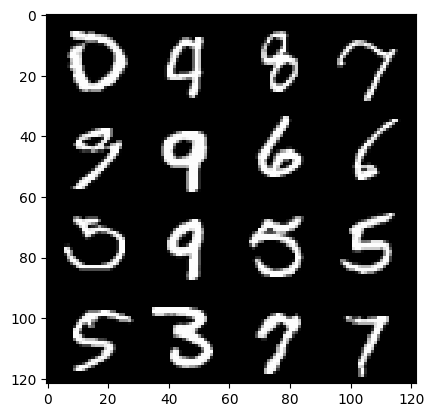

212: step 99600 / Gen loss 1.8971962551275867 / Disc loss 0.3421941443284353


  0%|          | 0/469 [00:00<?, ?it/s]

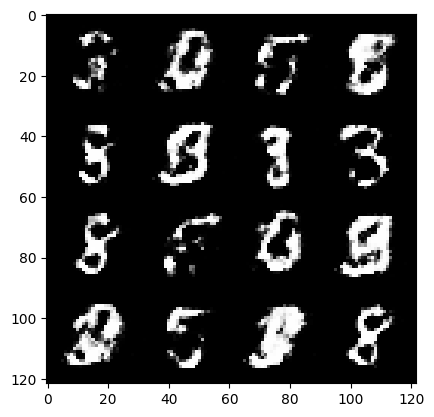

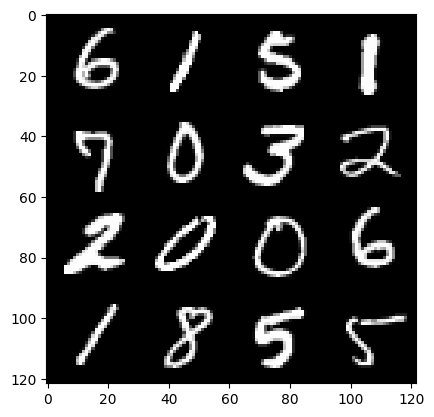

213: step 99900 / Gen loss 1.8250915213425967 / Disc loss 0.3803211422761281


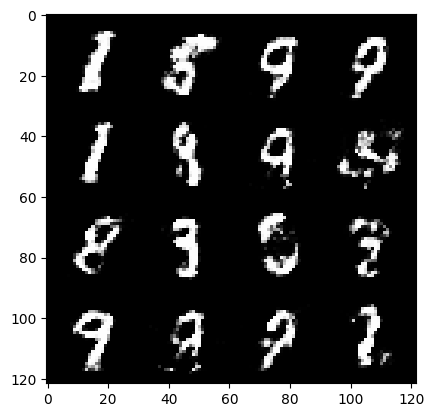

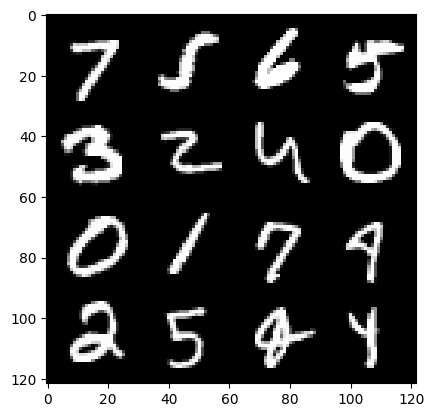

213: step 100200 / Gen loss 1.808340952396392 / Disc loss 0.3681469022234282


  0%|          | 0/469 [00:00<?, ?it/s]

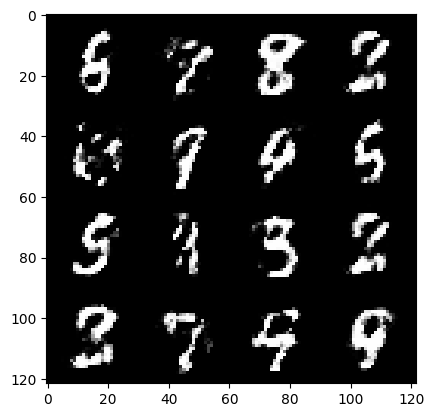

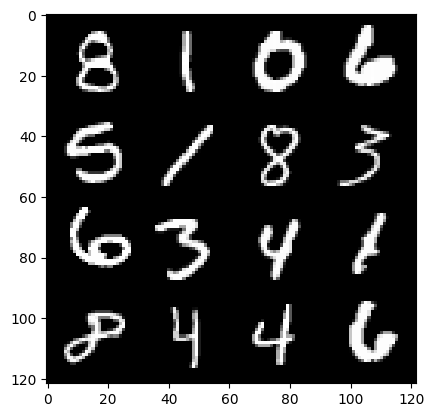

214: step 100500 / Gen loss 1.8631912680466969 / Disc loss 0.35962589005629236


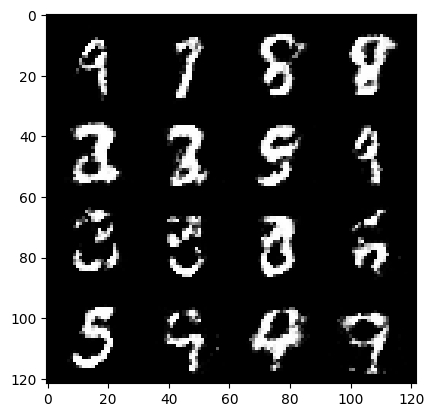

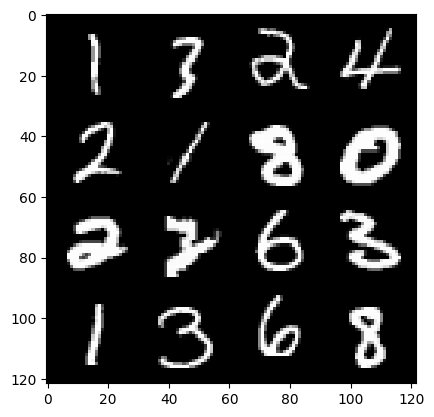

214: step 100800 / Gen loss 1.843379803498586 / Disc loss 0.3713134416937827


  0%|          | 0/469 [00:00<?, ?it/s]

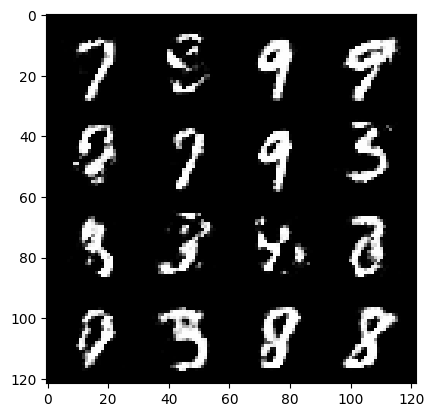

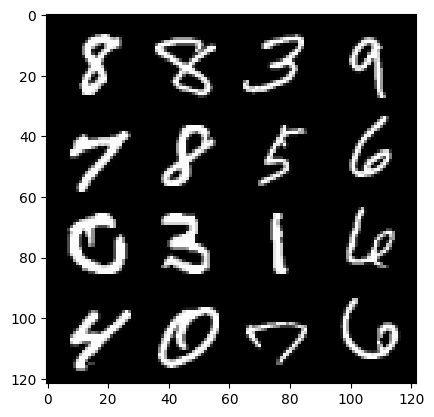

215: step 101100 / Gen loss 1.798440086444218 / Disc loss 0.392052405973275


  0%|          | 0/469 [00:00<?, ?it/s]

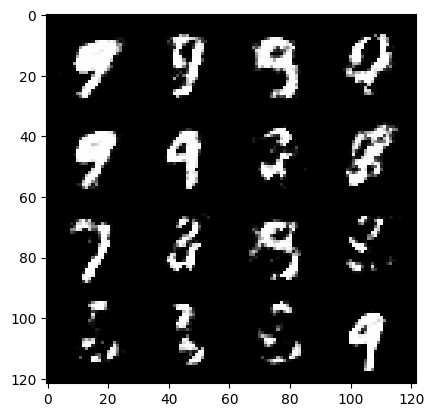

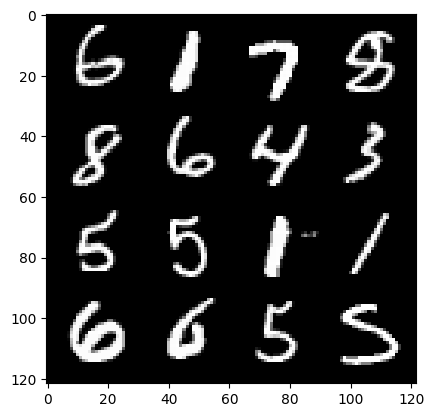

216: step 101400 / Gen loss 1.74168099999428 / Disc loss 0.3915770891308784


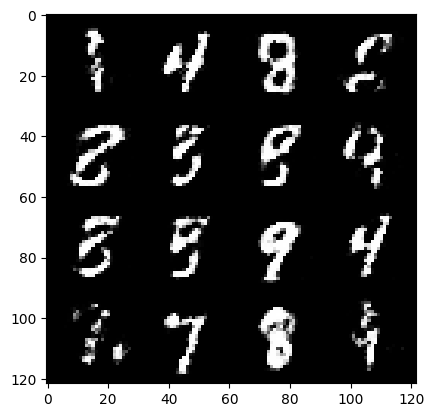

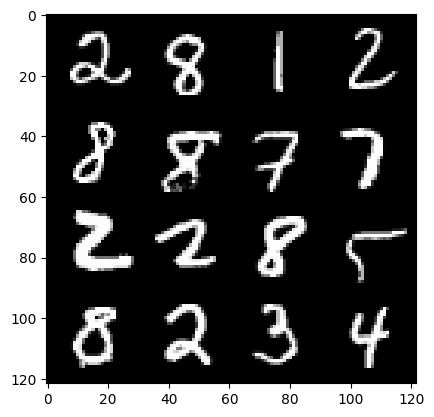

216: step 101700 / Gen loss 1.7067016045252468 / Disc loss 0.3951525932550429


  0%|          | 0/469 [00:00<?, ?it/s]

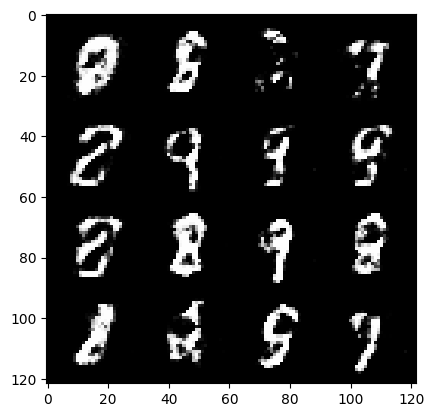

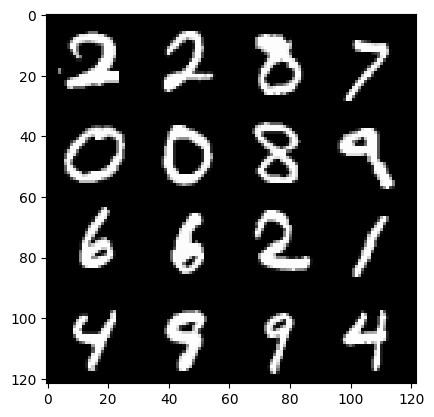

217: step 102000 / Gen loss 1.8351022557417551 / Disc loss 0.35584941188494357


  0%|          | 0/469 [00:00<?, ?it/s]

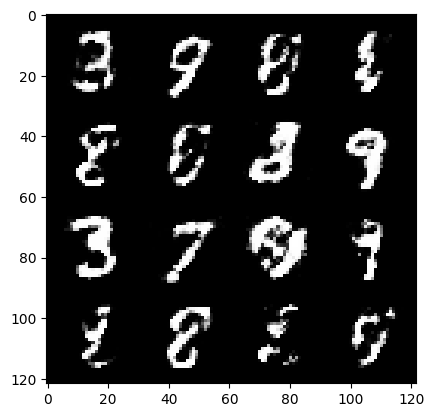

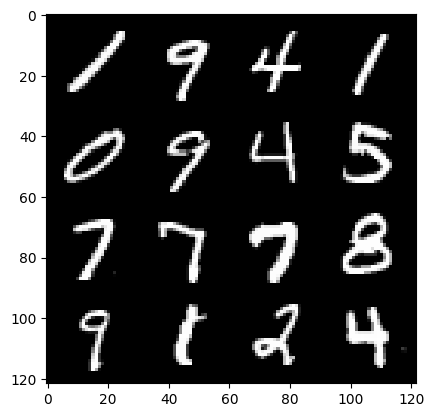

218: step 102300 / Gen loss 1.7994563821951555 / Disc loss 0.36863303979237894


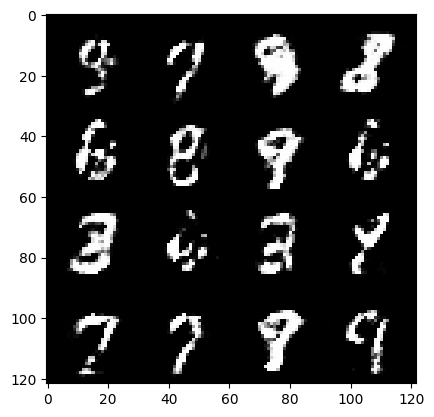

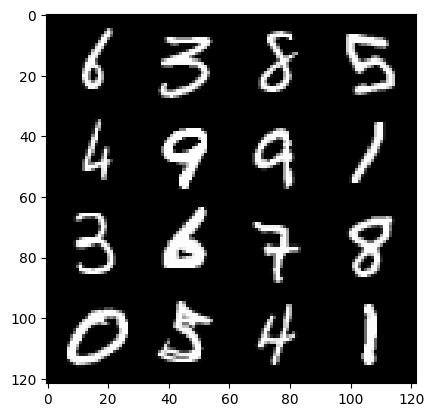

218: step 102600 / Gen loss 1.8167143603165947 / Disc loss 0.3470124090711275


  0%|          | 0/469 [00:00<?, ?it/s]

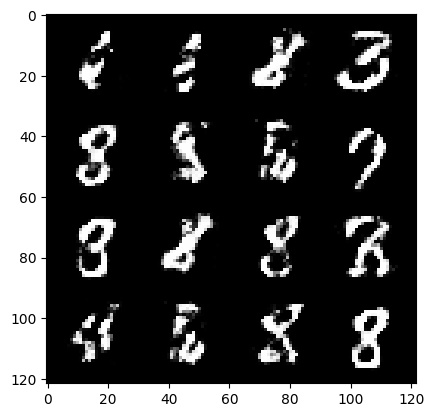

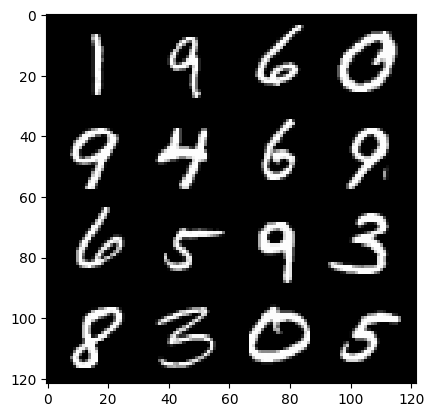

219: step 102900 / Gen loss 1.7583635449409483 / Disc loss 0.36466121822595593


  0%|          | 0/469 [00:00<?, ?it/s]

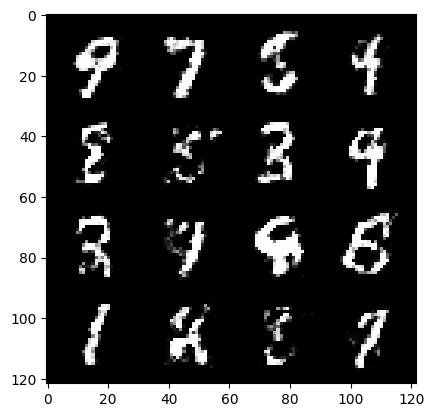

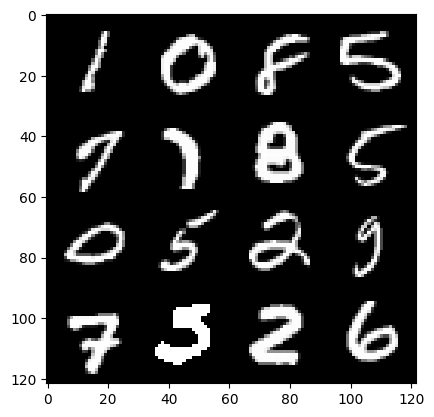

220: step 103200 / Gen loss 1.8286949590841928 / Disc loss 0.3684366278847056


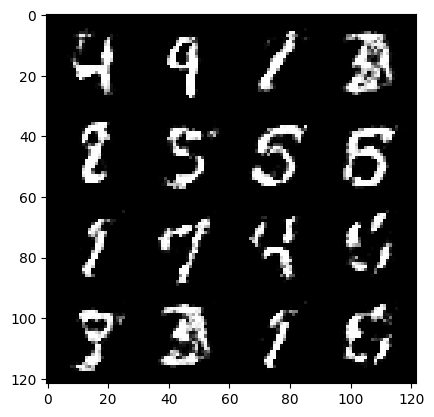

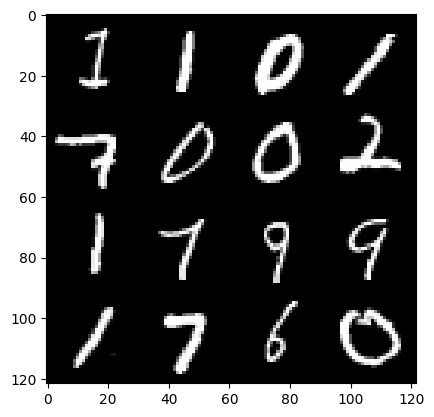

220: step 103500 / Gen loss 1.7080726210276291 / Disc loss 0.3909266612927114


  0%|          | 0/469 [00:00<?, ?it/s]

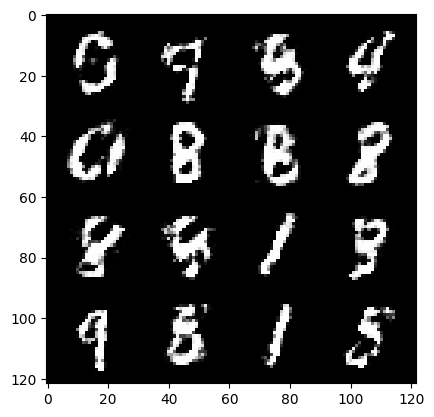

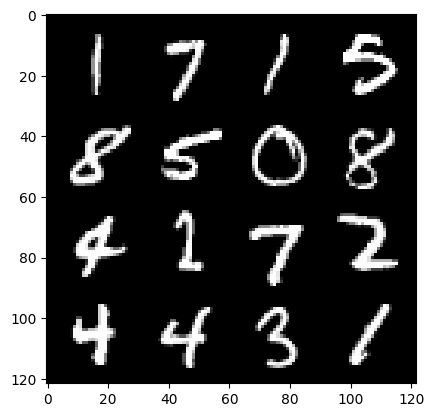

221: step 103800 / Gen loss 1.708836824893952 / Disc loss 0.39279154380162584


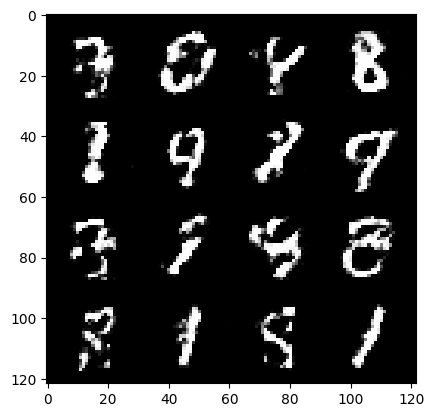

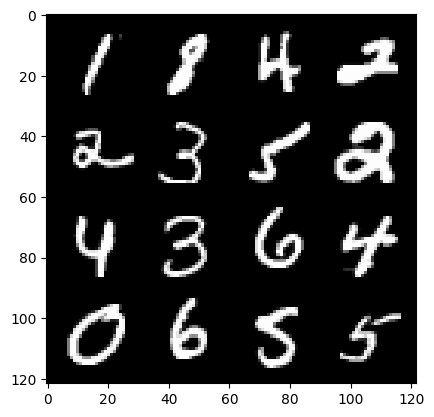

221: step 104100 / Gen loss 1.7755766900380456 / Disc loss 0.3689004899064702


  0%|          | 0/469 [00:00<?, ?it/s]

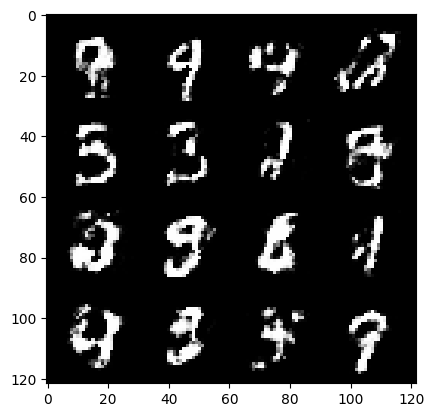

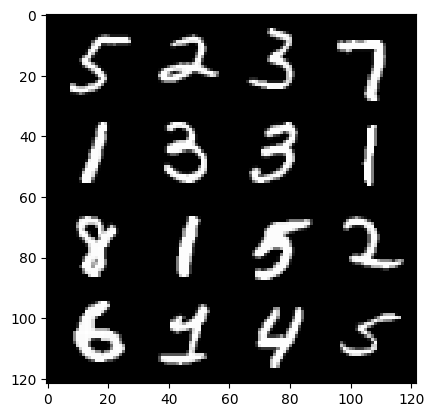

222: step 104400 / Gen loss 1.762884312073388 / Disc loss 0.3721422826250392


  0%|          | 0/469 [00:00<?, ?it/s]

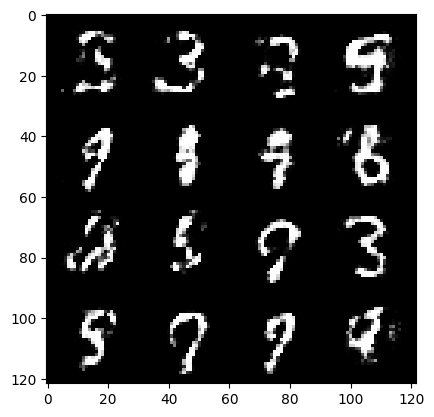

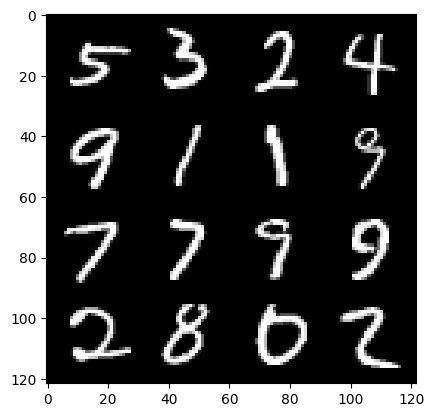

223: step 104700 / Gen loss 1.6696119141578671 / Disc loss 0.40639445265134183


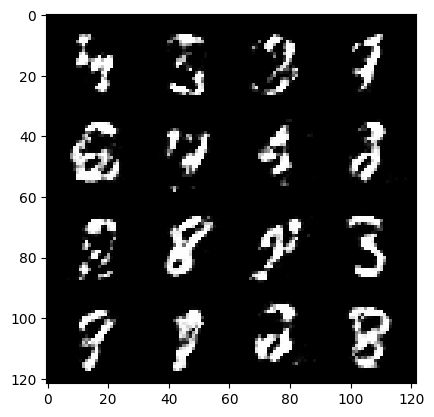

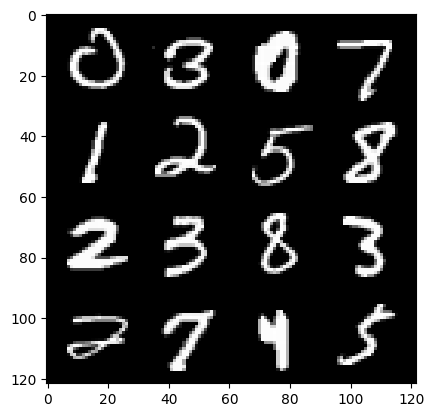

223: step 105000 / Gen loss 1.7319198413689934 / Disc loss 0.3887133451302845


  0%|          | 0/469 [00:00<?, ?it/s]

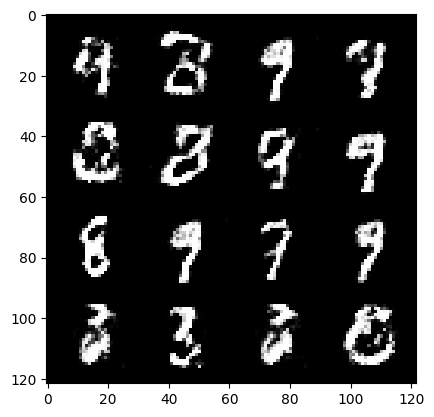

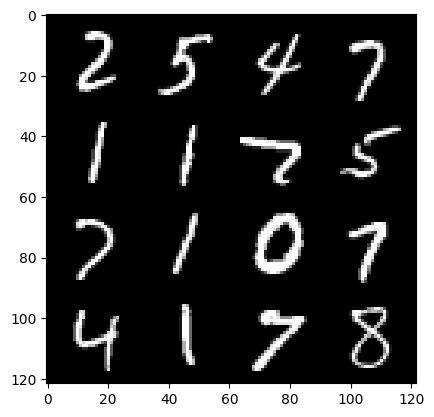

224: step 105300 / Gen loss 1.779190684159596 / Disc loss 0.3732722631096839


  0%|          | 0/469 [00:00<?, ?it/s]

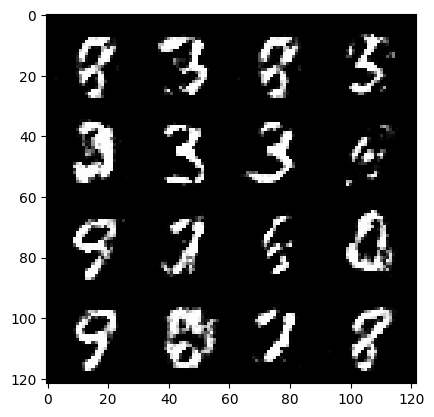

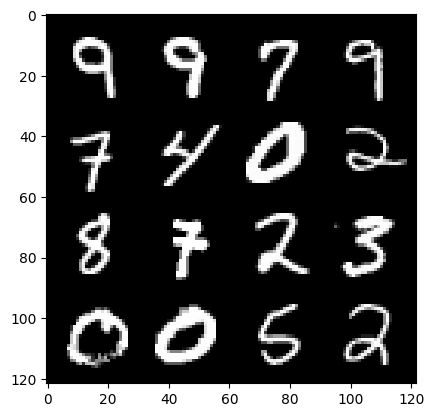

225: step 105600 / Gen loss 1.7054782005151095 / Disc loss 0.3946049984296161


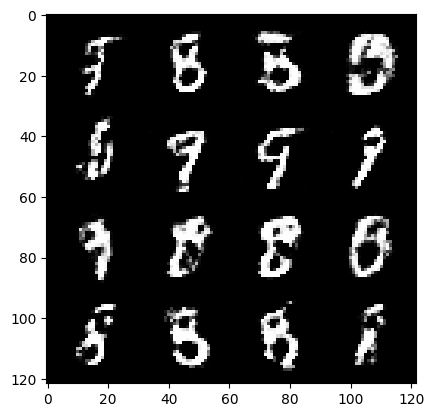

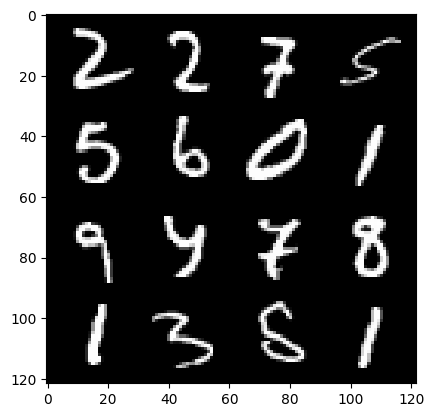

225: step 105900 / Gen loss 1.690766857862473 / Disc loss 0.3865859590967496


  0%|          | 0/469 [00:00<?, ?it/s]

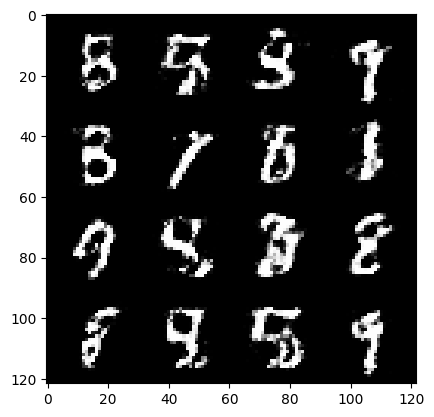

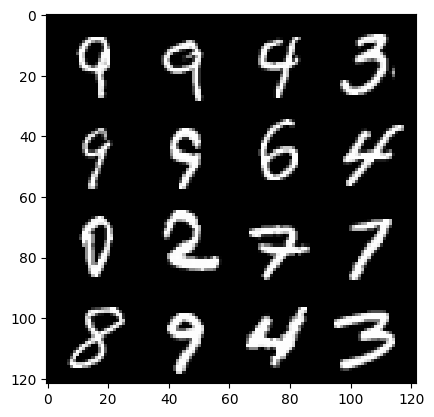

226: step 106200 / Gen loss 1.8251745649178819 / Disc loss 0.3436387505133945


  0%|          | 0/469 [00:00<?, ?it/s]

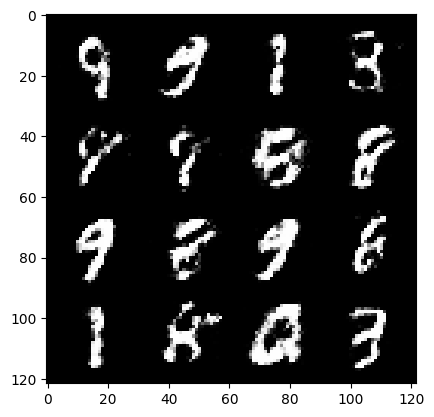

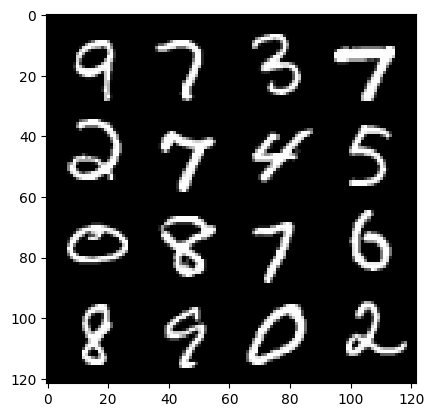

227: step 106500 / Gen loss 1.778233454624813 / Disc loss 0.37674386650323866


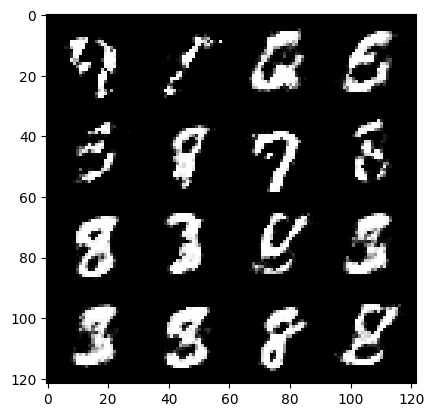

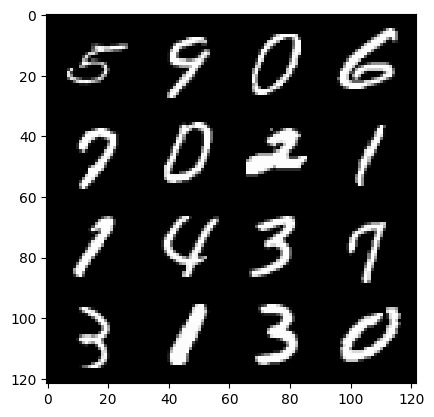

227: step 106800 / Gen loss 1.7556997783978798 / Disc loss 0.3735760246713956


  0%|          | 0/469 [00:00<?, ?it/s]

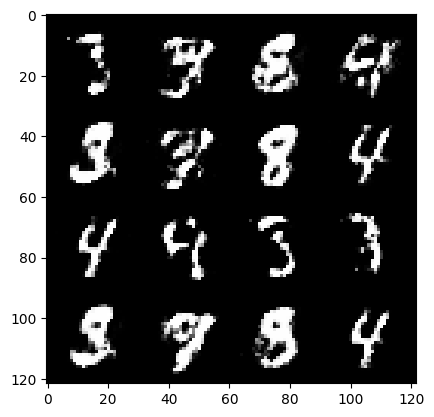

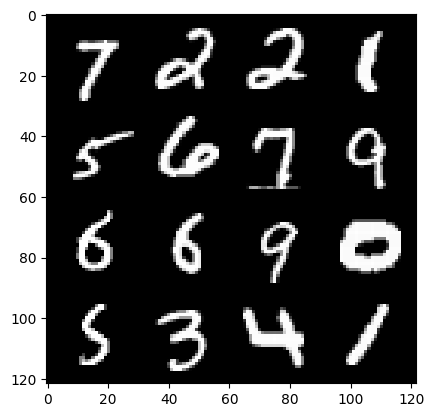

228: step 107100 / Gen loss 1.8044926393032081 / Disc loss 0.365728532075882


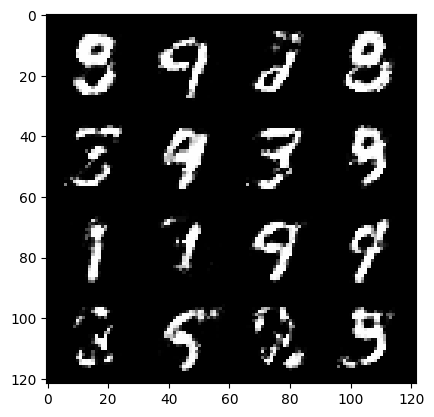

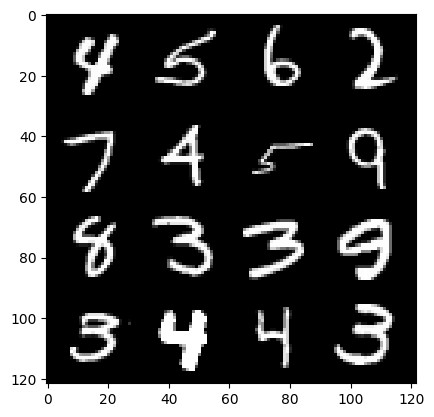

228: step 107400 / Gen loss 1.8371734674771625 / Disc loss 0.3521416160464289


  0%|          | 0/469 [00:00<?, ?it/s]

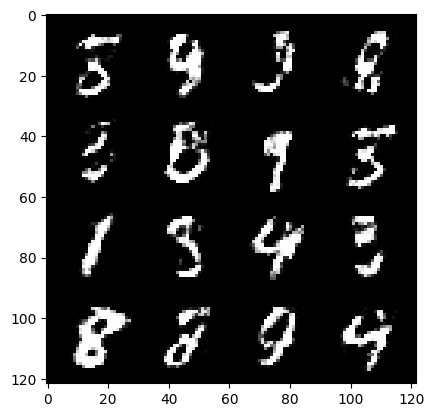

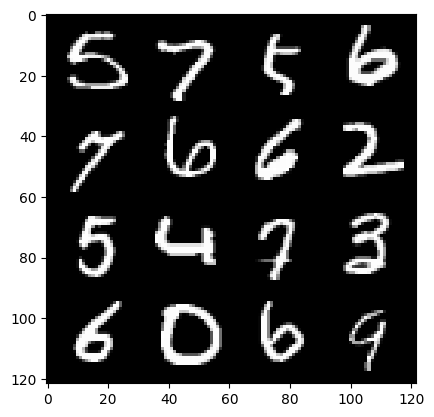

229: step 107700 / Gen loss 1.776648637453714 / Disc loss 0.3763253056009608


  0%|          | 0/469 [00:00<?, ?it/s]

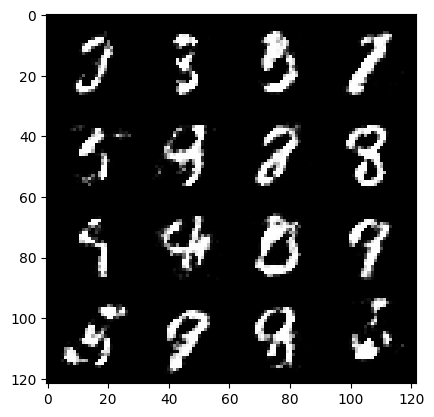

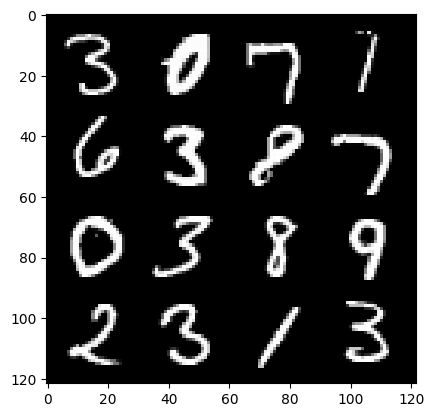

230: step 108000 / Gen loss 1.729011770884196 / Disc loss 0.39205182462930666


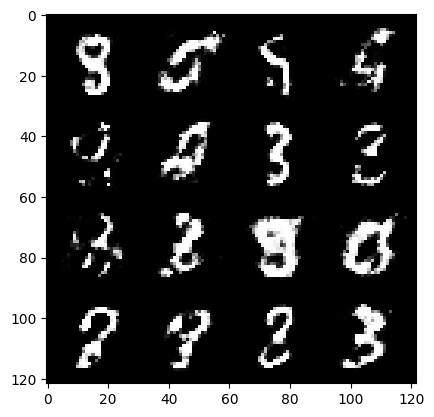

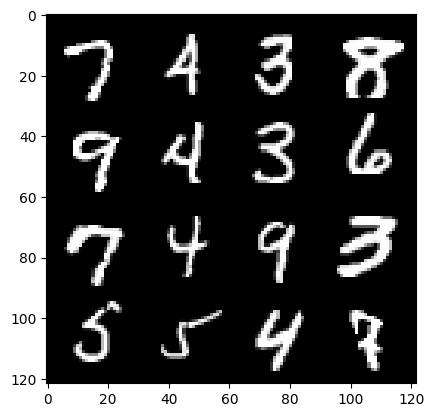

230: step 108300 / Gen loss 1.7864886717001596 / Disc loss 0.3685790686806042


  0%|          | 0/469 [00:00<?, ?it/s]

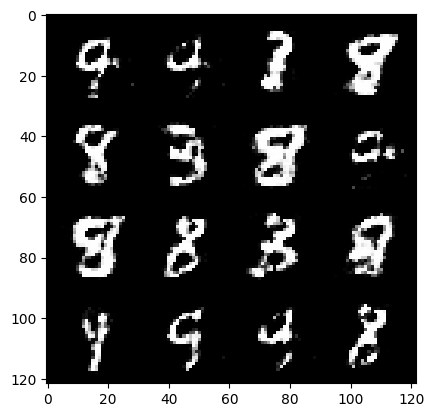

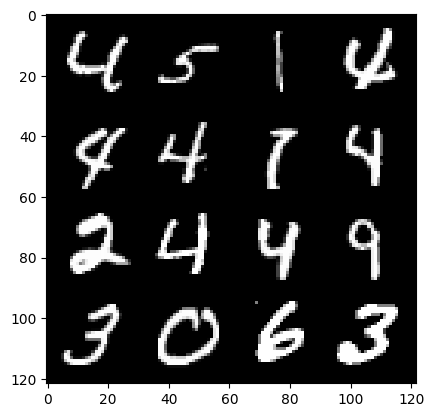

231: step 108600 / Gen loss 1.7974649520715082 / Disc loss 0.3570466658473016


  0%|          | 0/469 [00:00<?, ?it/s]

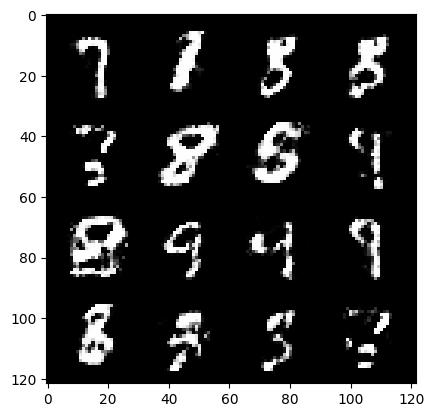

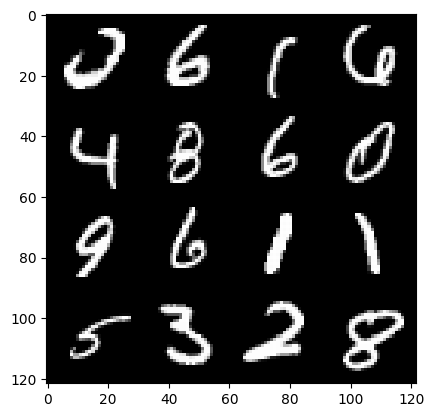

232: step 108900 / Gen loss 1.7521915153662364 / Disc loss 0.37740372508764247


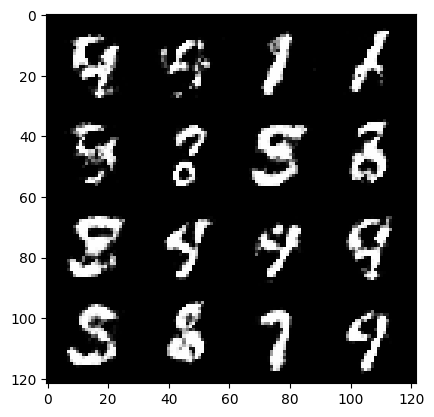

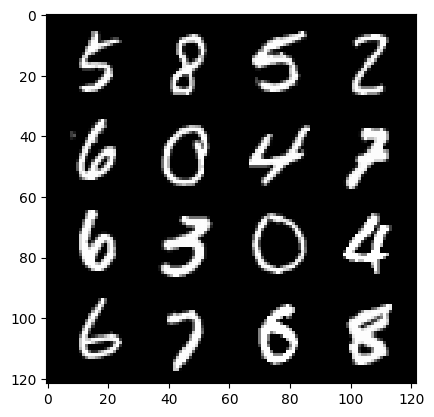

232: step 109200 / Gen loss 1.796480874220529 / Disc loss 0.3615871177117031


  0%|          | 0/469 [00:00<?, ?it/s]

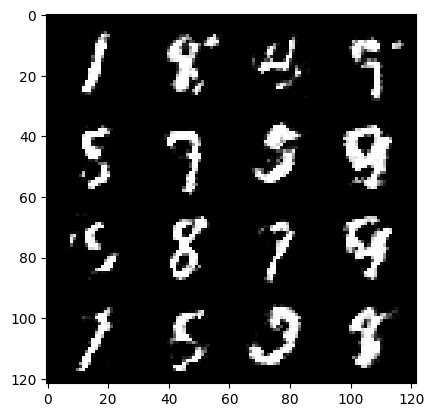

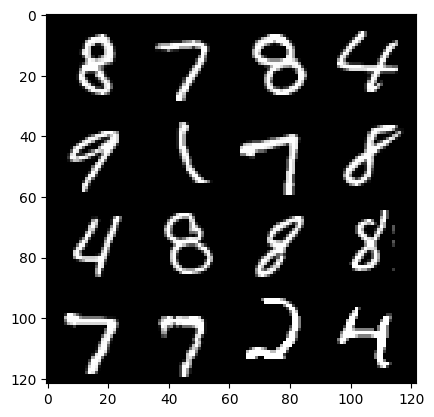

233: step 109500 / Gen loss 1.8548641475041705 / Disc loss 0.3516345473130543


  0%|          | 0/469 [00:00<?, ?it/s]

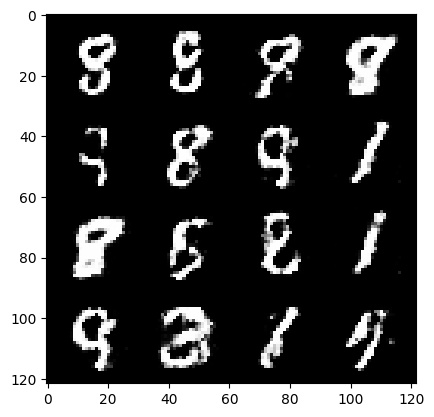

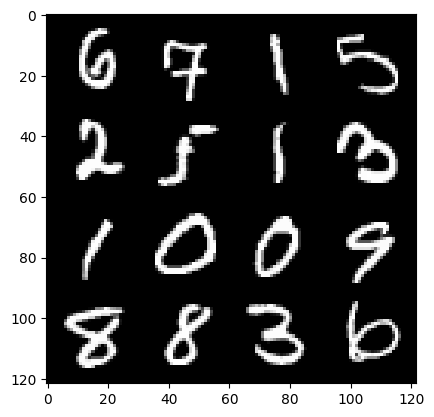

234: step 109800 / Gen loss 1.7534448389212285 / Disc loss 0.37581695804993315


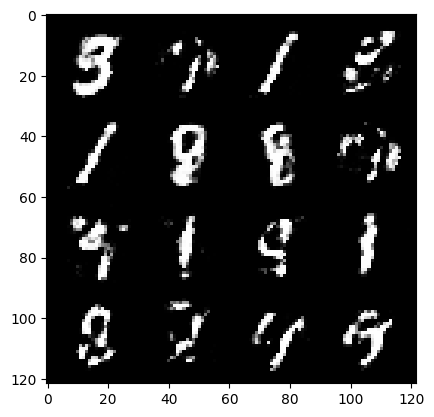

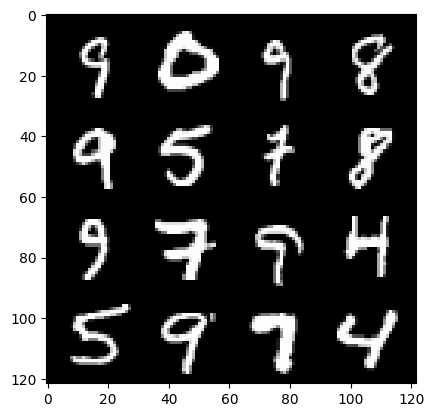

234: step 110100 / Gen loss 1.6911826586723322 / Disc loss 0.3819627968470254


  0%|          | 0/469 [00:00<?, ?it/s]

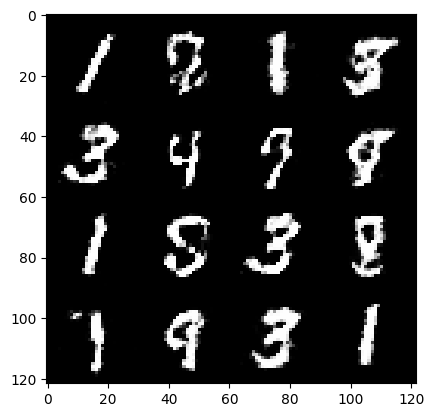

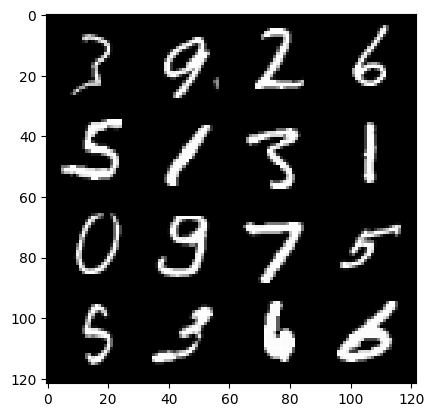

235: step 110400 / Gen loss 1.7143968431154888 / Disc loss 0.391341075102488


  0%|          | 0/469 [00:00<?, ?it/s]

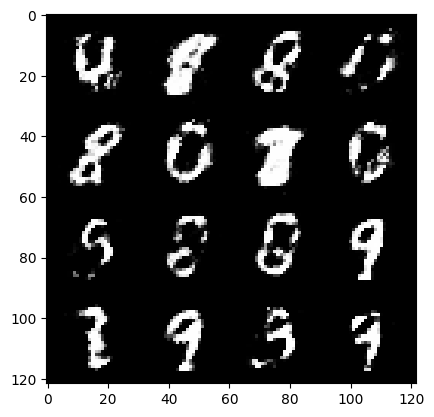

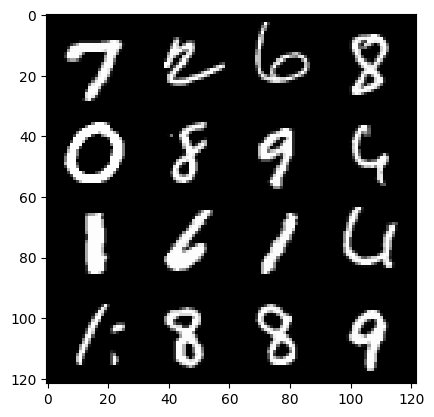

236: step 110700 / Gen loss 1.687507485946021 / Disc loss 0.39959510048230484


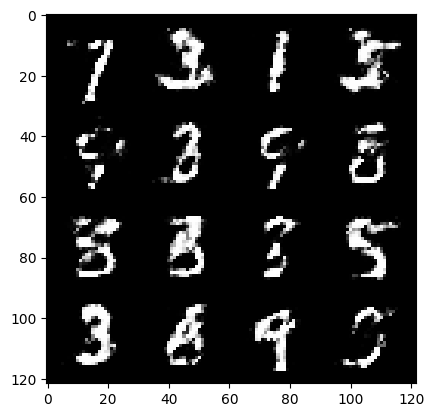

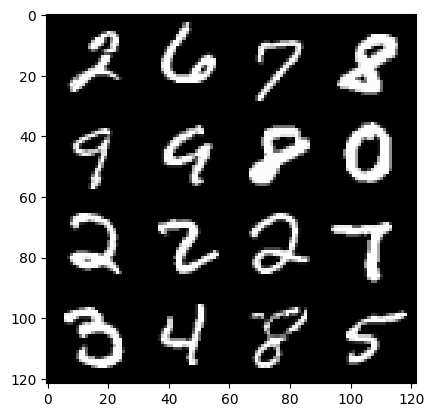

236: step 111000 / Gen loss 1.7372948976357783 / Disc loss 0.37770485540231036


  0%|          | 0/469 [00:00<?, ?it/s]

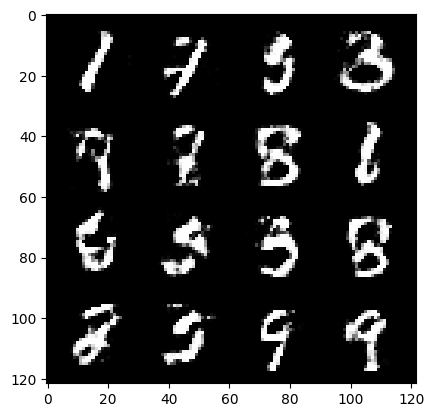

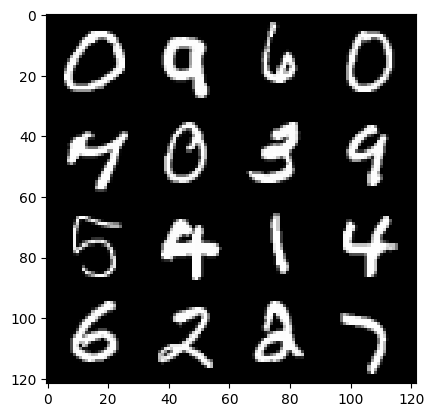

237: step 111300 / Gen loss 1.7227506661415106 / Disc loss 0.38173214783271164


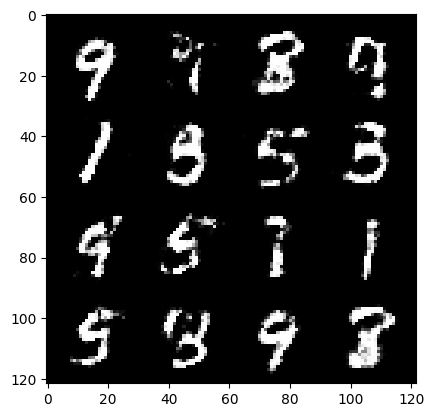

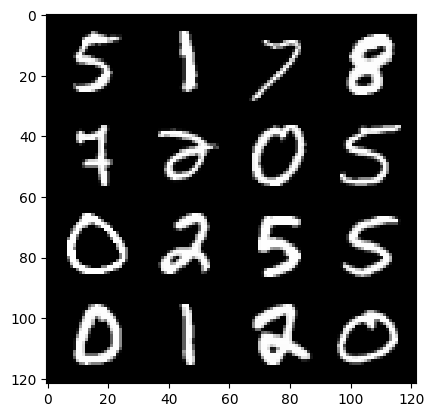

237: step 111600 / Gen loss 1.7603028662999471 / Disc loss 0.3824358281493189


  0%|          | 0/469 [00:00<?, ?it/s]

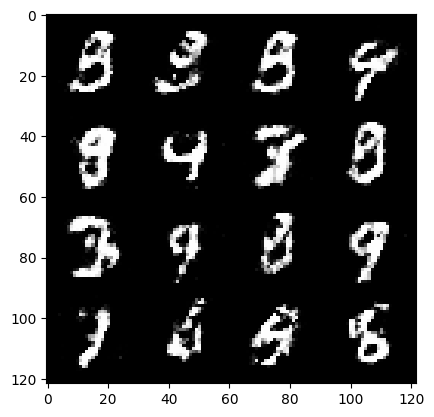

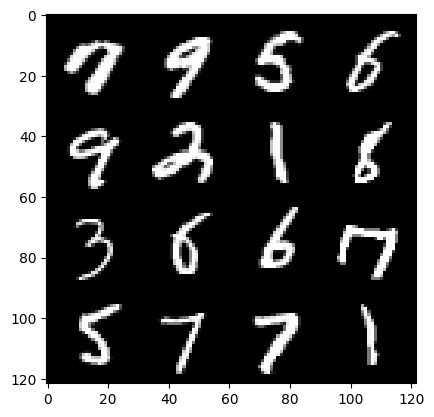

238: step 111900 / Gen loss 1.5753160436948141 / Disc loss 0.435170025428136


  0%|          | 0/469 [00:00<?, ?it/s]

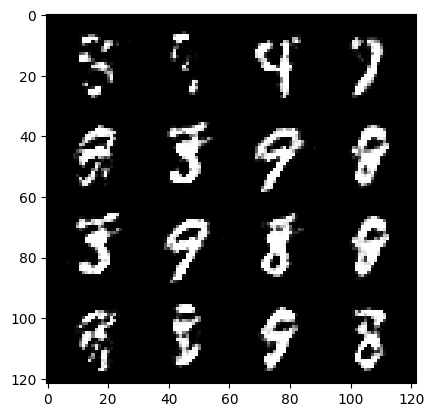

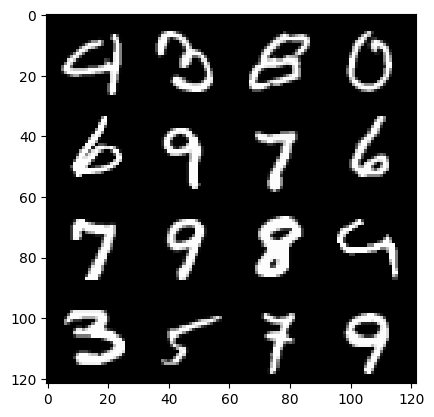

239: step 112200 / Gen loss 1.6248566536108655 / Disc loss 0.40682899455229443


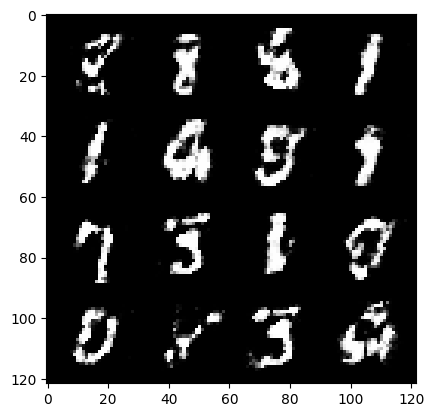

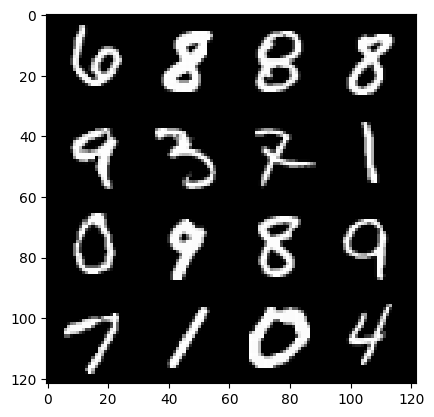

239: step 112500 / Gen loss 1.61083083907763 / Disc loss 0.4096974016229313


  0%|          | 0/469 [00:00<?, ?it/s]

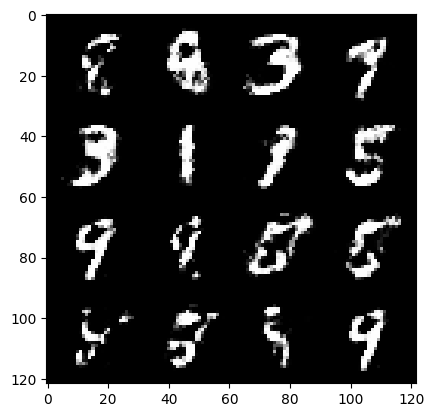

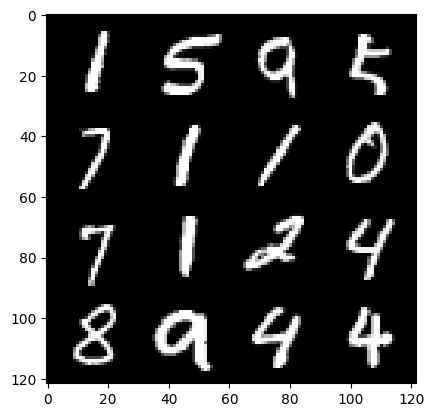

240: step 112800 / Gen loss 1.710009499788283 / Disc loss 0.37852186113595976


  0%|          | 0/469 [00:00<?, ?it/s]

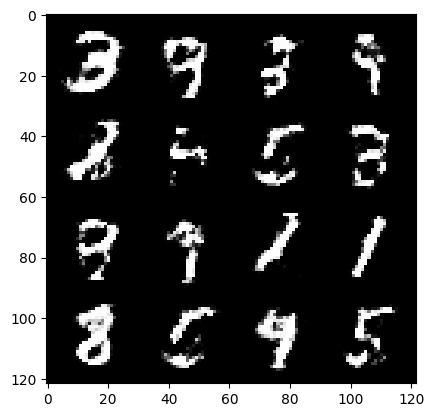

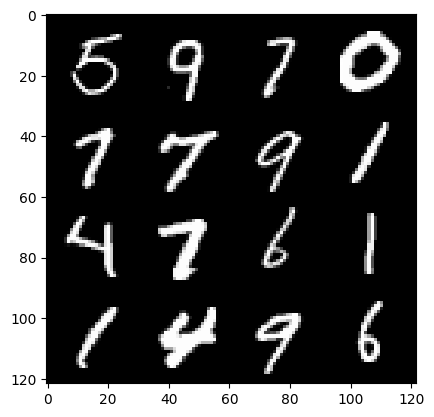

241: step 113100 / Gen loss 1.7309593482812233 / Disc loss 0.36477854430675494


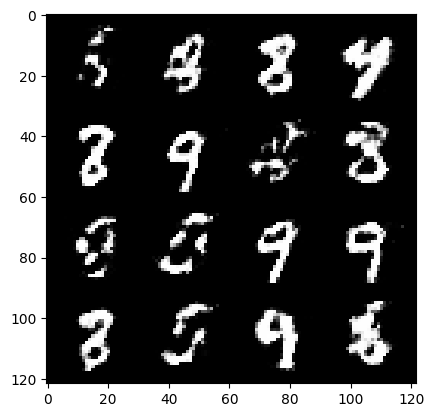

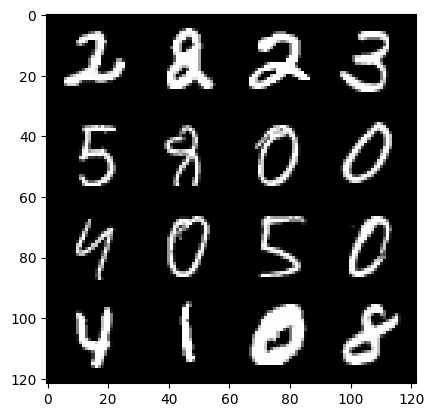

241: step 113400 / Gen loss 1.7117576062679292 / Disc loss 0.377455226580302


  0%|          | 0/469 [00:00<?, ?it/s]

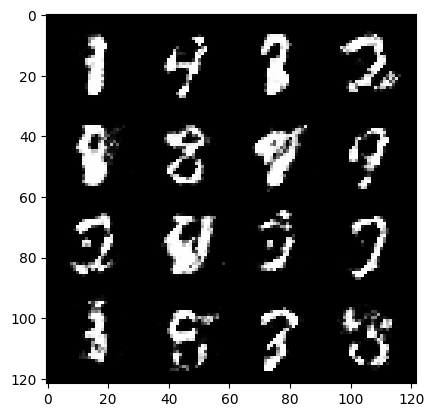

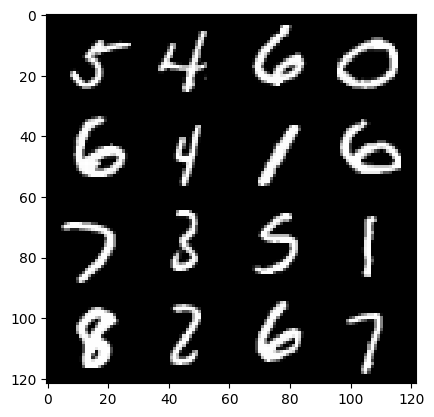

242: step 113700 / Gen loss 1.7074563368161513 / Disc loss 0.37081103652715663


  0%|          | 0/469 [00:00<?, ?it/s]

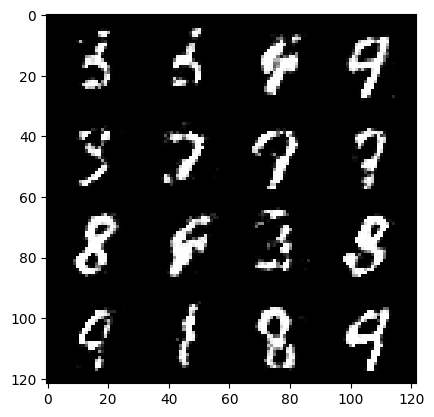

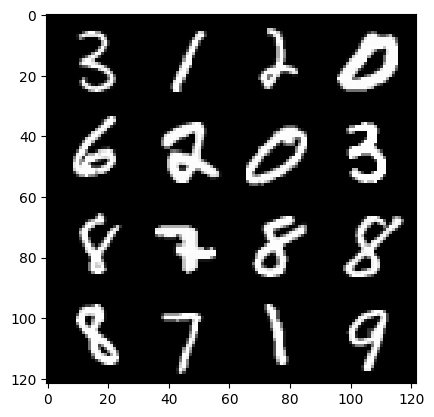

243: step 114000 / Gen loss 1.7722147277990992 / Disc loss 0.36283158004283894


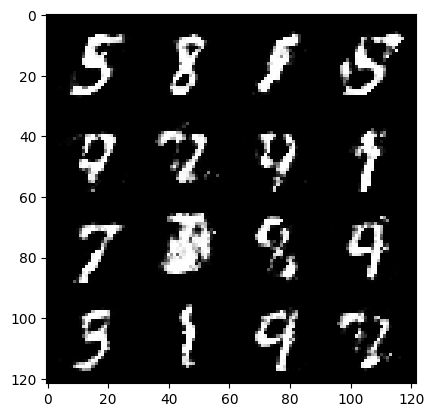

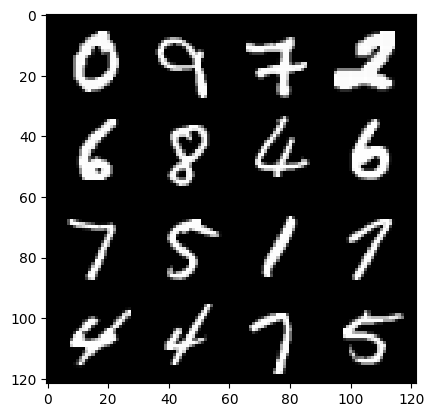

243: step 114300 / Gen loss 1.6425938371817275 / Disc loss 0.39425325065851224


  0%|          | 0/469 [00:00<?, ?it/s]

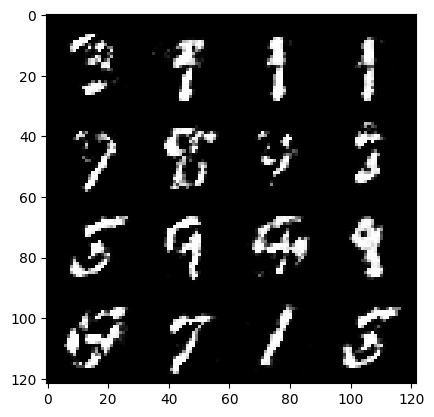

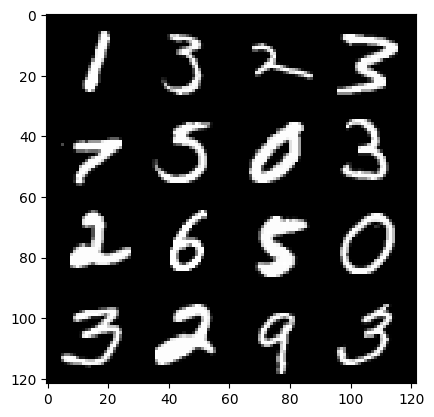

244: step 114600 / Gen loss 1.648366394837698 / Disc loss 0.3958682110905643


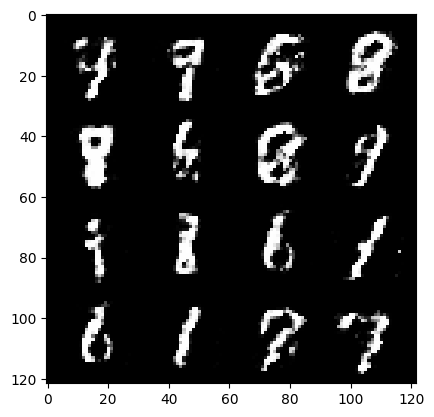

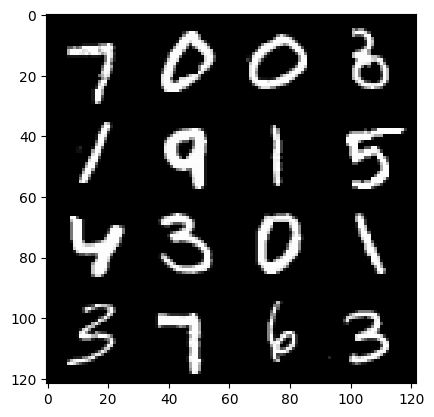

244: step 114900 / Gen loss 1.6946346259117122 / Disc loss 0.3863831907510756


  0%|          | 0/469 [00:00<?, ?it/s]

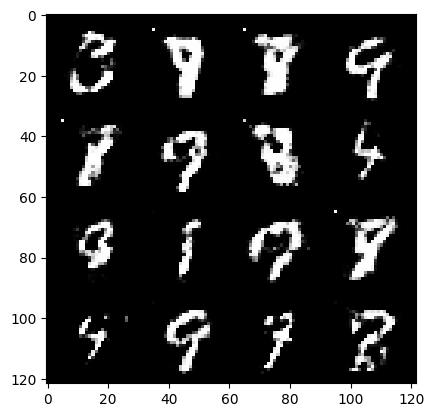

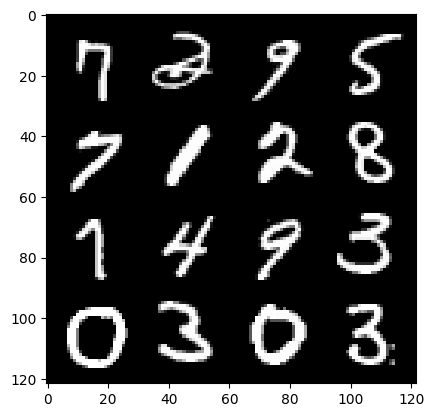

245: step 115200 / Gen loss 1.695015150705973 / Disc loss 0.406002681950728


  0%|          | 0/469 [00:00<?, ?it/s]

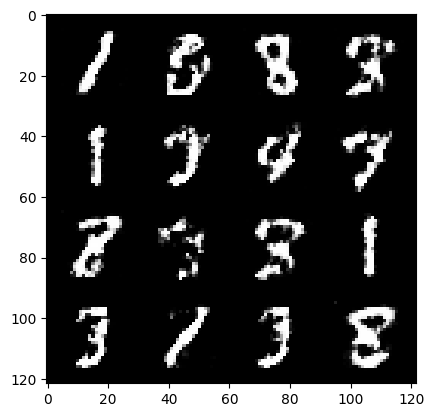

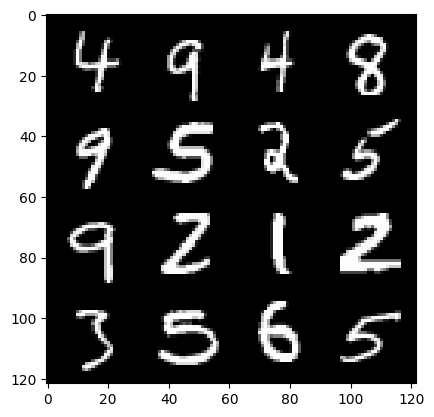

246: step 115500 / Gen loss 1.6499013380209602 / Disc loss 0.3998558129866917


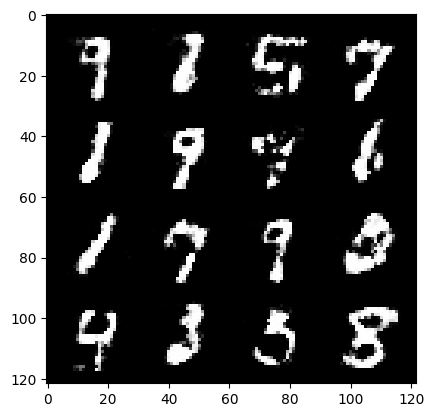

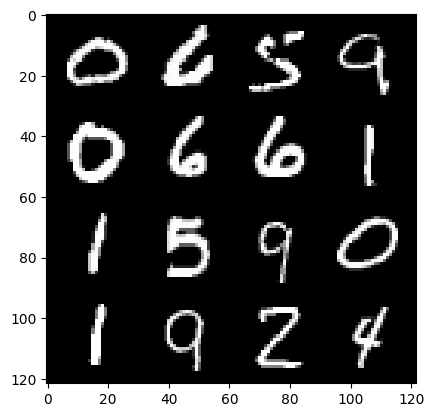

246: step 115800 / Gen loss 1.6322907869021097 / Disc loss 0.40389222244421635


  0%|          | 0/469 [00:00<?, ?it/s]

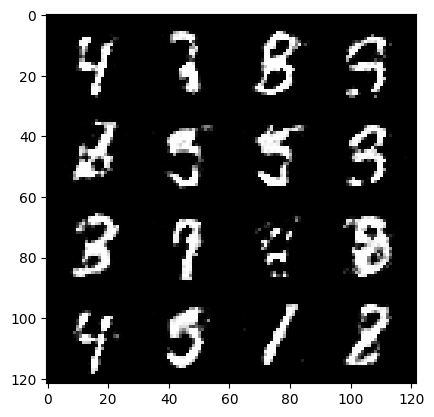

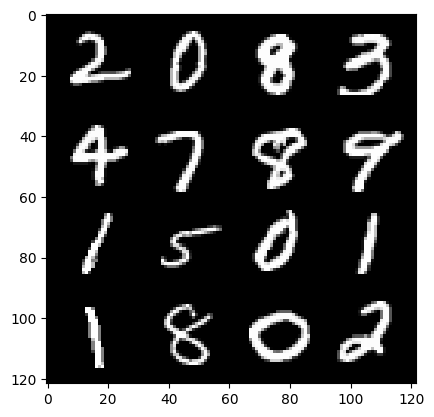

247: step 116100 / Gen loss 1.6423064164320633 / Disc loss 0.38988723923762664


  0%|          | 0/469 [00:00<?, ?it/s]

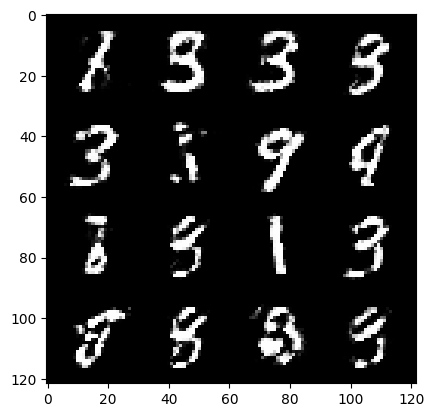

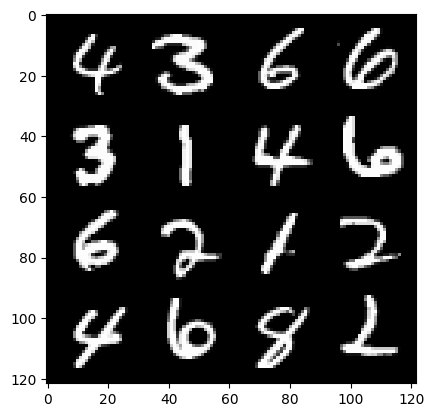

248: step 116400 / Gen loss 1.5754685127735135 / Disc loss 0.42637788126866016


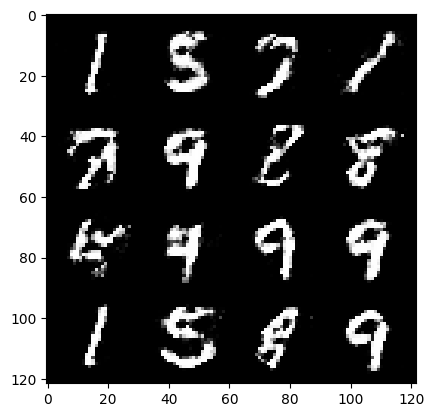

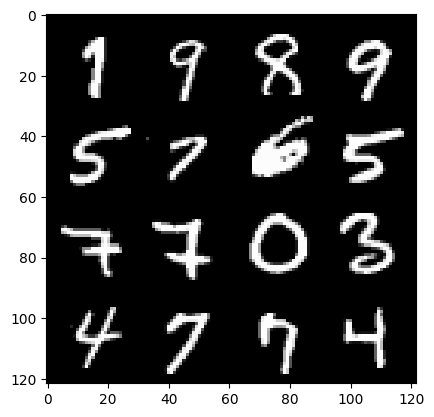

248: step 116700 / Gen loss 1.6372438128789264 / Disc loss 0.4054045612613359


  0%|          | 0/469 [00:00<?, ?it/s]

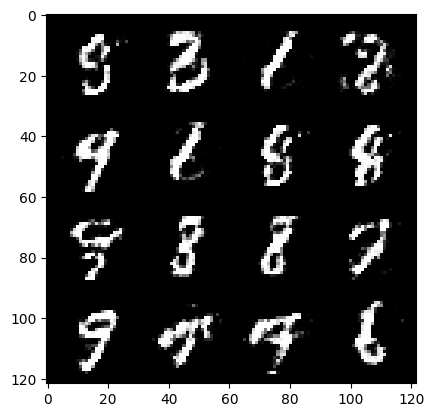

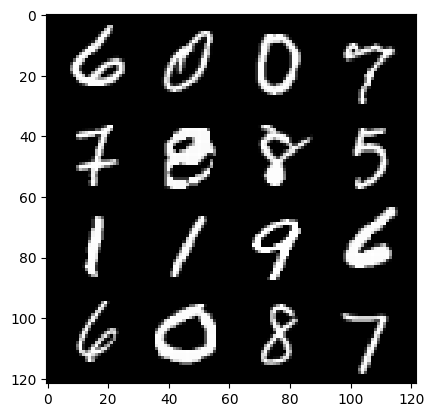

249: step 117000 / Gen loss 1.642493348519008 / Disc loss 0.3953611527880032


  0%|          | 0/469 [00:00<?, ?it/s]

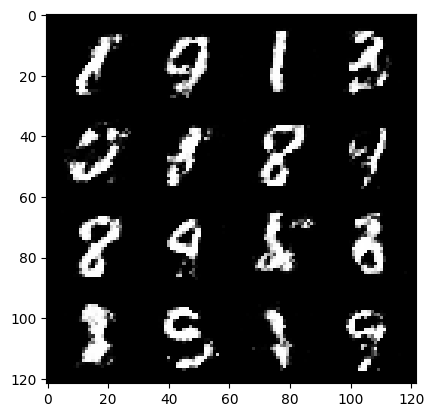

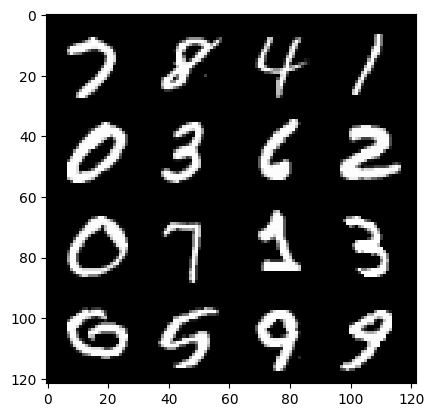

250: step 117300 / Gen loss 1.6229070659478508 / Disc loss 0.40162447770436616


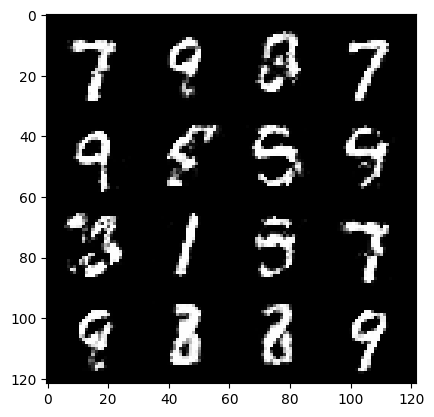

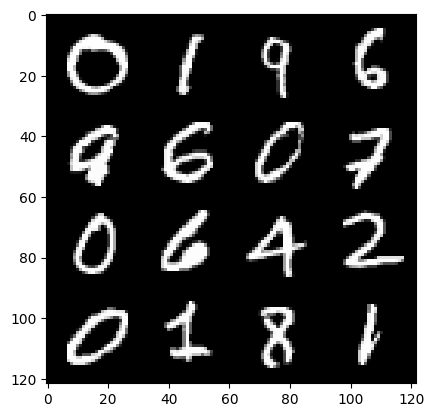

250: step 117600 / Gen loss 1.6545586160818733 / Disc loss 0.3947808813055354


  0%|          | 0/469 [00:00<?, ?it/s]

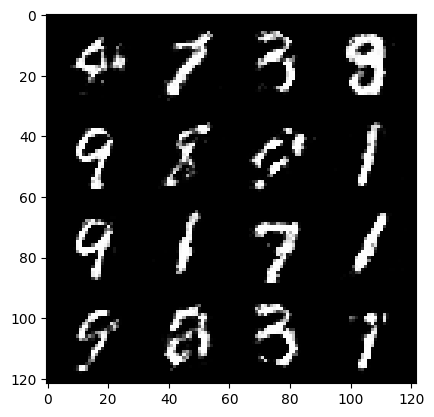

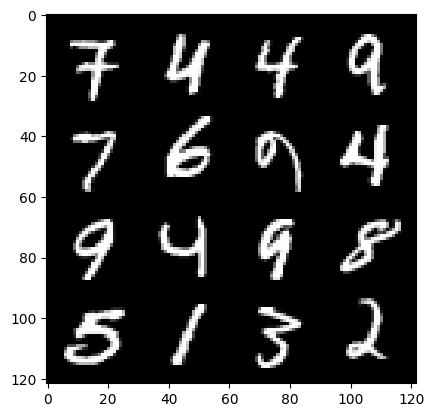

251: step 117900 / Gen loss 1.5507881351312005 / Disc loss 0.4310646135608356


  0%|          | 0/469 [00:00<?, ?it/s]

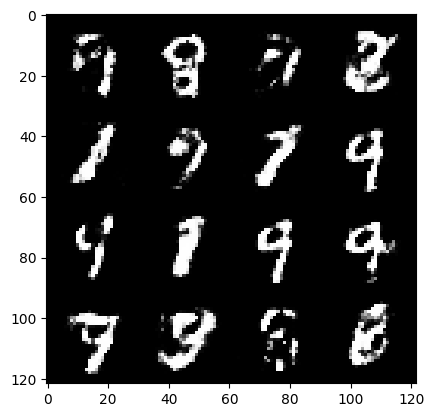

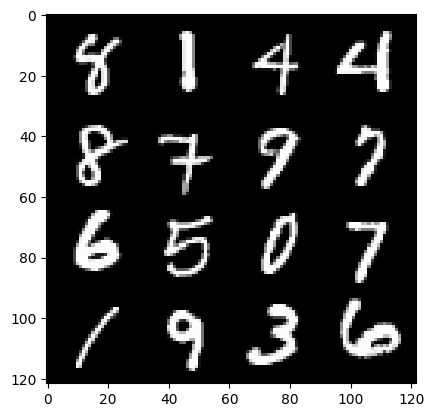

252: step 118200 / Gen loss 1.5563433432579041 / Disc loss 0.4091309332847597


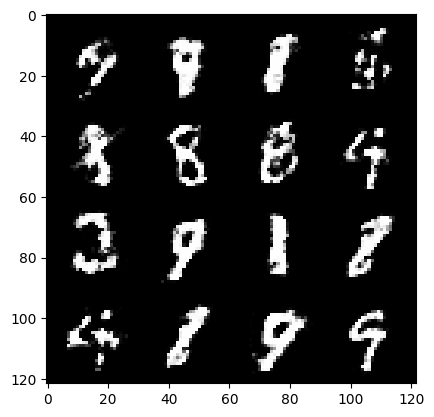

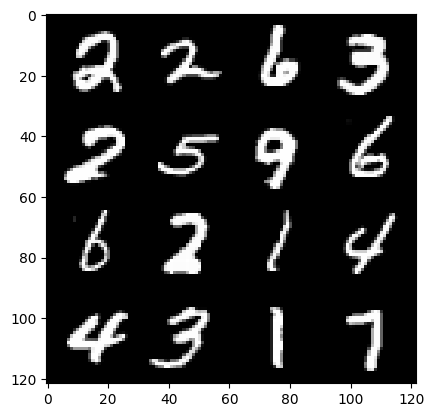

252: step 118500 / Gen loss 1.5742215291659043 / Disc loss 0.40290573656558953


  0%|          | 0/469 [00:00<?, ?it/s]

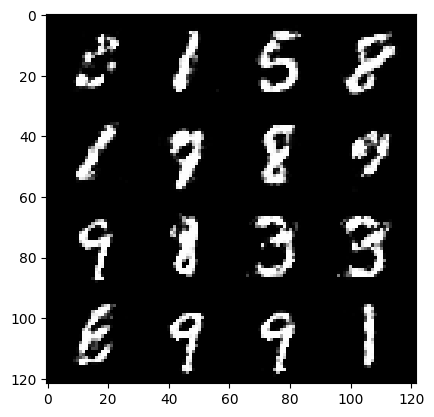

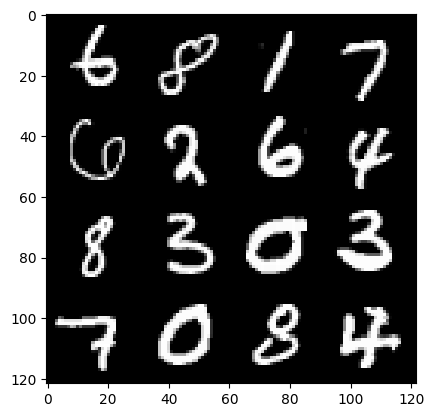

253: step 118800 / Gen loss 1.599343118270238 / Disc loss 0.3989498465259869


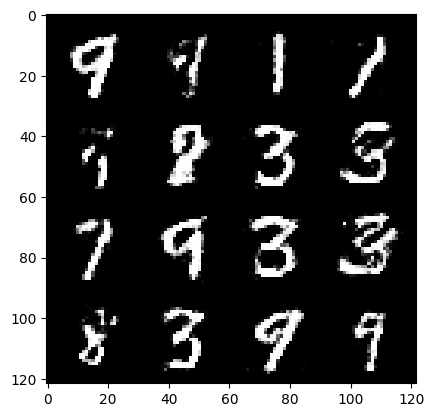

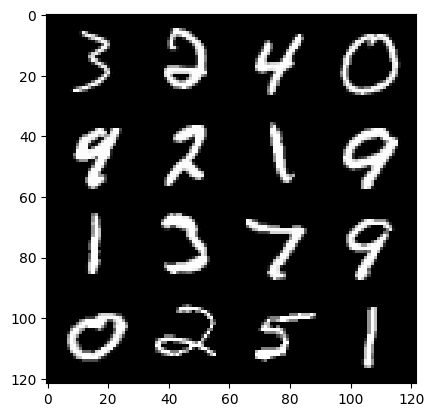

253: step 119100 / Gen loss 1.5130247735977174 / Disc loss 0.4294997255007425


  0%|          | 0/469 [00:00<?, ?it/s]

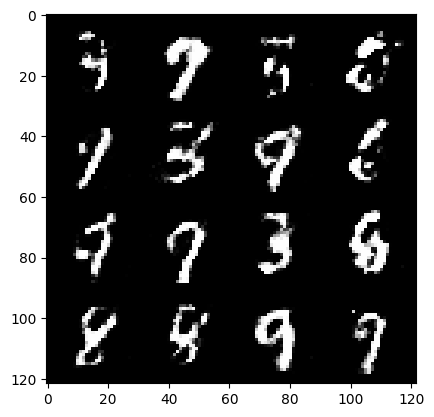

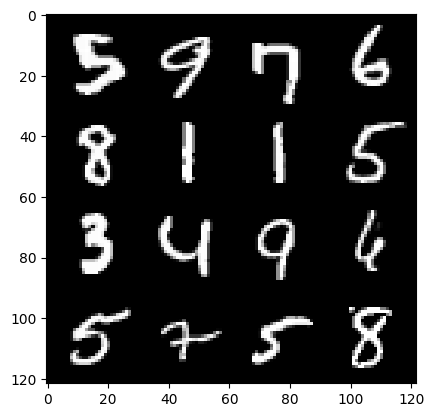

254: step 119400 / Gen loss 1.4853075830141724 / Disc loss 0.43924960315227474


  0%|          | 0/469 [00:00<?, ?it/s]

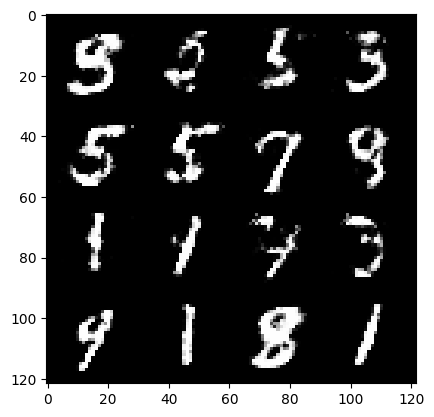

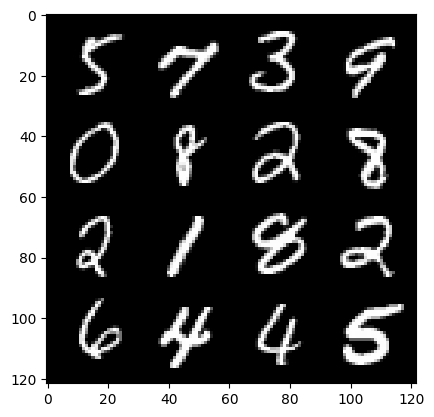

255: step 119700 / Gen loss 1.509278295834859 / Disc loss 0.4312607112526894


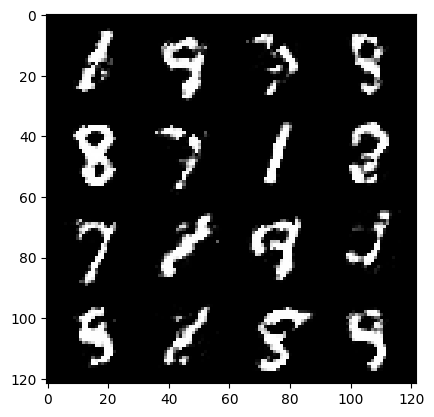

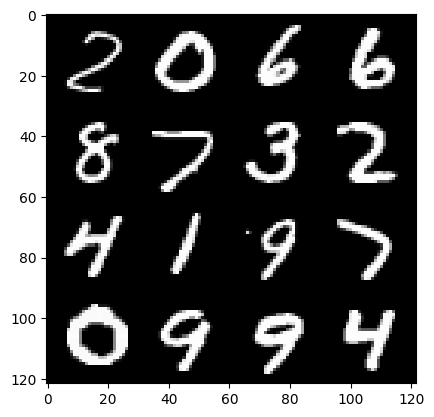

255: step 120000 / Gen loss 1.4816527283191672 / Disc loss 0.43252156009276715


  0%|          | 0/469 [00:00<?, ?it/s]

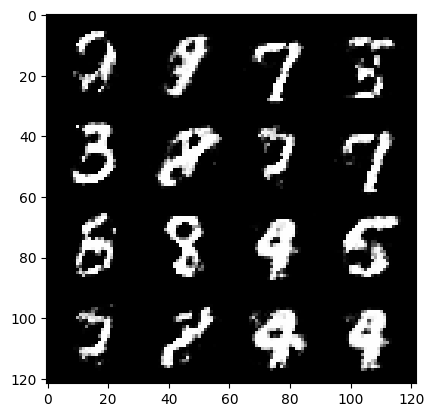

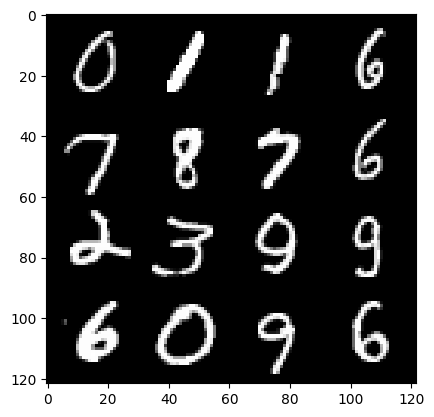

256: step 120300 / Gen loss 1.4890173955758423 / Disc loss 0.42826374024152764


  0%|          | 0/469 [00:00<?, ?it/s]

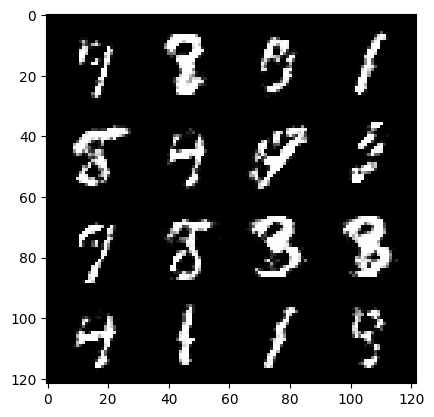

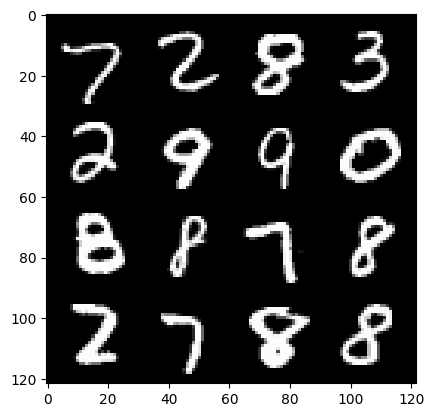

257: step 120600 / Gen loss 1.4775495978196471 / Disc loss 0.4292104736963909


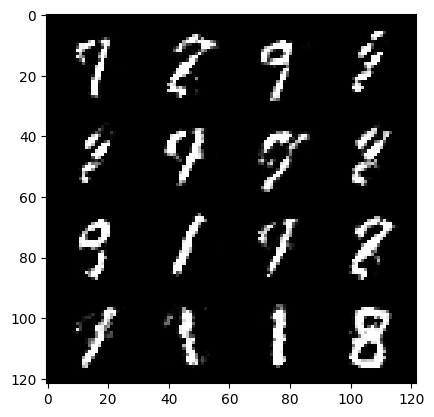

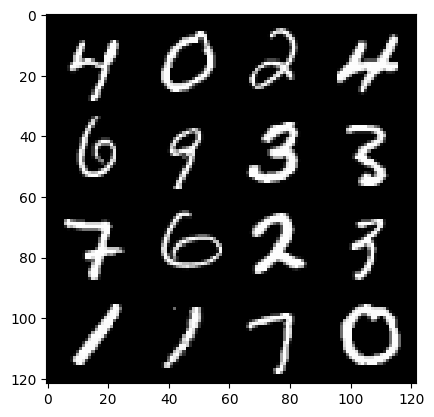

257: step 120900 / Gen loss 1.4701198764642067 / Disc loss 0.4360273859898251


  0%|          | 0/469 [00:00<?, ?it/s]

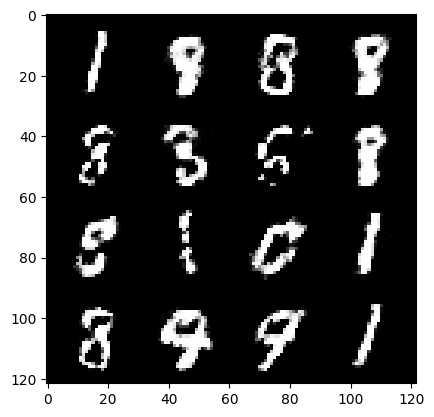

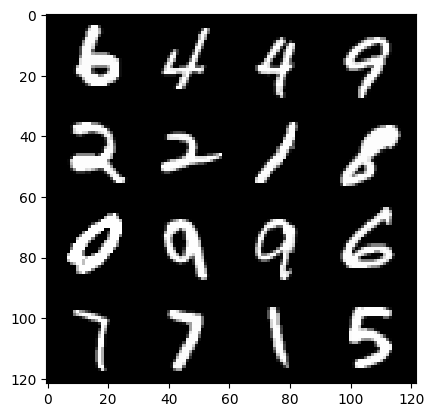

258: step 121200 / Gen loss 1.5002196013927453 / Disc loss 0.4295165218909583


  0%|          | 0/469 [00:00<?, ?it/s]

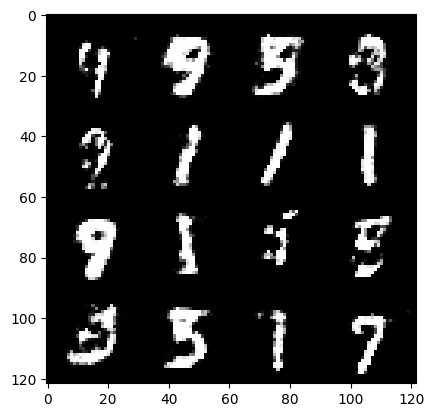

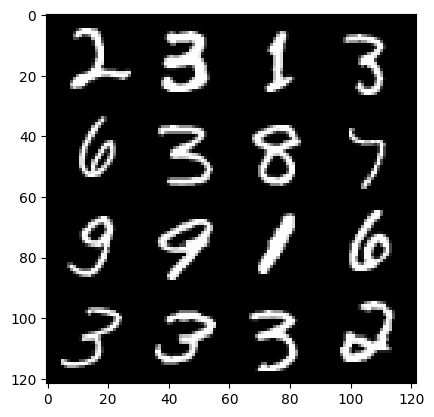

259: step 121500 / Gen loss 1.4863921594619751 / Disc loss 0.4399949799974758


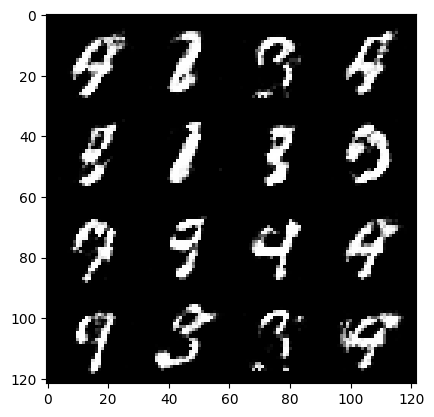

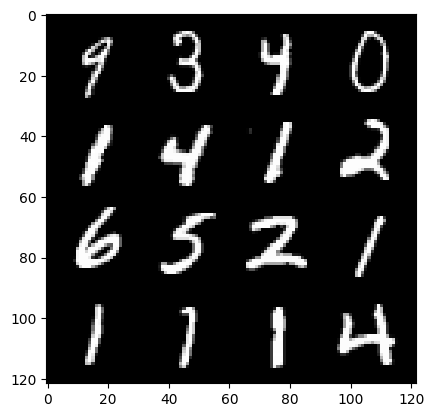

259: step 121800 / Gen loss 1.5314382712046313 / Disc loss 0.42432860563198743


  0%|          | 0/469 [00:00<?, ?it/s]

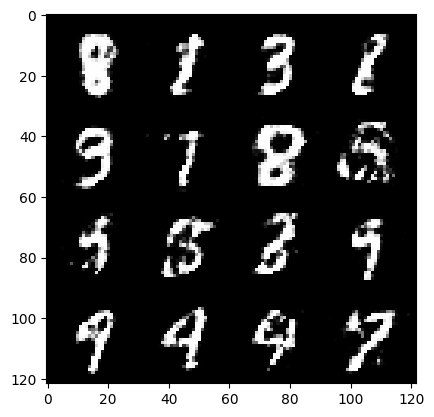

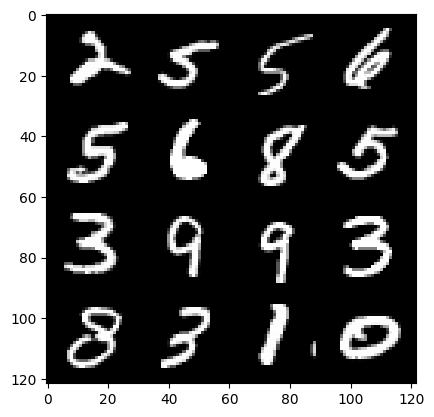

260: step 122100 / Gen loss 1.4887263611952457 / Disc loss 0.42750308583180113


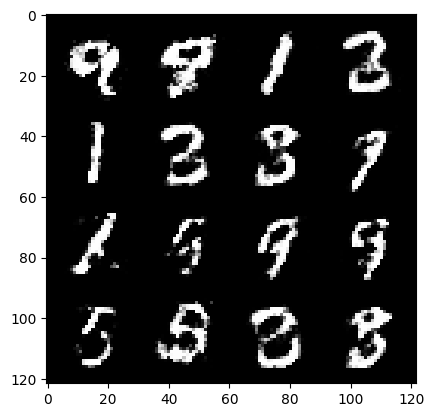

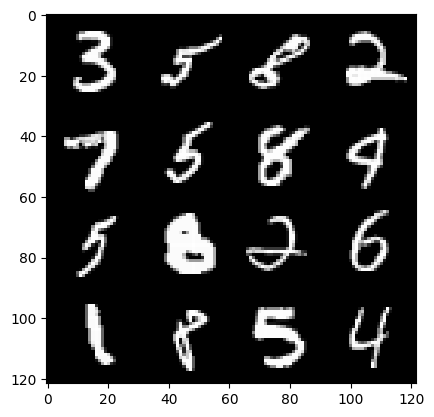

260: step 122400 / Gen loss 1.5124464507897706 / Disc loss 0.4197884436448413


  0%|          | 0/469 [00:00<?, ?it/s]

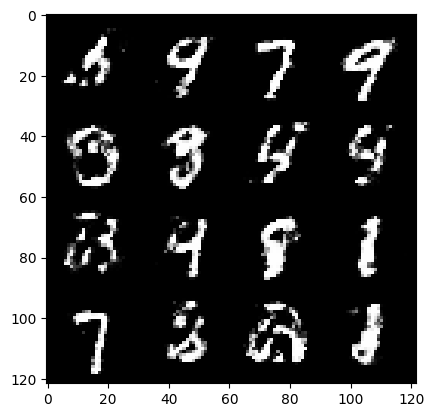

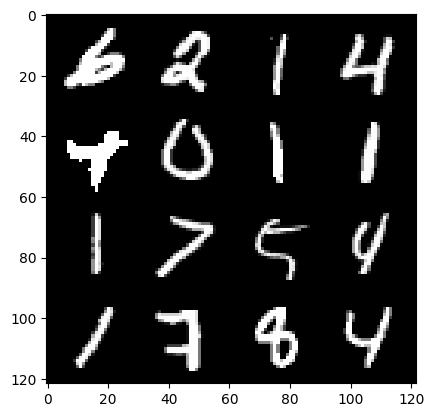

261: step 122700 / Gen loss 1.4818641050656636 / Disc loss 0.4401846622427302


  0%|          | 0/469 [00:00<?, ?it/s]

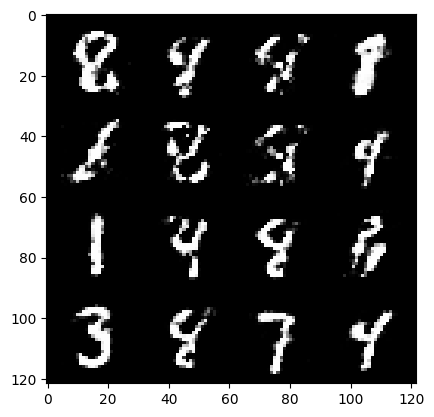

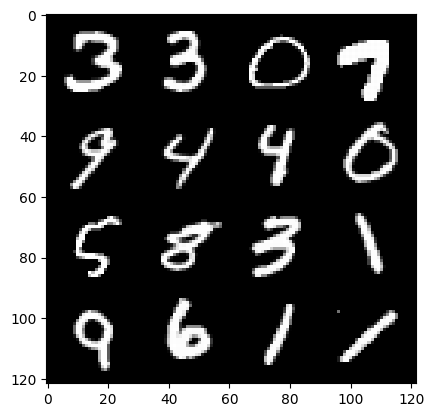

262: step 123000 / Gen loss 1.4738523570696511 / Disc loss 0.4406057494878769


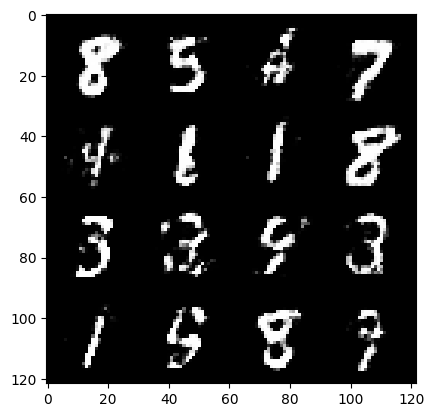

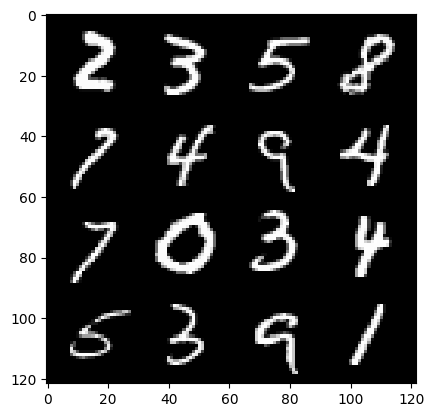

262: step 123300 / Gen loss 1.4937906229496003 / Disc loss 0.42341129769881564


  0%|          | 0/469 [00:00<?, ?it/s]

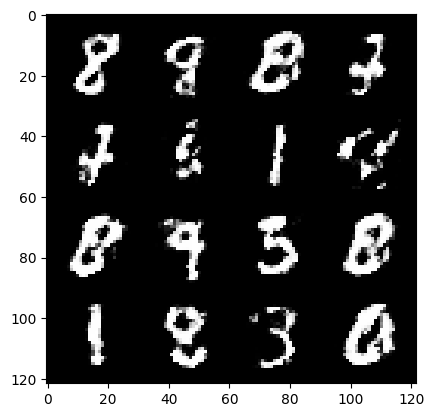

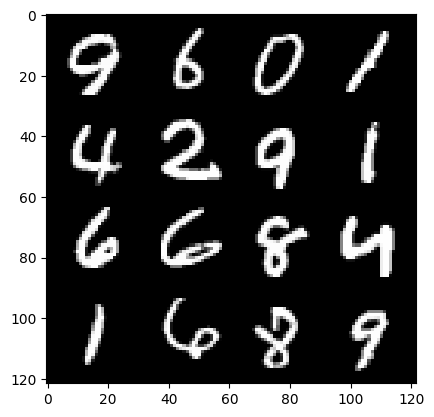

263: step 123600 / Gen loss 1.527040877342224 / Disc loss 0.4195697661240898


  0%|          | 0/469 [00:00<?, ?it/s]

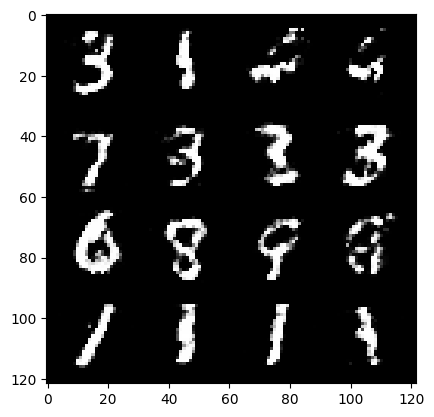

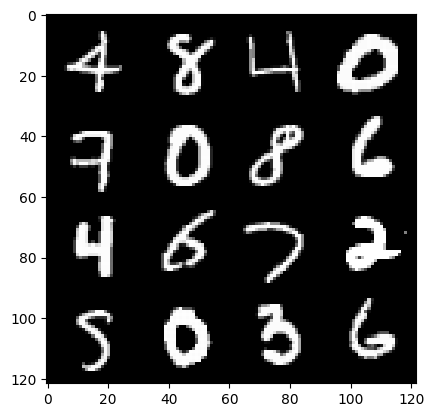

264: step 123900 / Gen loss 1.5041462413469948 / Disc loss 0.42872015366951605


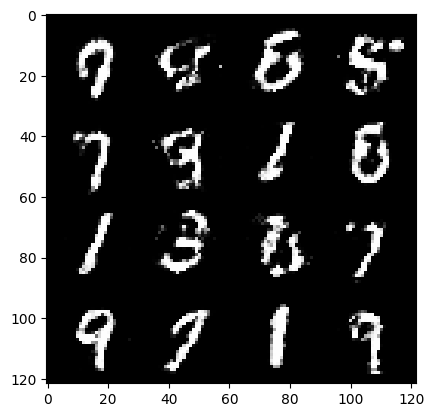

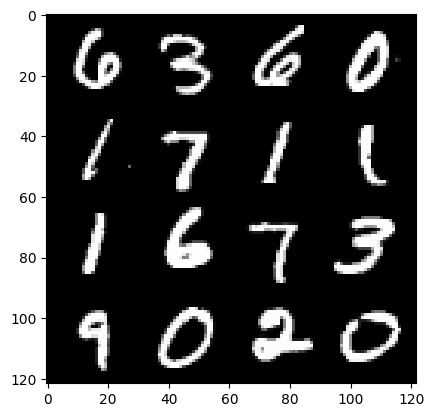

264: step 124200 / Gen loss 1.4715946328639968 / Disc loss 0.4437811867396038


  0%|          | 0/469 [00:00<?, ?it/s]

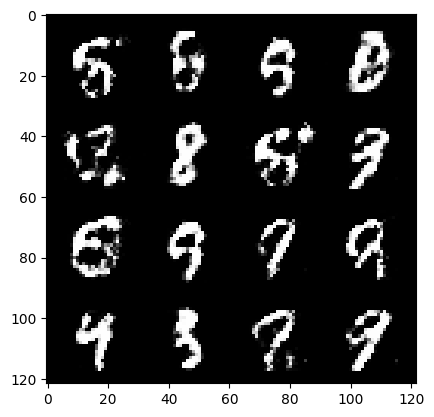

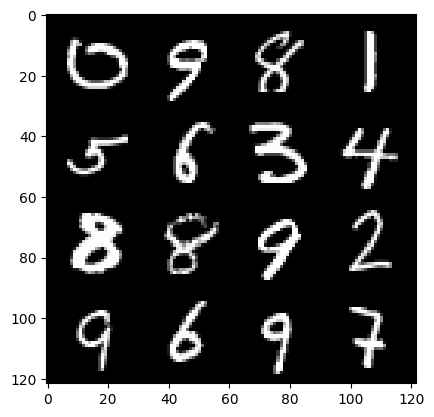

265: step 124500 / Gen loss 1.4480693380037948 / Disc loss 0.44832586159308757


  0%|          | 0/469 [00:00<?, ?it/s]

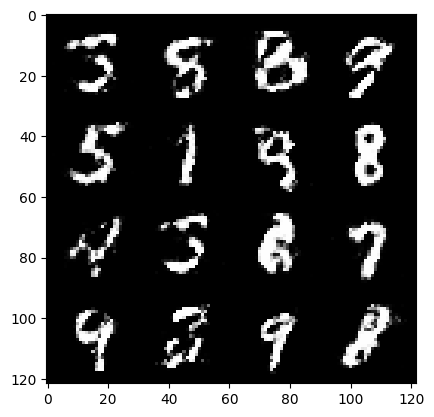

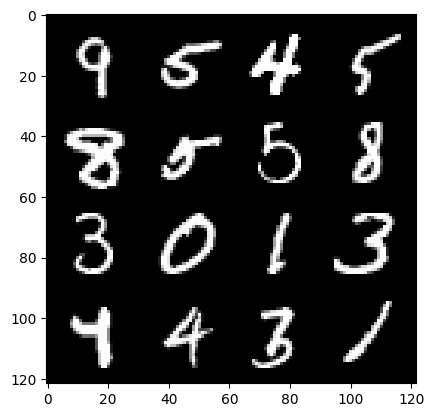

266: step 124800 / Gen loss 1.4781101648012798 / Disc loss 0.4477219199140866


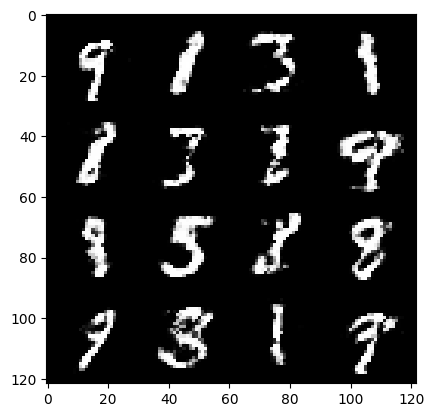

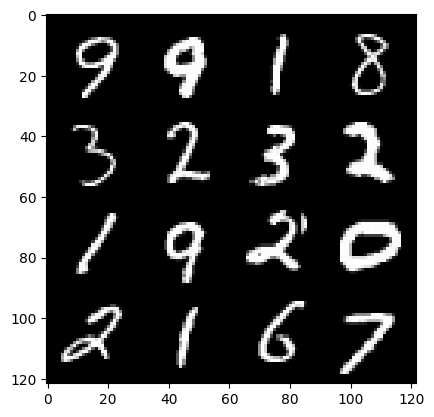

266: step 125100 / Gen loss 1.492376712560653 / Disc loss 0.43625847856203737


  0%|          | 0/469 [00:00<?, ?it/s]

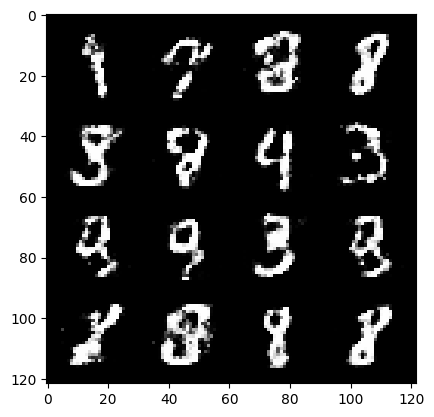

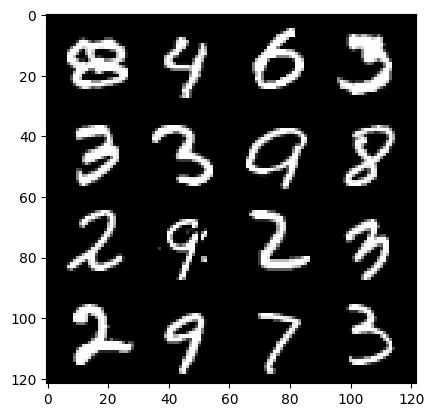

267: step 125400 / Gen loss 1.5040946785608922 / Disc loss 0.42319956610600135


  0%|          | 0/469 [00:00<?, ?it/s]

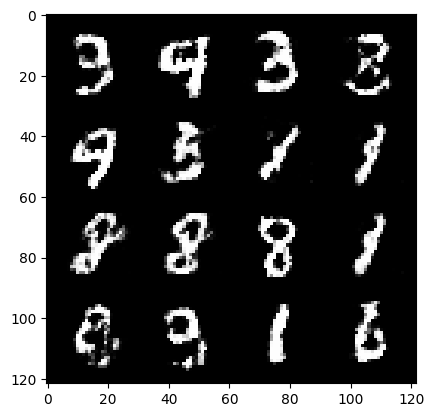

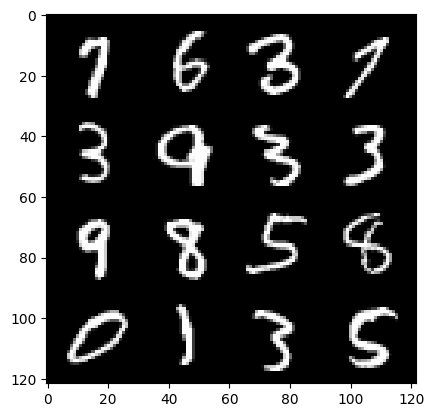

268: step 125700 / Gen loss 1.473696680466334 / Disc loss 0.4250424166520439


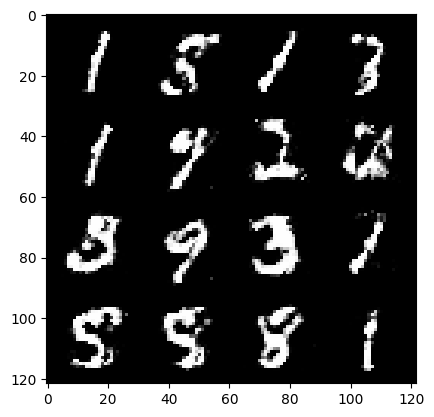

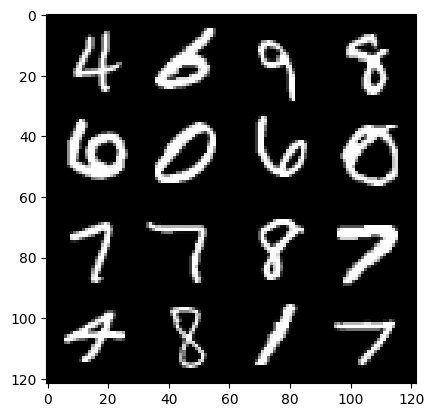

268: step 126000 / Gen loss 1.4716025269031523 / Disc loss 0.4377940567334496


  0%|          | 0/469 [00:00<?, ?it/s]

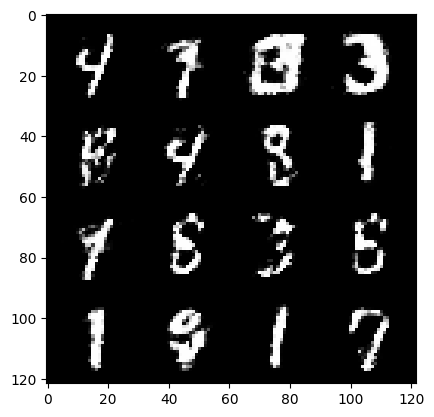

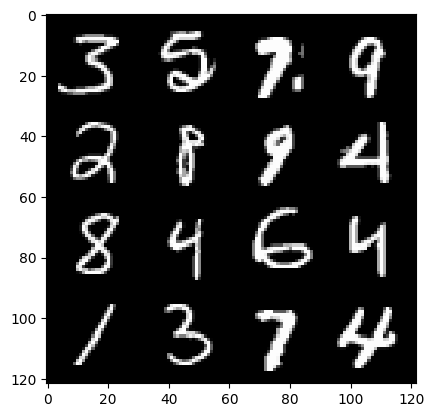

269: step 126300 / Gen loss 1.4675191227595026 / Disc loss 0.43355513026316933


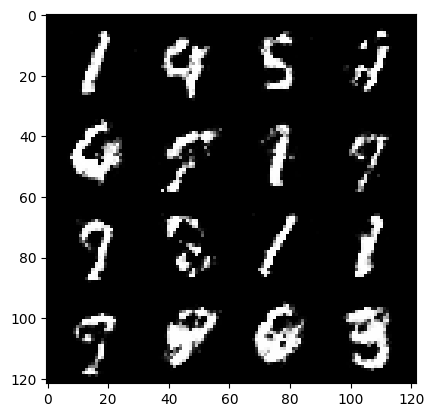

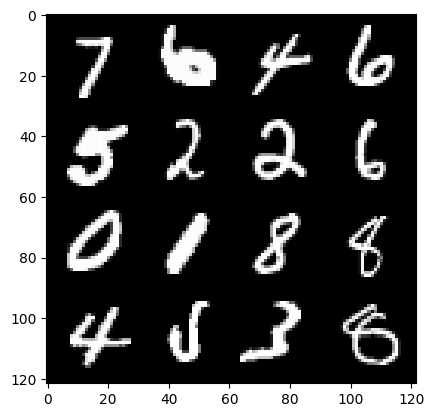

269: step 126600 / Gen loss 1.4773805693785347 / Disc loss 0.4295735191305481


  0%|          | 0/469 [00:00<?, ?it/s]

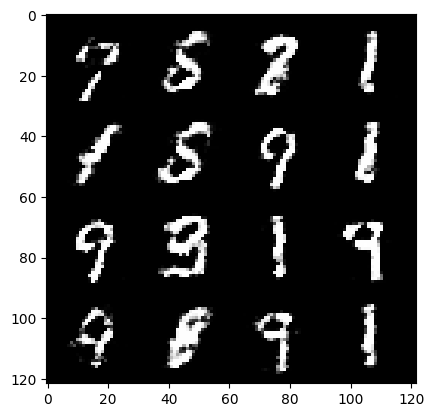

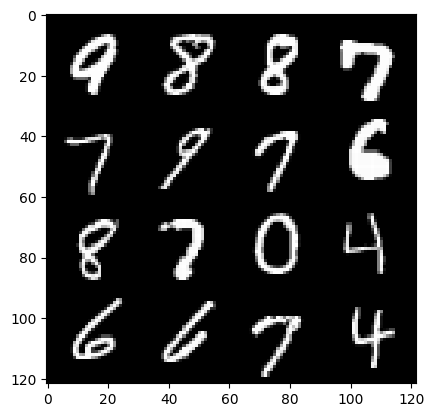

270: step 126900 / Gen loss 1.460144454240799 / Disc loss 0.430794281760852


  0%|          | 0/469 [00:00<?, ?it/s]

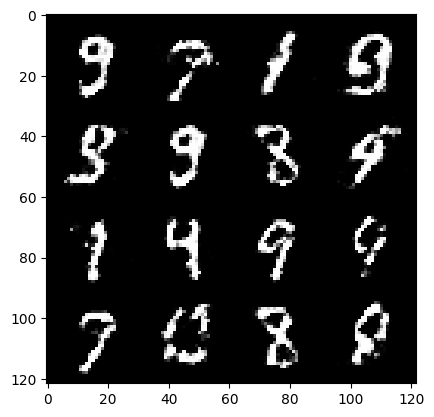

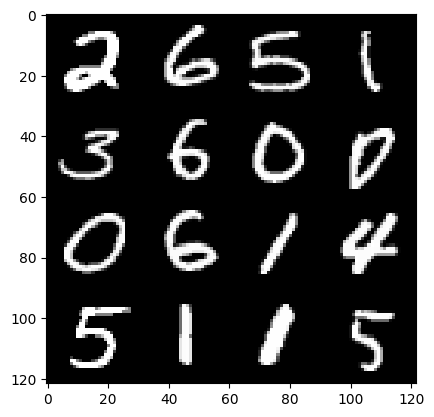

271: step 127200 / Gen loss 1.5140854156017303 / Disc loss 0.41439997365077336


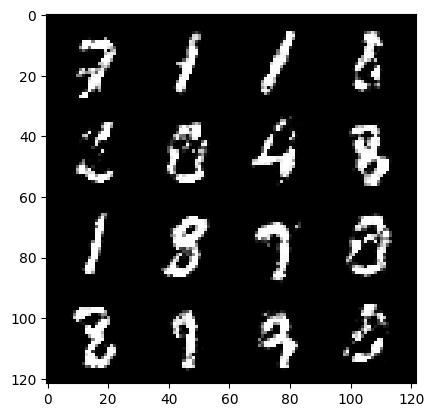

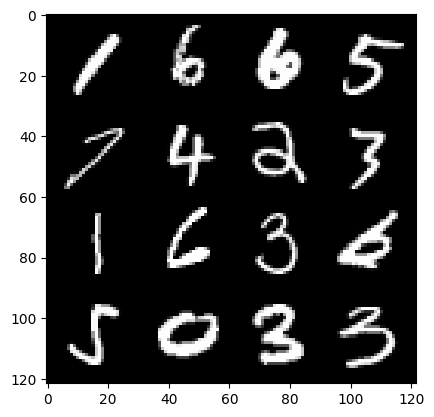

271: step 127500 / Gen loss 1.5687956551710782 / Disc loss 0.40102081527312594


  0%|          | 0/469 [00:00<?, ?it/s]

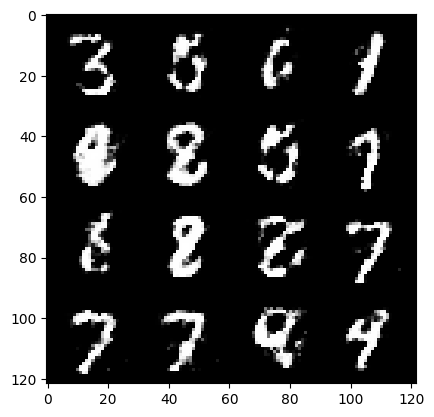

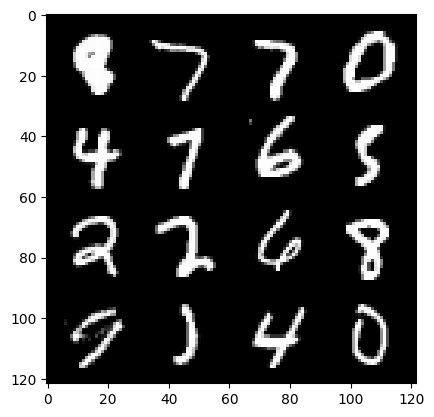

272: step 127800 / Gen loss 1.5554263703028355 / Disc loss 0.42185503999392215


  0%|          | 0/469 [00:00<?, ?it/s]

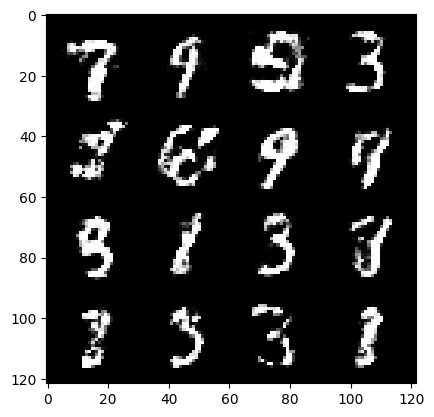

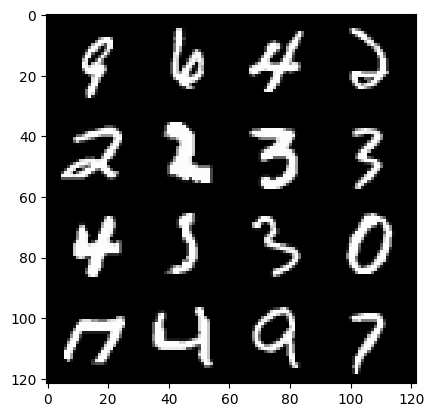

273: step 128100 / Gen loss 1.5221025701363877 / Disc loss 0.42935294995705275


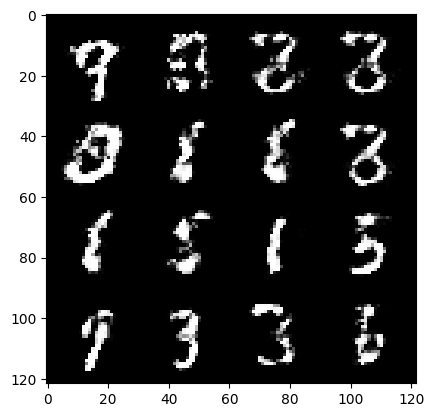

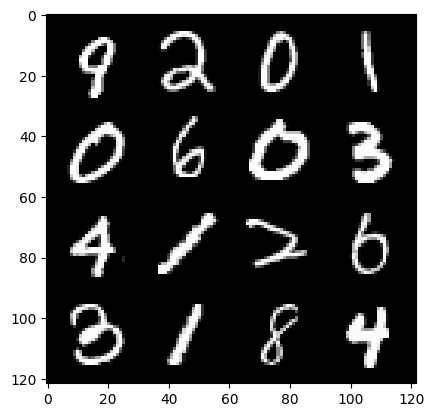

273: step 128400 / Gen loss 1.5055526594320932 / Disc loss 0.4251822882890703


  0%|          | 0/469 [00:00<?, ?it/s]

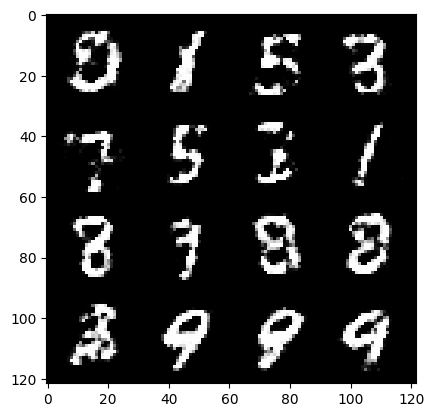

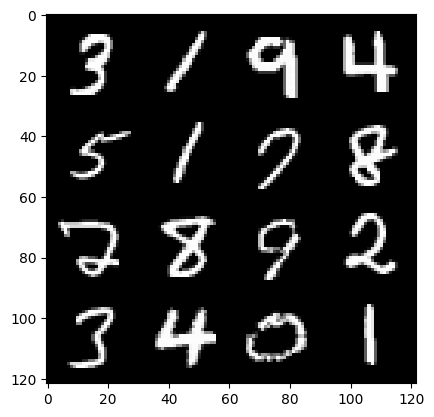

274: step 128700 / Gen loss 1.5004048438866917 / Disc loss 0.4235122782985368


  0%|          | 0/469 [00:00<?, ?it/s]

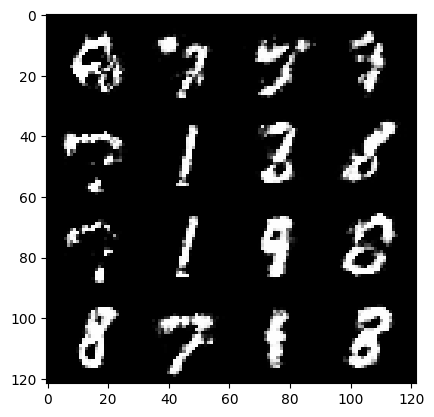

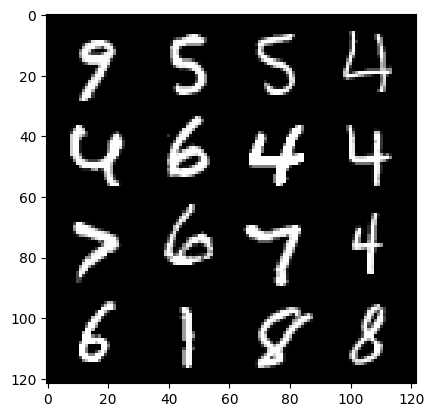

275: step 129000 / Gen loss 1.4626790324846906 / Disc loss 0.4423485114177067


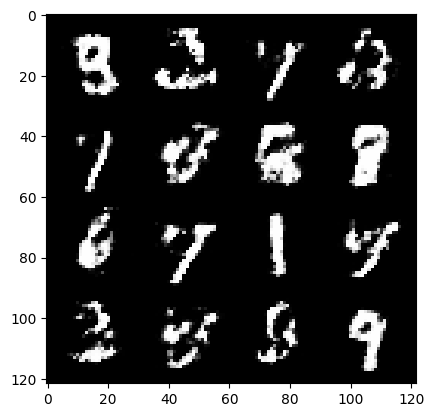

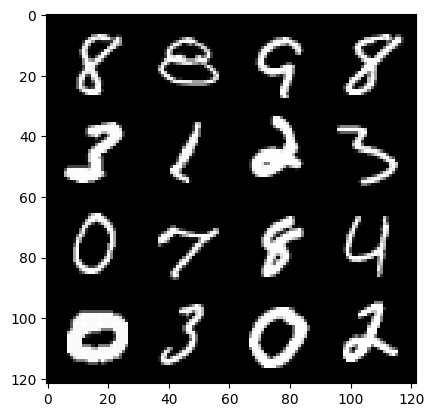

275: step 129300 / Gen loss 1.4615093596776323 / Disc loss 0.44531559636195484


  0%|          | 0/469 [00:00<?, ?it/s]

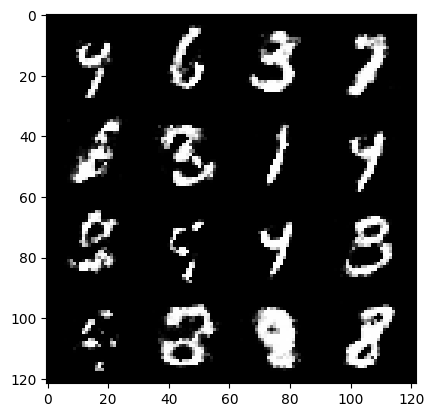

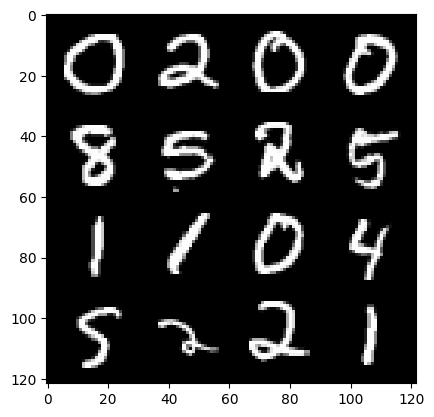

276: step 129600 / Gen loss 1.4294704651832597 / Disc loss 0.450856846074263


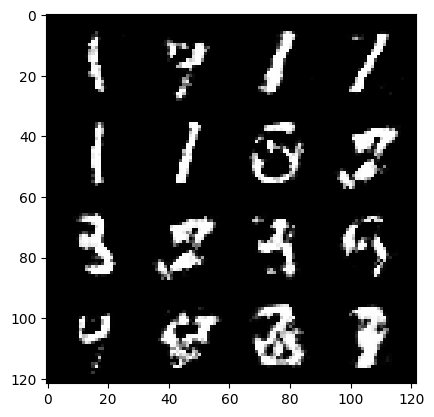

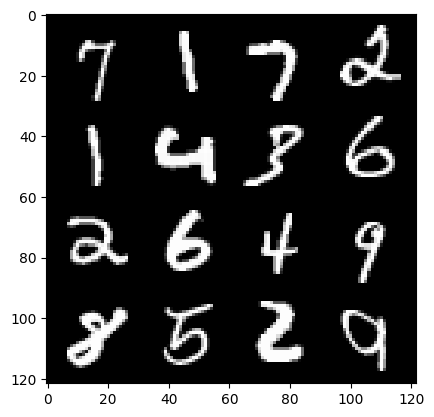

276: step 129900 / Gen loss 1.414443439245224 / Disc loss 0.4461961039900782


  0%|          | 0/469 [00:00<?, ?it/s]

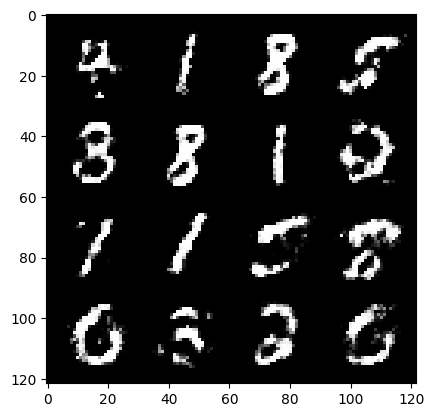

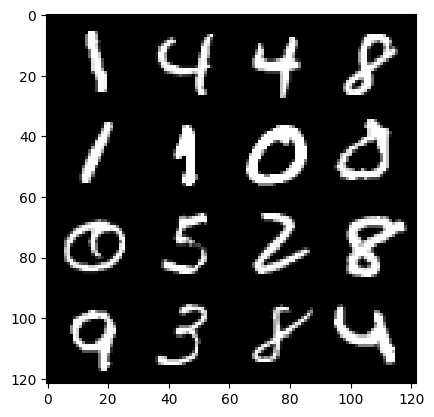

277: step 130200 / Gen loss 1.3787250848611203 / Disc loss 0.4640331238508227


  0%|          | 0/469 [00:00<?, ?it/s]

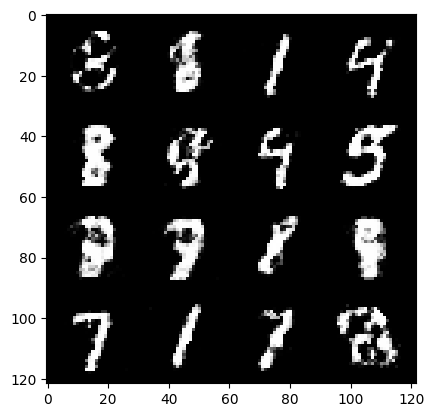

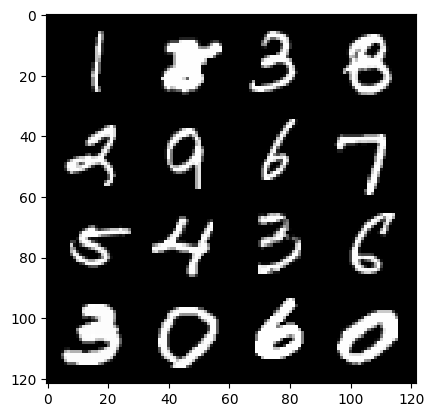

278: step 130500 / Gen loss 1.4535110870997094 / Disc loss 0.43587834566831607


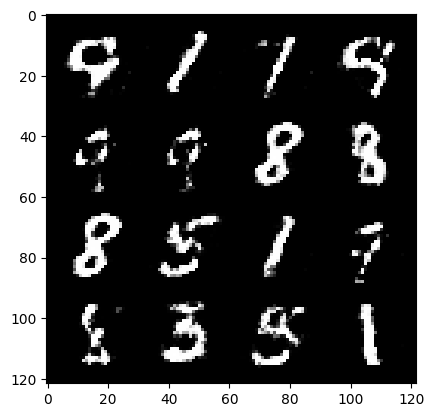

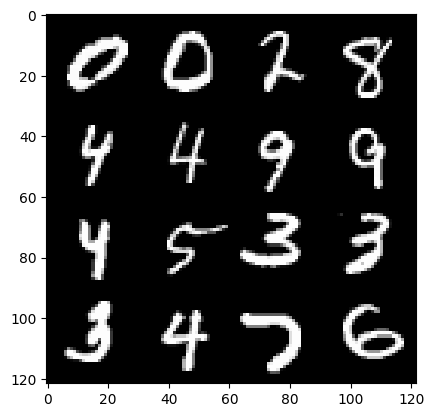

278: step 130800 / Gen loss 1.440928648312886 / Disc loss 0.4438735102613767


  0%|          | 0/469 [00:00<?, ?it/s]

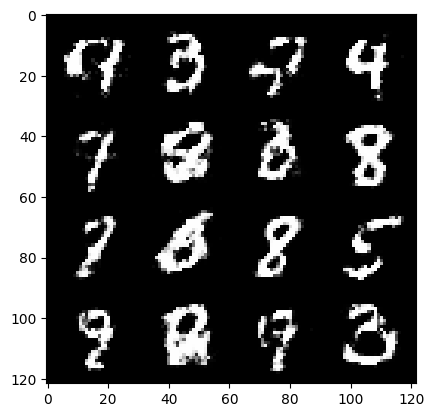

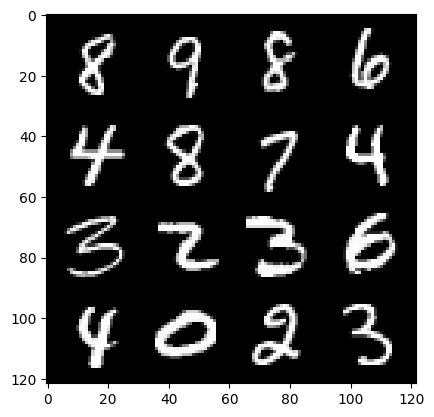

279: step 131100 / Gen loss 1.4704974408944445 / Disc loss 0.4312717908620833


In [18]:
## 60000 / 128 = 468.75 step in each epoch
## each step is going to process 128 images (batch size)

for epoch in range(epochs):
  for real, _ in tqdm(dataloader):
    ## discriminator
    disc_opt.zero_grad()
    cur_bs = len(real) # 128 * 1 * 28 * 28
    real = real.view(cur_bs, -1) # 128 * 784
    real = real.to(device)

    disc_loss = cal_disc_loss(loss_func, gen, disc, cur_bs, real, z_dim)
    disc_loss.backward(retain_graph = True)
    disc_opt.step()

    ## generator
    gen_opt.zero_grad()
    gen_loss = cal_gen_loss(loss_func, gen, disc, cur_bs, z_dim)
    gen_loss.backward(retain_graph = True)
    gen_opt.step()

    ## visualization & stats
    mean_disc_loss += disc_loss.item()/info_step
    mean_gen_loss += gen_loss.item()/info_step

    if cur_step % info_step == 0 and cur_step > 0:
      fake_noise = gen_noise(cur_bs, z_dim)
      fake = gen(fake_noise)
      show(fake)
      show(real)
      print(f"{epoch}: step {cur_step} / Gen loss {mean_gen_loss} / Disc loss {mean_disc_loss}")
      mean_gen_loss, mean_disc_loss = 0,0
    cur_step += 1
